# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

  0% 0.00/255k [00:00<?, ?B/s]
100% 255k/255k [00:00<00:00, 79.1MB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

  0% 0.00/66.1k [00:00<?, ?B/s]
100% 66.1k/66.1k [00:00<00:00, 91.4MB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:37<00:00, 36.1MB/s]
100% 1.09G/1.09G [00:37<00:00, 31.5MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 757.9 kB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 1.5 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
from scipy.stats import spearmanr
import time

# Preprocess & Split

In [ ]:
df_animal = pd.read_csv("/content/animal.csv")
df_animal["image_file"] =df_animal["image_file"].apply(lambda file: "/content/animal" +"/"+ file)
df_animal["memorability_wo_fa_correction"] = df_animal["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_animal.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,1,/content/animal/000000003481.jpg,animal,bear,316,500,coco,bear,1,55,4,98,0.561224,0.520408
1,2,/content/animal/000000005745.jpg,animal,bear,427,640,coco,bear,1,64,4,81,0.790123,0.740741
2,3,/content/animal/000000011552.jpg,animal,bear,427,640,coco,bear,1,75,5,104,0.721154,0.673077
3,4,/content/animal/000000027439.jpg,animal,bear,359,640,coco,bear,1,92,3,114,0.807018,0.780702
4,5,/content/animal/000000055601.jpg,animal,bear,380,640,coco,bear,1,83,12,102,0.813725,0.696078


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 111.59846612590349
Standard deviation of pixel values: 64.12019565963958


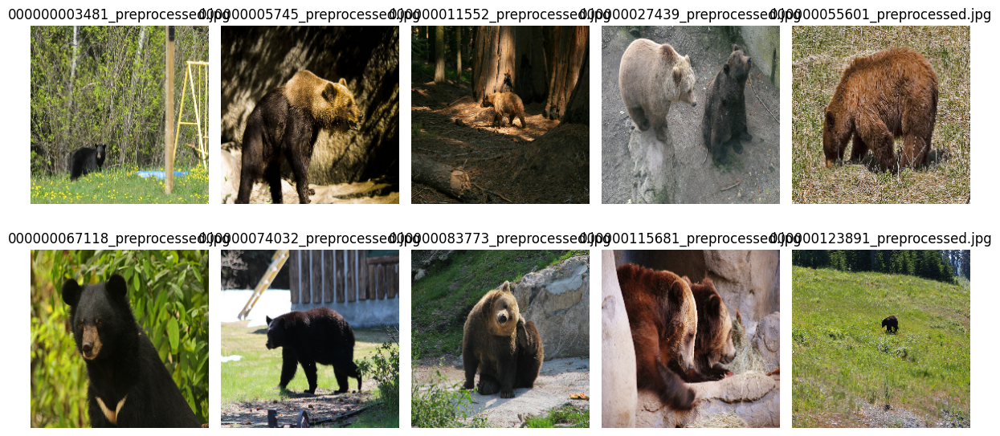

In [ ]:
# Sample data (replace this with your DataFrame)
df_animal = pd.DataFrame({
    'image_file': df_animal["image_file"],
    'memoscore': df_animal["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_animal['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_animal.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_animal.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_animal.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_animal.head()

,image_file,memoscore,preprocessed_image_path
0,/content/animal/000000003481.jpg,0.561224,/content/animal/000000003481_preprocessed.jpg
1,/content/animal/000000005745.jpg,0.790123,/content/animal/000000005745_preprocessed.jpg
2,/content/animal/000000011552.jpg,0.721154,/content/animal/000000011552_preprocessed.jpg
3,/content/animal/000000027439.jpg,0.807018,/content/animal/000000027439_preprocessed.jpg
4,/content/animal/000000055601.jpg,0.813725,/content/animal/000000055601_preprocessed.jpg


In [ ]:
del df_animal["image_file"]

In [ ]:
df_animal.head()

,memoscore,preprocessed_image_path
0,0.561224,/content/animal/000000003481_preprocessed.jpg
1,0.790123,/content/animal/000000005745_preprocessed.jpg
2,0.721154,/content/animal/000000011552_preprocessed.jpg
3,0.807018,/content/animal/000000027439_preprocessed.jpg
4,0.813725,/content/animal/000000055601_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_animal.drop('memoscore', axis=1)), pd.DataFrame(df_animal['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
1997,/content/animal/000000566598_preprocessed.jpg
294,/content/animal/n01793435_5738_preprocessed.jpg
625,/content/animal/n01846331_15233_preprocessed.jpg
1442,/content/animal/n01811909_15850_preprocessed.jpg
1067,/content/animal/n02342885_4843_preprocessed.jpg


In [ ]:
merged_train_animal= pd.concat([X_train, y_train], axis=1)
merged_train_animal

,preprocessed_image_path,memoscore
1997,/content/animal/000000566598_preprocessed.jpg,0.873684
294,/content/animal/n01793435_5738_preprocessed.jpg,0.776596
625,/content/animal/n01846331_15233_preprocessed.jpg,0.706522
1442,/content/animal/n01811909_15850_preprocessed.jpg,0.814433
1067,/content/animal/n02342885_4843_preprocessed.jpg,0.936937
...,...,...
472,/content/animal/n02432983_26897_preprocessed.jpg,0.535714
1115,/content/animal/000000177749_preprocessed.jpg,0.533981
443,/content/animal/n02431441_4277_preprocessed.jpg,0.773196
685,/content/animal/n01846331_7521_preprocessed.jpg,0.737864


In [ ]:
merged_val_animal = pd.concat([X_val, y_val], axis=1)
merged_val_animal

,preprocessed_image_path,memoscore
1693,/content/animal/000000545959_preprocessed.jpg,0.674419
1050,/content/animal/n02342885_209_preprocessed.jpg,0.822430
328,/content/animal/000000133137_preprocessed.jpg,0.770115
1568,/content/animal/n02324045_35005_preprocessed.jpg,0.794872
548,/content/animal/000000397034_preprocessed.jpg,0.857143
...,...,...
1234,/content/animal/n02129165_1837_preprocessed.jpg,0.776596
680,/content/animal/n01846331_693_preprocessed.jpg,0.820755
1258,/content/animal/n02129165_3678_preprocessed.jpg,0.902913
292,/content/animal/n01793435_2761_preprocessed.jpg,0.815534


In [ ]:
merged_test_animal = pd.concat([X_test, y_test], axis=1)
merged_test_animal

,preprocessed_image_path,memoscore
1630,/content/animal/000000157901_preprocessed.jpg,0.541284
1378,/content/animal/n02332755_4664_preprocessed.jpg,0.784946
1544,/content/animal/n02324045_25672_preprocessed.jpg,0.836207
751,/content/animal/000000310683_preprocessed.jpg,0.775701
574,/content/animal/000000572254_preprocessed.jpg,0.793814
...,...,...
1506,/content/animal/n02324045_1280_preprocessed.jpg,0.826531
281,/content/animal/n01792640_6987_preprocessed.jpg,0.738318
726,/content/animal/000000199815_preprocessed.jpg,0.885057
324,/content/animal/000000114246_preprocessed.jpg,0.813953


# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_animal = '/content/drive/MyDrive/text_analyst/project text.csv'
merged_train_animal.to_csv(csv_train_animal, index=False)

In [ ]:
csv_val_animal = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/animal_Vit.csv'
merged_val_animal.to_csv(csv_val_animal, index=False)

In [ ]:
csv_test_animal = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/animal_Vit.csv'
merged_test_animal.to_csv(csv_test_animal, index=False)

#Load Dataset

In [ ]:
df_train_animal = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/animal_Vit.csv")
df_val_animal = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/animal_Vit.csv')
df_test_animal = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/animal_Vit.csv')

In [ ]:
df_train_animal.head()

,preprocessed_image_path,memoscore
0,/content/animal/n02342885_4843_preprocessed.jpg,0.936937
1,/content/animal/n02450034_11655_preprocessed.jpg,0.610526
2,/content/animal/n02450034_10783_preprocessed.jpg,0.873684
3,/content/animal/n02450034_4350_preprocessed.jpg,0.729730
4,/content/animal/n01514859_12292_preprocessed.jpg,0.759259


In [ ]:
df_train_animal.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_animal(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_animal["memoscore"]
        self.images = df_train_animal["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds = Dataset_animal(df_train_animal, trans_transform=trans_transform)
train_dl = DataLoader(train_ds, batch_size=32, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


'for image_trans, label in train_dl:\n    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch\n    print(image_trans)\n    break'

In [ ]:
class ViTMem_model_animal(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        #self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        #adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit =  ViTMem_model_animal( arch="vit_base_patch16_224_miil")



model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

In [ ]:
# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_animal().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)




----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model_vit  = to_device(model_vit  , device)

In [ ]:
params = [param for param in list(model_vit.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)




 Epoch: (1/30) Loss = 0.013634663075208664

 Epoch: (1/30) Loss_rmse = 0.11676756292581558

 Epoch: (1/30) R^2 = 0.4287290573120117

 Epoch: (1/30) MAE = 0.0801139771938324
Spearman correlation coefficient: SignificanceResult(statistic=0.4959188319249084, pvalue=7.24289288799436e-112)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.

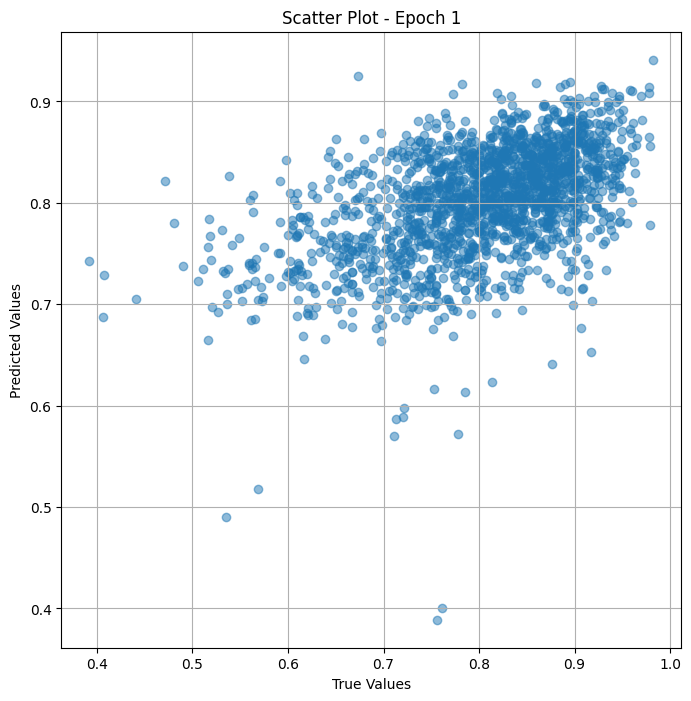

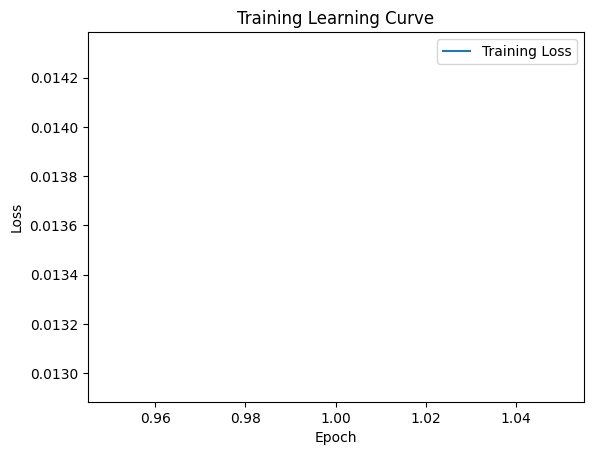


 Epoch: (2/30) Loss = 0.002754066837951541

 Epoch: (2/30) Loss_rmse = 0.052479203790426254

 Epoch: (2/30) R^2 = 0.8846089243888855

 Epoch: (2/30) MAE = 0.0352155864238739
Spearman correlation coefficient: SignificanceResult(statistic=0.6952681999130106, pvalue=5.103102846529652e-259)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 

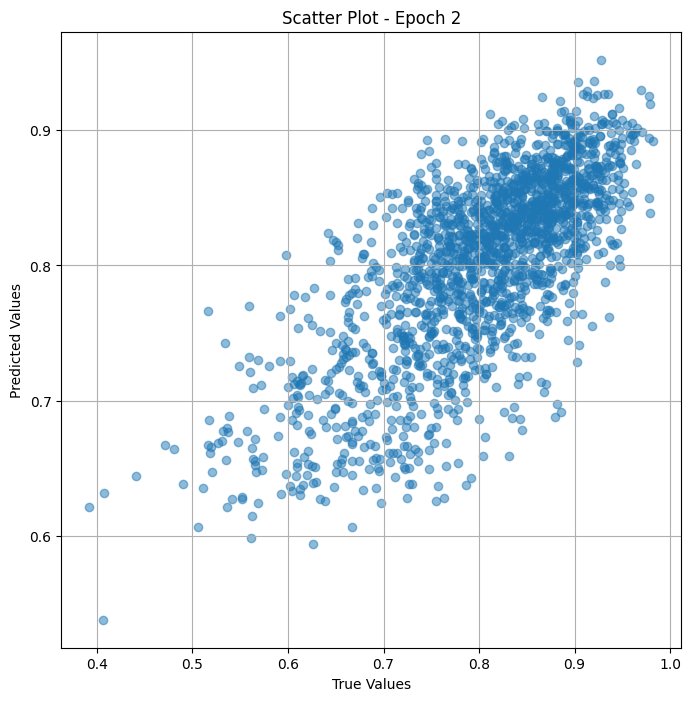

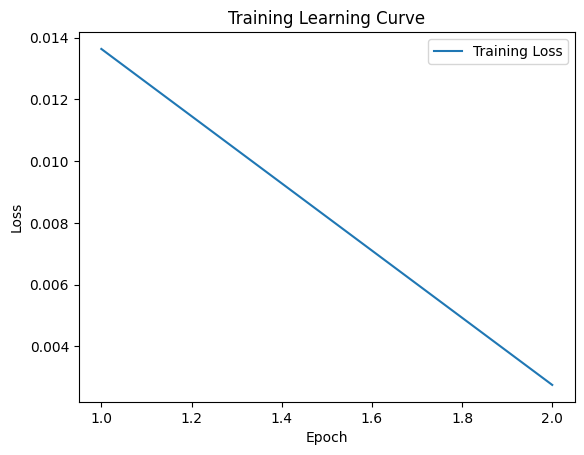


 Epoch: (3/30) Loss = 0.00021758436923846602

 Epoch: (3/30) Loss_rmse = 0.014750741422176361

 Epoch: (3/30) R^2 = 0.9908835291862488

 Epoch: (3/30) MAE = 0.011316463351249695
Spearman correlation coefficient: SignificanceResult(statistic=0.8313063133514016, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.90

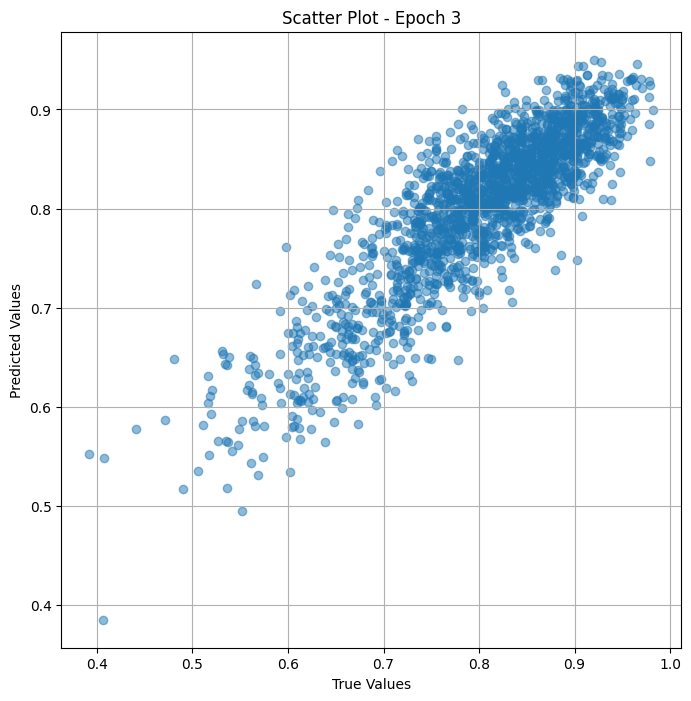

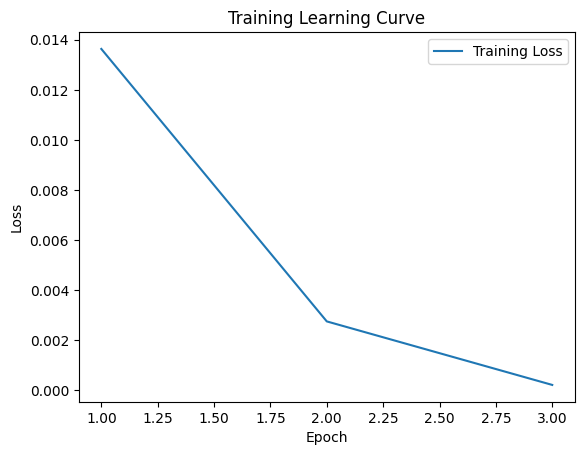


 Epoch: (4/30) Loss = 0.0024385028518736362

 Epoch: (4/30) Loss_rmse = 0.04938120022416115

 Epoch: (4/30) R^2 = 0.8978305459022522

 Epoch: (4/30) MAE = 0.042555809020996094
Spearman correlation coefficient: SignificanceResult(statistic=0.8923463823343386, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.9081

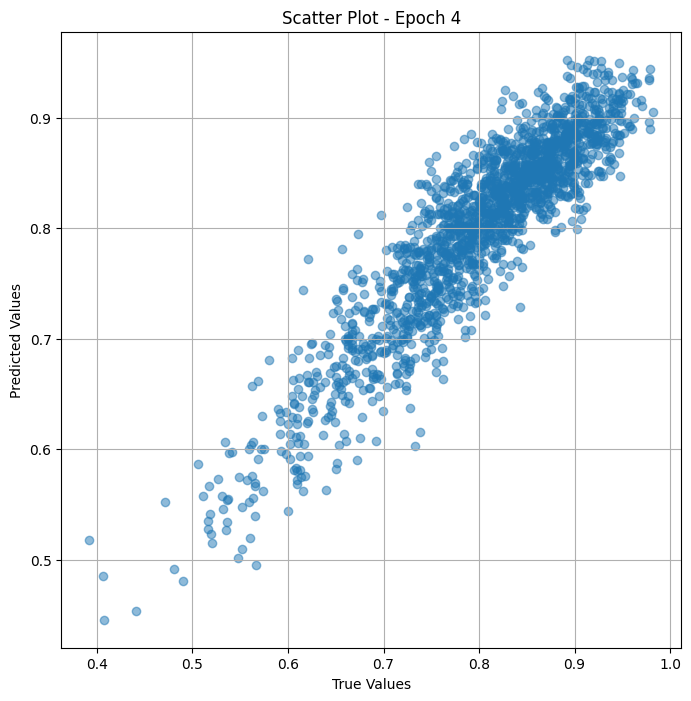

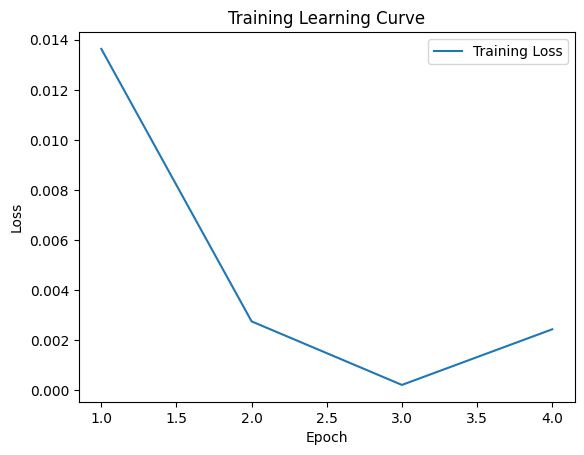


 Epoch: (5/30) Loss = 0.001609566155821085

 Epoch: (5/30) Loss_rmse = 0.04011939838528633

 Epoch: (5/30) R^2 = 0.9325616955757141

 Epoch: (5/30) MAE = 0.031936660408973694
Spearman correlation coefficient: SignificanceResult(statistic=0.8526659012441277, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.90816

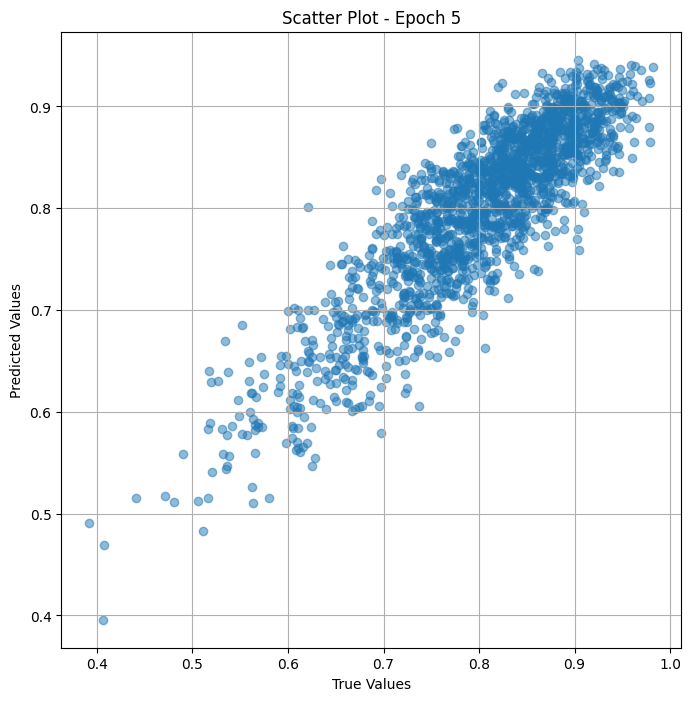

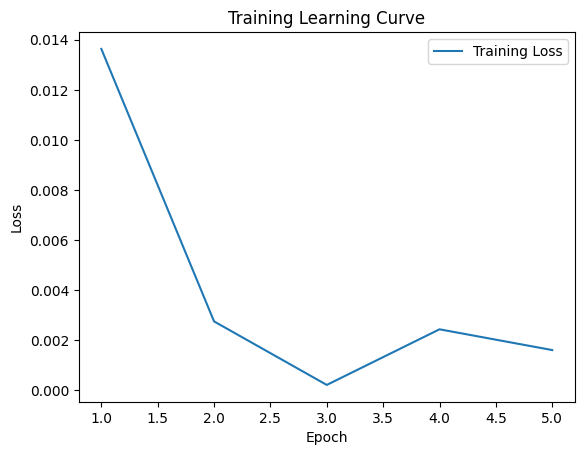

Epoch 0.07: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (6/30) Loss = 0.005228804424405098

 Epoch: (6/30) Loss_rmse = 0.07231047004461288

 Epoch: (6/30) R^2 = 0.7809213399887085

 Epoch: (6/30) MAE = 0.06079677864909172
Spearman correlation coefficient: SignificanceResult(statistic=0.7836155004541155, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9

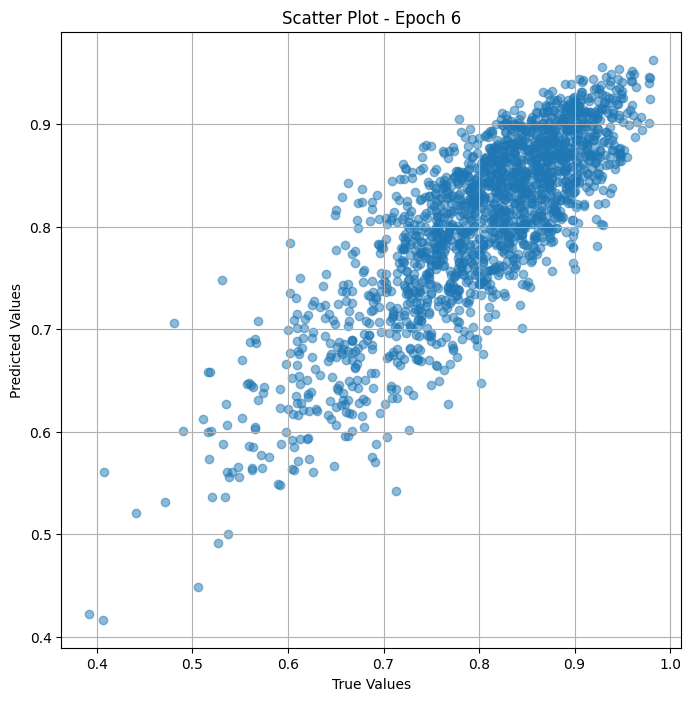

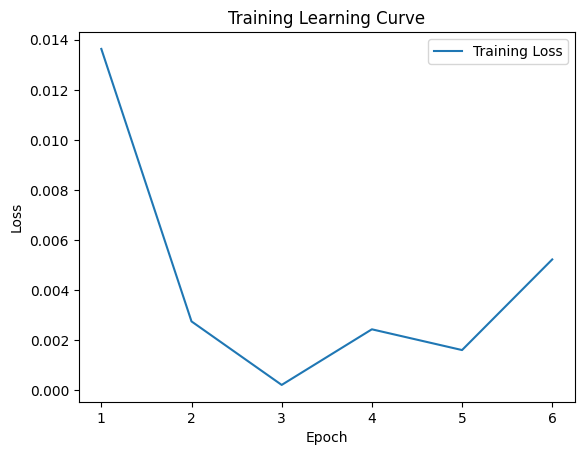


 Epoch: (7/30) Loss = 0.00036570083466358483

 Epoch: (7/30) Loss_rmse = 0.01912330649793148

 Epoch: (7/30) R^2 = 0.9846777319908142

 Epoch: (7/30) MAE = 0.016528956592082977
Spearman correlation coefficient: SignificanceResult(statistic=0.9477005025079265, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.908

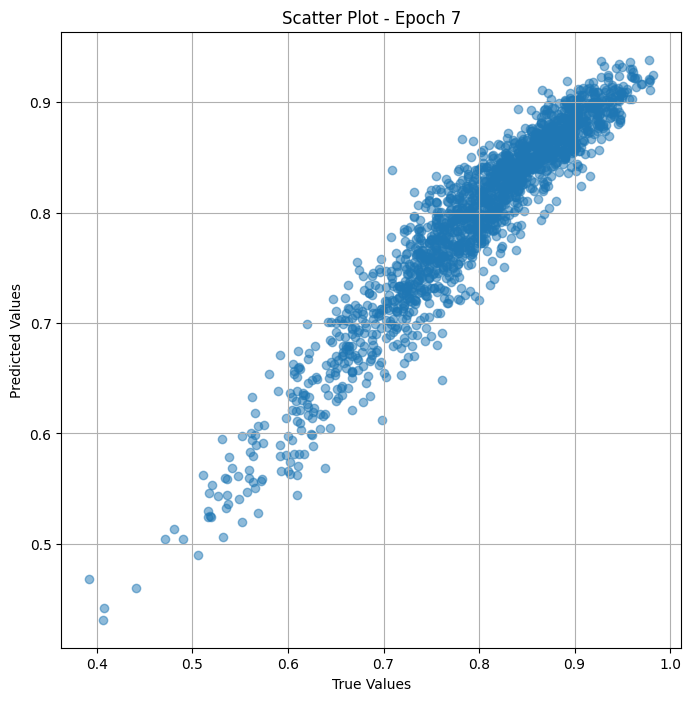

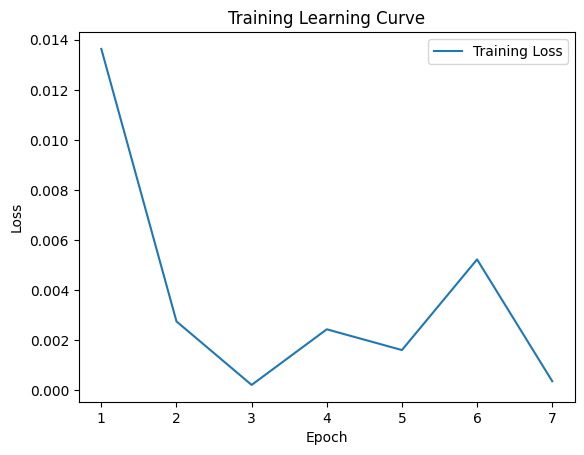


 Epoch: (8/30) Loss = 0.00027979013975709677

 Epoch: (8/30) Loss_rmse = 0.01672692783176899

 Epoch: (8/30) R^2 = 0.9882772564888

 Epoch: (8/30) MAE = 0.014659982174634933
Spearman correlation coefficient: SignificanceResult(statistic=0.9610937955506891, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.908163

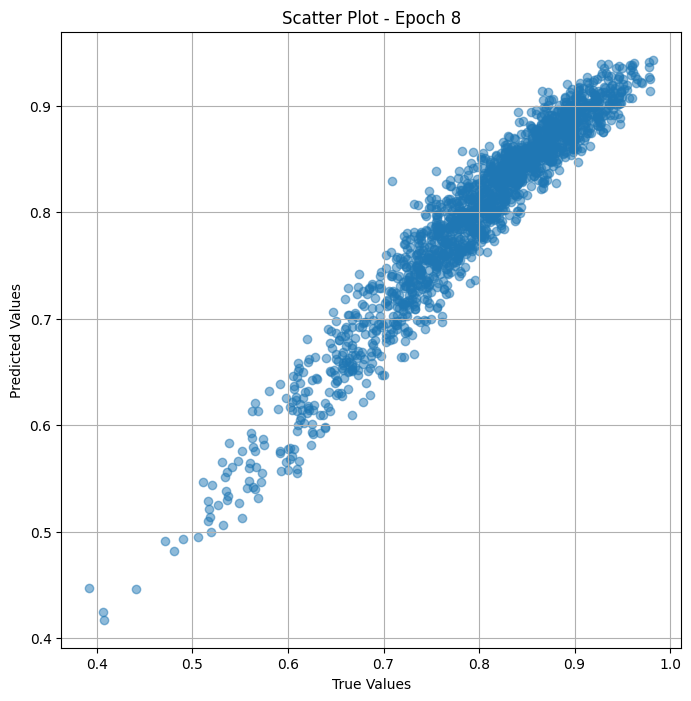

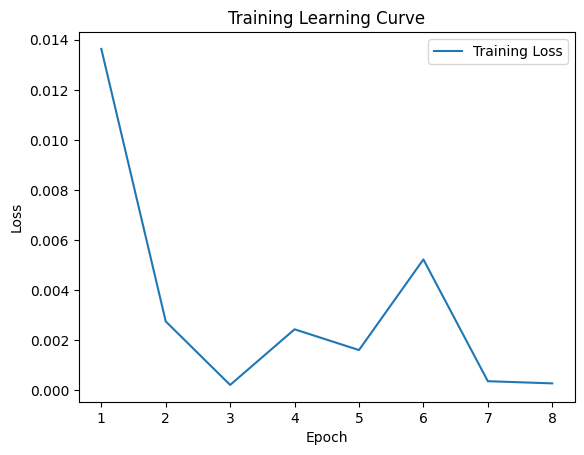


 Epoch: (9/30) Loss = 0.00021119635493960232

 Epoch: (9/30) Loss_rmse = 0.014532595872879028

 Epoch: (9/30) R^2 = 0.9911512136459351

 Epoch: (9/30) MAE = 0.012803465127944946
Spearman correlation coefficient: SignificanceResult(statistic=0.9672303549501384, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.90

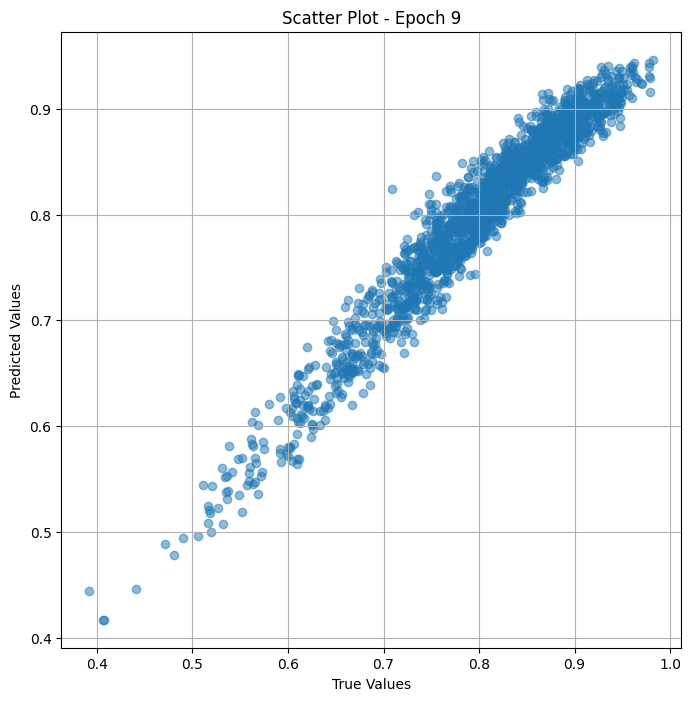

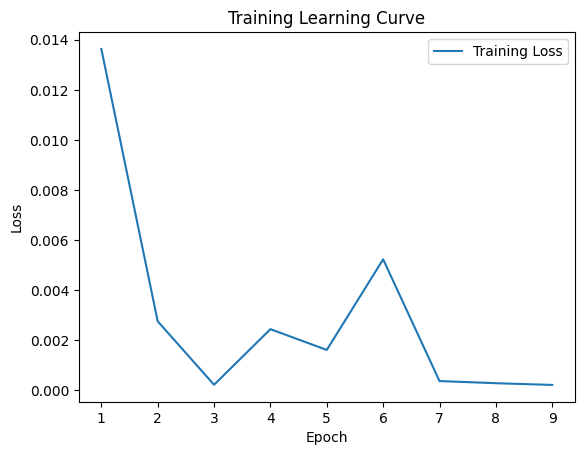


 Epoch: (10/30) Loss = 0.00015369959874078631

 Epoch: (10/30) Loss_rmse = 0.012397564016282558

 Epoch: (10/30) R^2 = 0.993560254573822

 Epoch: (10/30) MAE = 0.010819528251886368
Spearman correlation coefficient: SignificanceResult(statistic=0.9719184128794699, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

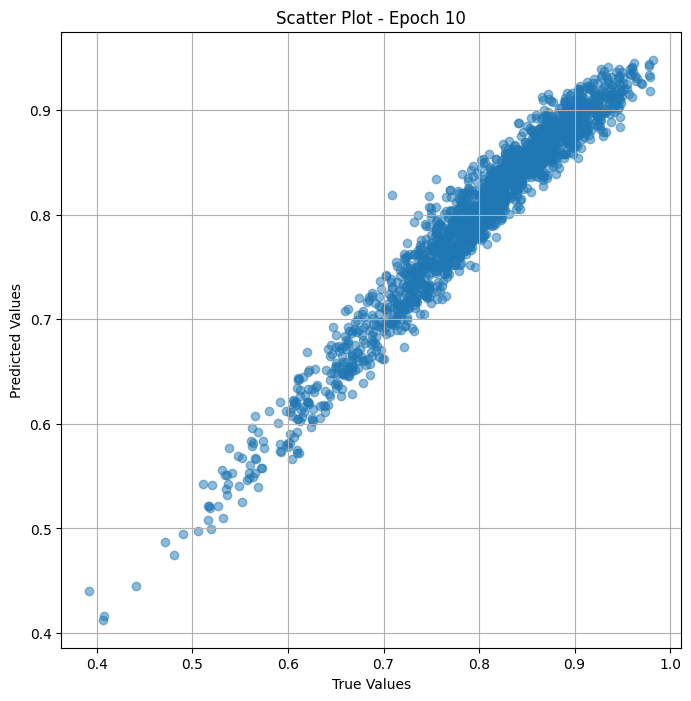

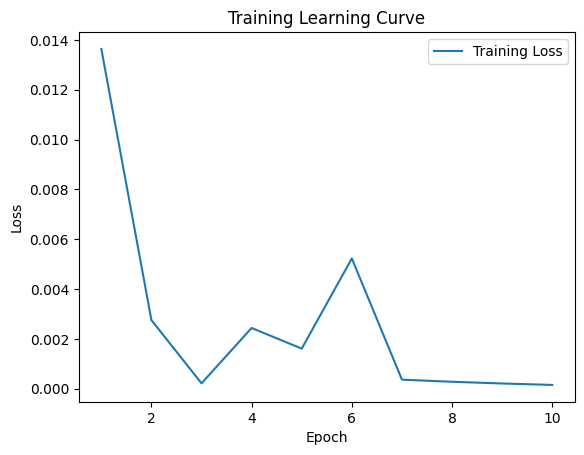


 Epoch: (11/30) Loss = 0.00011177807027706876

 Epoch: (11/30) Loss_rmse = 0.010572514496743679

 Epoch: (11/30) R^2 = 0.9953166842460632

 Epoch: (11/30) MAE = 0.009019207209348679
Spearman correlation coefficient: SignificanceResult(statistic=0.9757989935451394, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 

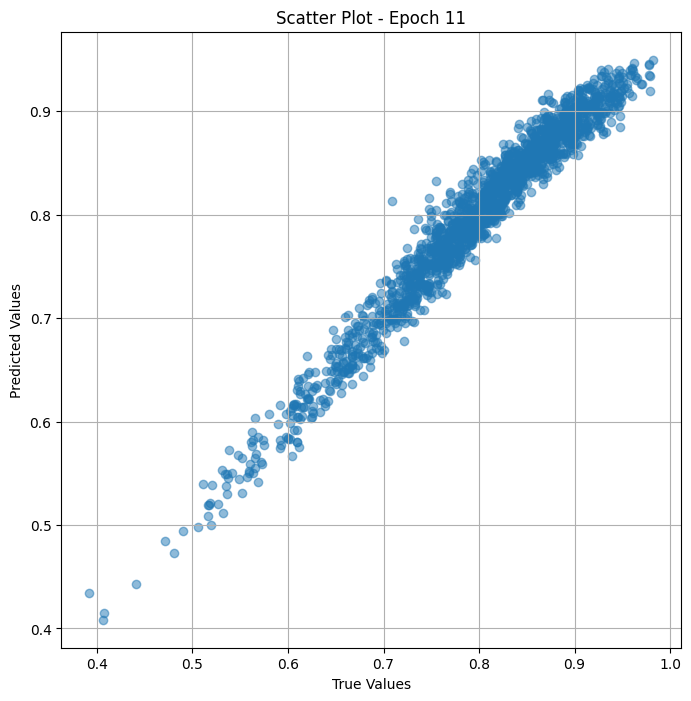

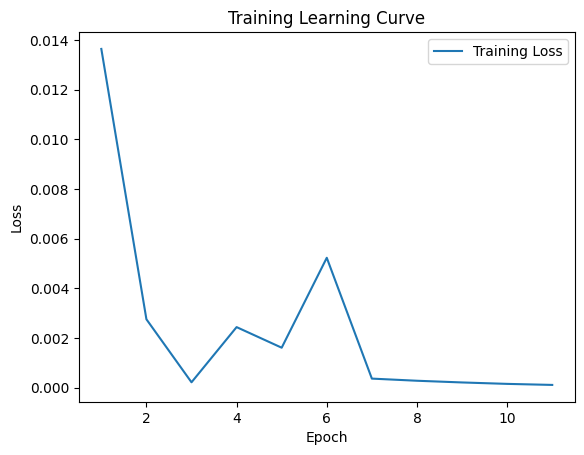


 Epoch: (12/30) Loss = 7.5015879701823e-05

 Epoch: (12/30) Loss_rmse = 0.008661170490086079

 Epoch: (12/30) R^2 = 0.9968569278717041

 Epoch: (12/30) MAE = 0.007166370749473572
Spearman correlation coefficient: SignificanceResult(statistic=0.9793912680271362, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.9

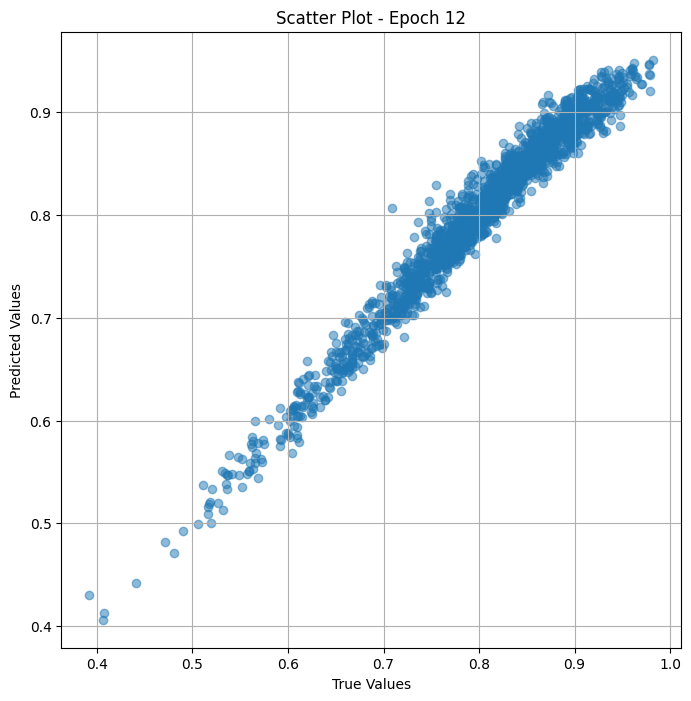

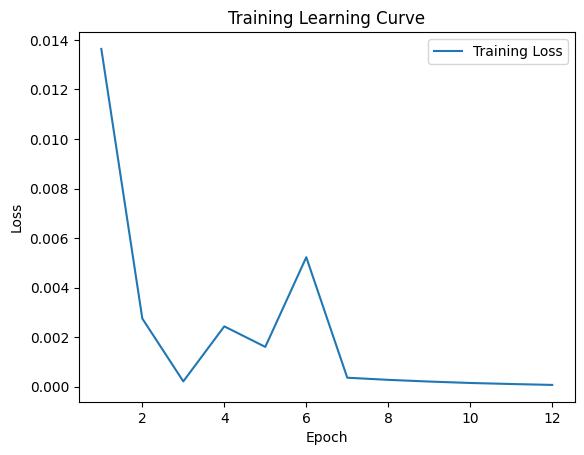


 Epoch: (13/30) Loss = 5.2461036830209196e-05

 Epoch: (13/30) Loss_rmse = 0.007242999039590359

 Epoch: (13/30) R^2 = 0.9978019595146179

 Epoch: (13/30) MAE = 0.006129413843154907
Spearman correlation coefficient: SignificanceResult(statistic=0.982422345982114, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

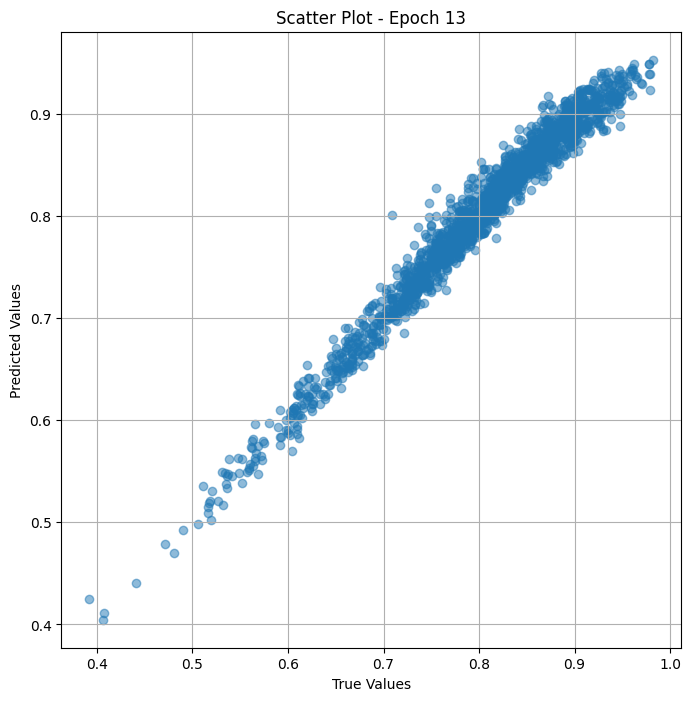

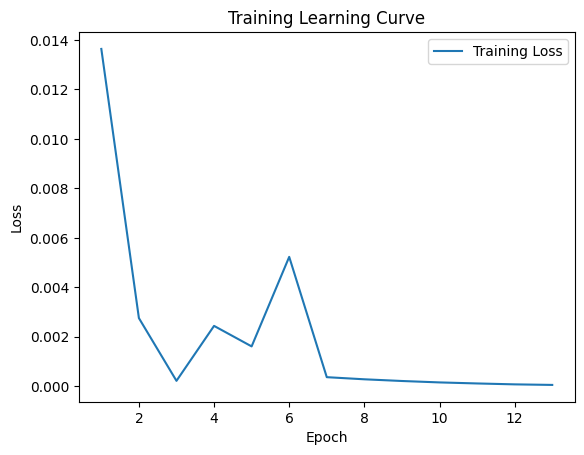


 Epoch: (14/30) Loss = 3.7185862311162055e-05

 Epoch: (14/30) Loss_rmse = 0.006098021287471056

 Epoch: (14/30) R^2 = 0.9984419941902161

 Epoch: (14/30) MAE = 0.0051395222544670105
Spearman correlation coefficient: SignificanceResult(statistic=0.985028352217398, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 

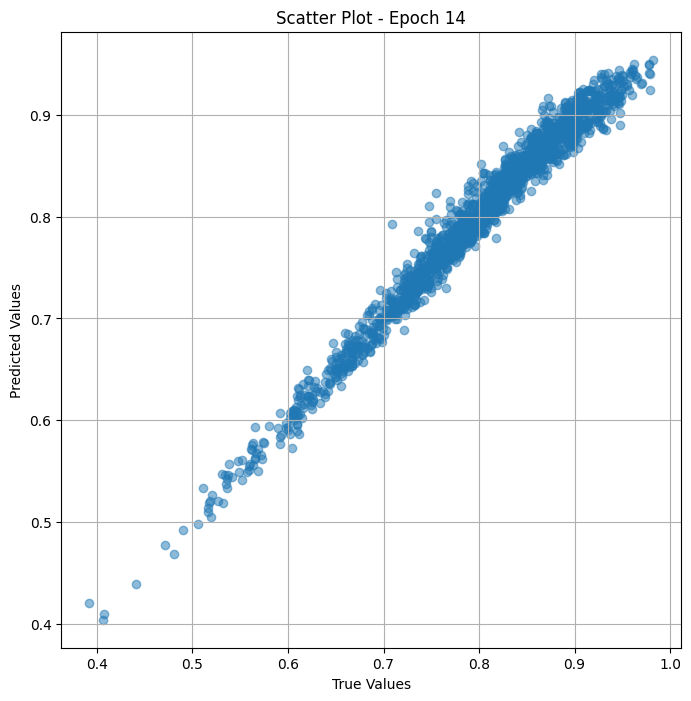

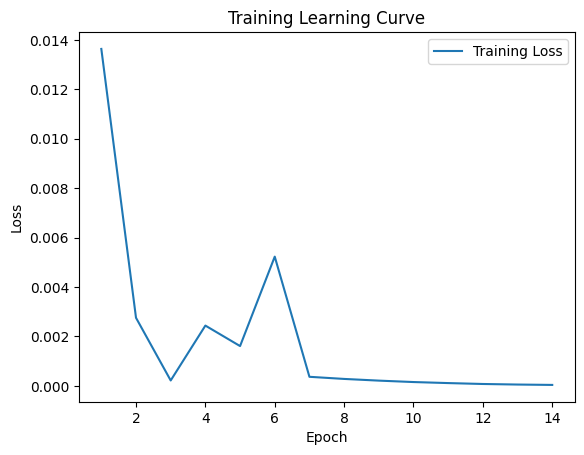


 Epoch: (15/30) Loss = 2.6774347134050913e-05

 Epoch: (15/30) Loss_rmse = 0.0051743932999670506

 Epoch: (15/30) R^2 = 0.9988781809806824

 Epoch: (15/30) MAE = 0.004297010600566864
Spearman correlation coefficient: SignificanceResult(statistic=0.9872923822861269, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

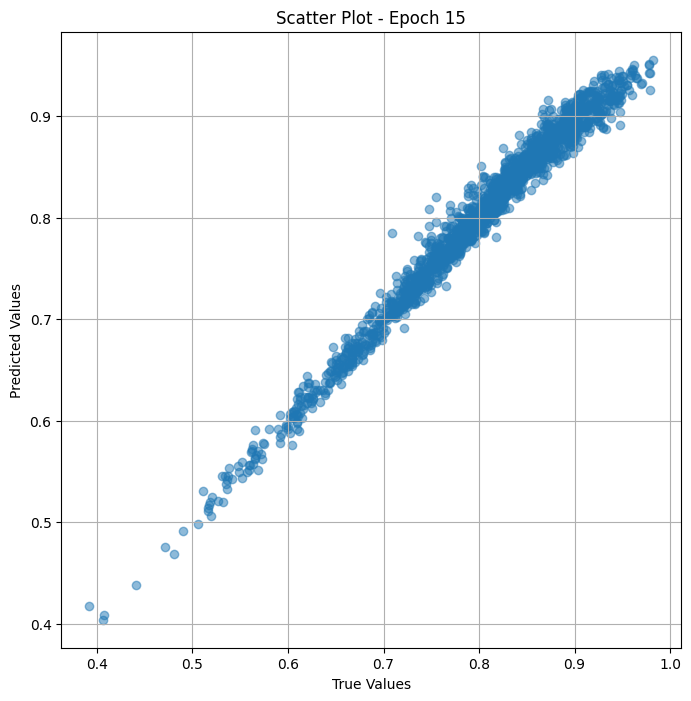

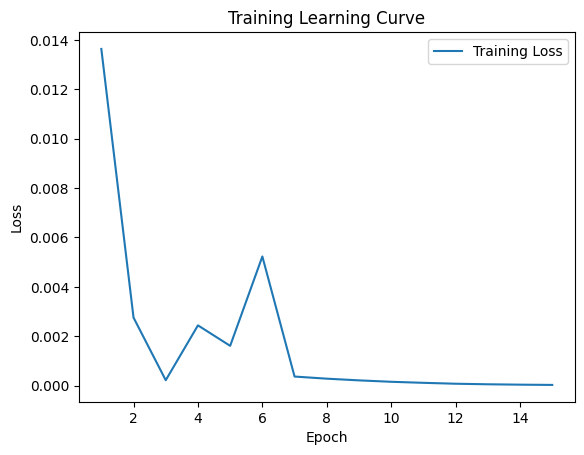


 Epoch: (16/30) Loss = 1.989978954952676e-05

 Epoch: (16/30) Loss_rmse = 0.0044609177857637405

 Epoch: (16/30) R^2 = 0.9991662502288818

 Epoch: (16/30) MAE = 0.003584735095500946
Spearman correlation coefficient: SignificanceResult(statistic=0.9892332325416433, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 

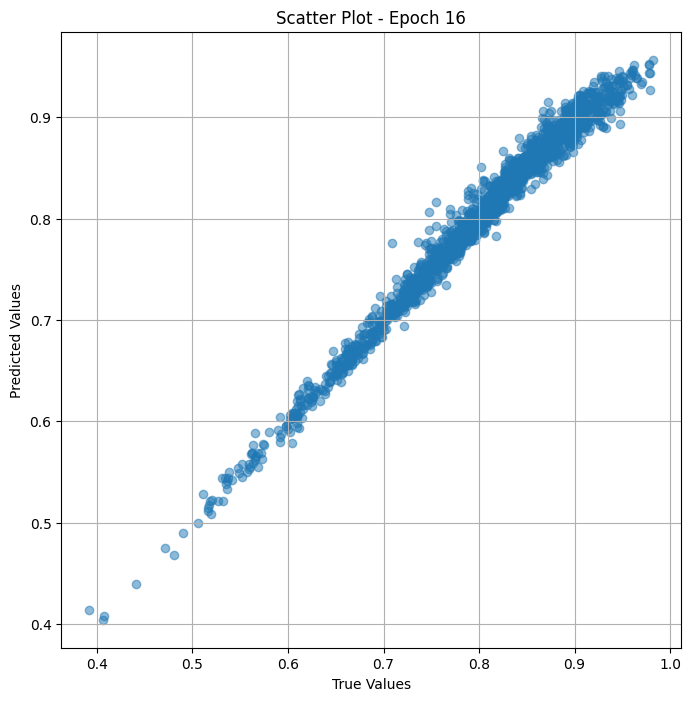

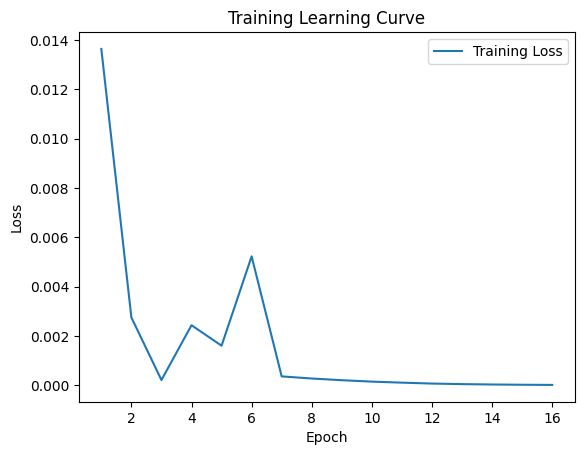


 Epoch: (17/30) Loss = 1.5113065273908433e-05

 Epoch: (17/30) Loss_rmse = 0.003887552535161376

 Epoch: (17/30) R^2 = 0.9993667602539062

 Epoch: (17/30) MAE = 0.00295209139585495
Spearman correlation coefficient: SignificanceResult(statistic=0.9908570066770385, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

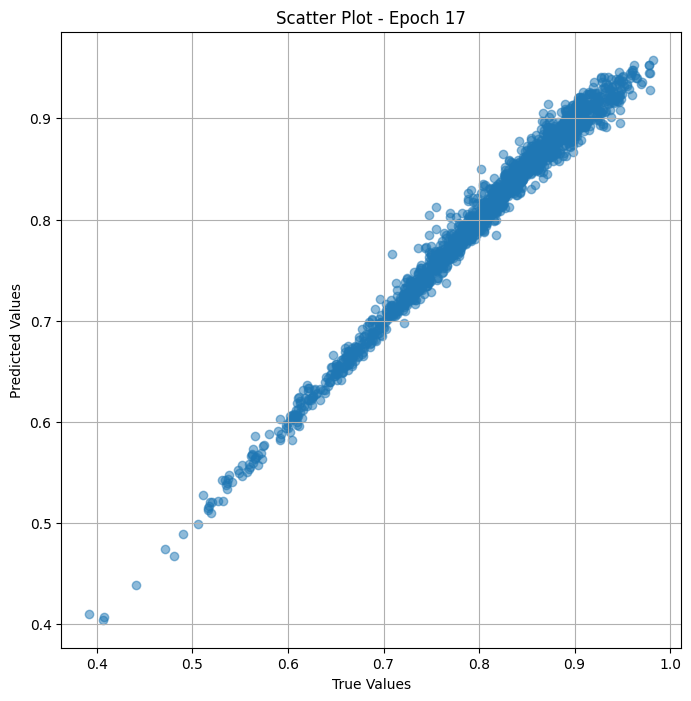

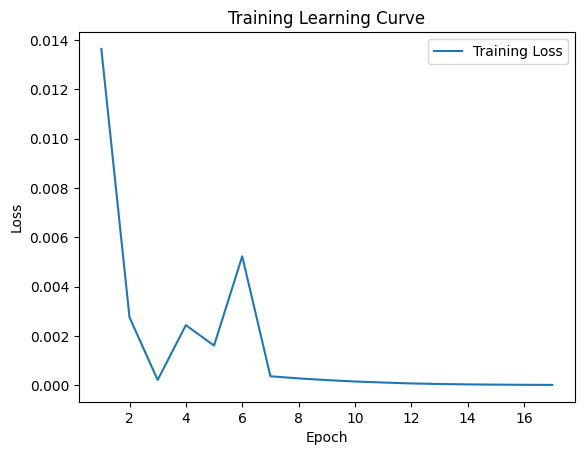


 Epoch: (18/30) Loss = 1.1718950190697797e-05

 Epoch: (18/30) Loss_rmse = 0.0034232952166348696

 Epoch: (18/30) R^2 = 0.9995089769363403

 Epoch: (18/30) MAE = 0.002402380108833313
Spearman correlation coefficient: SignificanceResult(statistic=0.9923839572076698, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

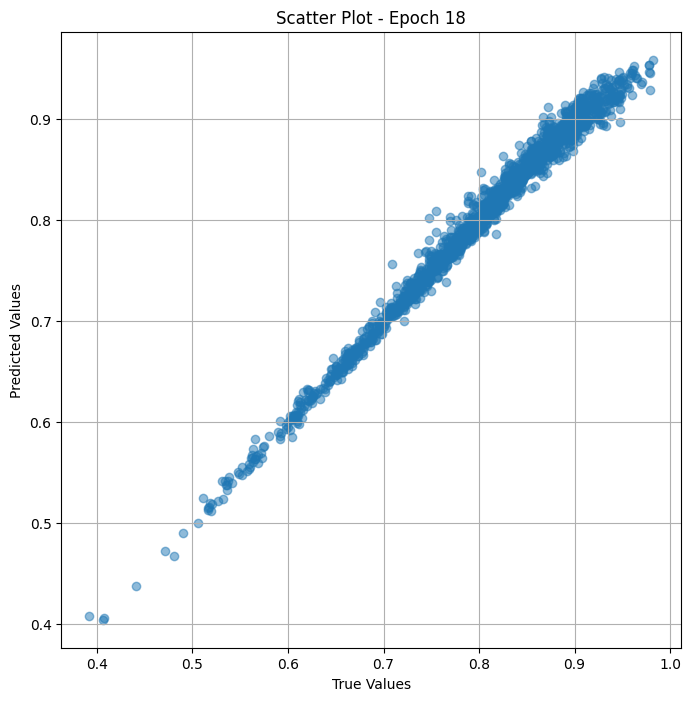

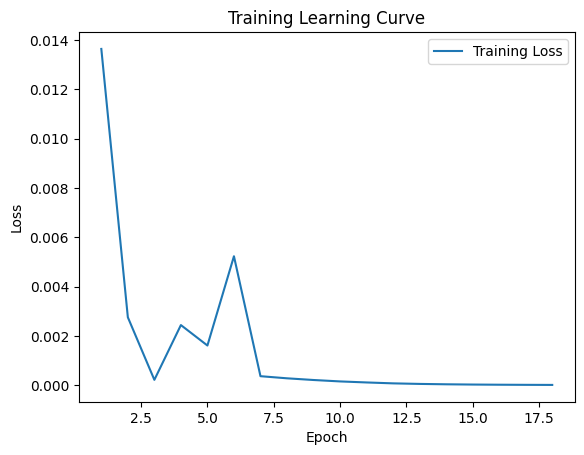


 Epoch: (19/30) Loss = 9.347799277747981e-06

 Epoch: (19/30) Loss_rmse = 0.003057416994124651

 Epoch: (19/30) R^2 = 0.9996083378791809

 Epoch: (19/30) MAE = 0.0020263008773326874
Spearman correlation coefficient: SignificanceResult(statistic=0.9936482647118388, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 

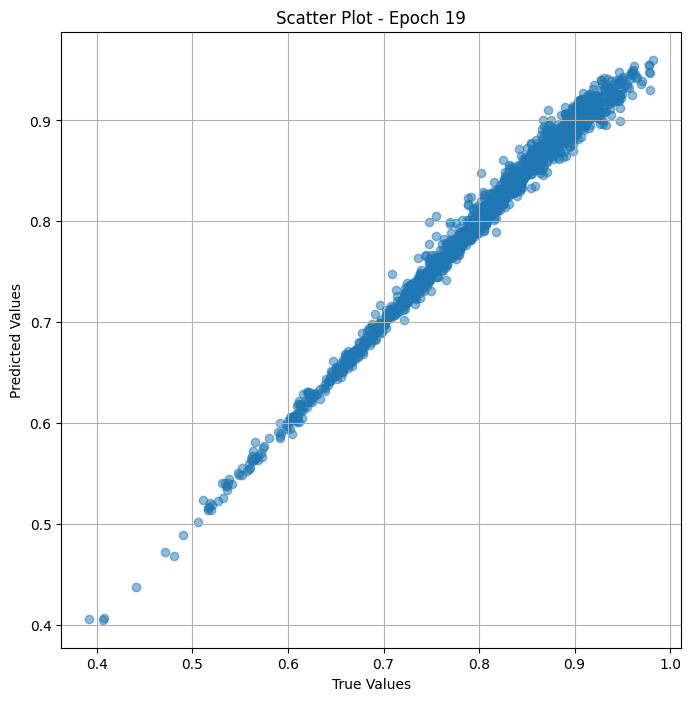

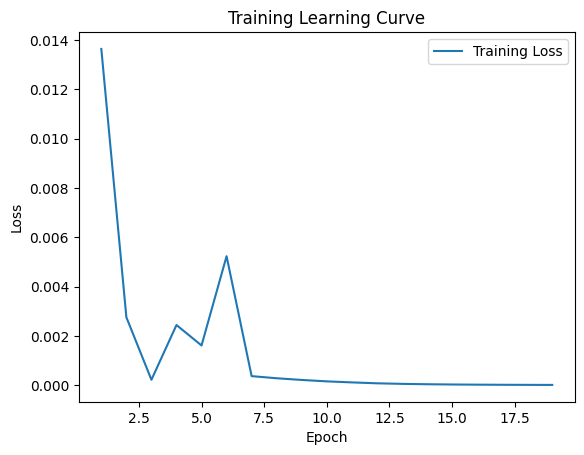


 Epoch: (20/30) Loss = 7.319968062802218e-06

 Epoch: (20/30) Loss_rmse = 0.0027055440004915

 Epoch: (20/30) R^2 = 0.9996933341026306

 Epoch: (20/30) MAE = 0.001816287636756897
Spearman correlation coefficient: SignificanceResult(statistic=0.9947103147986497, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.9

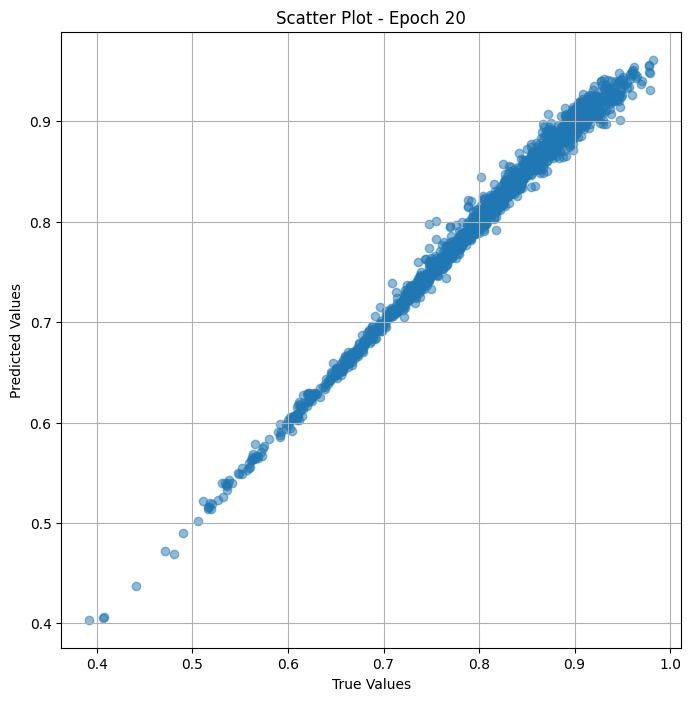

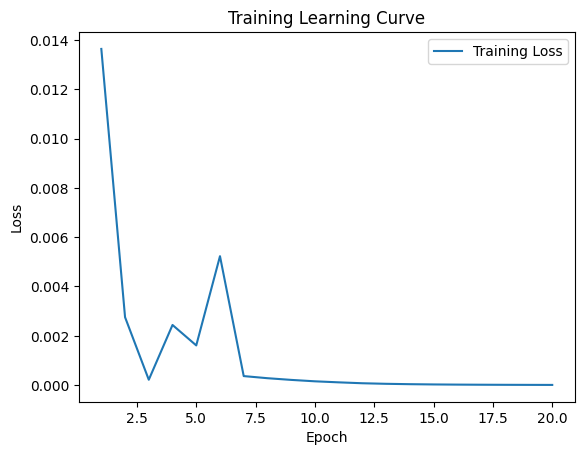


 Epoch: (21/30) Loss = 5.522880201169755e-06

 Epoch: (21/30) Loss_rmse = 0.00235008099116385

 Epoch: (21/30) R^2 = 0.9997686147689819

 Epoch: (21/30) MAE = 0.0015320256352424622
Spearman correlation coefficient: SignificanceResult(statistic=0.9955782250181621, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

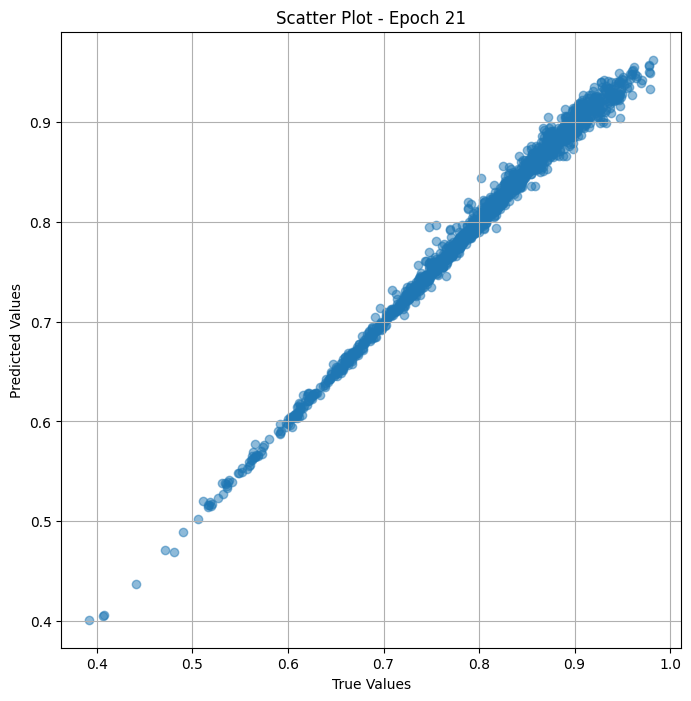

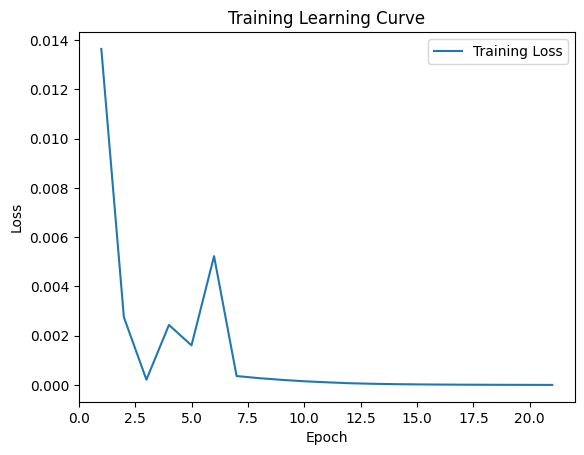


 Epoch: (22/30) Loss = 4.282362624508096e-06

 Epoch: (22/30) Loss_rmse = 0.0020693871192634106

 Epoch: (22/30) R^2 = 0.9998205900192261

 Epoch: (22/30) MAE = 0.0014304257929325104
Spearman correlation coefficient: SignificanceResult(statistic=0.9963707766621649, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

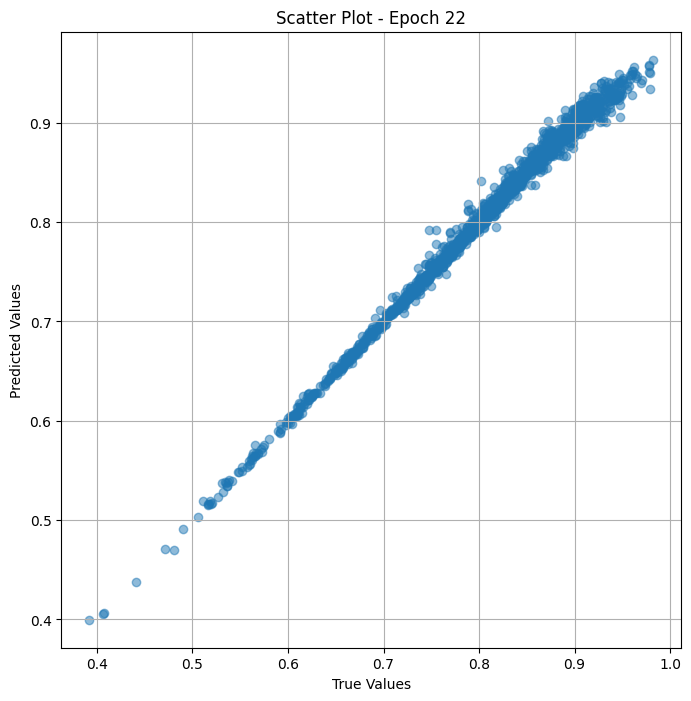

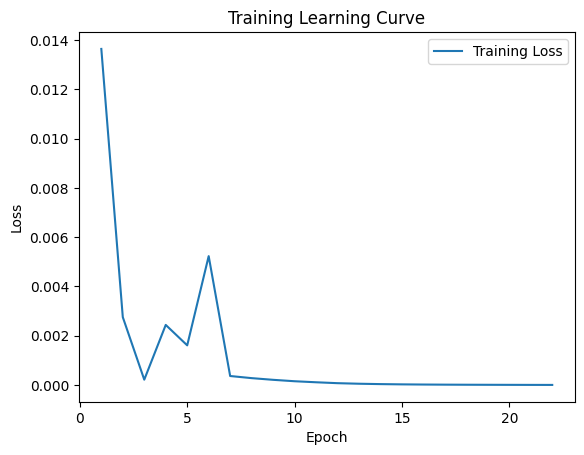


 Epoch: (23/30) Loss = 3.0705118660989683e-06

 Epoch: (23/30) Loss_rmse = 0.0017522876150906086

 Epoch: (23/30) R^2 = 0.9998713731765747

 Epoch: (23/30) MAE = 0.001189935952425003
Spearman correlation coefficient: SignificanceResult(statistic=0.9969863744353491, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

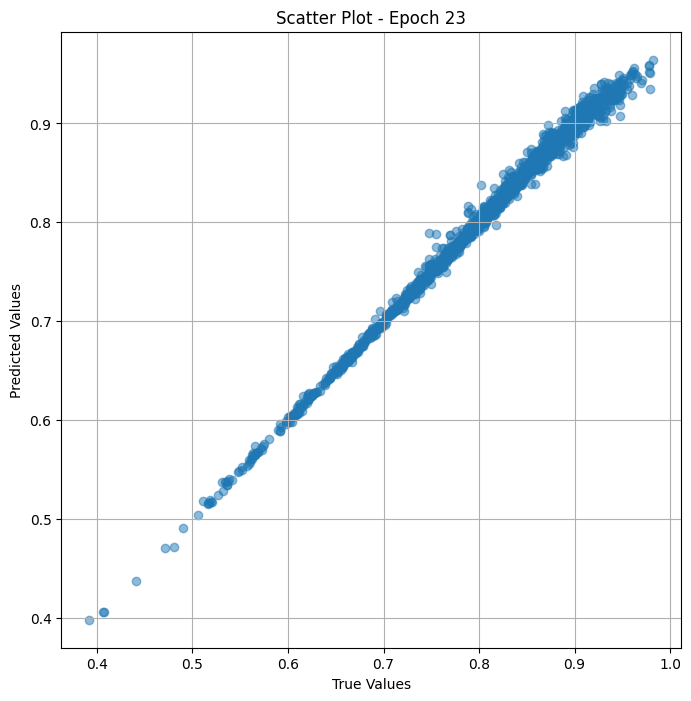

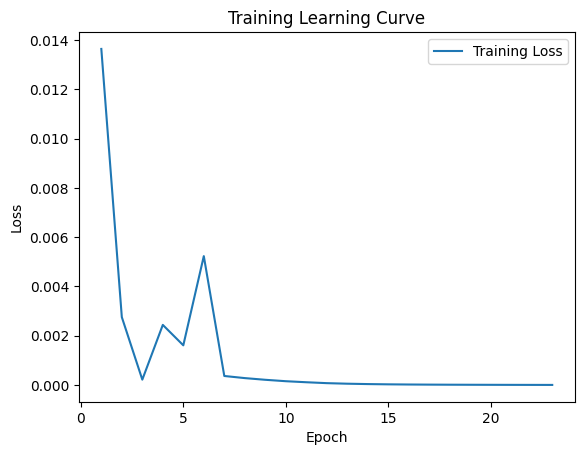


 Epoch: (24/30) Loss = 2.139549451385392e-06

 Epoch: (24/30) Loss_rmse = 0.0014627198688685894

 Epoch: (24/30) R^2 = 0.9999103546142578

 Epoch: (24/30) MAE = 0.0010343044996261597
Spearman correlation coefficient: SignificanceResult(statistic=0.997525900465024, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 

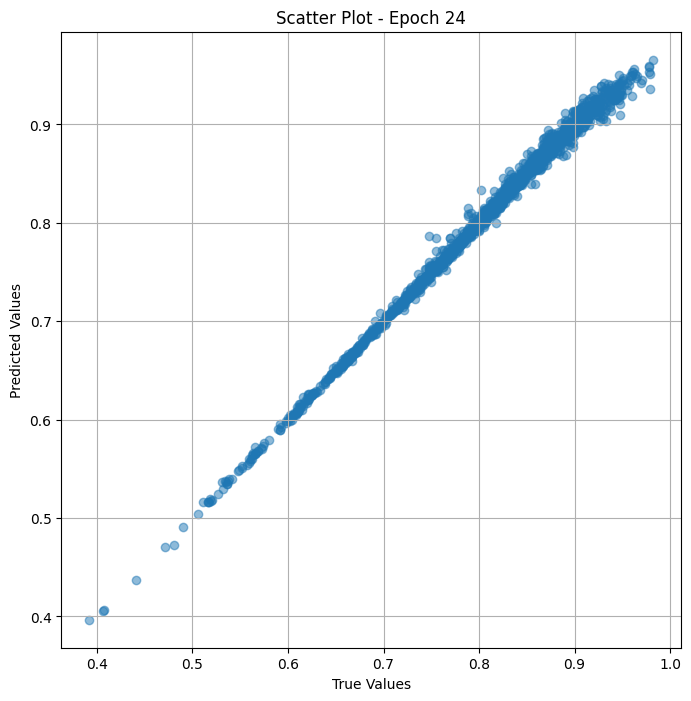

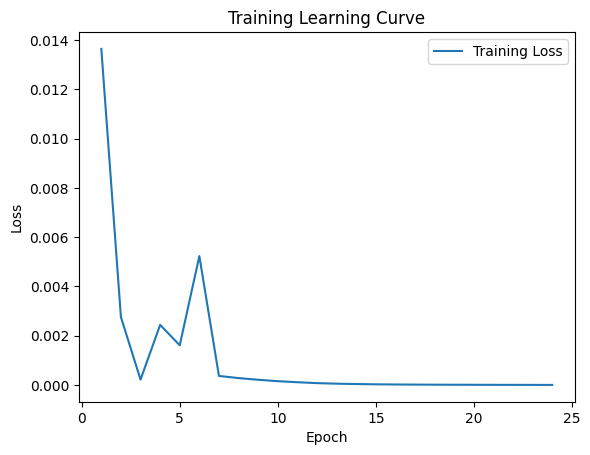


 Epoch: (25/30) Loss = 1.4763538729312131e-06

 Epoch: (25/30) Loss_rmse = 0.0012150530237704515

 Epoch: (25/30) R^2 = 0.9999381303787231

 Epoch: (25/30) MAE = 0.0008824877440929413
Spearman correlation coefficient: SignificanceResult(statistic=0.9979486502138701, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391

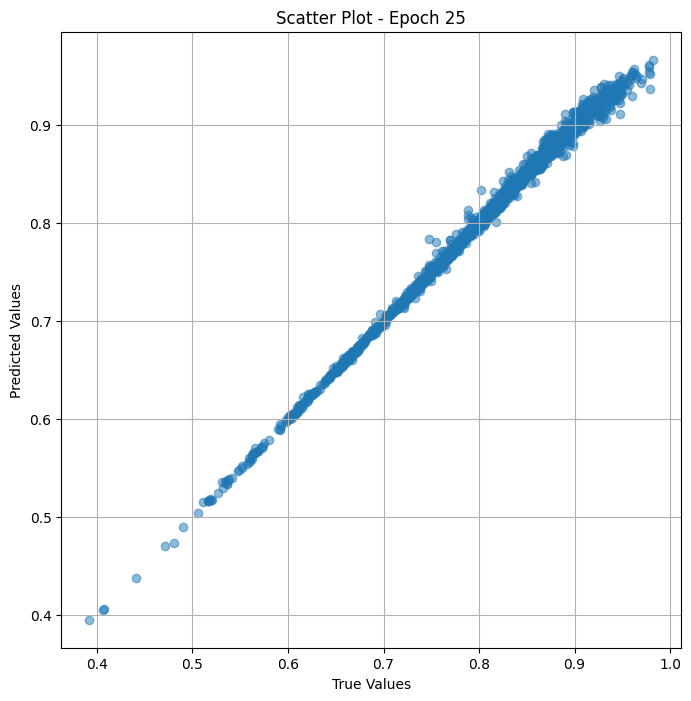

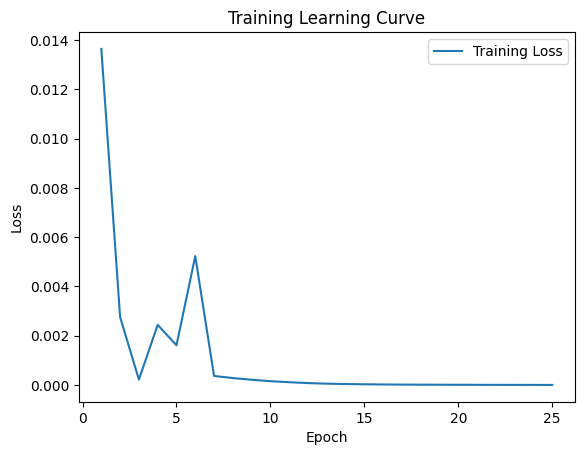


 Epoch: (26/30) Loss = 1.073667363016284e-06

 Epoch: (26/30) Loss_rmse = 0.0010361792519688606

 Epoch: (26/30) R^2 = 0.9999549984931946

 Epoch: (26/30) MAE = 0.0007947348058223724
Spearman correlation coefficient: SignificanceResult(statistic=0.9982783929743761, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

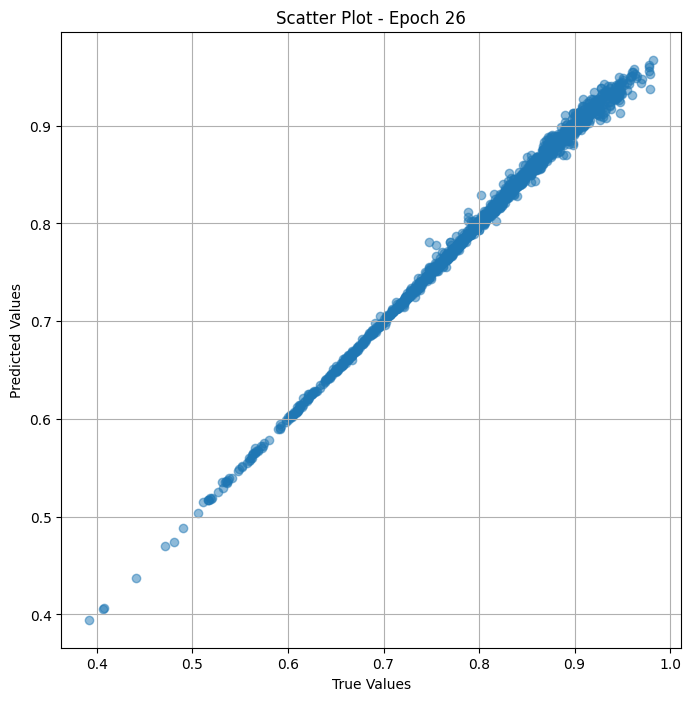

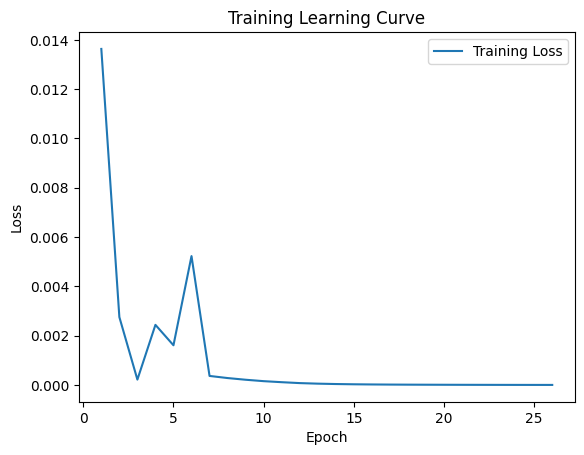


 Epoch: (27/30) Loss = 7.23569769434107e-07

 Epoch: (27/30) Loss_rmse = 0.000850629061460495

 Epoch: (27/30) R^2 = 0.9999696612358093

 Epoch: (27/30) MAE = 0.0006821788847446442
Spearman correlation coefficient: SignificanceResult(statistic=0.9985539022948874, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

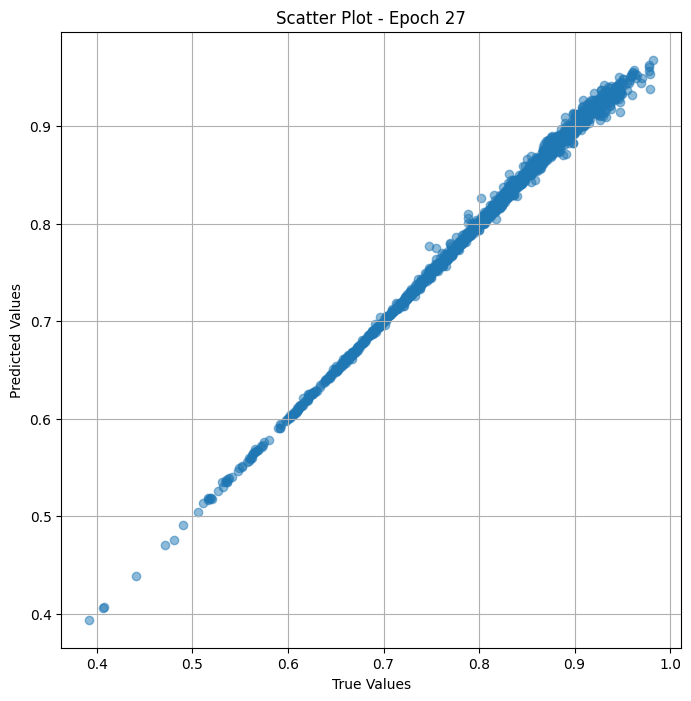

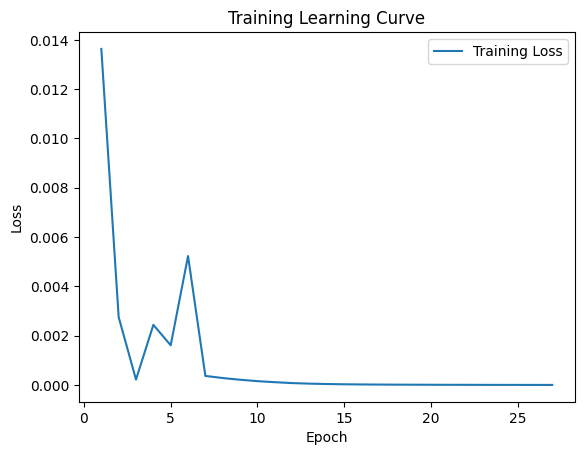


 Epoch: (28/30) Loss = 5.355244638849399e-07

 Epoch: (28/30) Loss_rmse = 0.0007317953859455884

 Epoch: (28/30) R^2 = 0.9999775886535645

 Epoch: (28/30) MAE = 0.0006018728017807007
Spearman correlation coefficient: SignificanceResult(statistic=0.9987619214001149, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

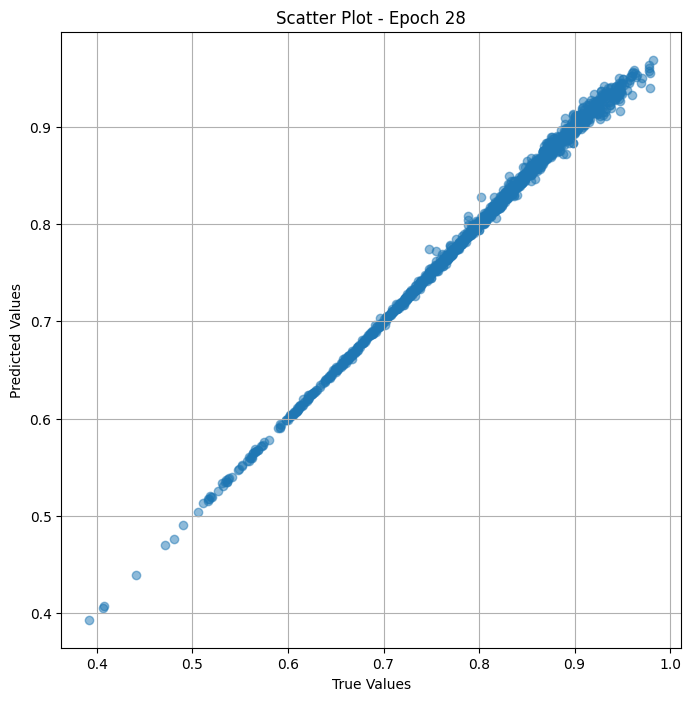

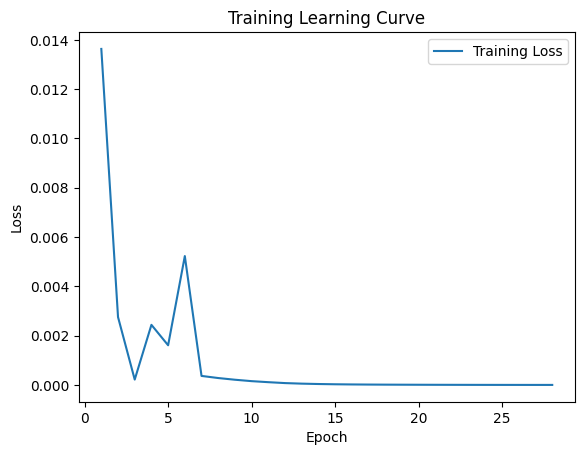


 Epoch: (29/30) Loss = 3.140909257126623e-07

 Epoch: (29/30) Loss_rmse = 0.0005604381440207362

 Epoch: (29/30) R^2 = 0.9999868273735046

 Epoch: (29/30) MAE = 0.0004901625216007233
Spearman correlation coefficient: SignificanceResult(statistic=0.9989471841468098, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

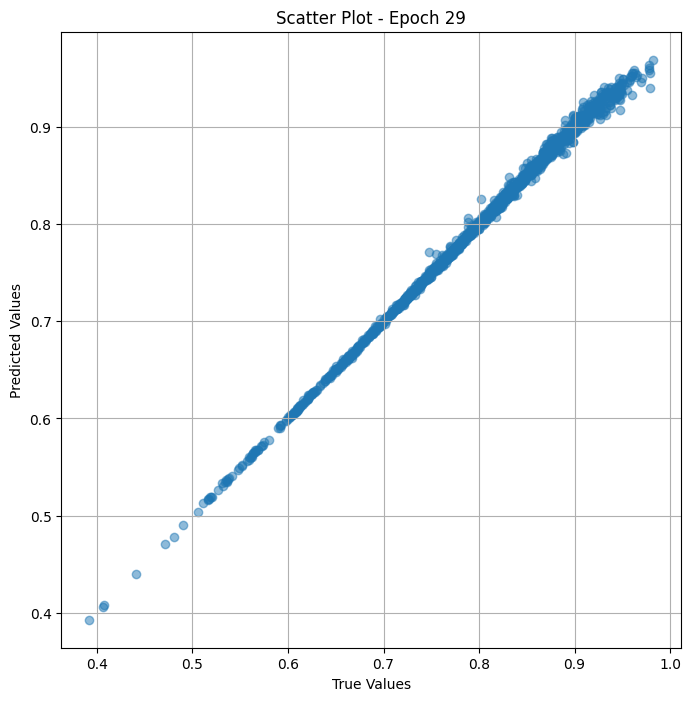

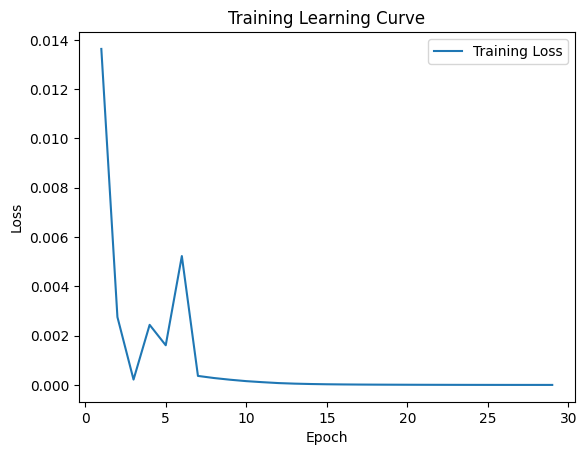


 Epoch: (30/30) Loss = 1.9935328054998536e-07

 Epoch: (30/30) Loss_rmse = 0.0004464899539016187

 Epoch: (30/30) R^2 = 0.9999916553497314

 Epoch: (30/30) MAE = 0.0003993287682533264
Spearman correlation coefficient: SignificanceResult(statistic=0.9990965880751624, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391

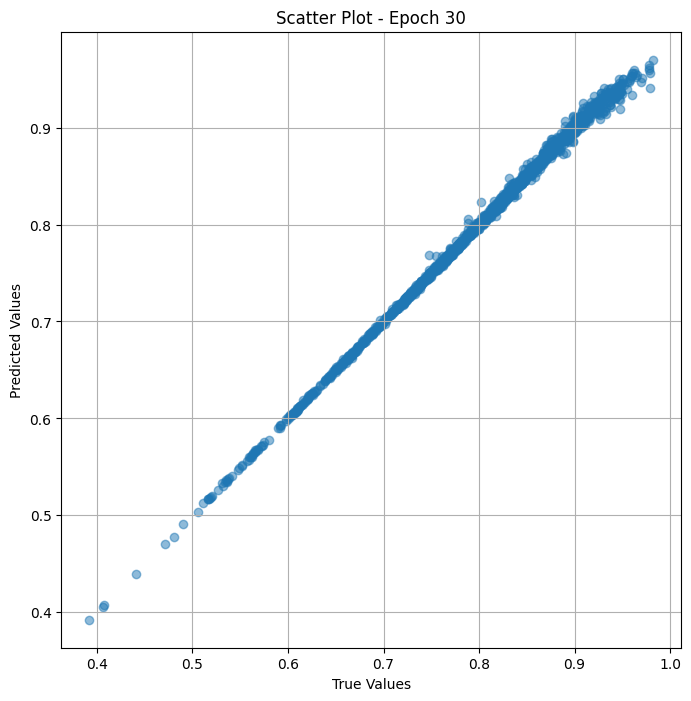

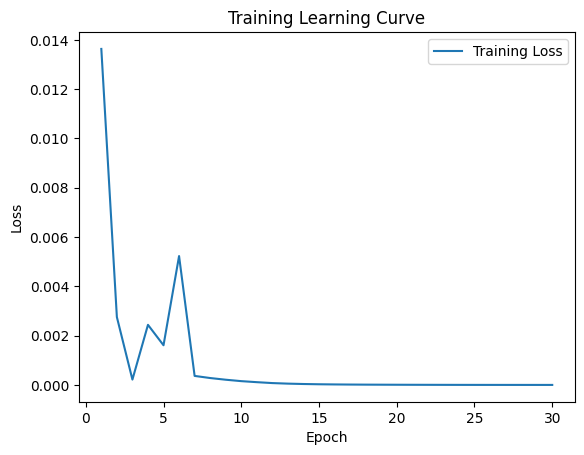

In [ ]:
# Training the model and save weights
fit(30, model_vit , train_dl)
torch.save(model_vit.state_dict(), "model_weights_1")

In [ ]:
true_values_list = []
predicted_values_list = []

for x_trans, yb in train_dl:
    preds = model_vit(x_trans)
    true_values_list.extend(yb.cpu().detach().numpy())
    predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_animal' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_train_animal['preprocessed_image_path'],
    'True Value': true_values_list,  # Replace with your actual true values
    'Predicted Value': predicted_values_list  # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)



                                            Image Path  True Value  \
0      /content/animal/n02342885_4843_preprocessed.jpg    0.936937   
1     /content/animal/n02450034_11655_preprocessed.jpg    0.610526   
2     /content/animal/n02450034_10783_preprocessed.jpg    0.873684   
3      /content/animal/n02450034_4350_preprocessed.jpg    0.729730   
4     /content/animal/n01514859_12292_preprocessed.jpg    0.759259   
...                                                ...         ...   
1795   /content/animal/n01811909_9916_preprocessed.jpg    0.712871   
1796     /content/animal/000000319211_preprocessed.jpg    0.736000   
1797   /content/animal/n01846331_1577_preprocessed.jpg    0.860000   
1798     /content/animal/000000388011_preprocessed.jpg    0.843137   
1799     /content/animal/000000427763_preprocessed.jpg    0.405941   

      Predicted Value  
0            0.940348  
1            0.610432  
2            0.874636  
3            0.729772  
4            0.759763  
...            

In [ ]:
from prettytable import PrettyTable

# Assuming 'df_result' is your DataFrame
# The 'Image Path' column should contain the paths to your images

# Create a PrettyTable instance
table = PrettyTable()

# Add column names
table.field_names = df_result.columns.tolist()

# Add rows
for _, row in df_result.iterrows():
    table.add_row(row.tolist())

# Display the table
print(table)

+--------------------------------------------------+------------+---------------------+
|                    Image Path                    | True Value |   Predicted Value   |
+--------------------------------------------------+------------+---------------------+
| /content/animal/n02342885_4843_preprocessed.jpg  | 0.9369369  |  0.9403477311134338 |
| /content/animal/n02450034_11655_preprocessed.jpg | 0.6105263  |  0.6104319095611572 |
| /content/animal/n02450034_10783_preprocessed.jpg | 0.8736842  |  0.8746359348297119 |
| /content/animal/n02450034_4350_preprocessed.jpg  | 0.7297297  |  0.7297718524932861 |
| /content/animal/n01514859_12292_preprocessed.jpg | 0.7592593  |  0.759763240814209  |
|  /content/animal/000000459451_preprocessed.jpg   | 0.9139785  |  0.9108946323394775 |
|  /content/animal/000000029341_preprocessed.jpg   | 0.77011496 |  0.7705625891685486 |
|  /content/animal/000000208724_preprocessed.jpg   | 0.8202247  |  0.8228590488433838 |
| /content/animal/n02129165_1870

## Valid

In [ ]:
class Dataset_val_animal(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_val_animal["memoscore"]
        self.images = df_val_animal["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
val_ds = Dataset_val_animal(df_val_animal, trans_transform=trans_transform)
val_dl = DataLoader(val_ds, batch_size=32, shuffle=False)

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
class ViTMem_model_val_animal(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_sval =  ViTMem_model_val_animal( arch="vit_base_patch16_224_miil")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_val_animal().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
val_dl = DeviceDataLoader(val_dl, device)
model_vit_sval  = to_device(model_vit_sval  , device)

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.034466832876205444

 Epoch: (1/30) Loss_rmse = 0.1856524497270584

 Epoch: (1/30) R^2 = -6.123223781585693

 Epoch: (1/30) MAE = 0.172498419880867
Spearman correlation coefficient: SignificanceResult(statistic=-0.000624001682382145, pvalue=0.9951857112000636)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 0.8404

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


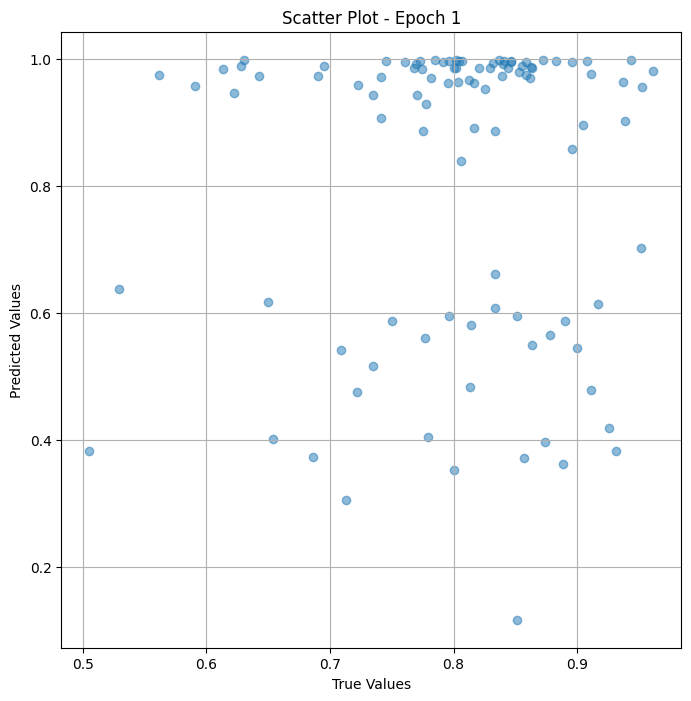

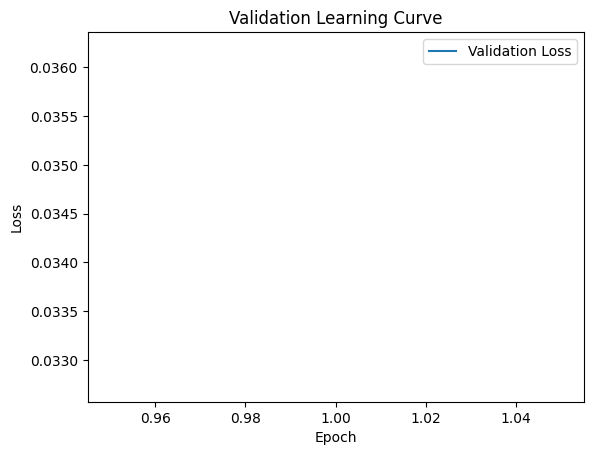


 Epoch: (2/30) Loss = 0.033620331436395645

 Epoch: (2/30) Loss_rmse = 0.18335847556591034

 Epoch: (2/30) R^2 = -5.948277950286865

 Epoch: (2/30) MAE = 0.170660600066185
Spearman correlation coefficient: SignificanceResult(statistic=0.03617853232419959, pvalue=0.7263785371719251)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 0.84042

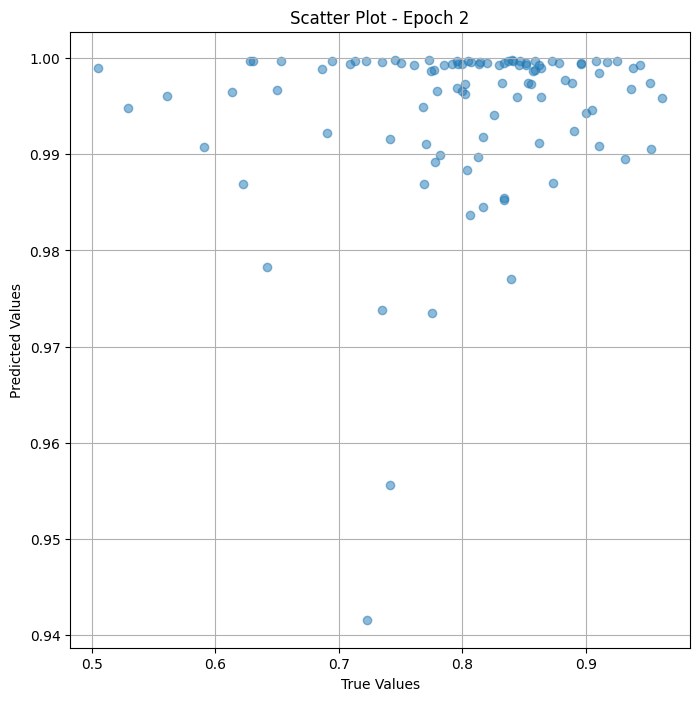

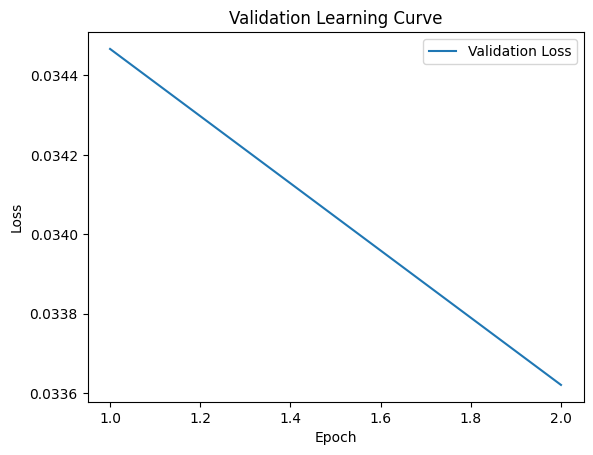


 Epoch: (3/30) Loss = 0.030279554426670074

 Epoch: (3/30) Loss_rmse = 0.17401021718978882

 Epoch: (3/30) R^2 = -5.257843017578125

 Epoch: (3/30) MAE = 0.1621331125497818
Spearman correlation coefficient: SignificanceResult(statistic=0.09891783191153483, pvalue=0.3376337612770194)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 0.8404

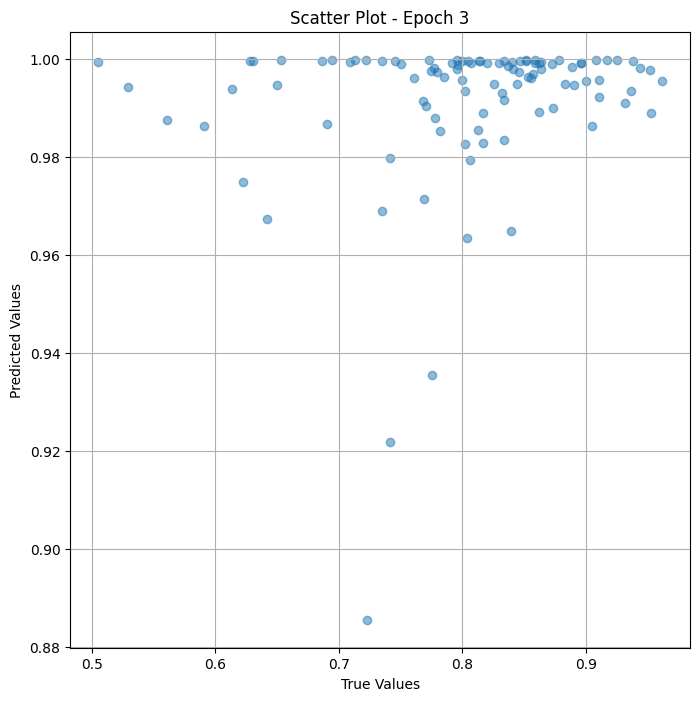

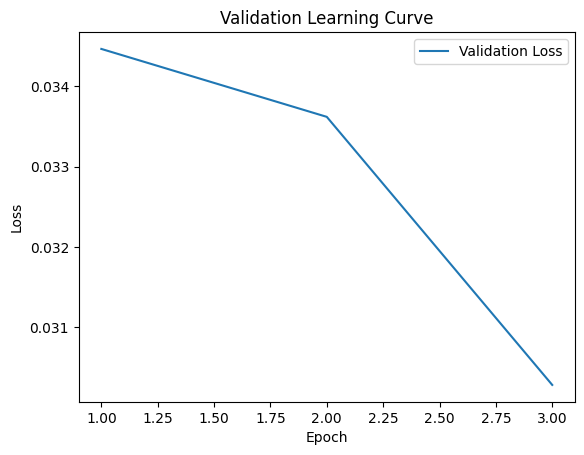


 Epoch: (4/30) Loss = 0.01334435772150755

 Epoch: (4/30) Loss_rmse = 0.11551778018474579

 Epoch: (4/30) R^2 = -1.757864236831665

 Epoch: (4/30) MAE = 0.10539849102497101
Spearman correlation coefficient: SignificanceResult(statistic=0.18739041827015113, pvalue=0.06751599572997172)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 0.840

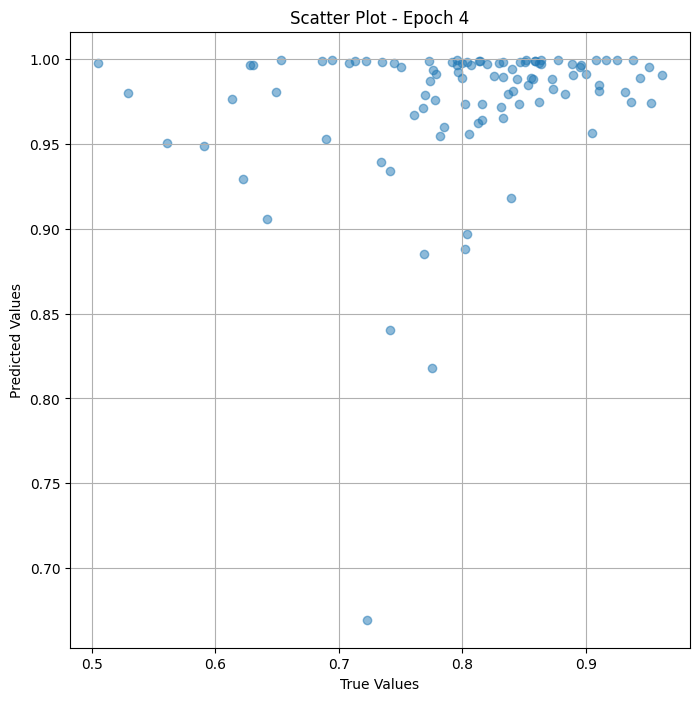

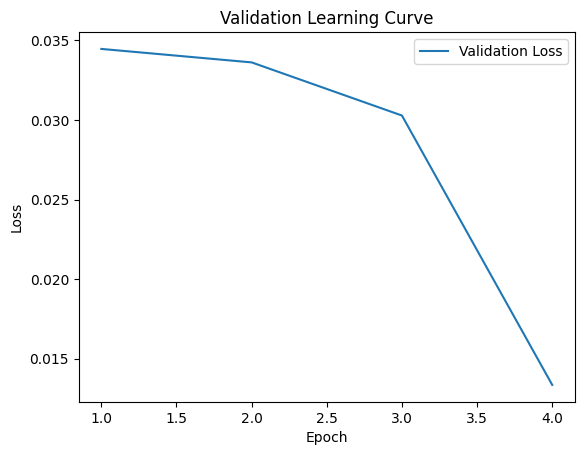


 Epoch: (5/30) Loss = 0.031934548169374466

 Epoch: (5/30) Loss_rmse = 0.17870239913463593

 Epoch: (5/30) R^2 = -5.599878787994385

 Epoch: (5/30) MAE = 0.17051710188388824
Spearman correlation coefficient: SignificanceResult(statistic=0.2555558194434181, pvalue=0.011970851078318223)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 0.84

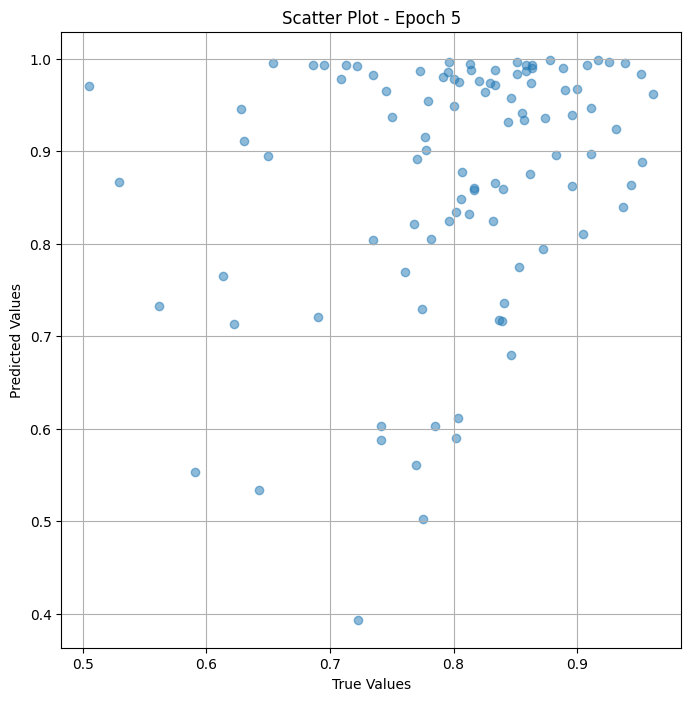

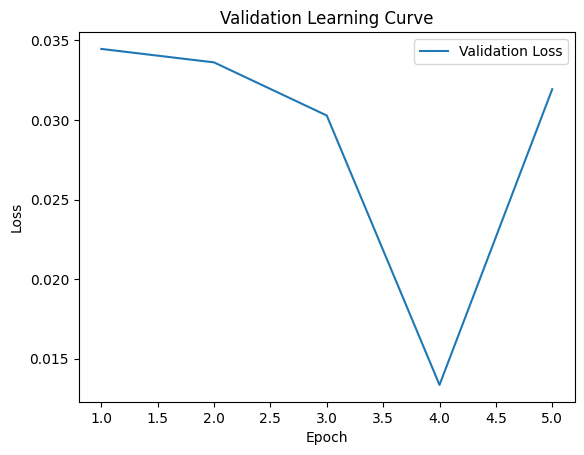


 Epoch: (6/30) Loss = 0.005941222887486219

 Epoch: (6/30) Loss_rmse = 0.07707932591438293

 Epoch: (6/30) R^2 = -0.22786617279052734

 Epoch: (6/30) MAE = 0.05816727876663208
Spearman correlation coefficient: SignificanceResult(statistic=0.46932387404817966, pvalue=1.410861380076527e-06)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 

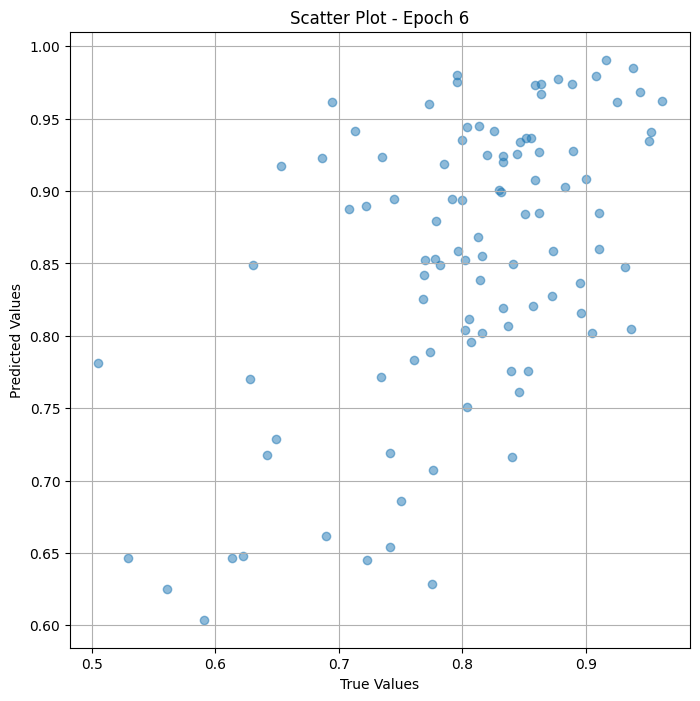

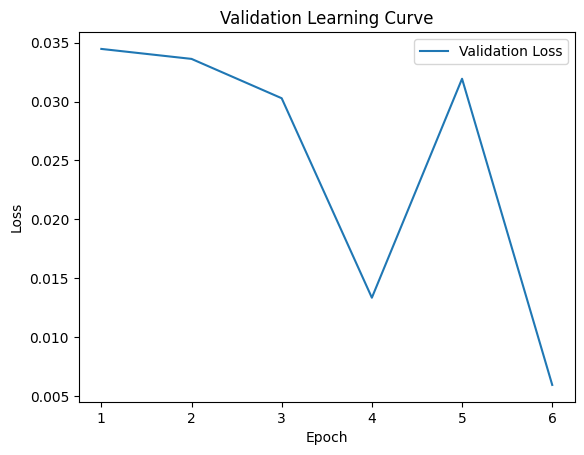


 Epoch: (7/30) Loss = 0.0038284300826489925

 Epoch: (7/30) Loss_rmse = 0.061874307692050934

 Epoch: (7/30) R^2 = 0.20878243446350098

 Epoch: (7/30) MAE = 0.04699435830116272
Spearman correlation coefficient: SignificanceResult(statistic=0.5586035930177032, pvalue=3.335640859148954e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 

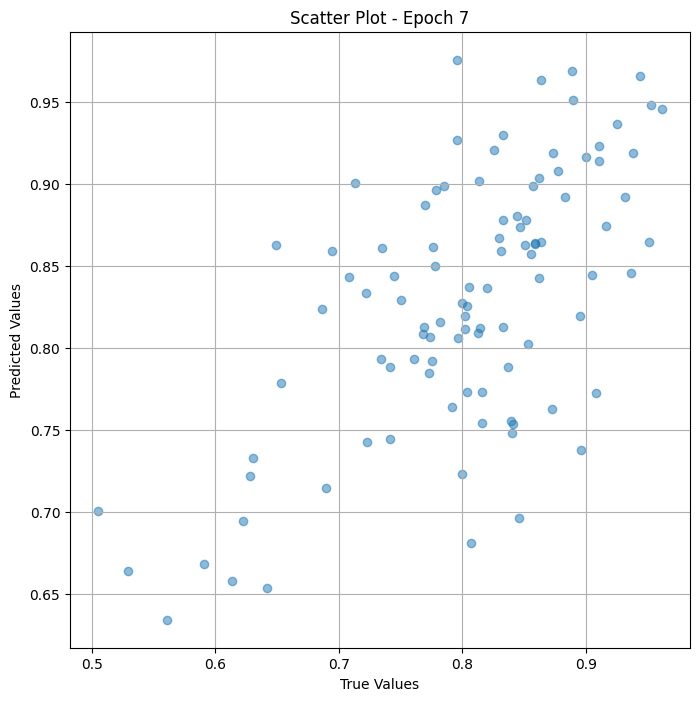

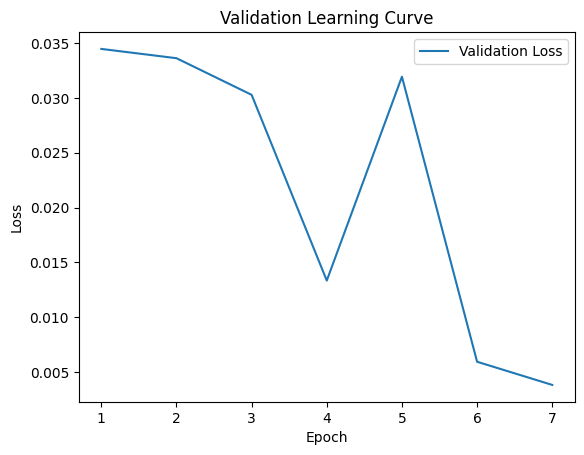


 Epoch: (8/30) Loss = 0.0027747114654630423

 Epoch: (8/30) Loss_rmse = 0.052675530314445496

 Epoch: (8/30) R^2 = 0.4265533685684204

 Epoch: (8/30) MAE = 0.04613149166107178
Spearman correlation coefficient: SignificanceResult(statistic=0.6595765609049099, pvalue=2.7167557724434237e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 

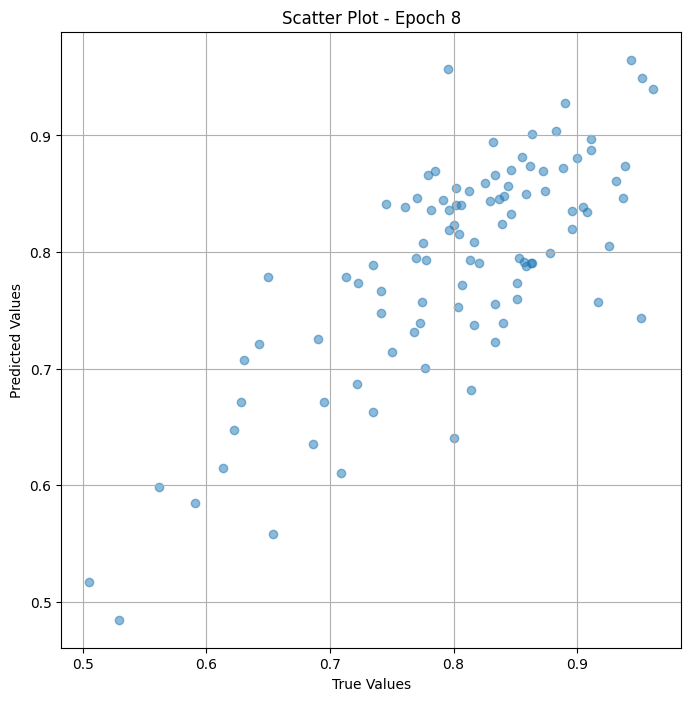

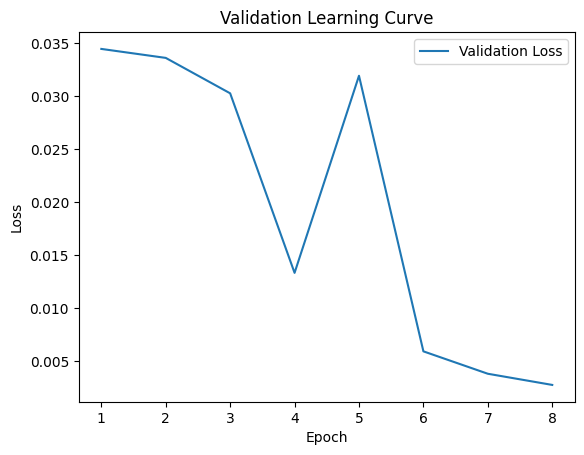


 Epoch: (9/30) Loss = 0.0005578413838520646

 Epoch: (9/30) Loss_rmse = 0.02361866645514965

 Epoch: (9/30) R^2 = 0.884711503982544

 Epoch: (9/30) MAE = 0.018371060490608215
Spearman correlation coefficient: SignificanceResult(statistic=0.7890501273722225, pvalue=1.3307571529062287e-21)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 0

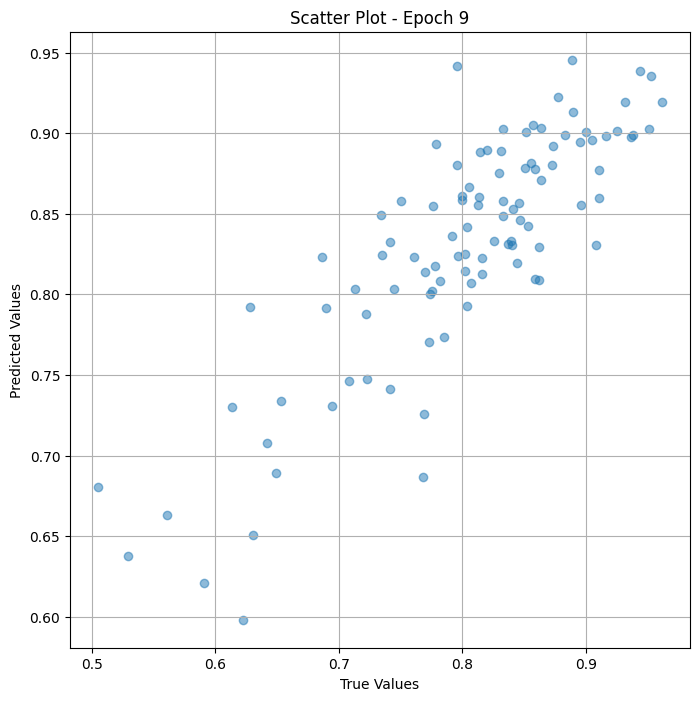

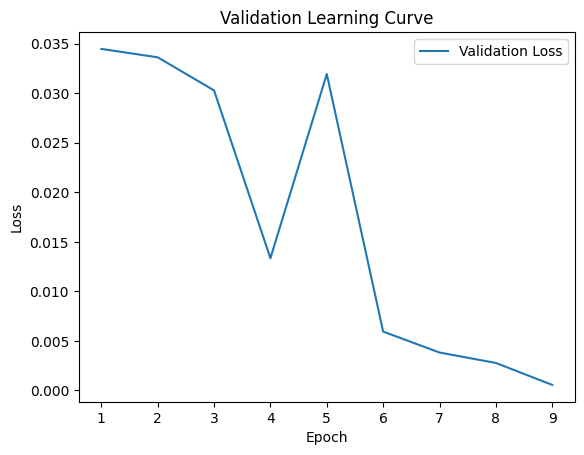


 Epoch: (10/30) Loss = 0.0004297659907024354

 Epoch: (10/30) Loss_rmse = 0.020730797201395035

 Epoch: (10/30) R^2 = 0.9111807346343994

 Epoch: (10/30) MAE = 0.01857040822505951
Spearman correlation coefficient: SignificanceResult(statistic=0.8562591781409691, pvalue=1.0286441422388746e-28)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829787

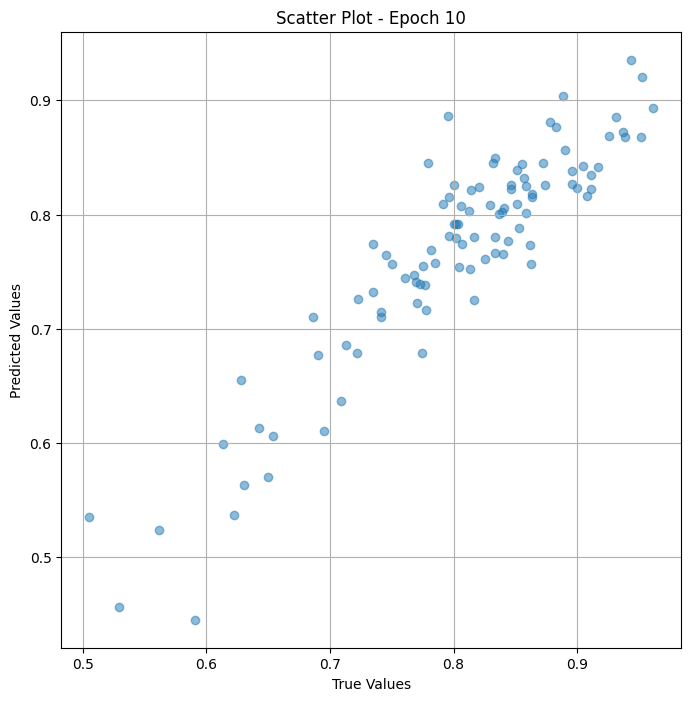

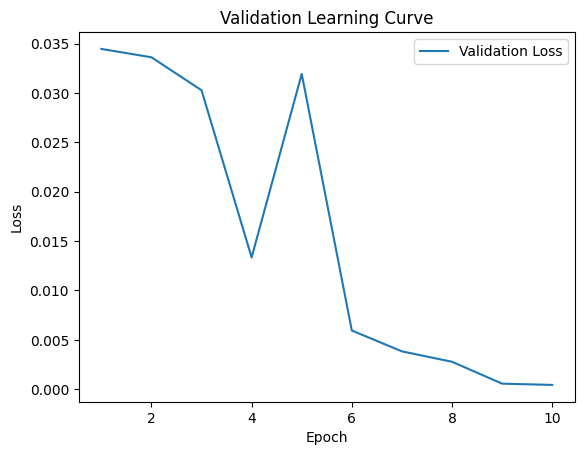


 Epoch: (11/30) Loss = 0.00012059773143846542

 Epoch: (11/30) Loss_rmse = 0.010981699451804161

 Epoch: (11/30) R^2 = 0.9750761985778809

 Epoch: (11/30) MAE = 0.01000647246837616
Spearman correlation coefficient: SignificanceResult(statistic=0.9158106430465693, pvalue=5.119281759184692e-39)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829787

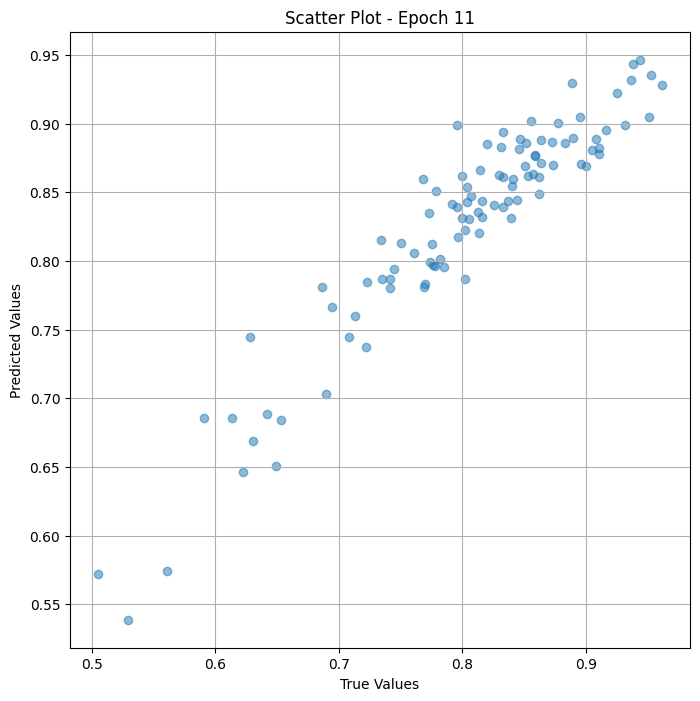

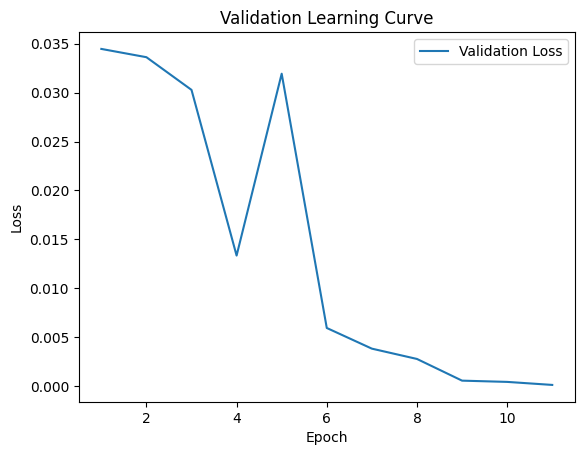


 Epoch: (12/30) Loss = 0.00036126974737271667

 Epoch: (12/30) Loss_rmse = 0.01900709792971611

 Epoch: (12/30) R^2 = 0.9253367781639099

 Epoch: (12/30) MAE = 0.011489301919937134
Spearman correlation coefficient: SignificanceResult(statistic=0.9362399155176022, pvalue=1.7501591684291182e-44)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978

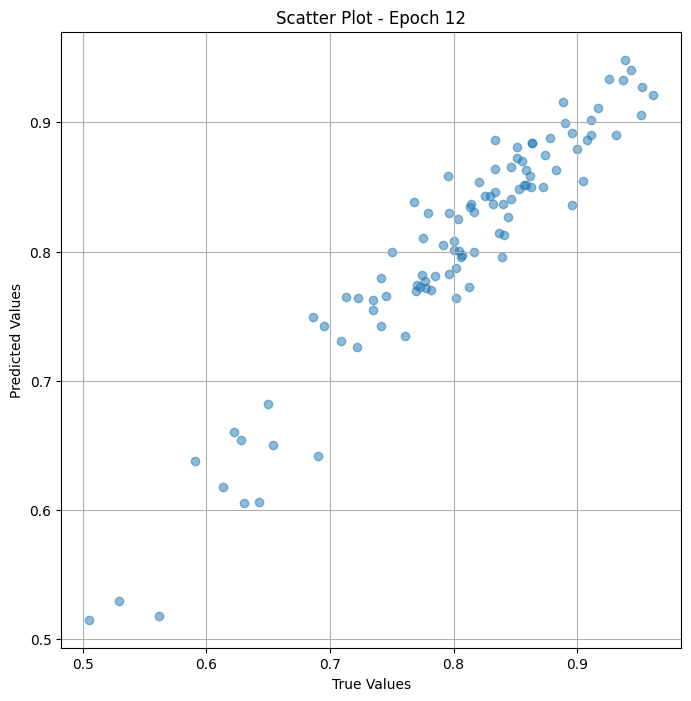

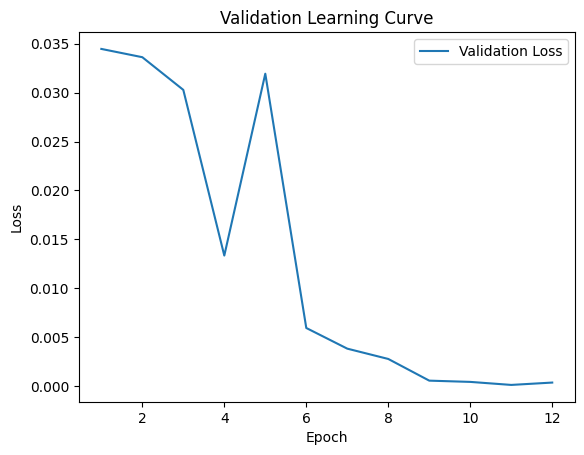


 Epoch: (13/30) Loss = 0.00012720306403934956

 Epoch: (13/30) Loss_rmse = 0.011278433725237846

 Epoch: (13/30) R^2 = 0.9737110733985901

 Epoch: (13/30) MAE = 0.010853216052055359
Spearman correlation coefficient: SignificanceResult(statistic=0.9750094113490841, pvalue=3.2525467662662757e-63)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297

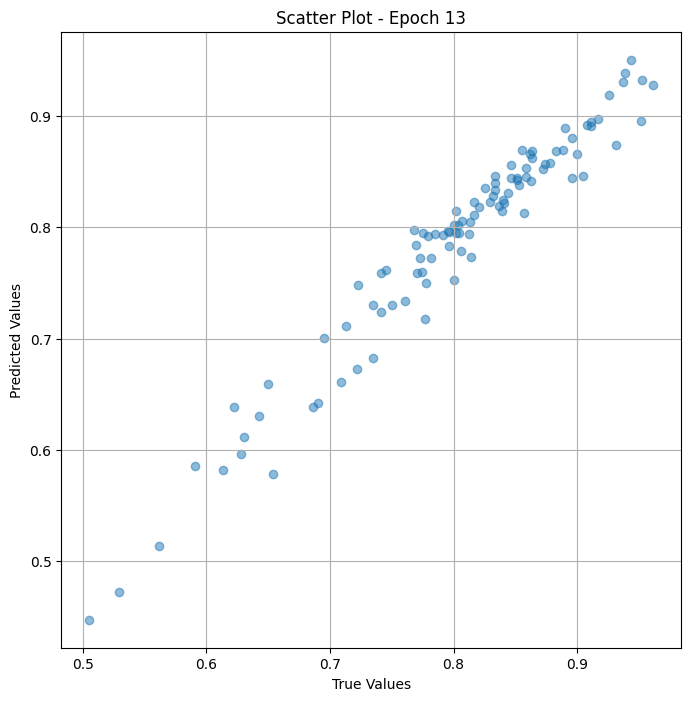

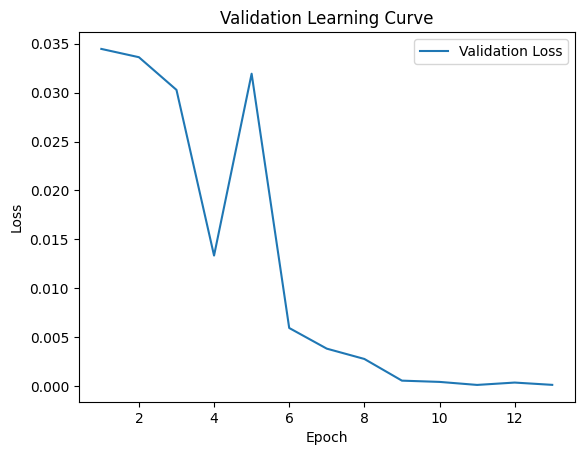

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (14/30) Loss = 0.0002486534940544516

 Epoch: (14/30) Loss_rmse = 0.0157687496393919

 Epoch: (14/30) R^2 = 0.9486110210418701

 Epoch: (14/30) MAE = 0.012442469596862793
Spearman correlation coefficient: SignificanceResult(statistic=0.9860854412113672, pvalue=4.66814546604997e-75)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.741573

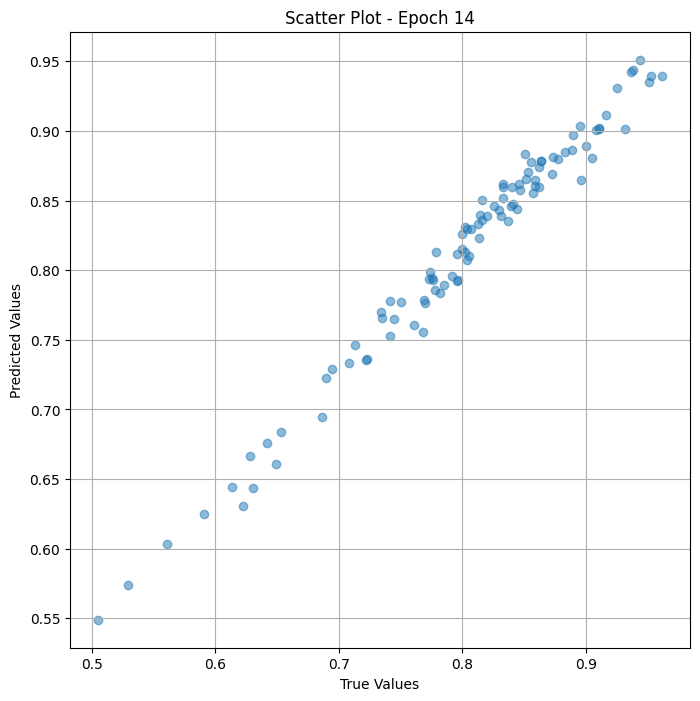

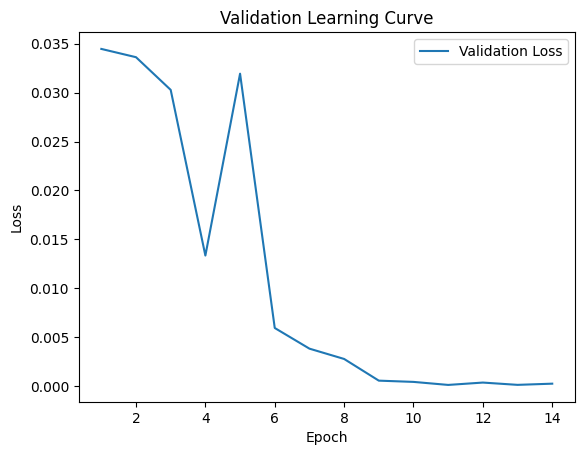


 Epoch: (15/30) Loss = 0.00013207329902797937

 Epoch: (15/30) Loss_rmse = 0.011492314748466015

 Epoch: (15/30) R^2 = 0.9727045297622681

 Epoch: (15/30) MAE = 0.007832631468772888
Spearman correlation coefficient: SignificanceResult(statistic=0.9916675432178945, pvalue=1.8084426960749532e-85)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297

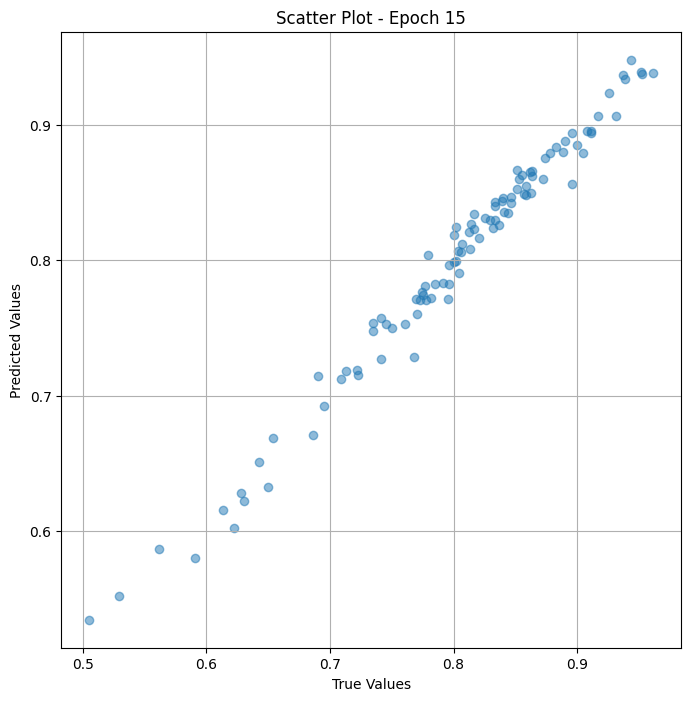

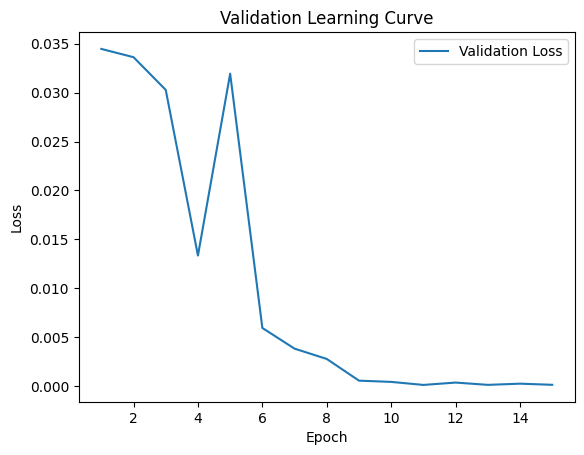


 Epoch: (16/30) Loss = 0.0001007930695777759

 Epoch: (16/30) Loss_rmse = 0.010039575397968292

 Epoch: (16/30) R^2 = 0.9791691899299622

 Epoch: (16/30) MAE = 0.0067459940910339355
Spearman correlation coefficient: SignificanceResult(statistic=0.9925357194716435, pvalue=1.0469547817642943e-87)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297

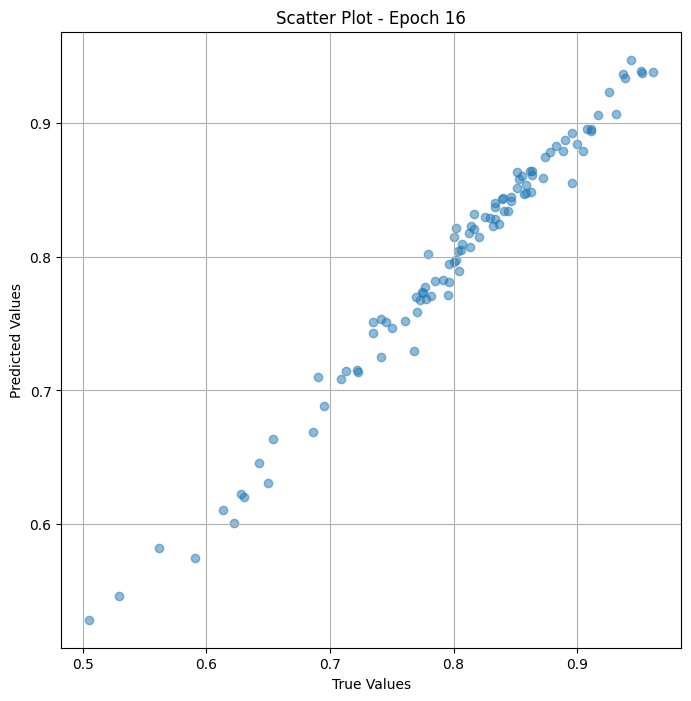

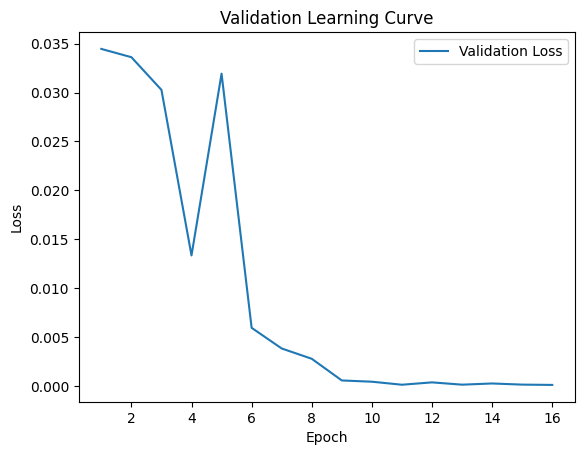


 Epoch: (17/30) Loss = 7.274859672179446e-05

 Epoch: (17/30) Loss_rmse = 0.008529278449714184

 Epoch: (17/30) R^2 = 0.9849651455879211

 Epoch: (17/30) MAE = 0.005642414093017578
Spearman correlation coefficient: SignificanceResult(statistic=0.9933021563206564, pvalue=6.545778565291525e-90)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829787

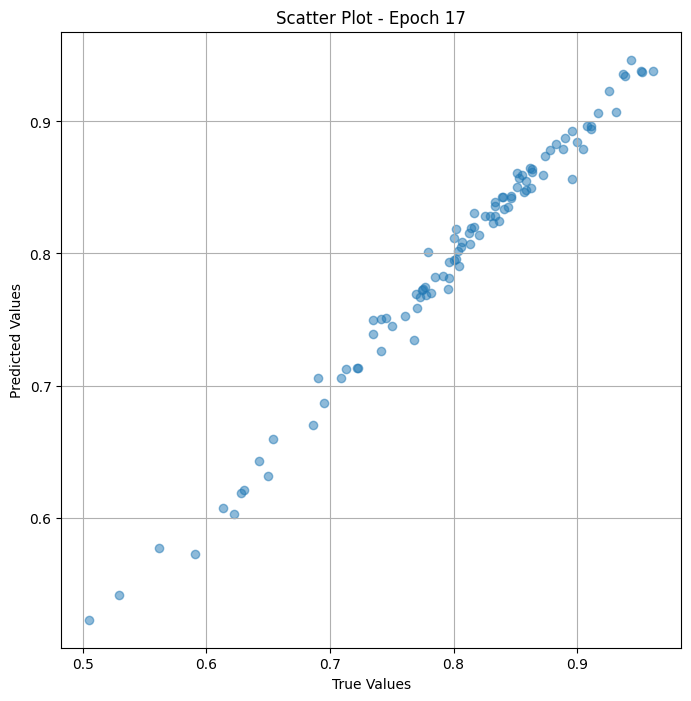

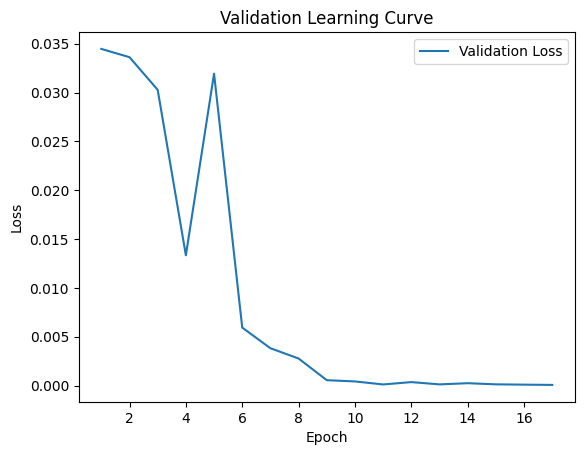


 Epoch: (18/30) Loss = 5.0713442760752514e-05

 Epoch: (18/30) Loss_rmse = 0.007121337112039328

 Epoch: (18/30) R^2 = 0.9895191192626953

 Epoch: (18/30) MAE = 0.004633724689483643
Spearman correlation coefficient: SignificanceResult(statistic=0.9941771152013877, pvalue=9.270320499641711e-93)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978

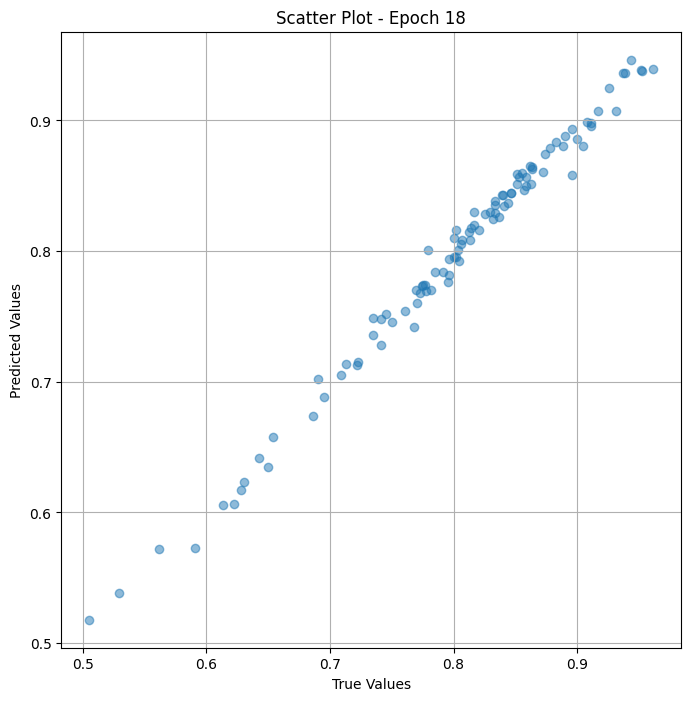

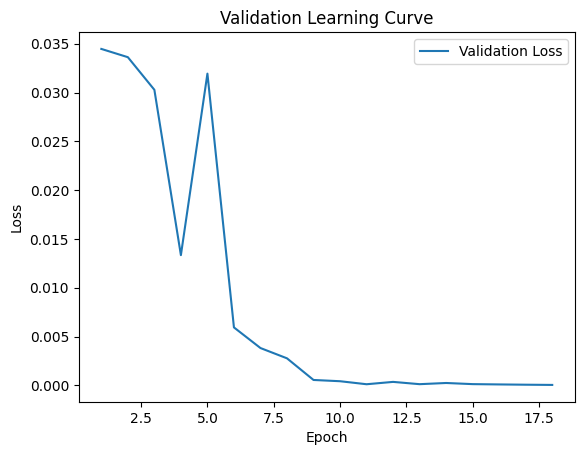


 Epoch: (19/30) Loss = 3.5084824048681185e-05

 Epoch: (19/30) Loss_rmse = 0.005923244170844555

 Epoch: (19/30) R^2 = 0.992749035358429

 Epoch: (19/30) MAE = 0.003983363509178162
Spearman correlation coefficient: SignificanceResult(statistic=0.9953844228042577, pvalue=1.7221075507474098e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978

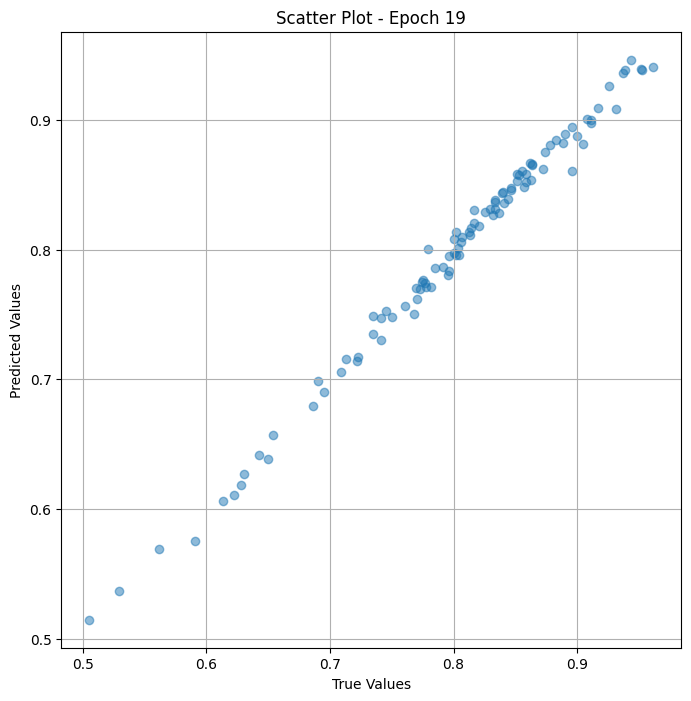

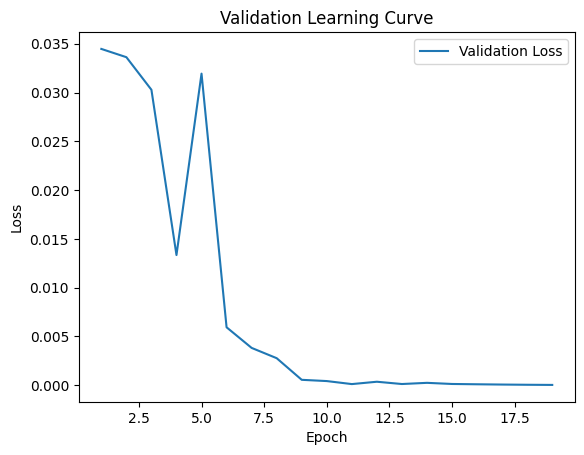


 Epoch: (20/30) Loss = 2.4200006009778008e-05

 Epoch: (20/30) Loss_rmse = 0.0049193501472473145

 Epoch: (20/30) R^2 = 0.9949986338615417

 Epoch: (20/30) MAE = 0.003847852349281311
Spearman correlation coefficient: SignificanceResult(statistic=0.9957913804232027, pvalue=2.2698161637277037e-99)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

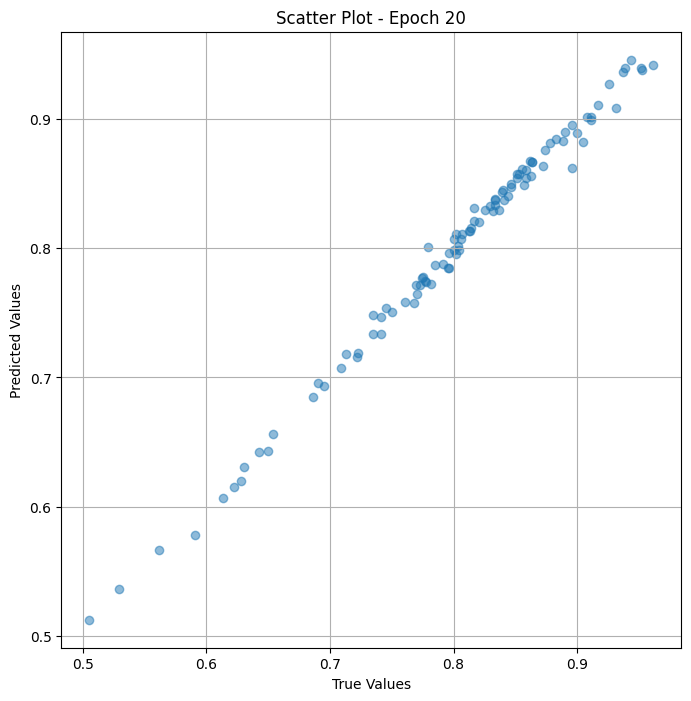

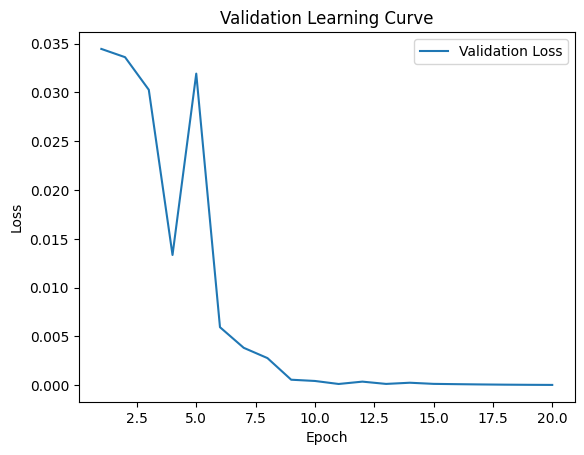


 Epoch: (21/30) Loss = 1.595187495695427e-05

 Epoch: (21/30) Loss_rmse = 0.0039939796552062035

 Epoch: (21/30) R^2 = 0.9967032670974731

 Epoch: (21/30) MAE = 0.003465309739112854
Spearman correlation coefficient: SignificanceResult(statistic=0.9962390338040419, pvalue=1.1611440361306547e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

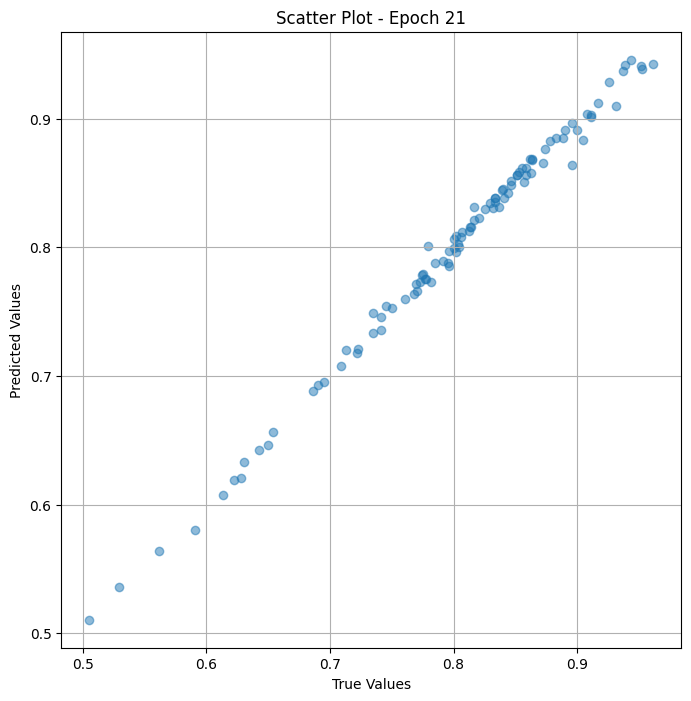

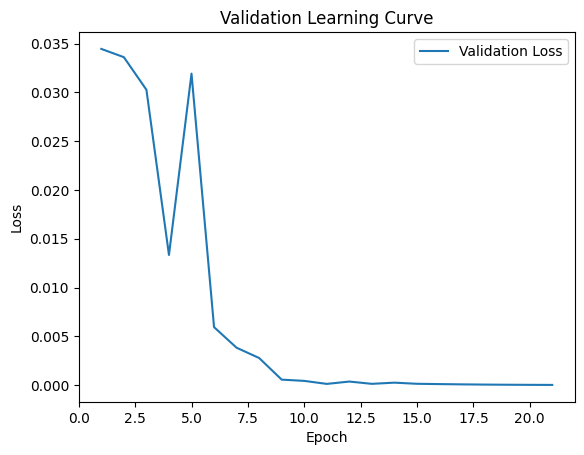


 Epoch: (22/30) Loss = 9.403065632795915e-06

 Epoch: (22/30) Loss_rmse = 0.0030664417427033186

 Epoch: (22/30) R^2 = 0.9980566501617432

 Epoch: (22/30) MAE = 0.002831205725669861
Spearman correlation coefficient: SignificanceResult(statistic=0.996781643962635, pvalue=7.761237651949512e-105)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978

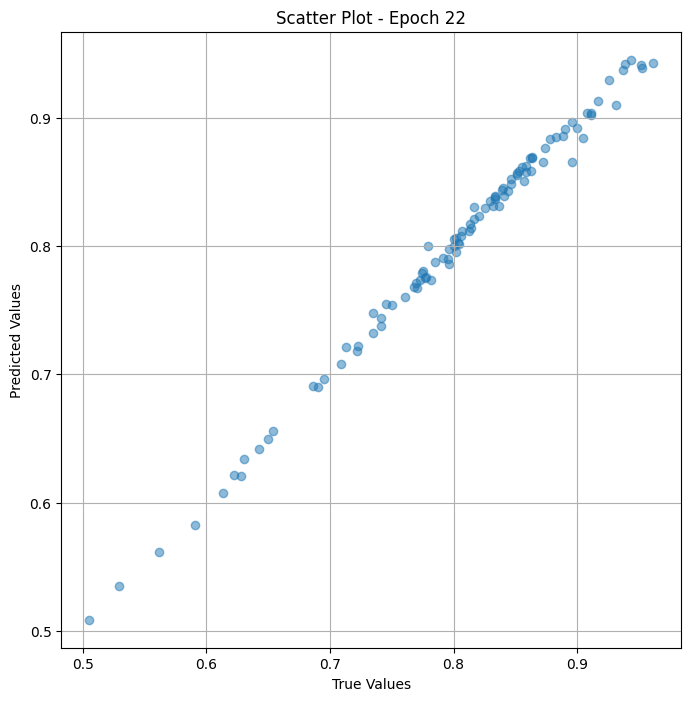

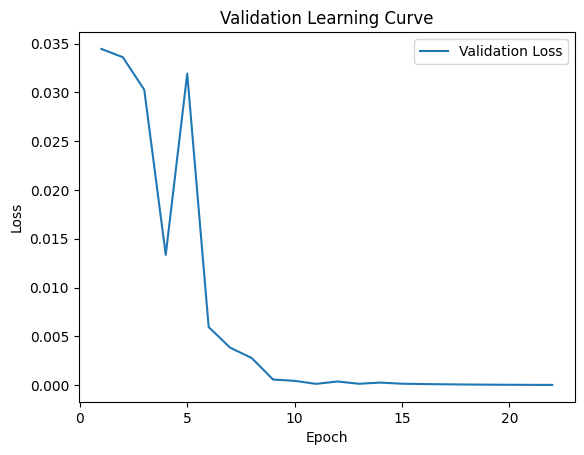


 Epoch: (23/30) Loss = 4.709180757345166e-06

 Epoch: (23/30) Loss_rmse = 0.0021700647193938494

 Epoch: (23/30) R^2 = 0.9990267753601074

 Epoch: (23/30) MAE = 0.0020673125982284546
Spearman correlation coefficient: SignificanceResult(statistic=0.9970393837879669, pvalue=1.5438773924230962e-106)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82

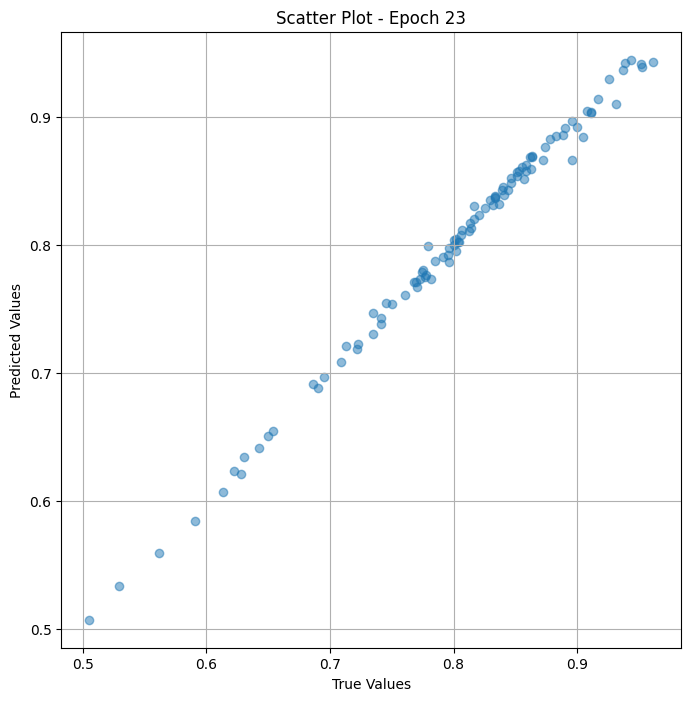

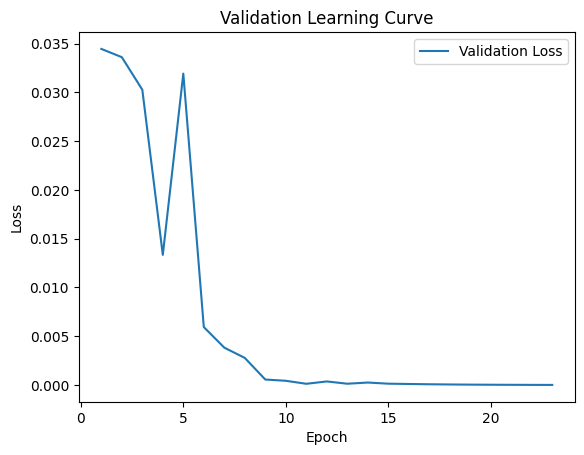


 Epoch: (24/30) Loss = 2.0005252281407593e-06

 Epoch: (24/30) Loss_rmse = 0.0014143992448225617

 Epoch: (24/30) R^2 = 0.9995865821838379

 Epoch: (24/30) MAE = 0.0013421624898910522
Spearman correlation coefficient: SignificanceResult(statistic=0.9970800795498613, pvalue=8.062876758254129e-107)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82

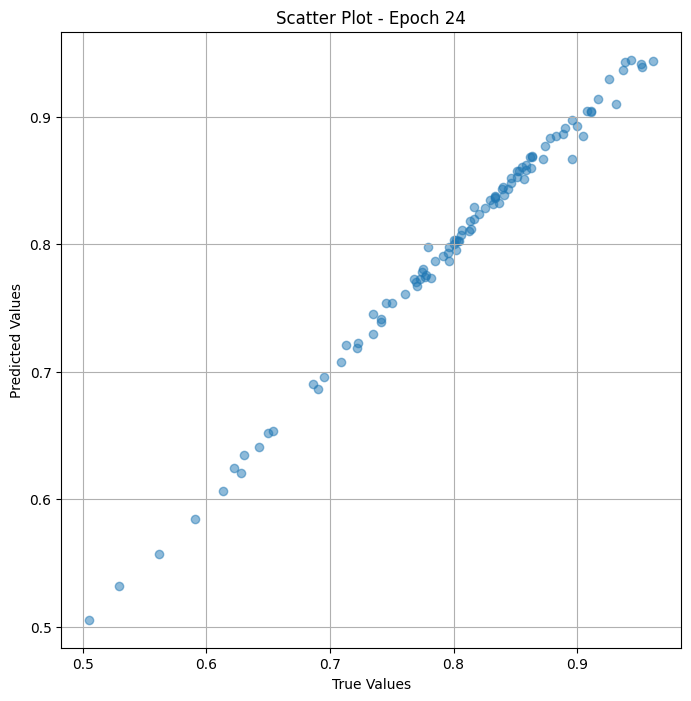

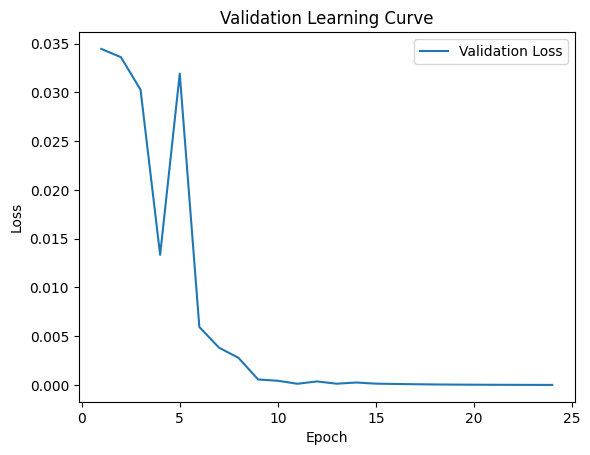


 Epoch: (25/30) Loss = 7.937175041661249e-07

 Epoch: (25/30) Loss_rmse = 0.0008909082389436662

 Epoch: (25/30) R^2 = 0.9998359680175781

 Epoch: (25/30) MAE = 0.0007881522178649902
Spearman correlation coefficient: SignificanceResult(statistic=0.9972360799704568, pvalue=6.127413705846469e-108)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

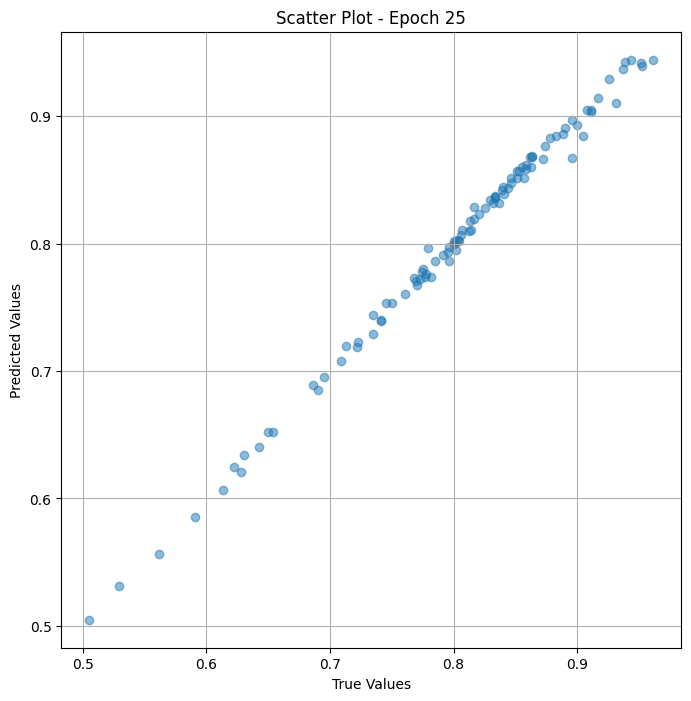

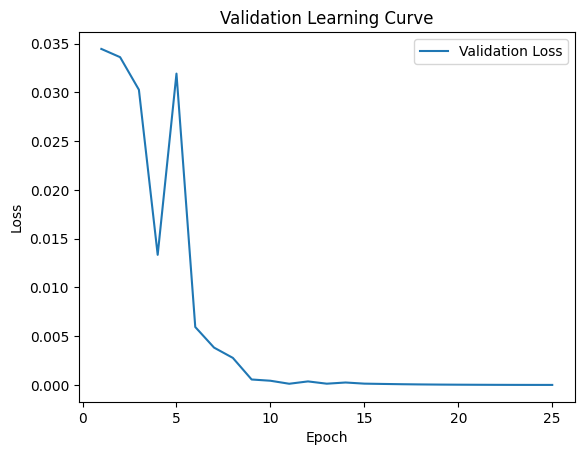


 Epoch: (26/30) Loss = 3.526600949044223e-07

 Epoch: (26/30) Loss_rmse = 0.0005938519025221467

 Epoch: (26/30) R^2 = 0.9999271035194397

 Epoch: (26/30) MAE = 0.0004990100860595703
Spearman correlation coefficient: SignificanceResult(statistic=0.9977176464862083, pvalue=7.661126647080646e-112)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

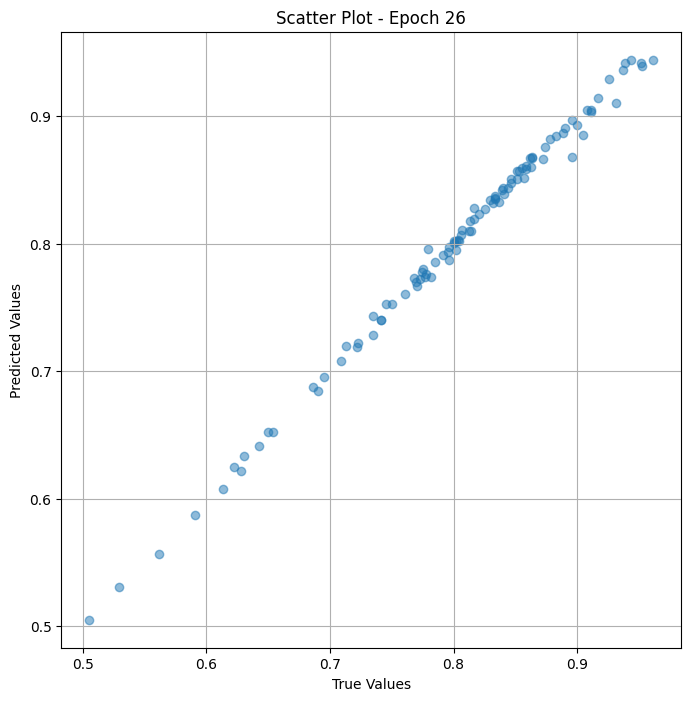

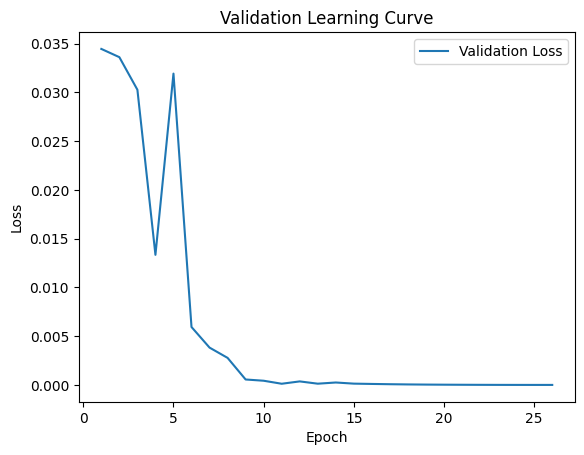


 Epoch: (27/30) Loss = 1.873829091891821e-07

 Epoch: (27/30) Loss_rmse = 0.0004328774812165648

 Epoch: (27/30) R^2 = 0.999961256980896

 Epoch: (27/30) MAE = 0.0003872811794281006
Spearman correlation coefficient: SignificanceResult(statistic=0.9980499952083467, pvalue=4.733981029665664e-115)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297

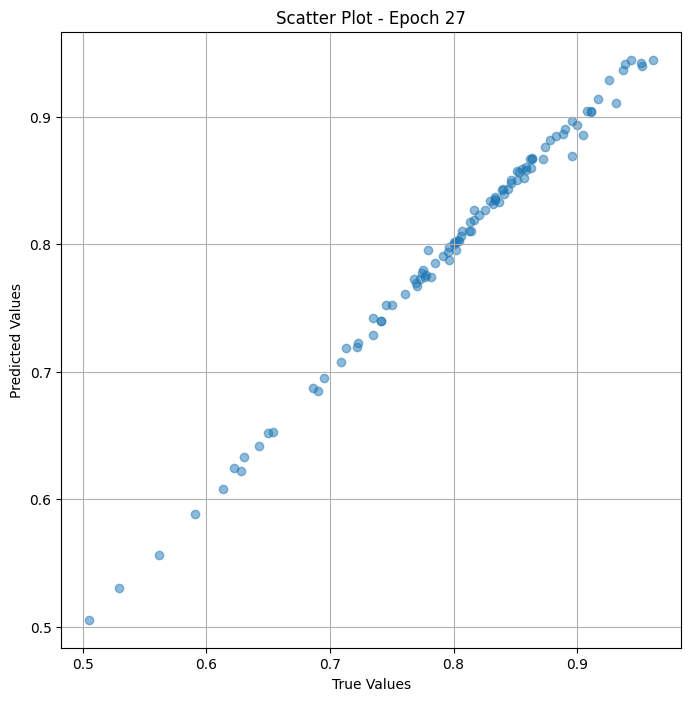

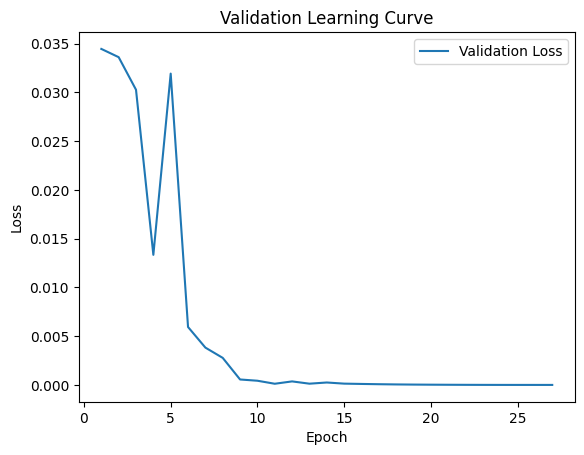


 Epoch: (28/30) Loss = 1.225856465225661e-07

 Epoch: (28/30) Loss_rmse = 0.0003501223400235176

 Epoch: (28/30) R^2 = 0.9999746680259705

 Epoch: (28/30) MAE = 0.00028121471405029297
Spearman correlation coefficient: SignificanceResult(statistic=0.9981517346130828, pvalue=3.82357082639221e-116)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

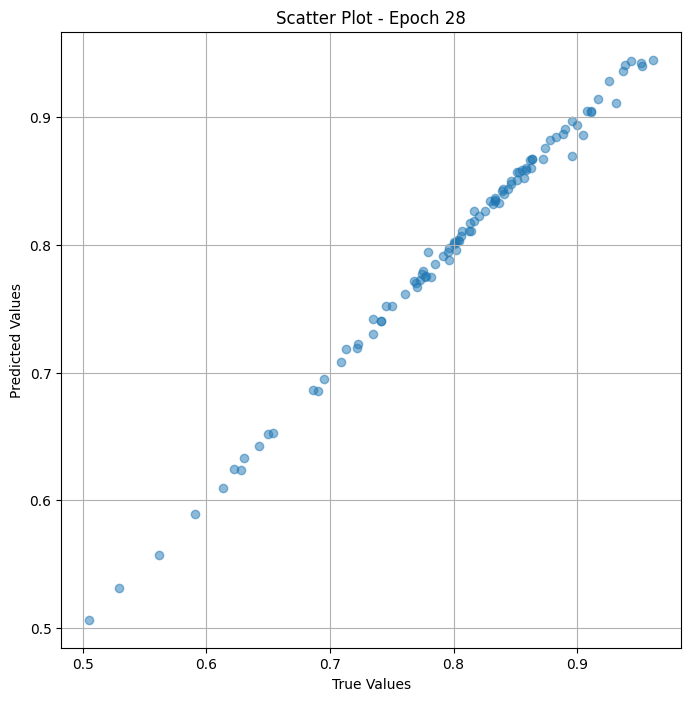

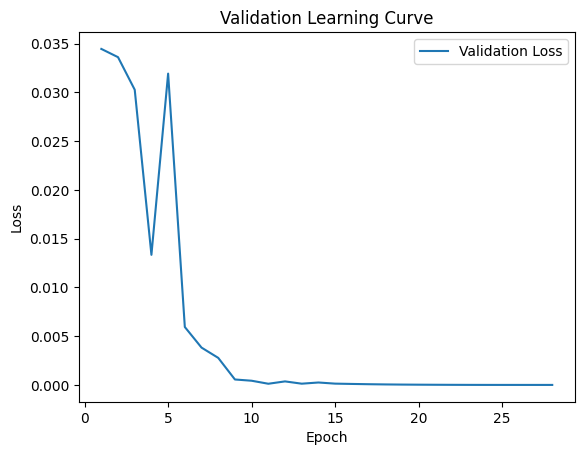


 Epoch: (29/30) Loss = 1.1369608898803563e-07

 Epoch: (29/30) Loss_rmse = 0.0003371885104570538

 Epoch: (29/30) R^2 = 0.9999765157699585

 Epoch: (29/30) MAE = 0.00027674436569213867
Spearman correlation coefficient: SignificanceResult(statistic=0.9981992130019598, pvalue=1.126524561846544e-116)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8

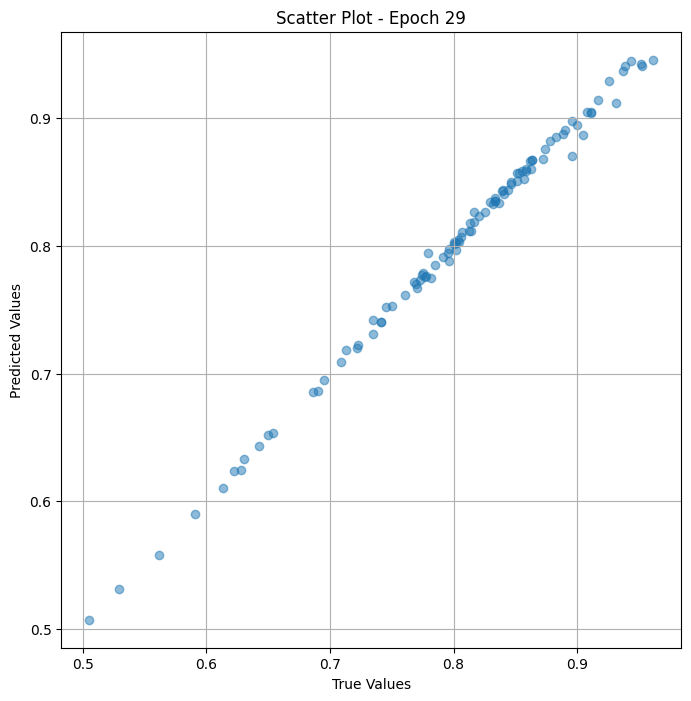

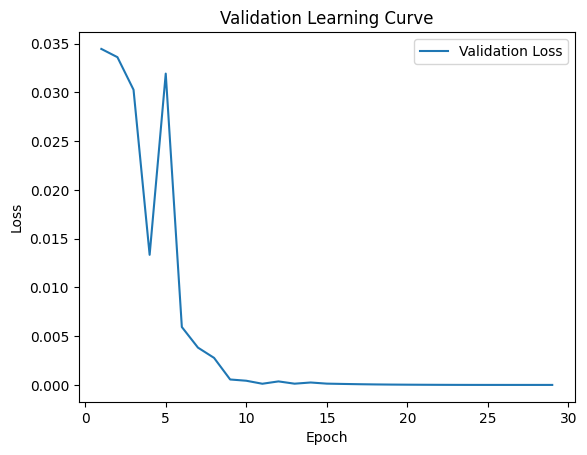


 Epoch: (30/30) Loss = 1.3330607373518433e-07

 Epoch: (30/30) Loss_rmse = 0.0003651110455393791

 Epoch: (30/30) R^2 = 0.9999724626541138

 Epoch: (30/30) MAE = 0.00035218894481658936
Spearman correlation coefficient: SignificanceResult(statistic=0.998253474017819, pvalue=2.677743271734485e-117)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82

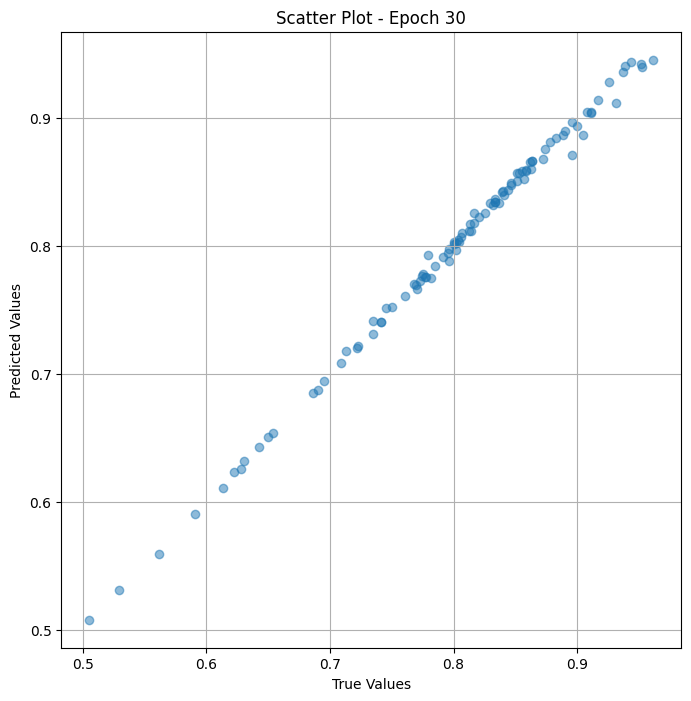

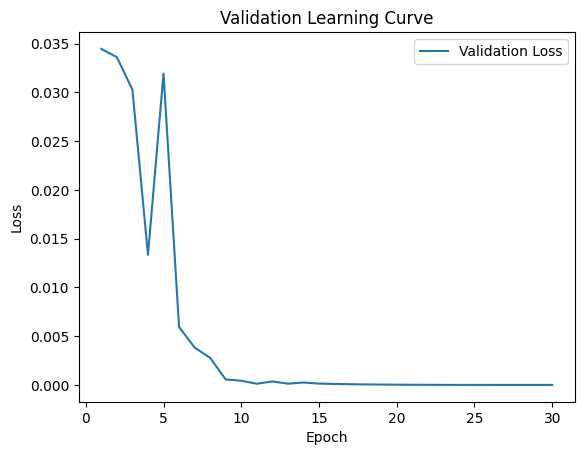

In [ ]:
# val the model and save weights
fit(30, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

In [ ]:
true_values_list_val = []
predicted_values_list_val = []

for x_trans, yb in val_dl:
    preds = model_vit(x_trans)
    true_values_list_val.extend(yb.cpu().detach().numpy())
    predicted_values_list_val.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_animal' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_val_animal['preprocessed_image_path'],
    'True Value': true_values_list_val,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_val # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                          Image Path  True Value  \
0      /content/animal/000000166223_preprocessed.jpg    0.653465   
1   /content/animal/n02129165_11840_preprocessed.jpg    0.779070   
2      /content/animal/000000426420_preprocessed.jpg    0.795918   
3      /content/animal/000000553162_preprocessed.jpg    0.750000   
4   /content/animal/n02324045_32742_preprocessed.jpg    0.813187   
..                                               ...         ...   
95     /content/animal/000000435612_preprocessed.jpg    0.782051   
96     /content/animal/000000445814_preprocessed.jpg    0.769231   
97     /content/animal/000000489328_preprocessed.jpg    0.785047   
98   /content/animal/n02431785_3713_preprocessed.jpg    0.801980   
99   /content/animal/n02118333_5460_preprocessed.jpg    0.943820   

    Predicted Value  
0          0.642460  
1          0.838399  
2          0.818379  
3          0.767823  
4          0.791004  
..              ...  
95         0.832541  
96     

## Test

In [ ]:
df_test_animal.head()


,preprocessed_image_path,memoscore
0,/content/animal/n02342885_12762_preprocessed.jpg,0.940678
1,/content/animal/000000474764_preprocessed.jpg,0.894231
2,/content/animal/000000131059_preprocessed.jpg,0.597938
3,/content/animal/n01846331_8530_preprocessed.jpg,0.659574
4,/content/animal/n02342885_4519_preprocessed.jpg,0.918367


In [ ]:
class Dataset_test_animal(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_test_animal["memoscore"]
        self.images = df_test_animal["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
test_ds = Dataset_test_animal(df_test_animal, trans_transform=trans_transform)
test_dl = DataLoader(test_ds, batch_size=32, shuffle=False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
print(test_ds)

In [ ]:
class ViTMem_model_test_animal(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_test =  ViTMem_model_test_animal( arch="vit_base_patch16_224_miil")

model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_test_animal().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
test_dl = DeviceDataLoader(test_dl, device)
model_vit_test  = to_device(model_vit_test  , device)

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad ]
optimizer = torch.optim.Adam(params, lr=1e-4)   #,weight_decay=1e-7

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)



/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.04225904494524002

 Epoch: (1/30) Loss_rmse = 0.2055700421333313

 Epoch: (1/30) R^2 = -13.760955810546875

 Epoch: (1/30) MAE = 0.1979883760213852
Spearman correlation coefficient: SignificanceResult(statistic=-0.04393815561830864, pvalue=0.6707854742728163)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.7980769

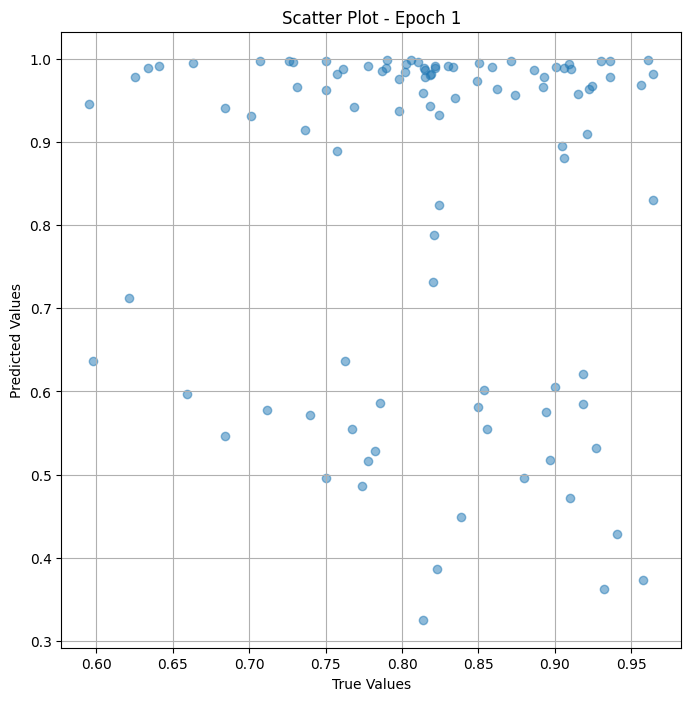

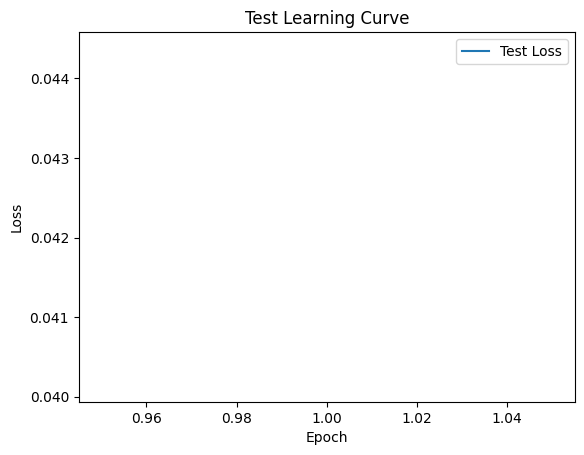


 Epoch: (2/30) Loss = 0.03999427706003189

 Epoch: (2/30) Loss_rmse = 0.19998569786548615

 Epoch: (2/30) R^2 = -12.969879150390625

 Epoch: (2/30) MAE = 0.1906680315732956
Spearman correlation coefficient: SignificanceResult(statistic=0.07300869204622941, pvalue=0.47962252437628405)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.798076

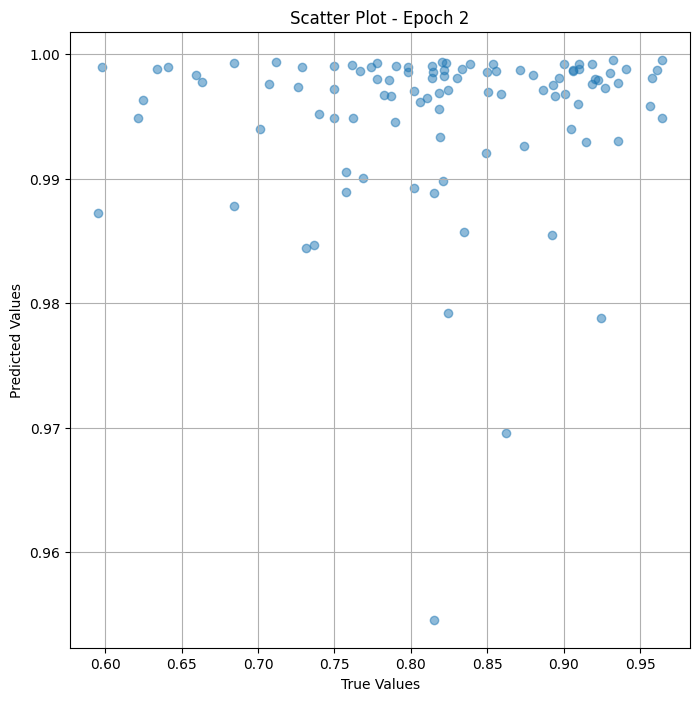

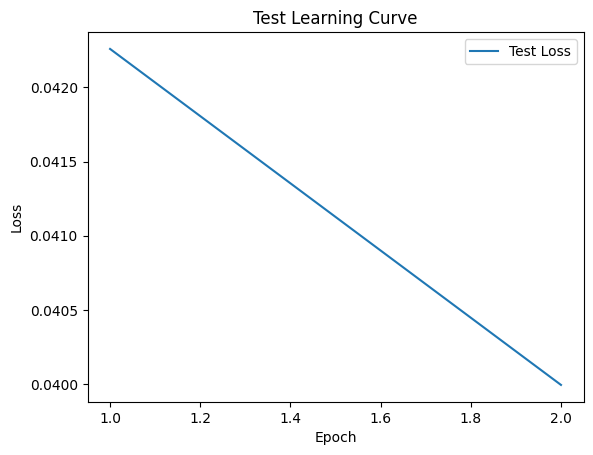


 Epoch: (3/30) Loss = 0.033135704696178436

 Epoch: (3/30) Loss_rmse = 0.18203215301036835

 Epoch: (3/30) R^2 = -10.574200630187988

 Epoch: (3/30) MAE = 0.15262213349342346
Spearman correlation coefficient: SignificanceResult(statistic=0.038545930592597706, pvalue=0.7092505920063875)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.7980

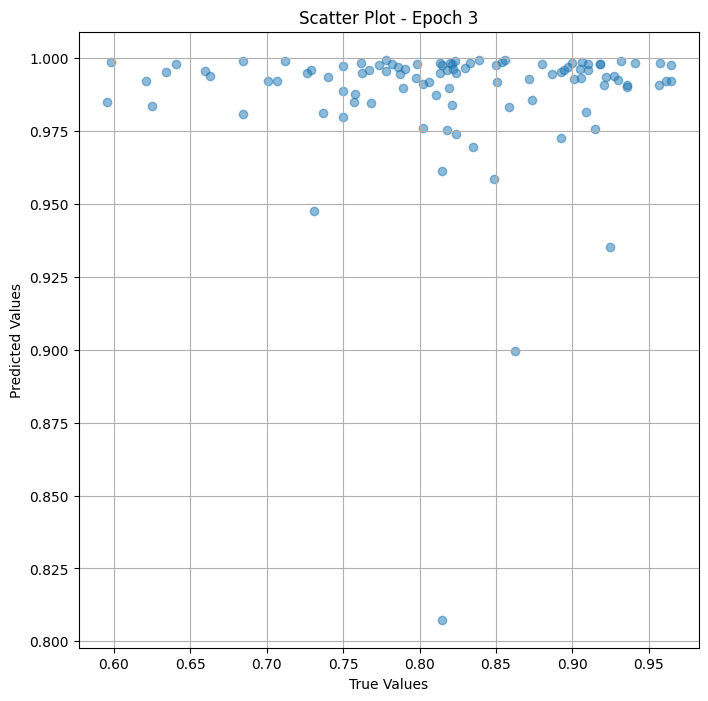

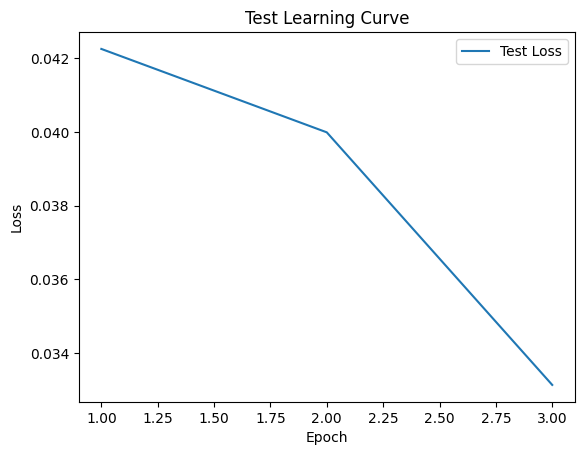


 Epoch: (4/30) Loss = 0.03258978947997093

 Epoch: (4/30) Loss_rmse = 0.18052642047405243

 Epoch: (4/30) R^2 = -10.383514404296875

 Epoch: (4/30) MAE = 0.15547595918178558
Spearman correlation coefficient: SignificanceResult(statistic=-0.03447632679960834, pvalue=0.7387781631947304)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.79807

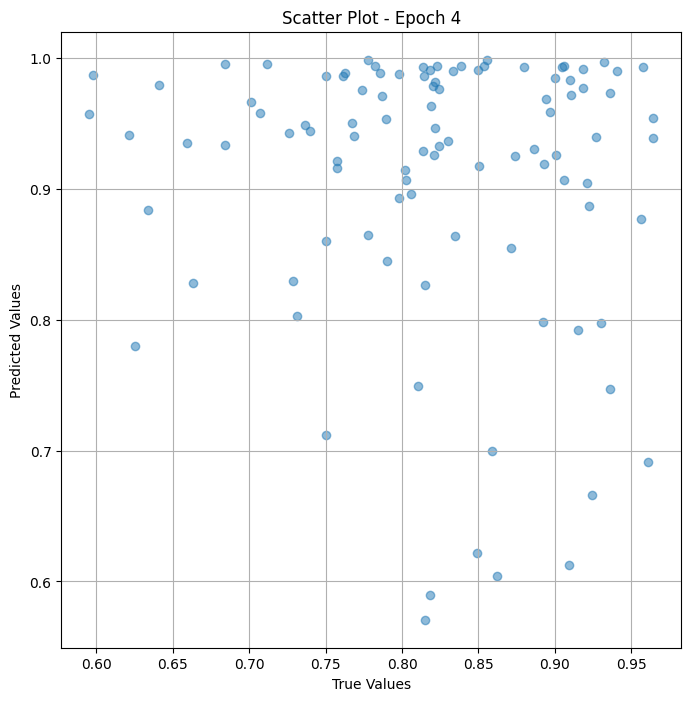

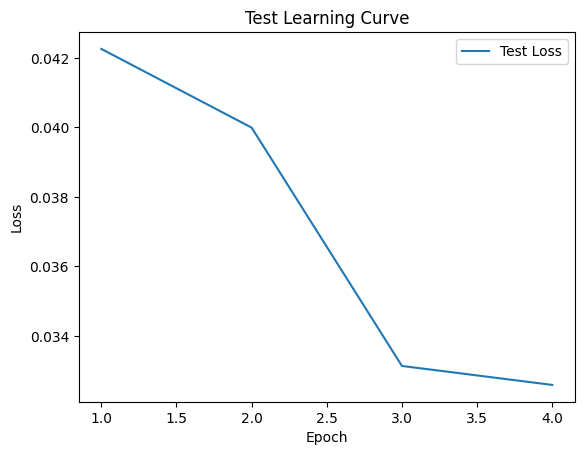


 Epoch: (5/30) Loss = 0.008356786333024502

 Epoch: (5/30) Loss_rmse = 0.09141545742750168

 Epoch: (5/30) R^2 = -1.9190001487731934

 Epoch: (5/30) MAE = 0.08093522489070892
Spearman correlation coefficient: SignificanceResult(statistic=0.2631134505627398, pvalue=0.0095972899058912)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.798076

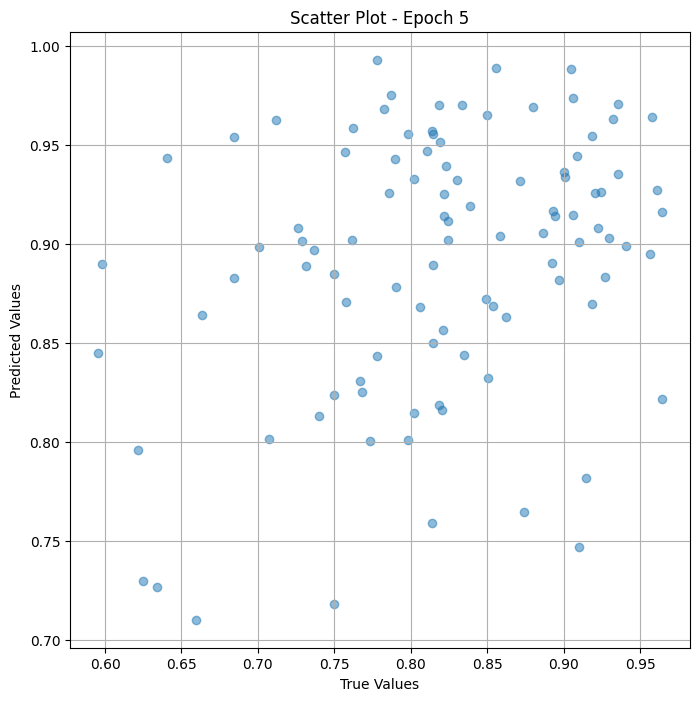

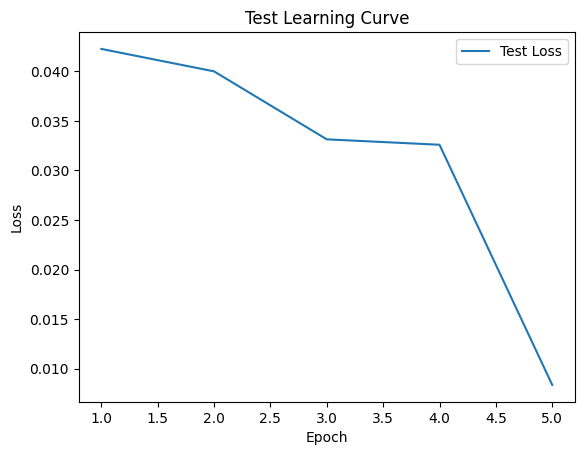


 Epoch: (6/30) Loss = 0.004961024038493633

 Epoch: (6/30) Loss_rmse = 0.07043454051017761

 Epoch: (6/30) R^2 = -0.7328705787658691

 Epoch: (6/30) MAE = 0.06466071307659149
Spearman correlation coefficient: SignificanceResult(statistic=0.43196809460685737, pvalue=1.1098259942917927e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.7

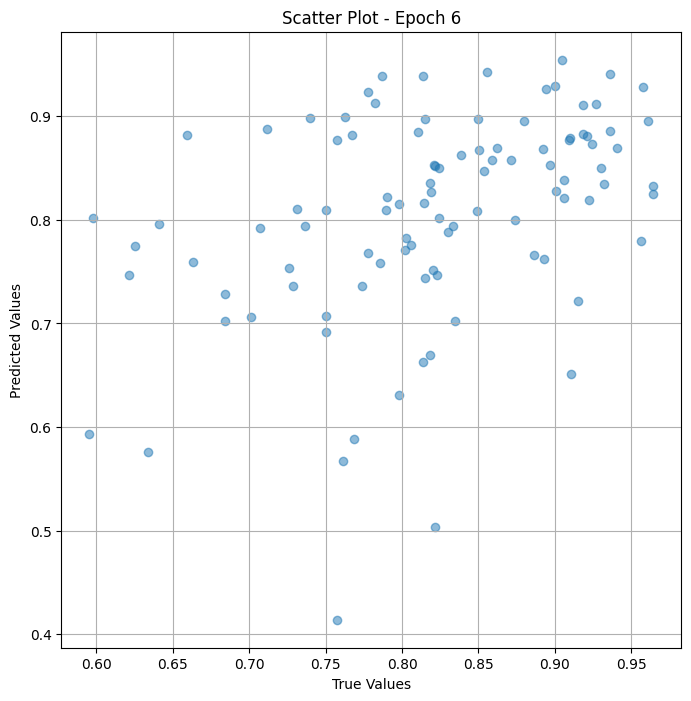

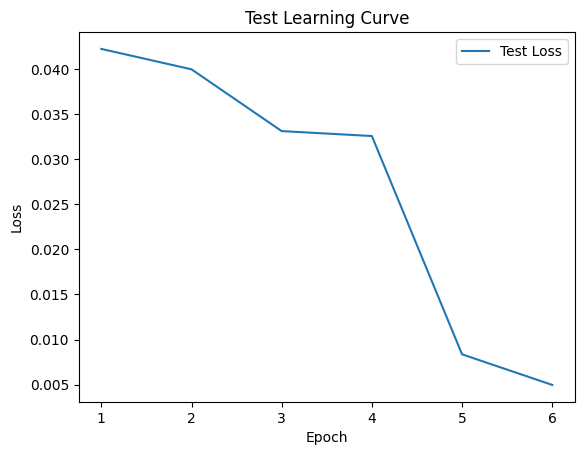


 Epoch: (7/30) Loss = 0.0030539000872522593

 Epoch: (7/30) Loss_rmse = 0.05526210367679596

 Epoch: (7/30) R^2 = -0.06671798229217529

 Epoch: (7/30) MAE = 0.05216789245605469
Spearman correlation coefficient: SignificanceResult(statistic=0.6643289058405741, pvalue=1.5939718854361378e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.

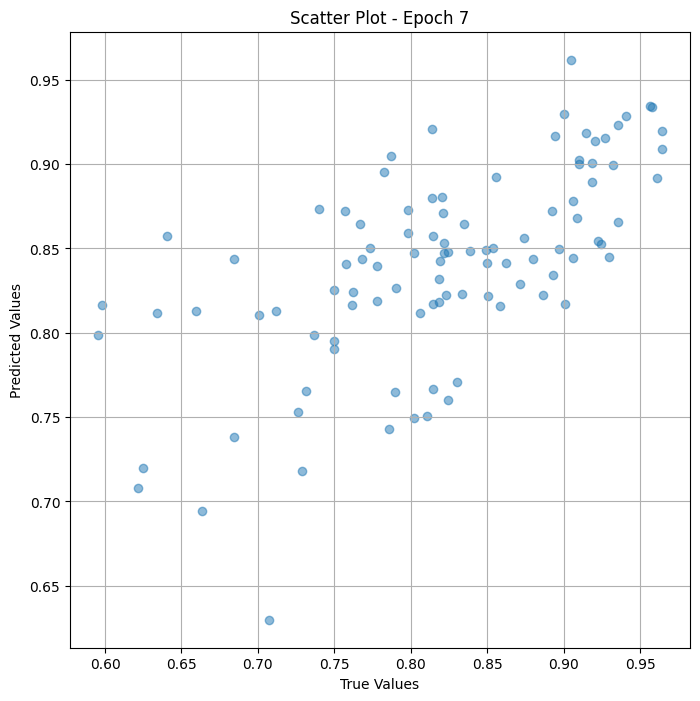

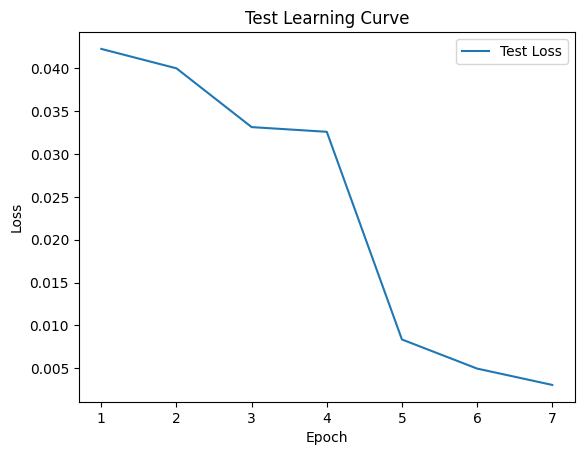


 Epoch: (8/30) Loss = 0.0015979977324604988

 Epoch: (8/30) Loss_rmse = 0.039974965155124664

 Epoch: (8/30) R^2 = 0.4418242573738098

 Epoch: (8/30) MAE = 0.03733015060424805
Spearman correlation coefficient: SignificanceResult(statistic=0.728621863096818, pvalue=3.960279678277073e-17)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.798

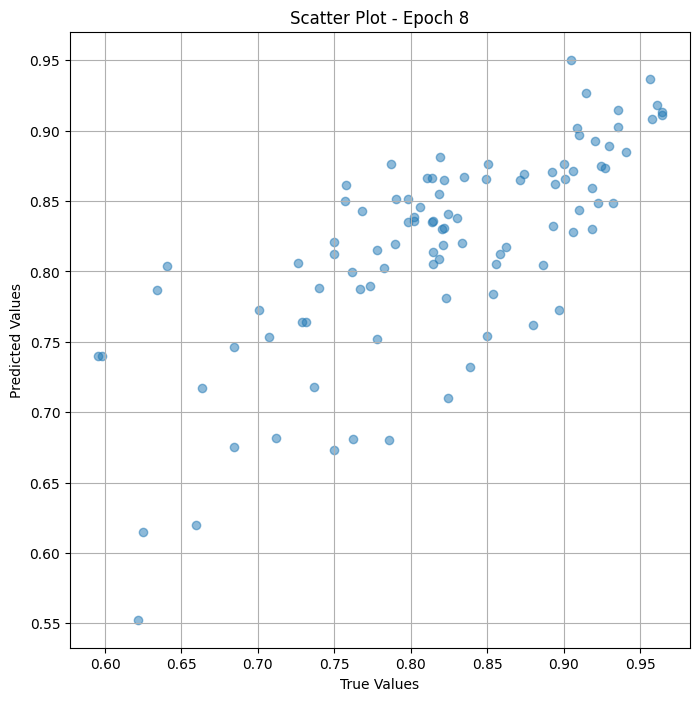

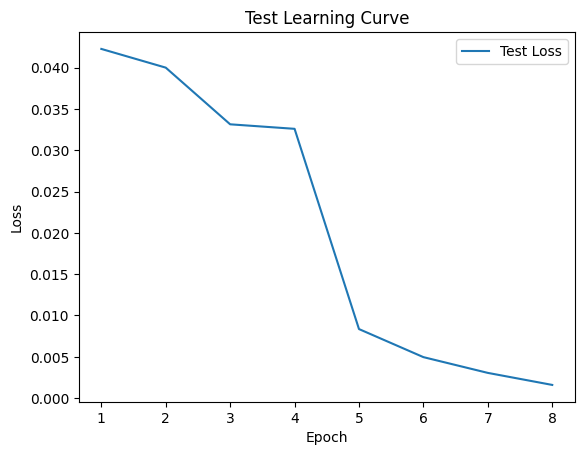


 Epoch: (9/30) Loss = 0.0012230492429807782

 Epoch: (9/30) Loss_rmse = 0.03497212007641792

 Epoch: (9/30) R^2 = 0.572792649269104

 Epoch: (9/30) MAE = 0.029544785618782043
Spearman correlation coefficient: SignificanceResult(statistic=0.8590865780270691, pvalue=4.3294779855099196e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.79

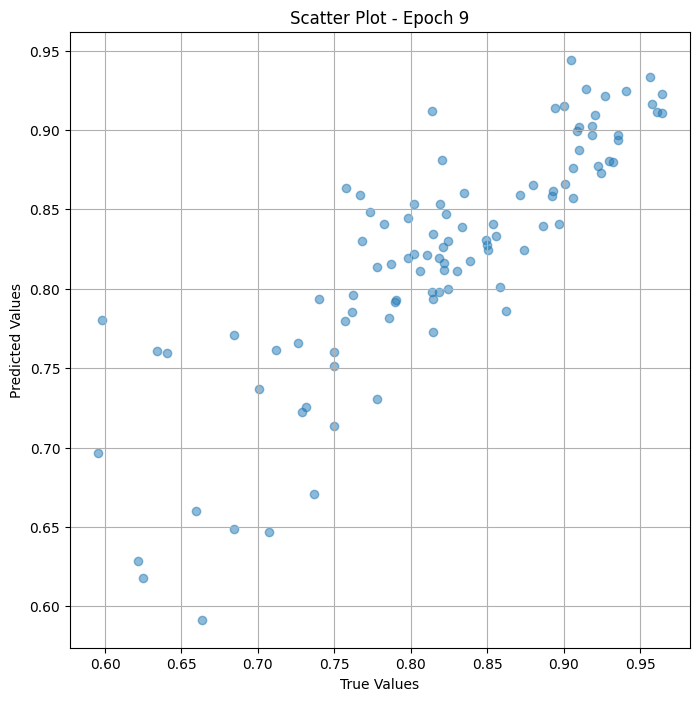

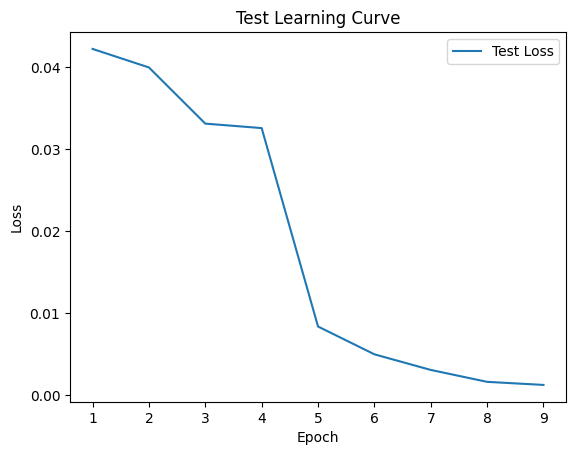


 Epoch: (10/30) Loss = 0.0001610142644494772

 Epoch: (10/30) Loss_rmse = 0.012689139693975449

 Epoch: (10/30) R^2 = 0.9437581896781921

 Epoch: (10/30) MAE = 0.009772539138793945
Spearman correlation coefficient: SignificanceResult(statistic=0.899206088752956, pvalue=1.6353007749351927e-35)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921,

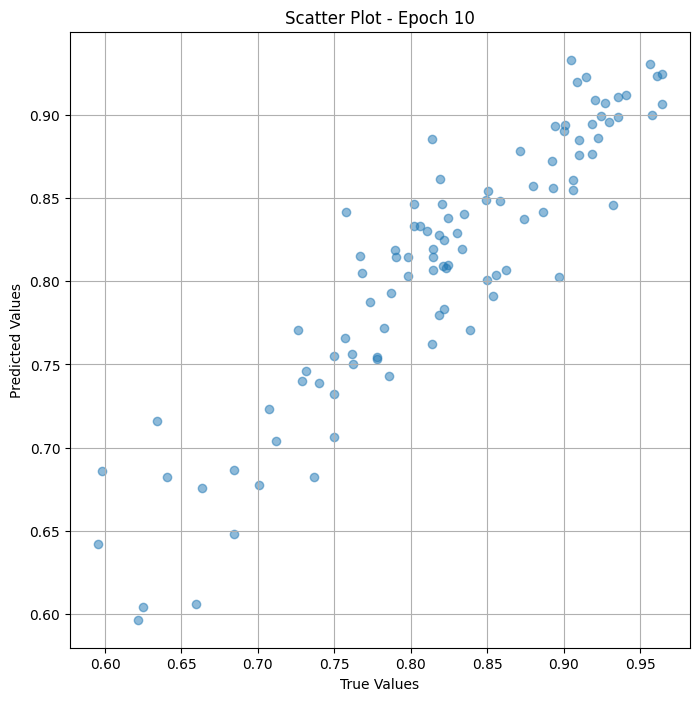

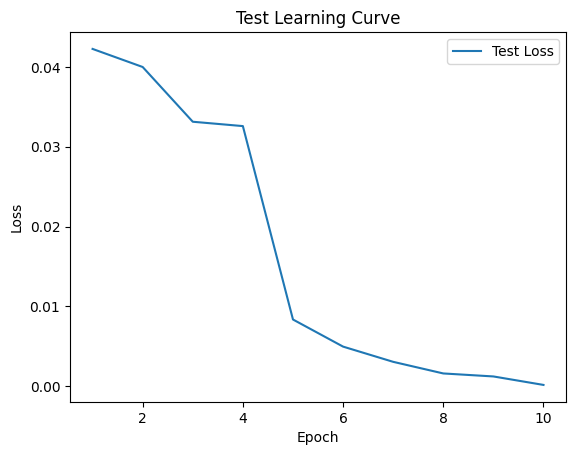


 Epoch: (11/30) Loss = 0.0005024793790653348

 Epoch: (11/30) Loss_rmse = 0.022416051477193832

 Epoch: (11/30) R^2 = 0.8244854807853699

 Epoch: (11/30) MAE = 0.016627565026283264
Spearman correlation coefficient: SignificanceResult(statistic=0.9314237854474553, pvalue=4.794979023919083e-43)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921,

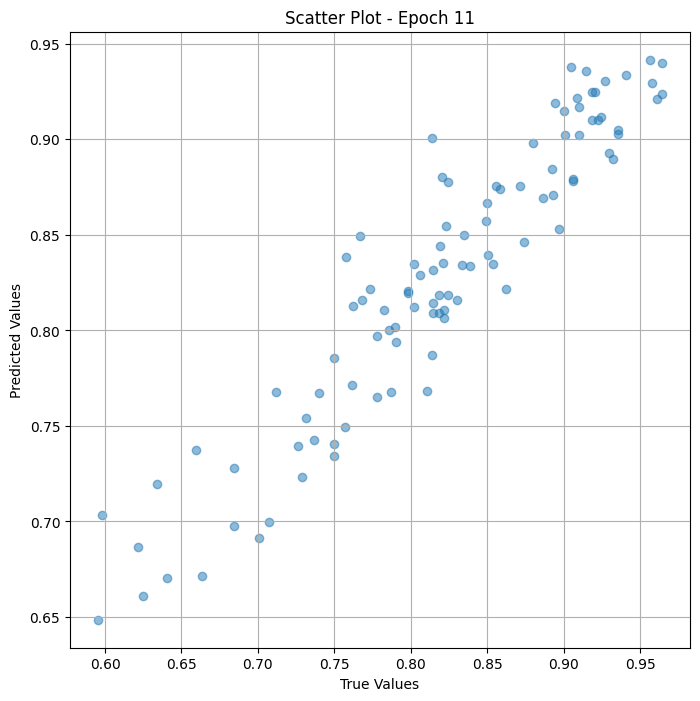

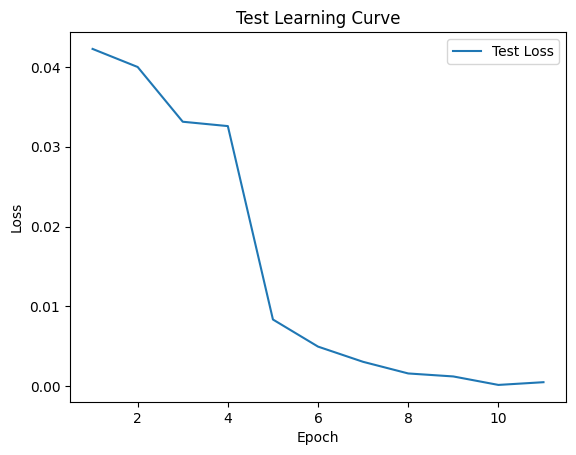


 Epoch: (12/30) Loss = 0.00014796649338677526

 Epoch: (12/30) Loss_rmse = 0.012164147570729256

 Epoch: (12/30) R^2 = 0.9483157396316528

 Epoch: (12/30) MAE = 0.011485055088996887
Spearman correlation coefficient: SignificanceResult(statistic=0.9618508564730391, pvalue=1.0371339444568132e-54)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

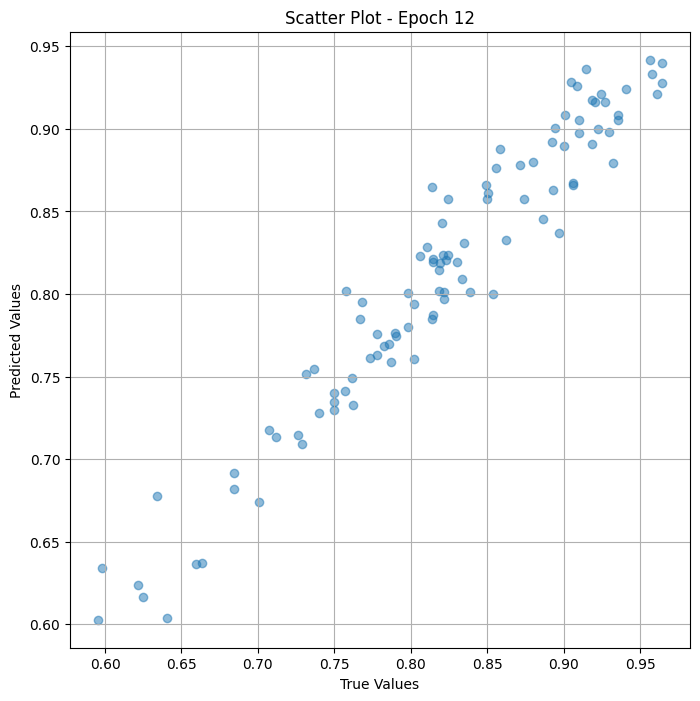

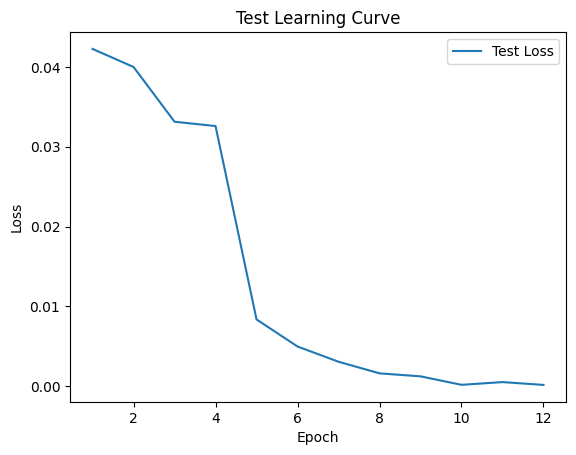


 Epoch: (13/30) Loss = 0.000104207792901434

 Epoch: (13/30) Loss_rmse = 0.010208222083747387

 Epoch: (13/30) R^2 = 0.9636005163192749

 Epoch: (13/30) MAE = 0.007535174489021301
Spearman correlation coefficient: SignificanceResult(statistic=0.9759588162887356, pvalue=5.383315932839408e-64)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 

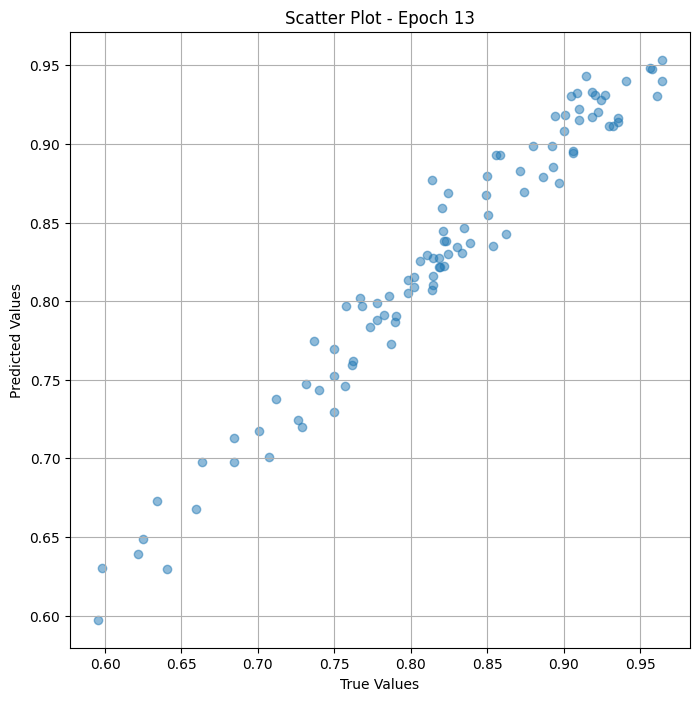

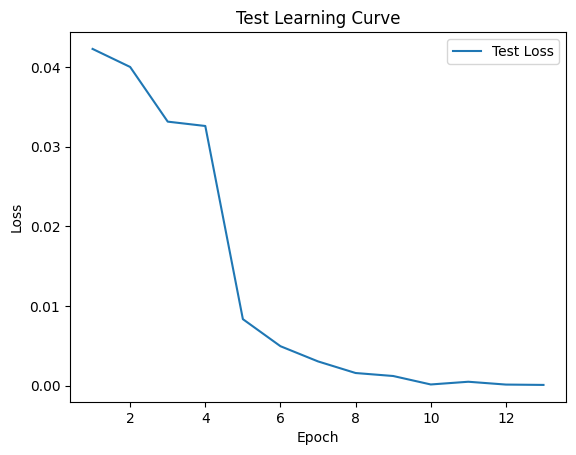


 Epoch: (14/30) Loss = 5.545723979594186e-06

 Epoch: (14/30) Loss_rmse = 0.0023549359757453203

 Epoch: (14/30) R^2 = 0.9980629086494446

 Epoch: (14/30) MAE = 0.0022524595260620117
Spearman correlation coefficient: SignificanceResult(statistic=0.9843150694103404, pvalue=1.2483135023314212e-72)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

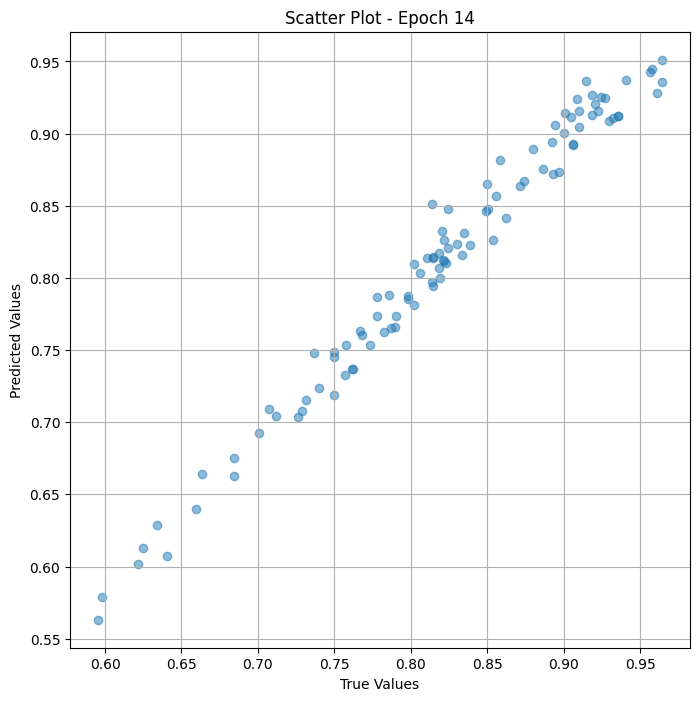

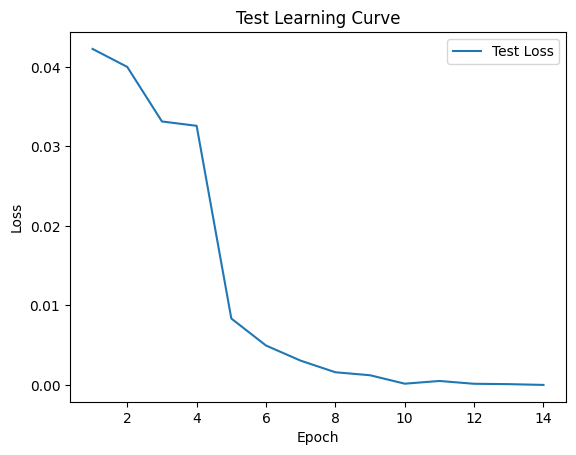


 Epoch: (15/30) Loss = 5.10215359099675e-05

 Epoch: (15/30) Loss_rmse = 0.0071429358795285225

 Epoch: (15/30) R^2 = 0.9821783304214478

 Epoch: (15/30) MAE = 0.0056459903717041016
Spearman correlation coefficient: SignificanceResult(statistic=0.98959198899525, pvalue=5.982219665656567e-81)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 

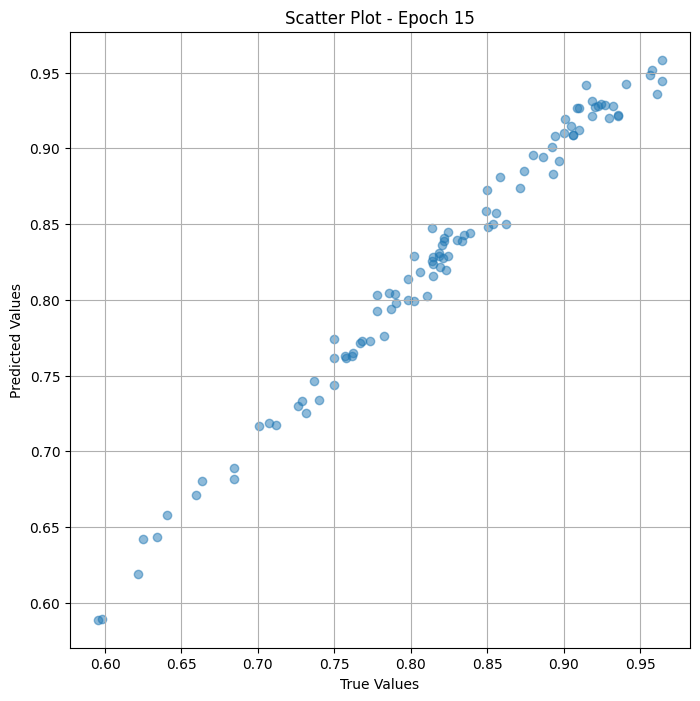

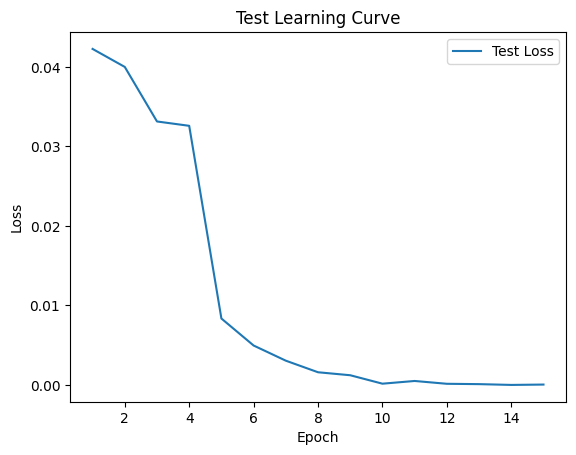


 Epoch: (16/30) Loss = 4.444634396350011e-05

 Epoch: (16/30) Loss_rmse = 0.006666809320449829

 Epoch: (16/30) R^2 = 0.9844750165939331

 Epoch: (16/30) MAE = 0.005561470985412598
Spearman correlation coefficient: SignificanceResult(statistic=0.9926306264940155, pvalue=5.7499283122225e-88)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0

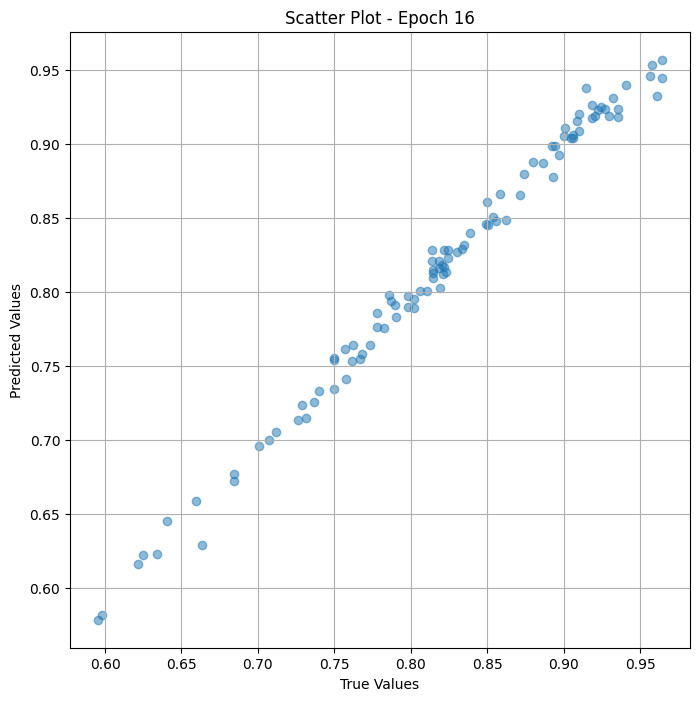

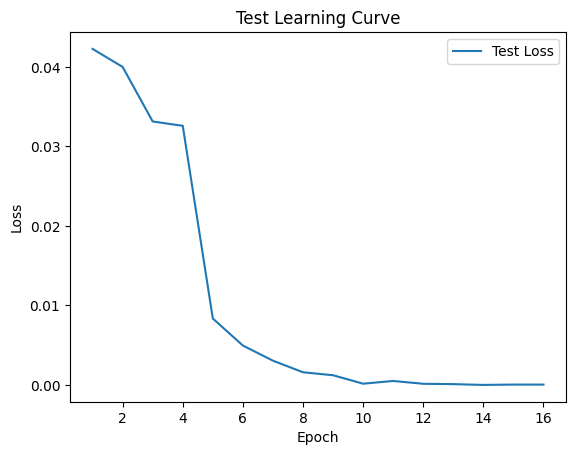

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (17/30) Loss = 3.071187165915035e-05

 Epoch: (17/30) Loss_rmse = 0.005541829392313957

 Epoch: (17/30) R^2 = 0.98927241563797

 Epoch: (17/30) MAE = 0.004510596394538879
Spearman correlation coefficient: SignificanceResult(statistic=0.9947536031393581, pvalue=6.994013329354251e-95)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.8144

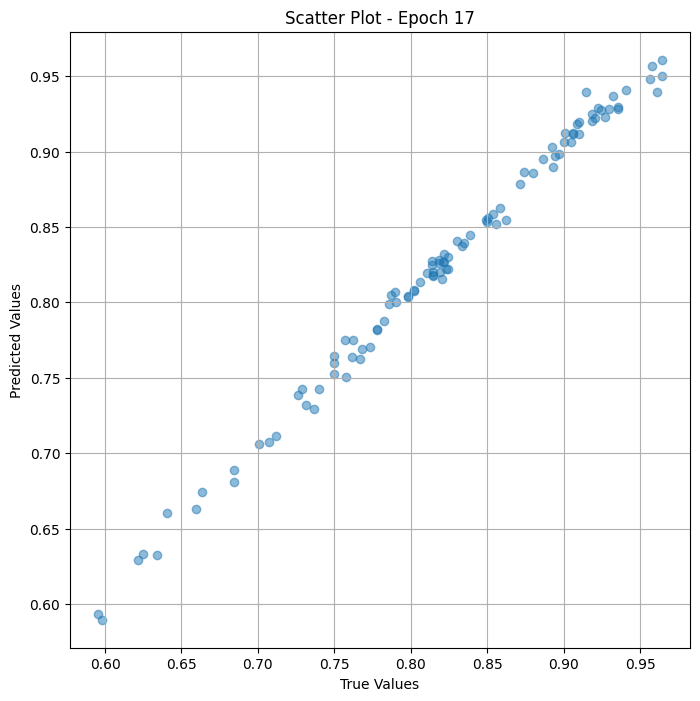

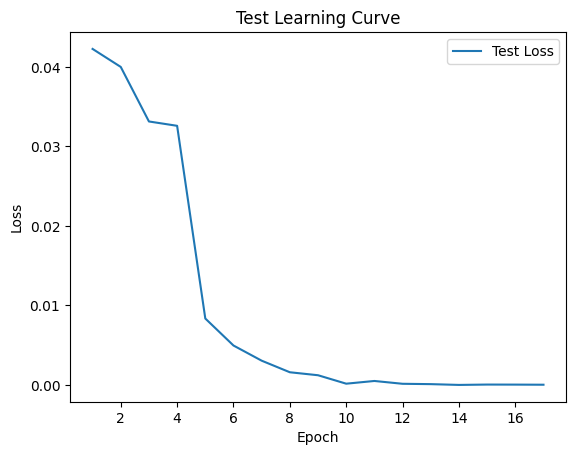


 Epoch: (18/30) Loss = 9.915556802297942e-06

 Epoch: (18/30) Loss_rmse = 0.003148897783830762

 Epoch: (18/30) R^2 = 0.9965365529060364

 Epoch: (18/30) MAE = 0.002673432230949402
Spearman correlation coefficient: SignificanceResult(statistic=0.9955132625140495, pvalue=4.5650055147623715e-98)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921

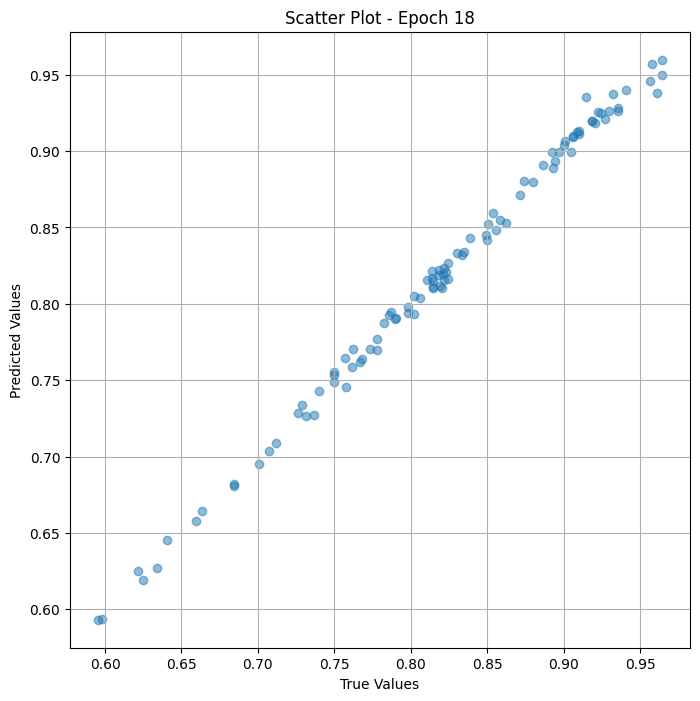

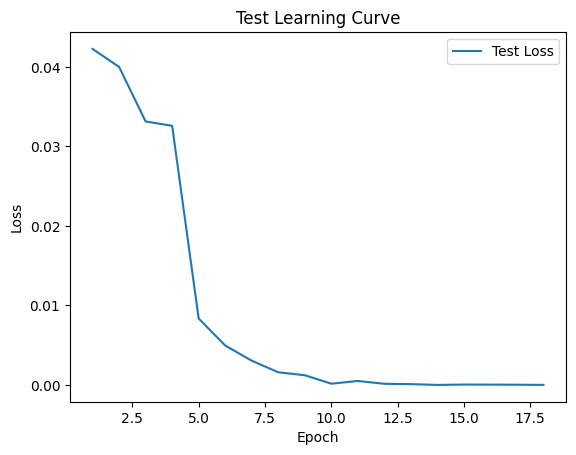


 Epoch: (19/30) Loss = 6.845589723525336e-06

 Epoch: (19/30) Loss_rmse = 0.0026164078153669834

 Epoch: (19/30) R^2 = 0.9976088404655457

 Epoch: (19/30) MAE = 0.0021967291831970215
Spearman correlation coefficient: SignificanceResult(statistic=0.9957031773577223, pvalue=6.004692999240207e-99)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

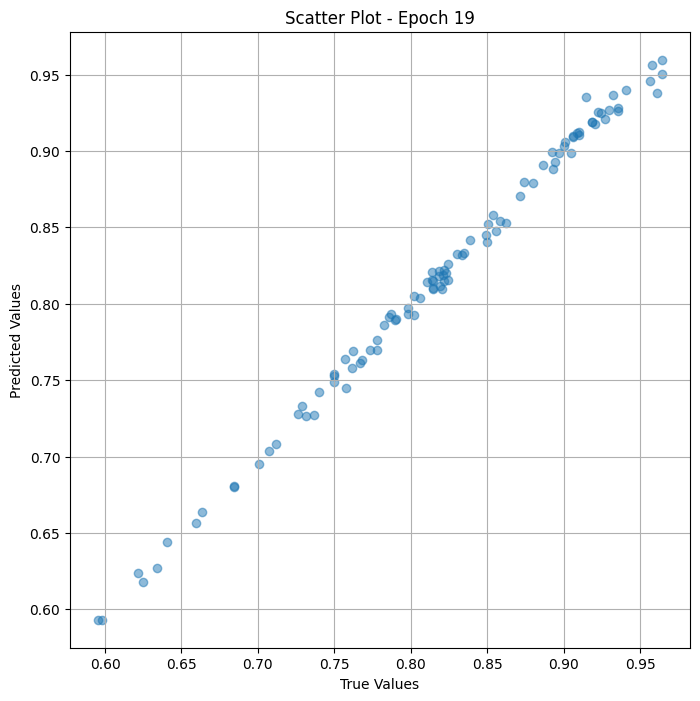

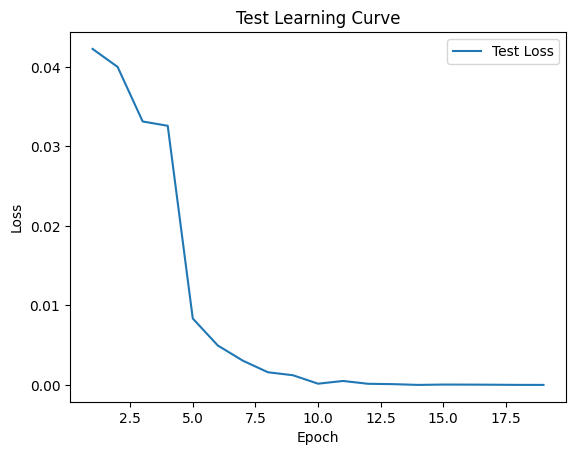


 Epoch: (20/30) Loss = 4.187726062809816e-06

 Epoch: (20/30) Loss_rmse = 0.0020463934633880854

 Epoch: (20/30) R^2 = 0.9985372424125671

 Epoch: (20/30) MAE = 0.0017594248056411743
Spearman correlation coefficient: SignificanceResult(statistic=0.9960965723910447, pvalue=6.64331800133043e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

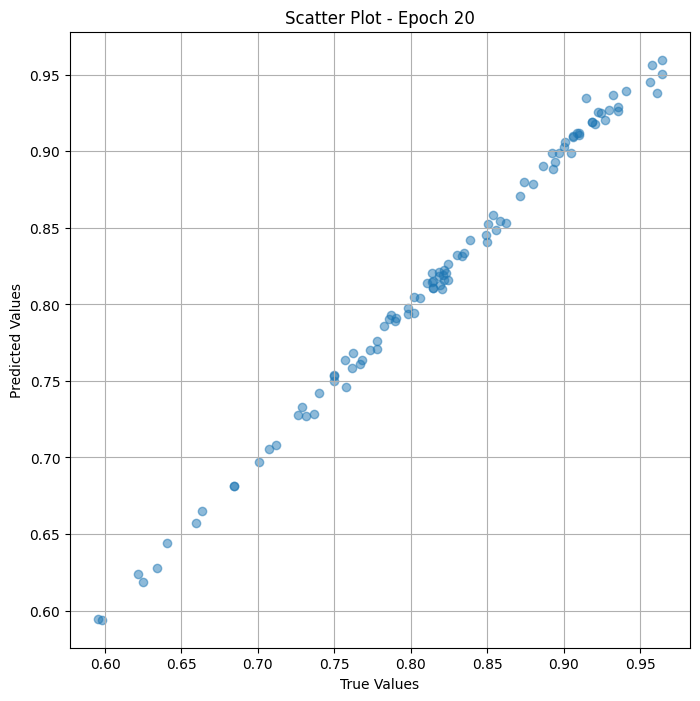

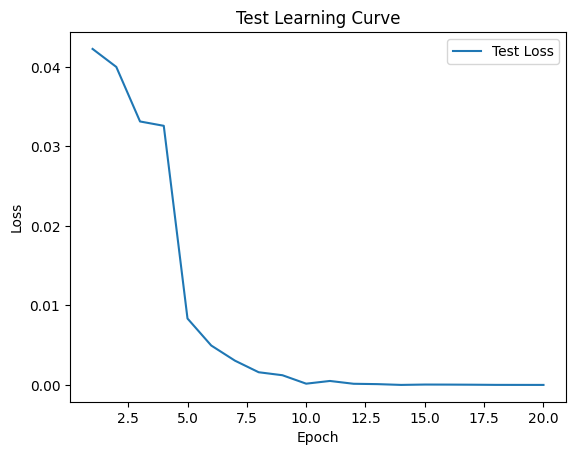


 Epoch: (21/30) Loss = 2.7640890039037913e-06

 Epoch: (21/30) Loss_rmse = 0.001662554917857051

 Epoch: (21/30) R^2 = 0.9990345239639282

 Epoch: (21/30) MAE = 0.0013395249843597412
Spearman correlation coefficient: SignificanceResult(statistic=0.9961779644669045, pvalue=2.472101828196889e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

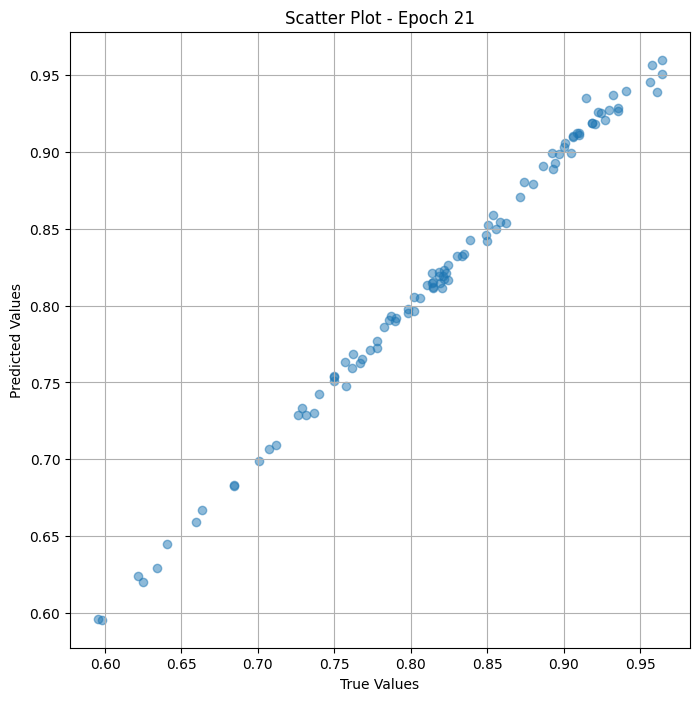

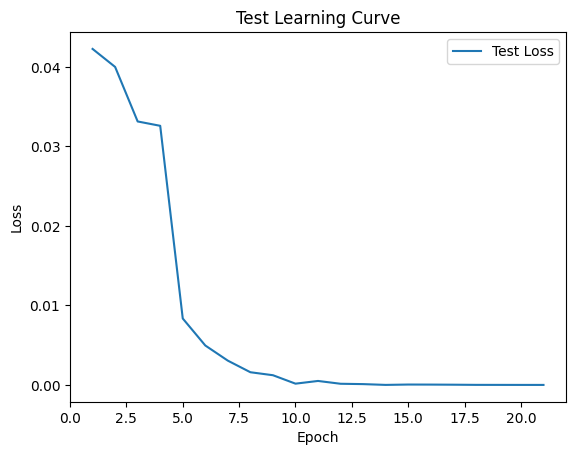


 Epoch: (22/30) Loss = 1.688817178546742e-06

 Epoch: (22/30) Loss_rmse = 0.0012995449360460043

 Epoch: (22/30) R^2 = 0.999410092830658

 Epoch: (22/30) MAE = 0.0011763274669647217
Spearman correlation coefficient: SignificanceResult(statistic=0.9966120555381567, pvalue=8.639186200672884e-104)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

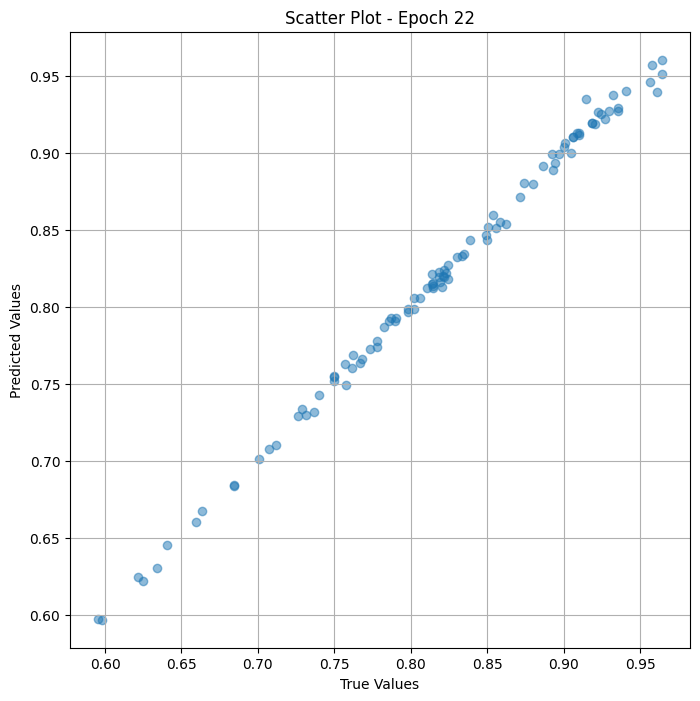

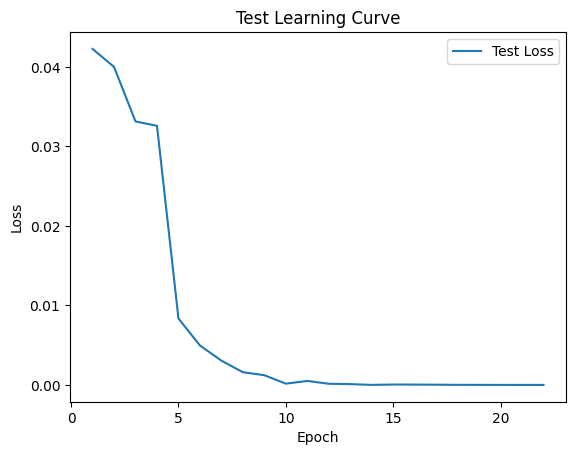


 Epoch: (23/30) Loss = 5.611066171695711e-07

 Epoch: (23/30) Loss_rmse = 0.0007490704883821309

 Epoch: (23/30) R^2 = 0.9998040199279785

 Epoch: (23/30) MAE = 0.0007307678461074829
Spearman correlation coefficient: SignificanceResult(statistic=0.9967544916709115, pvalue=1.1512009042857506e-104)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

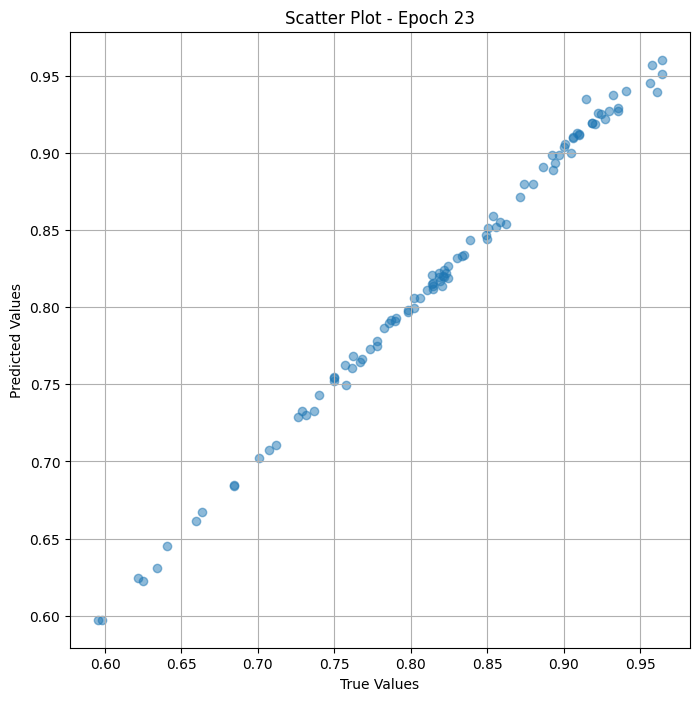

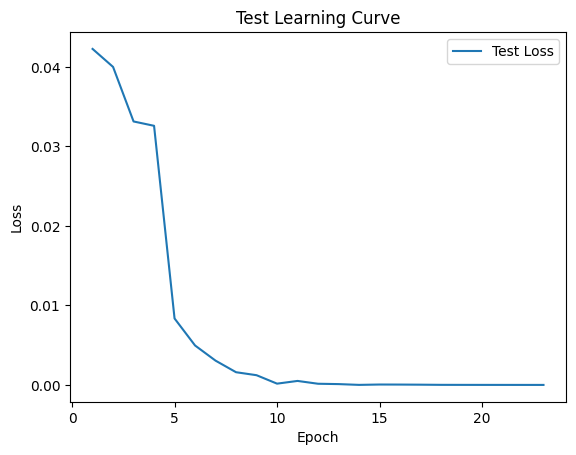


 Epoch: (24/30) Loss = 9.666731415336471e-08

 Epoch: (24/30) Loss_rmse = 0.0003109136887360364

 Epoch: (24/30) R^2 = 0.9999662637710571

 Epoch: (24/30) MAE = 0.000287473201751709
Spearman correlation coefficient: SignificanceResult(statistic=0.997025798590444, pvalue=1.9139388890864437e-106)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

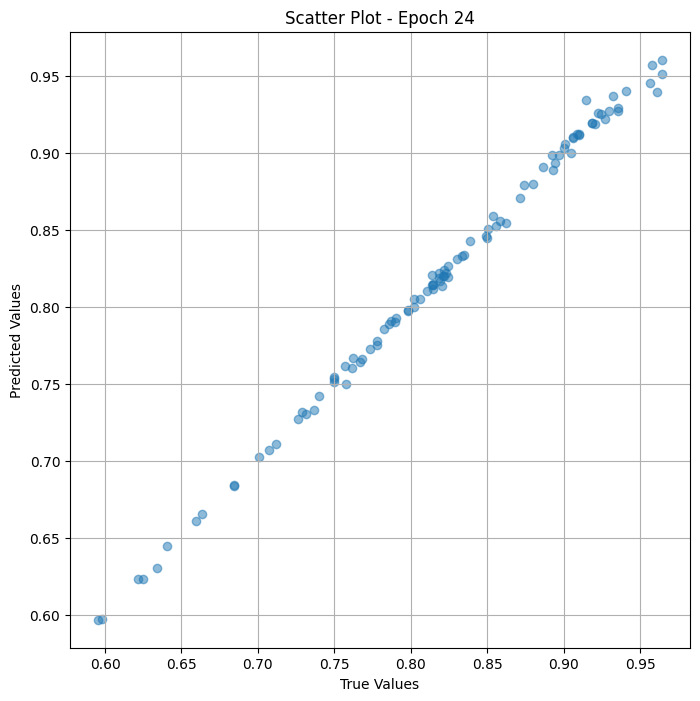

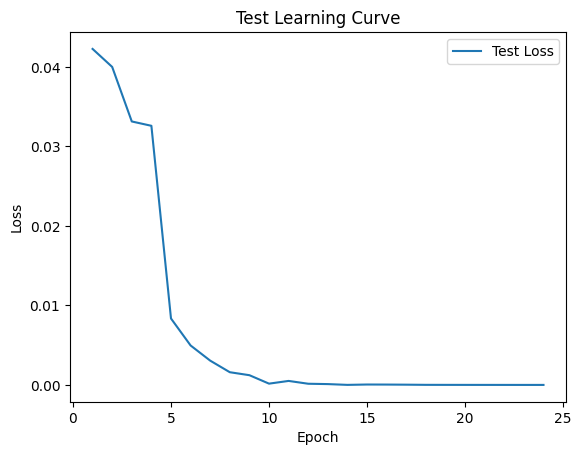


 Epoch: (25/30) Loss = 2.5724952479322383e-07

 Epoch: (25/30) Loss_rmse = 0.0005071976920589805

 Epoch: (25/30) R^2 = 0.9999101161956787

 Epoch: (25/30) MAE = 0.00039155781269073486
Spearman correlation coefficient: SignificanceResult(statistic=0.9973038881829648, pvalue=1.909524975101944e-108)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

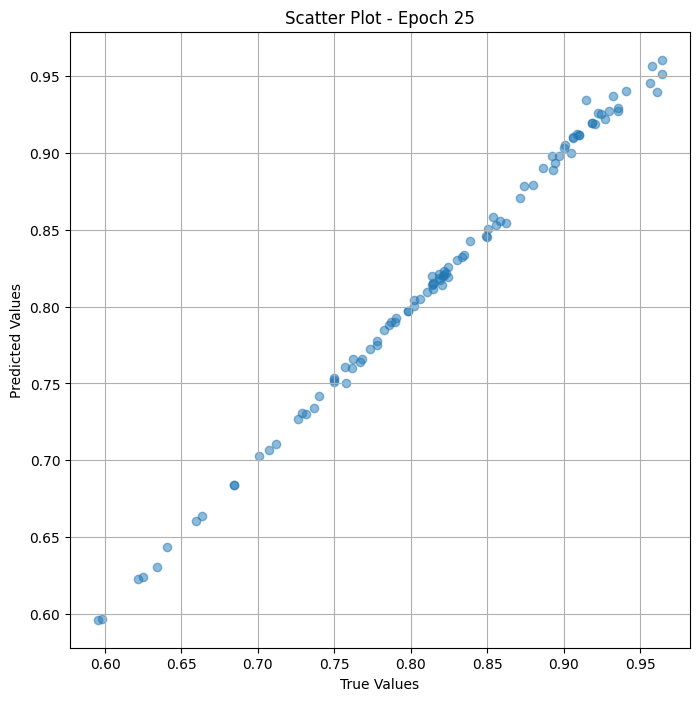

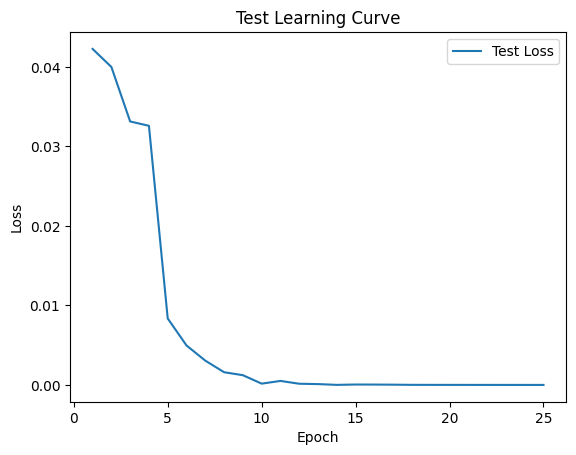


 Epoch: (26/30) Loss = 3.2923082926572533e-07

 Epoch: (26/30) Loss_rmse = 0.0005737863830290735

 Epoch: (26/30) R^2 = 0.9998850226402283

 Epoch: (26/30) MAE = 0.00046771764755249023
Spearman correlation coefficient: SignificanceResult(statistic=0.9978261540030652, pvalue=7.782345484611955e-113)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

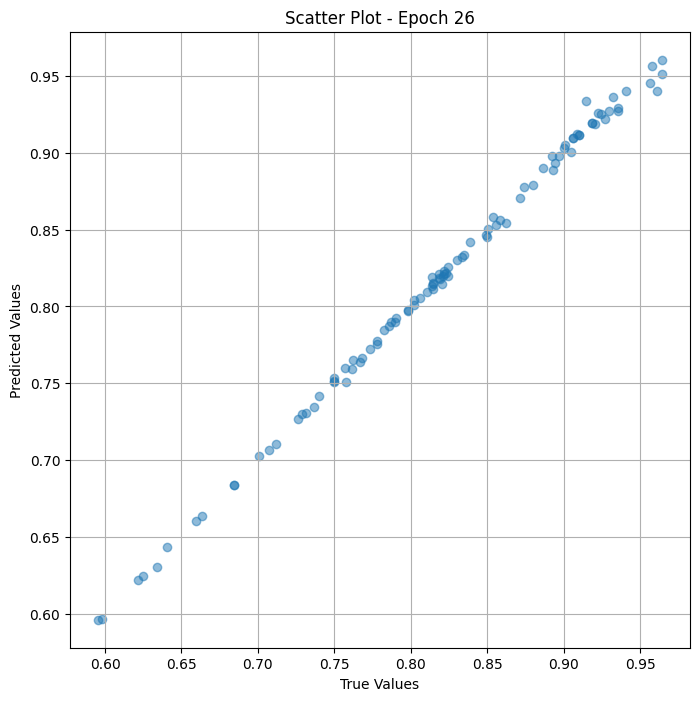

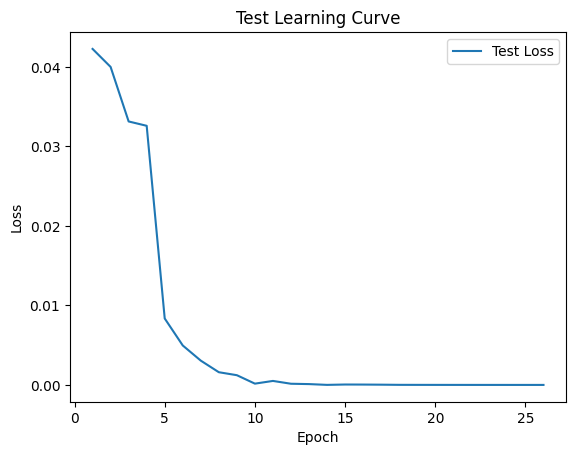

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (27/30) Loss = 1.8267189716425491e-07

 Epoch: (27/30) Loss_rmse = 0.0004274013335816562

 Epoch: (27/30) R^2 = 0.9999362230300903

 Epoch: (27/30) MAE = 0.0003578364849090576
Spearman correlation coefficient: SignificanceResult(statistic=0.9979957208277731, pvalue=1.71812323265442e-114)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0

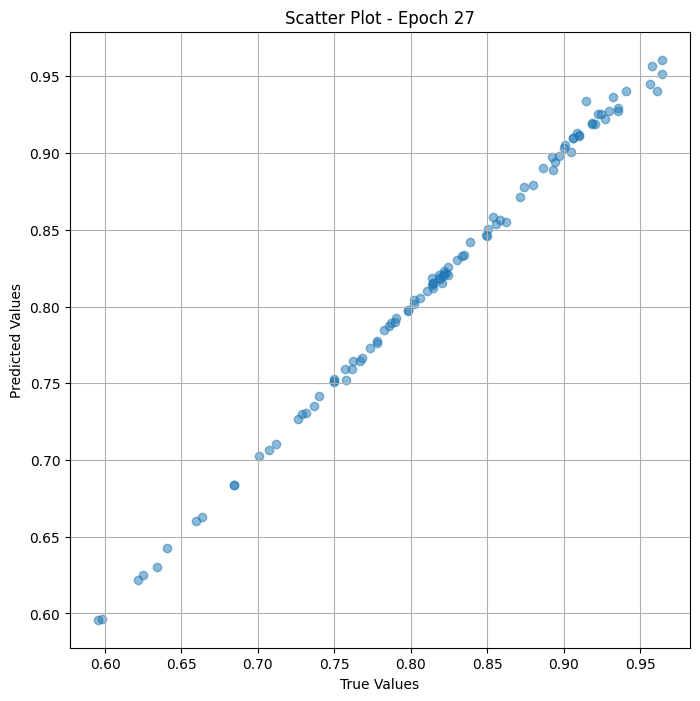

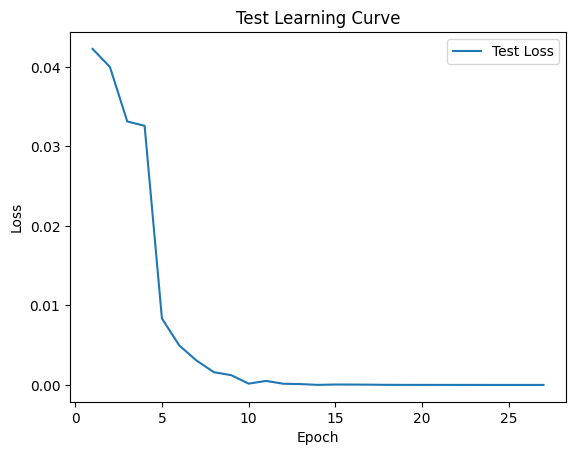


 Epoch: (28/30) Loss = 1.2871836929662095e-07

 Epoch: (28/30) Loss_rmse = 0.00035877342452295125

 Epoch: (28/30) R^2 = 0.9999550580978394

 Epoch: (28/30) MAE = 0.0002996772527694702
Spearman correlation coefficient: SignificanceResult(statistic=0.9981788529984575, pvalue=1.909968594786556e-116)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

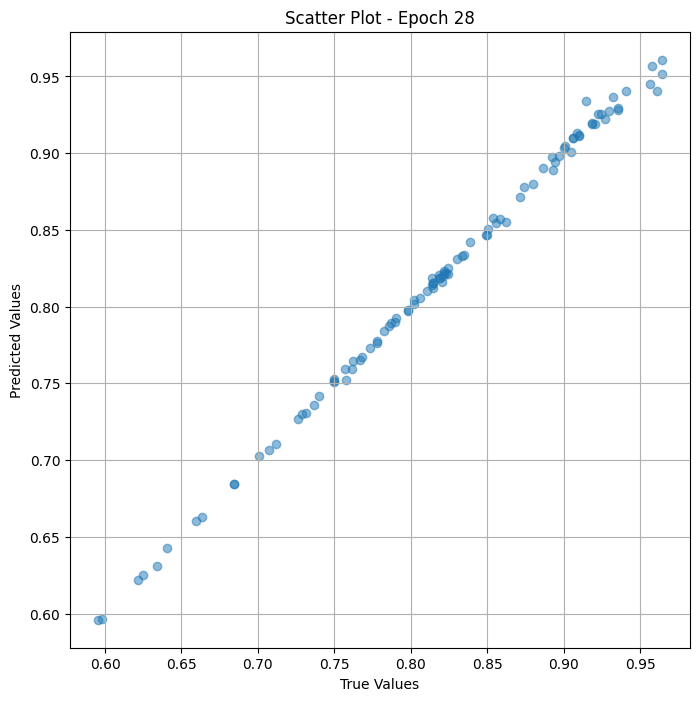

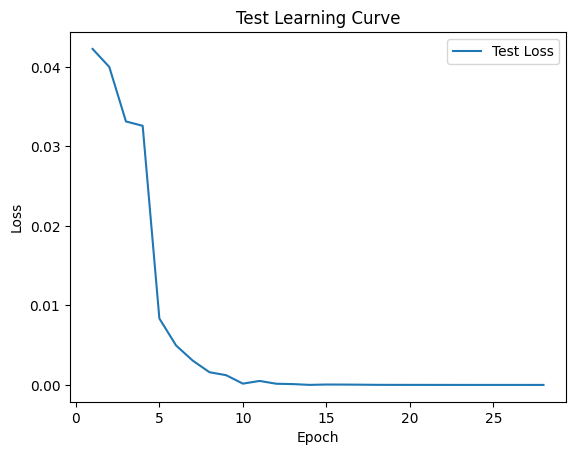


 Epoch: (29/30) Loss = 1.177248307726586e-07

 Epoch: (29/30) Loss_rmse = 0.0003431105287745595

 Epoch: (29/30) R^2 = 0.999958872795105

 Epoch: (29/30) MAE = 0.00028674304485321045
Spearman correlation coefficient: SignificanceResult(statistic=0.9981788529984575, pvalue=1.909968594786556e-116)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

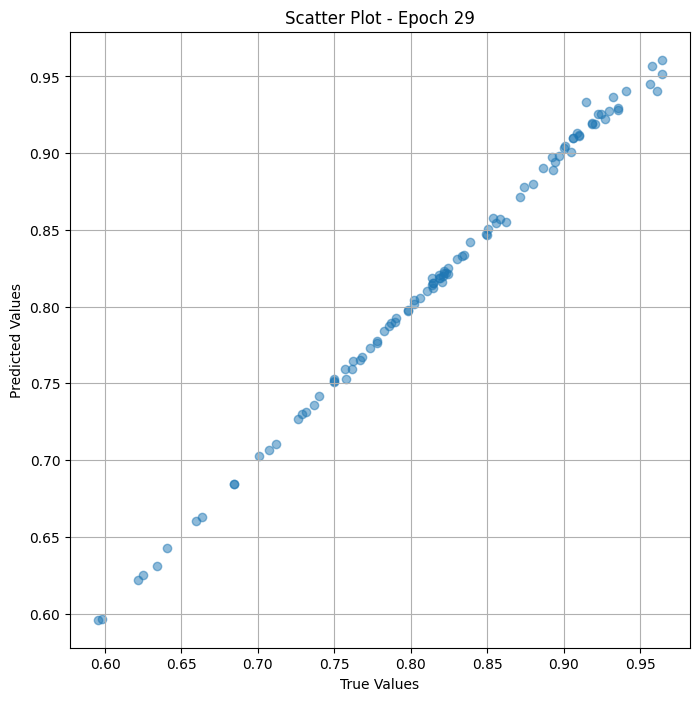

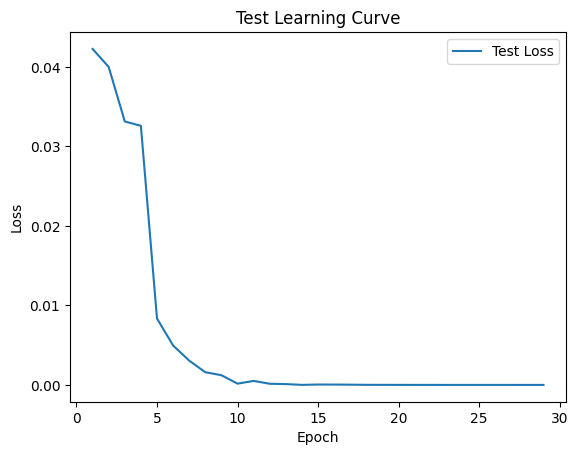

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (30/30) Loss = 1.0804016881138523e-07

 Epoch: (30/30) Loss_rmse = 0.0003286946448497474

 Epoch: (30/30) R^2 = 0.9999622702598572

 Epoch: (30/30) MAE = 0.0002753138542175293
Spearman correlation coefficient: SignificanceResult(statistic=0.9982534624013292, pvalue=2.678579777877673e-117)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 

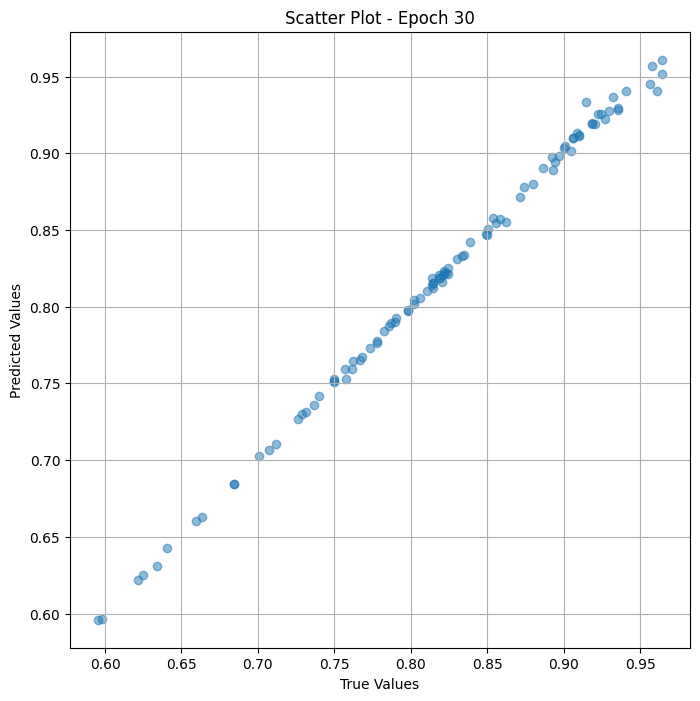

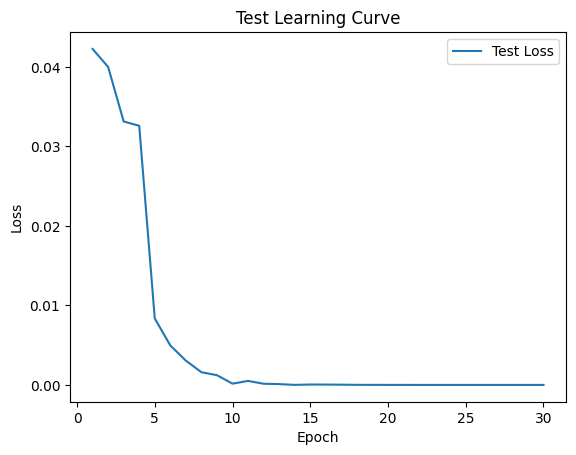

In [ ]:
# val the model and save weights
fit(30, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_animal' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_test_animal['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                          Image Path  True Value  \
0   /content/animal/n02342885_12762_preprocessed.jpg    0.940678   
1      /content/animal/000000474764_preprocessed.jpg    0.894231   
2      /content/animal/000000131059_preprocessed.jpg    0.597938   
3    /content/animal/n01846331_8530_preprocessed.jpg    0.659574   
4    /content/animal/n02342885_4519_preprocessed.jpg    0.918367   
..                                               ...         ...   
95  /content/animal/n02355227_13530_preprocessed.jpg    0.935780   
96  /content/animal/n01846331_11534_preprocessed.jpg    0.814815   
97     /content/animal/000000367468_preprocessed.jpg    0.850575   
98     /content/animal/000000576206_preprocessed.jpg    0.707071   
99   /content/animal/n02332755_2718_preprocessed.jpg    0.810526   

    Predicted Value  
0          0.917621  
1          0.893405  
2          0.689726  
3          0.777577  
4          0.903766  
..              ...  
95         0.862393  
96     

#Finetuning

##Train

In [ ]:
class Dataset_train_fine_animal(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_animal["memoscore"]
        self.images = df_train_animal["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds_fine = Dataset_train_fine_animal(df_train_animal, trans_transform=trans_transform)
train_dl_fine = DataLoader(train_ds_fine, batch_size=16, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


'for image_trans, label in train_dl:\n    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch\n    print(image_trans)\n    break'

In [ ]:
class ViTMem_model_fine_animal(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_fine =  ViTMem_model_fine_animal( arch="vit_base_patch16_224_miil")

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_fine = DeviceDataLoader(train_dl_fine, device)
model_vit_fine  = to_device(model_vit_fine  , device)

In [ ]:
params = [param for param in list(model_vit_fine.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_fine, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_fine.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_fine(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.02350703813135624

 Epoch: (1/30) Loss_rmse = 0.1533200442790985

 Epoch: (1/30) R^2 = 0.015092074871063232

 Epoch: (1/30) MAE = 0.10854986310005188
Spearman correlation coefficient: SignificanceResult(statistic=0.10003517202626616, pvalue=2.211605980678556e-05)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 

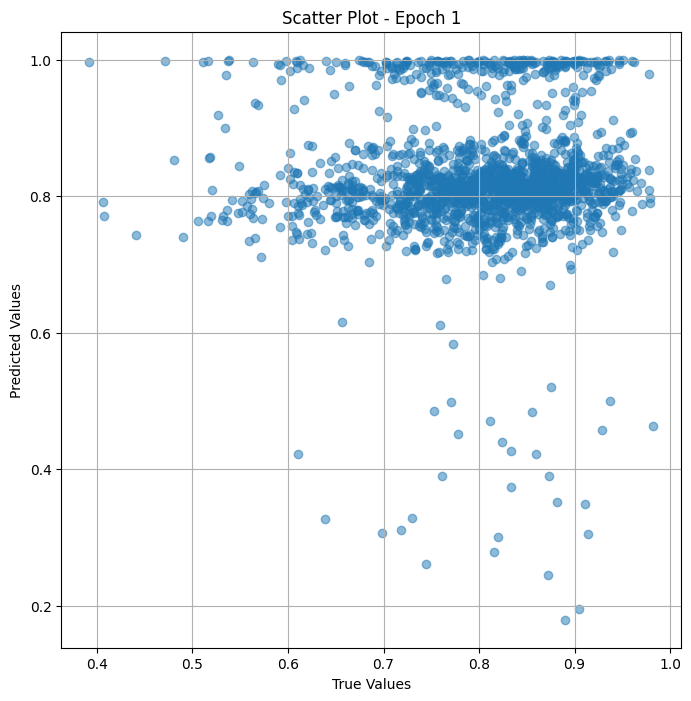

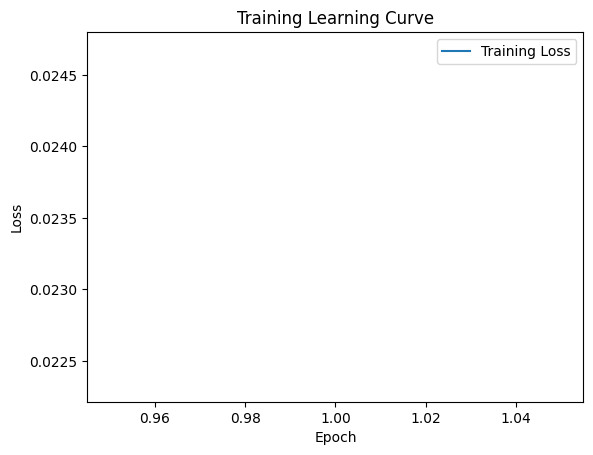


 Epoch: (2/30) Loss = 0.014120860956609249

 Epoch: (2/30) Loss_rmse = 0.11883123219013214

 Epoch: (2/30) R^2 = 0.408358097076416

 Epoch: (2/30) MAE = 0.07537897676229477
Spearman correlation coefficient: SignificanceResult(statistic=0.37533509305513696, pvalue=4.7792487241734485e-61)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 

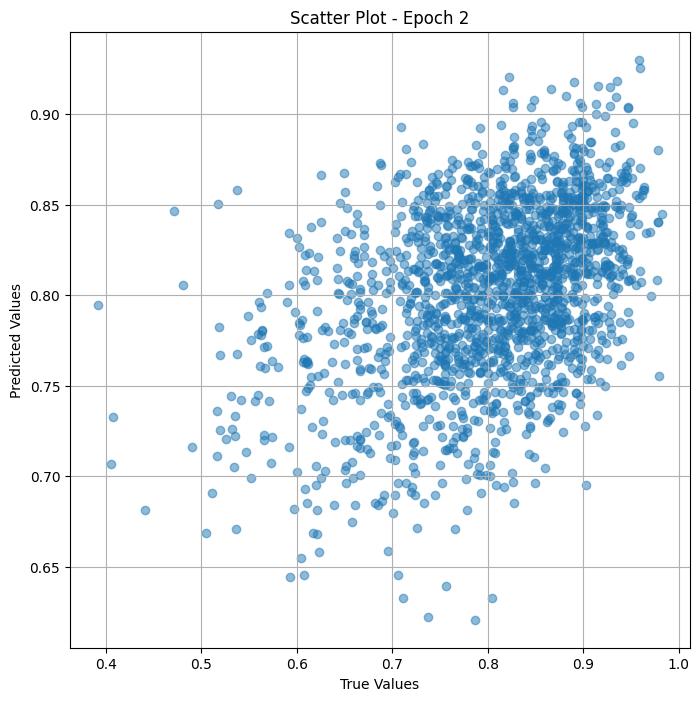

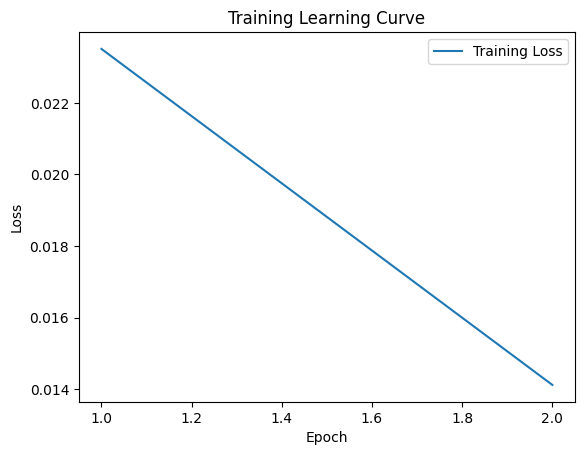


 Epoch: (3/30) Loss = 0.009203523397445679

 Epoch: (3/30) Loss_rmse = 0.09593499451875687

 Epoch: (3/30) R^2 = 0.614386796951294

 Epoch: (3/30) MAE = 0.07355485111474991
Spearman correlation coefficient: SignificanceResult(statistic=0.4819445860163907, pvalue=7.128210934192136e-105)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0

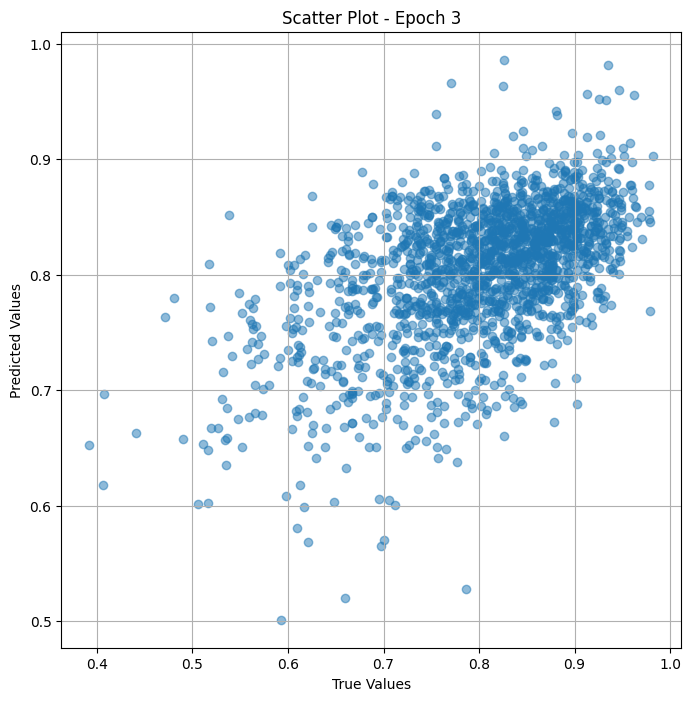

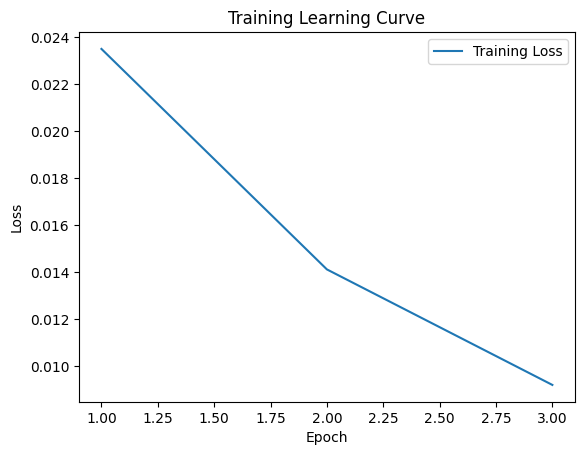


 Epoch: (4/30) Loss = 0.002893720520660281

 Epoch: (4/30) Loss_rmse = 0.05379331111907959

 Epoch: (4/30) R^2 = 0.878757655620575

 Epoch: (4/30) MAE = 0.037265121936798096
Spearman correlation coefficient: SignificanceResult(statistic=0.5805707082948716, pvalue=5.360145363793469e-162)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 

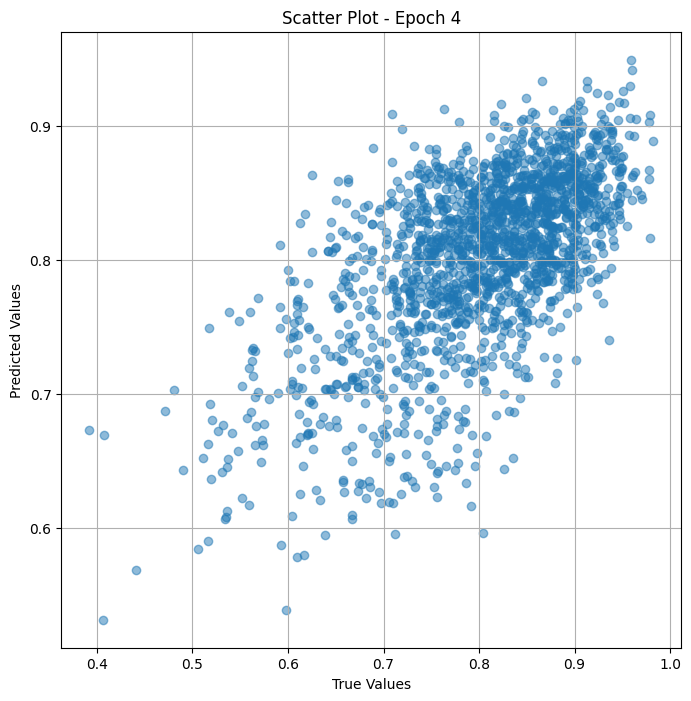

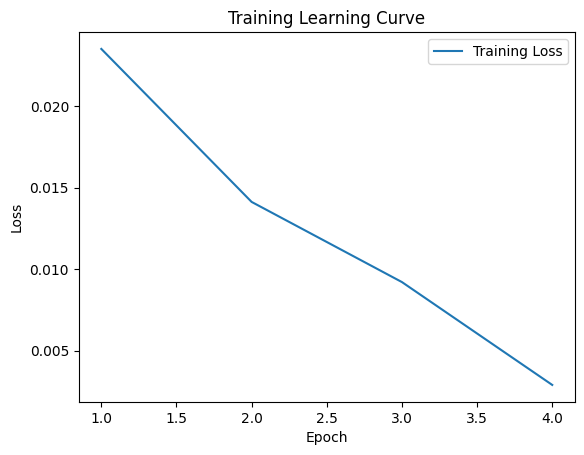


 Epoch: (5/30) Loss = 0.0006041835295036435

 Epoch: (5/30) Loss_rmse = 0.02458014525473118

 Epoch: (5/30) R^2 = 0.9746856689453125

 Epoch: (5/30) MAE = 0.021976448595523834
Spearman correlation coefficient: SignificanceResult(statistic=0.6724270668226797, pvalue=3.498774920419262e-236)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636

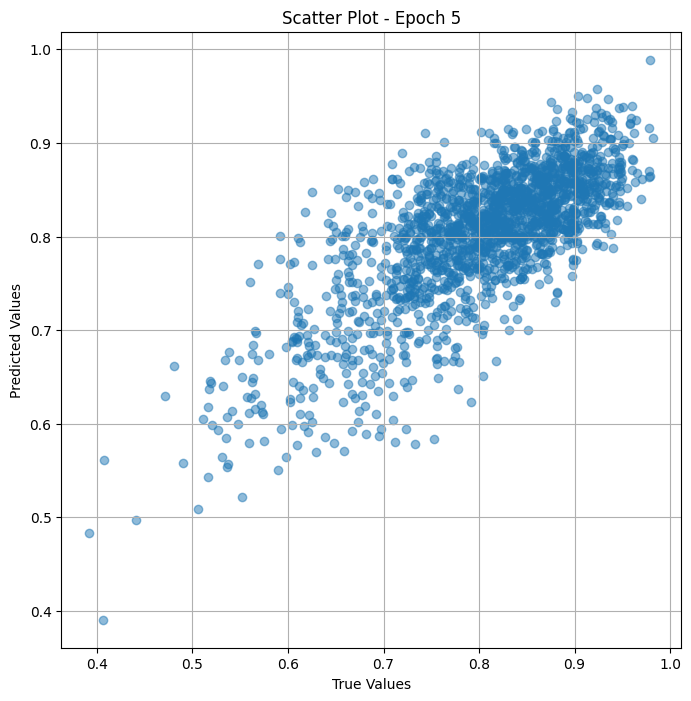

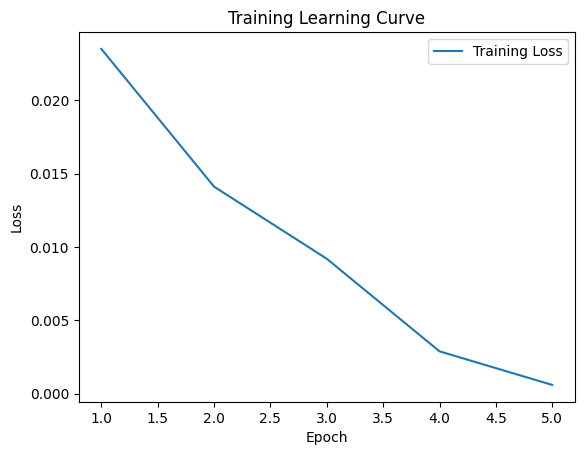


 Epoch: (6/30) Loss = 0.0019956533797085285

 Epoch: (6/30) Loss_rmse = 0.044672735035419464

 Epoch: (6/30) R^2 = 0.916385293006897

 Epoch: (6/30) MAE = 0.0381835475564003
Spearman correlation coefficient: SignificanceResult(statistic=0.6822462974017938, pvalue=9.627503038991784e-246)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 

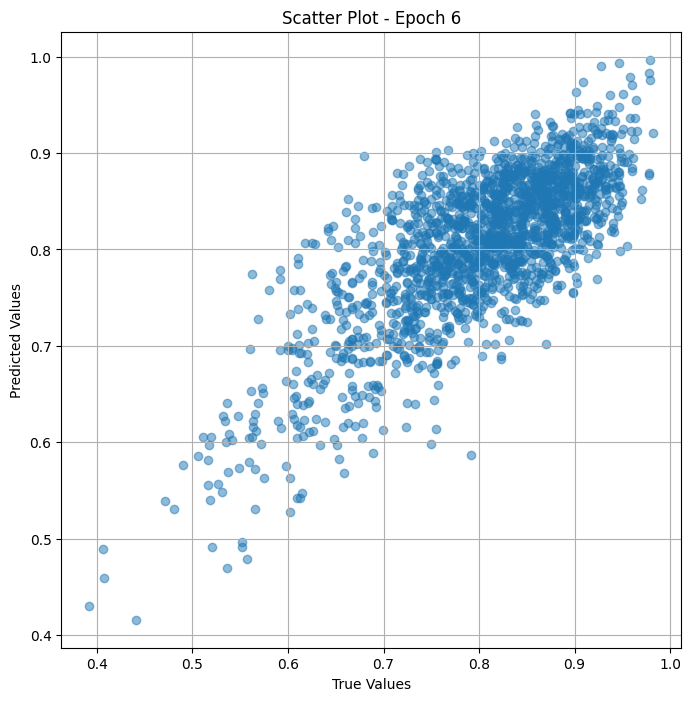

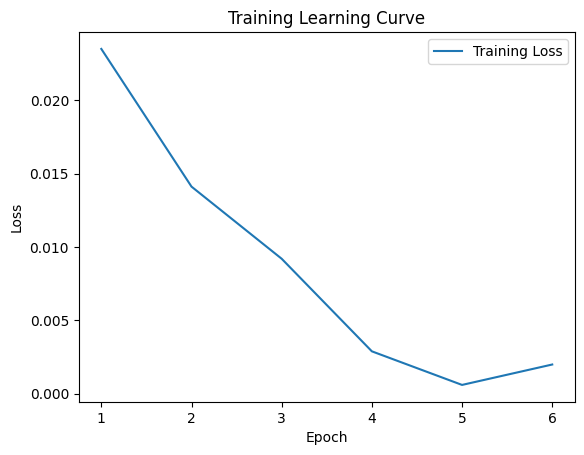


 Epoch: (7/30) Loss = 0.003828006098046899

 Epoch: (7/30) Loss_rmse = 0.06187088415026665

 Epoch: (7/30) R^2 = 0.8396125435829163

 Epoch: (7/30) MAE = 0.05865449458360672
Spearman correlation coefficient: SignificanceResult(statistic=0.6818965527989899, pvalue=2.1404644845661575e-245)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636,

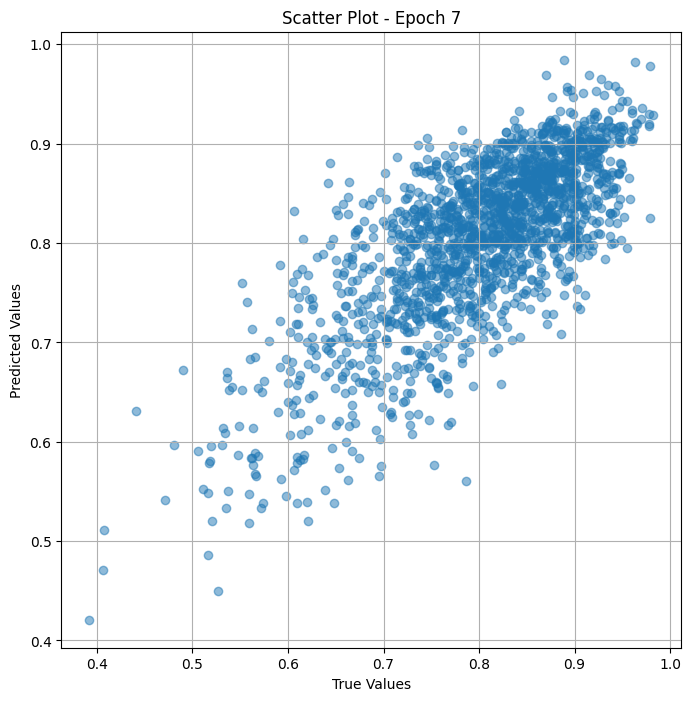

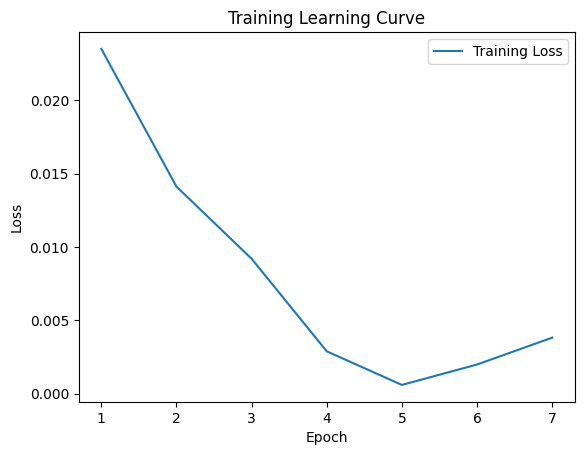

Epoch 0.07: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (8/30) Loss = 0.0044314186088740826

 Epoch: (8/30) Loss_rmse = 0.06656890362501144

 Epoch: (8/30) R^2 = 0.814330518245697

 Epoch: (8/30) MAE = 0.038688305765390396
Spearman correlation coefficient: SignificanceResult(statistic=0.7711477042312883, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.

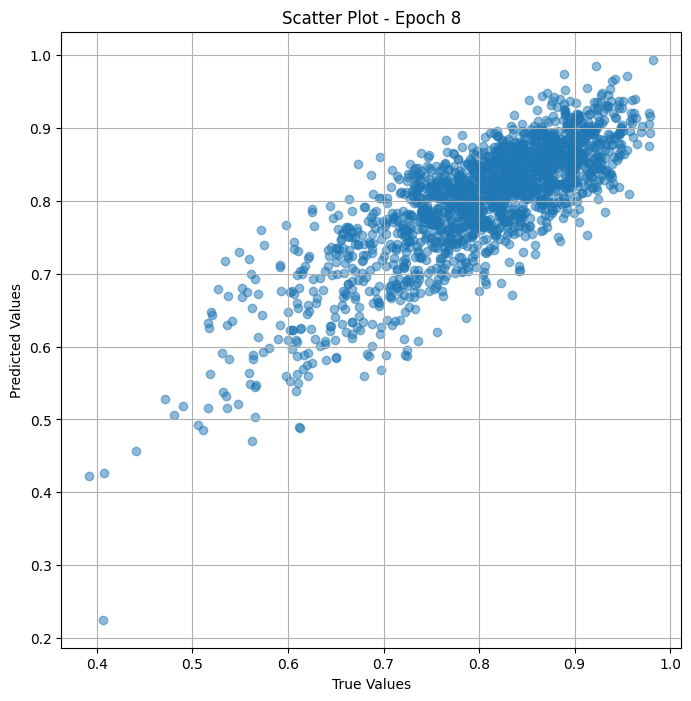

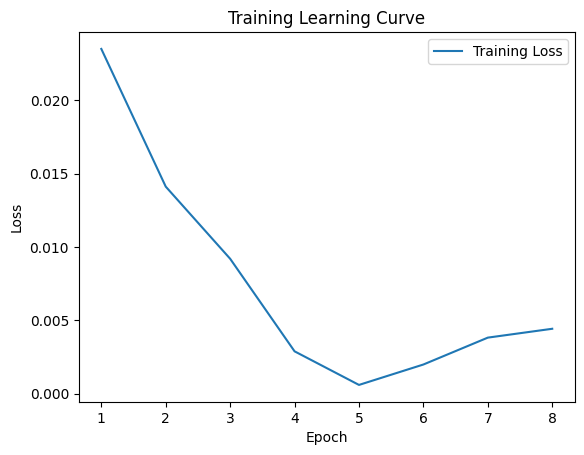


 Epoch: (9/30) Loss = 0.0052400510758161545

 Epoch: (9/30) Loss_rmse = 0.0723881945014

 Epoch: (9/30) R^2 = 0.7804501056671143

 Epoch: (9/30) MAE = 0.0457255095243454
Spearman correlation coefficient: SignificanceResult(statistic=0.8643629336419757, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.90816325, 

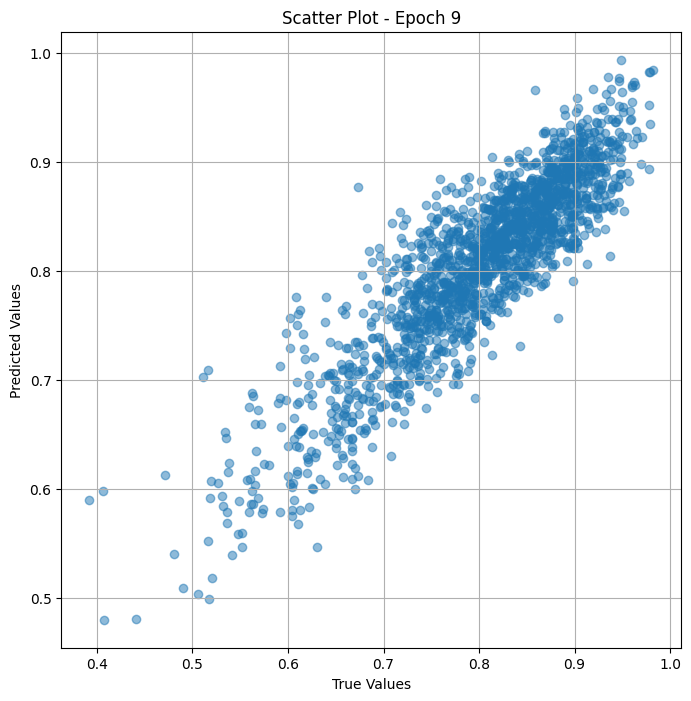

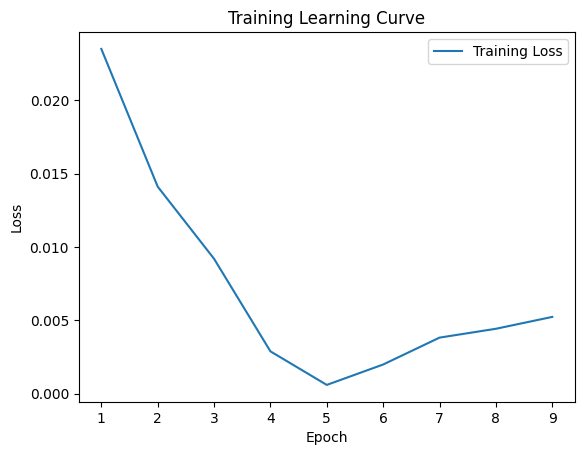


 Epoch: (10/30) Loss = 0.00042521615978330374

 Epoch: (10/30) Loss_rmse = 0.020620770752429962

 Epoch: (10/30) R^2 = 0.982184112071991

 Epoch: (10/30) MAE = 0.017434146255254745
Spearman correlation coefficient: SignificanceResult(statistic=0.9230519964463666, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

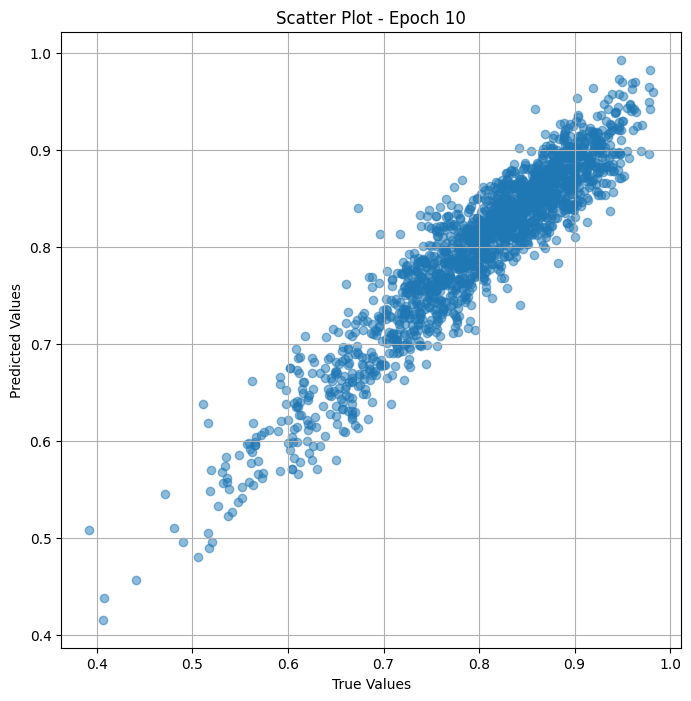

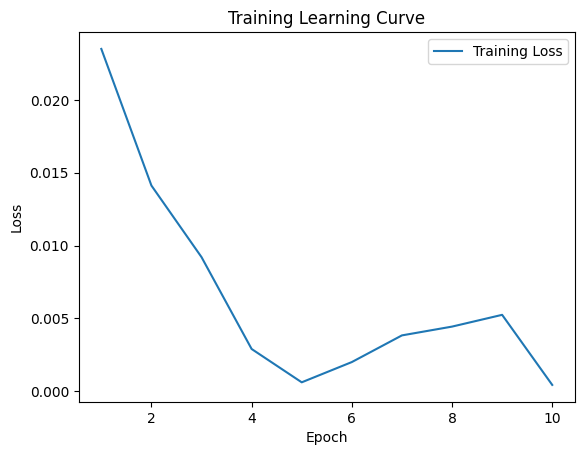


 Epoch: (11/30) Loss = 0.00027973318356089294

 Epoch: (11/30) Loss_rmse = 0.016725225374102592

 Epoch: (11/30) R^2 = 0.9882796406745911

 Epoch: (11/30) MAE = 0.013135295361280441
Spearman correlation coefficient: SignificanceResult(statistic=0.9340815935555709, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 

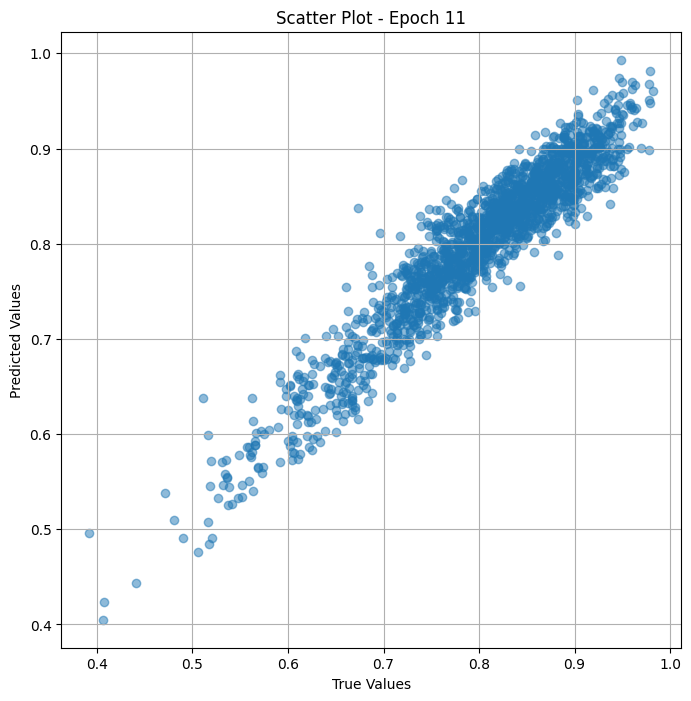

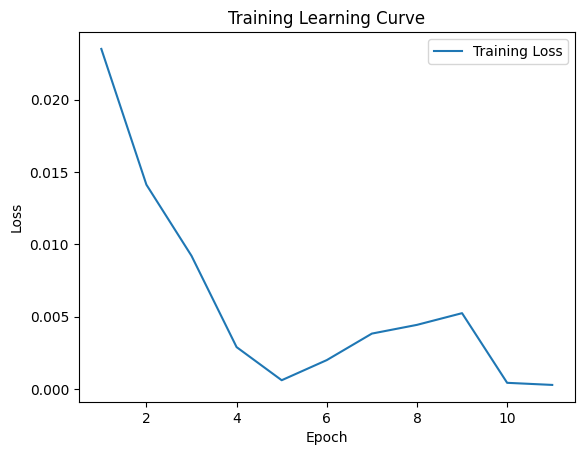


 Epoch: (12/30) Loss = 0.00019443201017566025

 Epoch: (12/30) Loss_rmse = 0.013943888247013092

 Epoch: (12/30) R^2 = 0.9918535947799683

 Epoch: (12/30) MAE = 0.010541703552007675
Spearman correlation coefficient: SignificanceResult(statistic=0.942397610549116, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

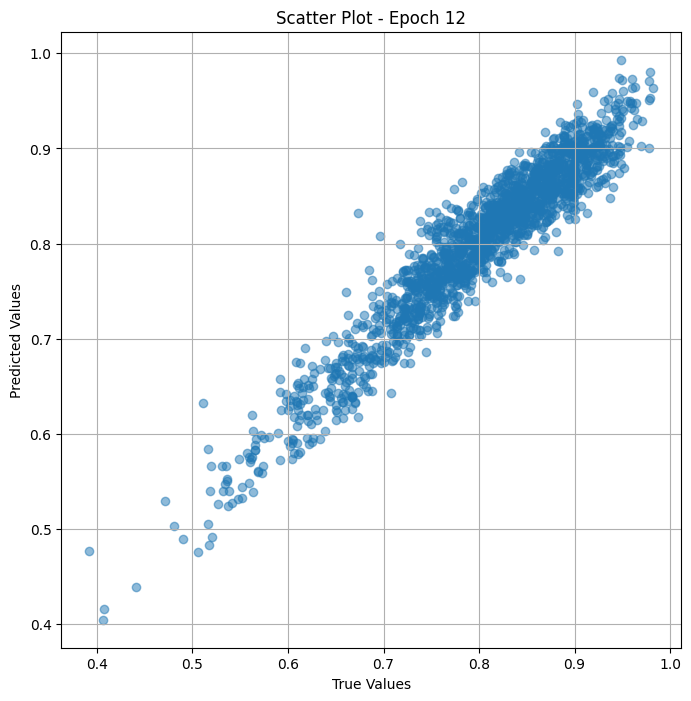

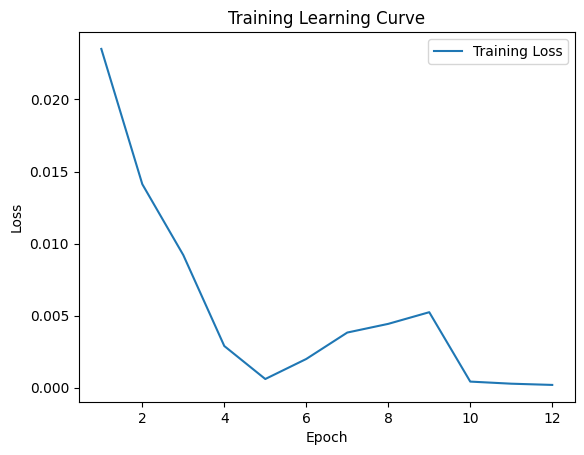


 Epoch: (13/30) Loss = 0.00014777437900193036

 Epoch: (13/30) Loss_rmse = 0.012156248092651367

 Epoch: (13/30) R^2 = 0.9938085079193115

 Epoch: (13/30) MAE = 0.008817158639431
Spearman correlation coefficient: SignificanceResult(statistic=0.9496941634876016, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.9

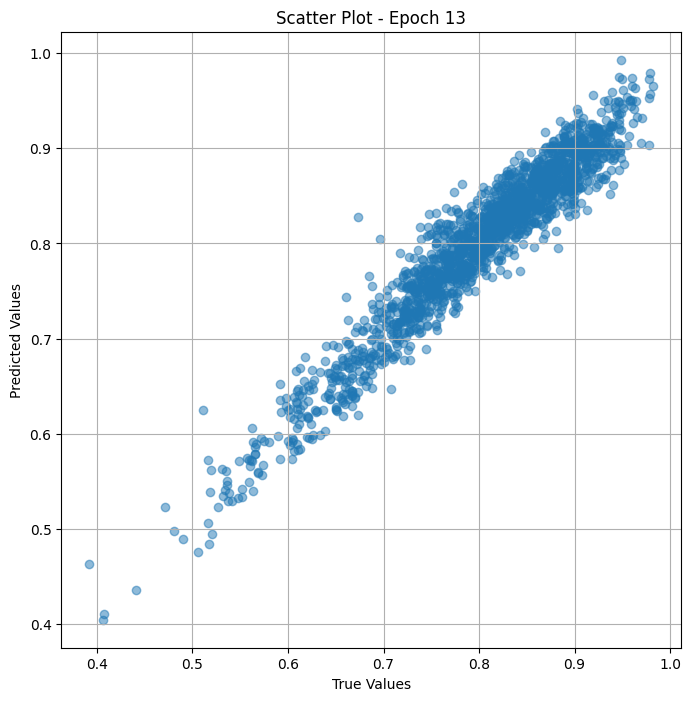

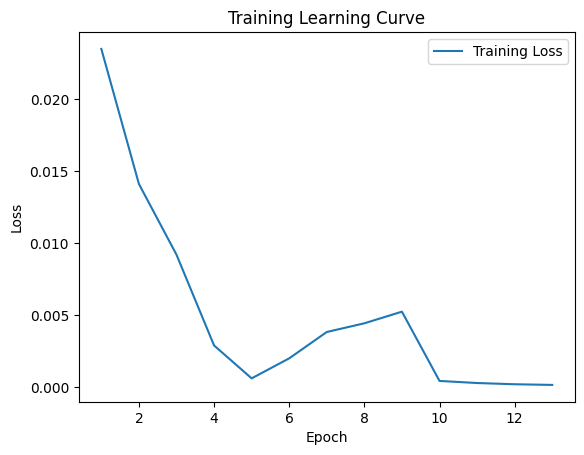


 Epoch: (14/30) Loss = 0.00011904728307854384

 Epoch: (14/30) Loss_rmse = 0.010910878889262676

 Epoch: (14/30) R^2 = 0.995012104511261

 Epoch: (14/30) MAE = 0.007636357098817825
Spearman correlation coefficient: SignificanceResult(statistic=0.956150433306441, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.

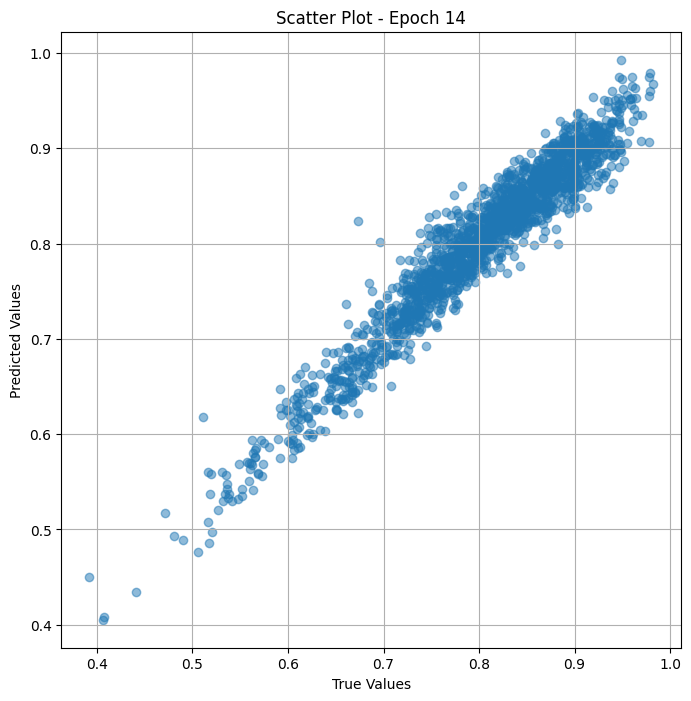

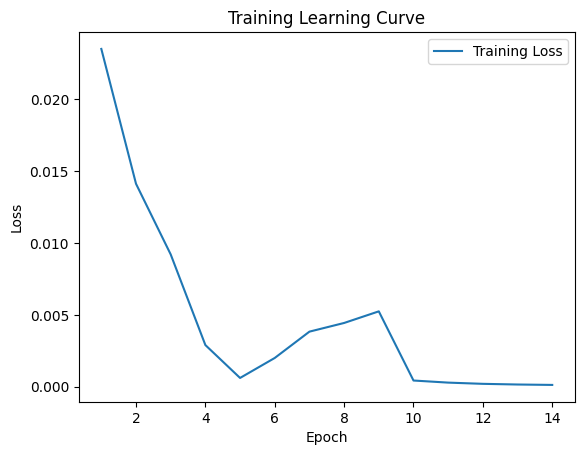


 Epoch: (15/30) Loss = 9.26650536712259e-05

 Epoch: (15/30) Loss_rmse = 0.009626269340515137

 Epoch: (15/30) R^2 = 0.9961174726486206

 Epoch: (15/30) MAE = 0.006674997508525848
Spearman correlation coefficient: SignificanceResult(statistic=0.9618381288019278, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.

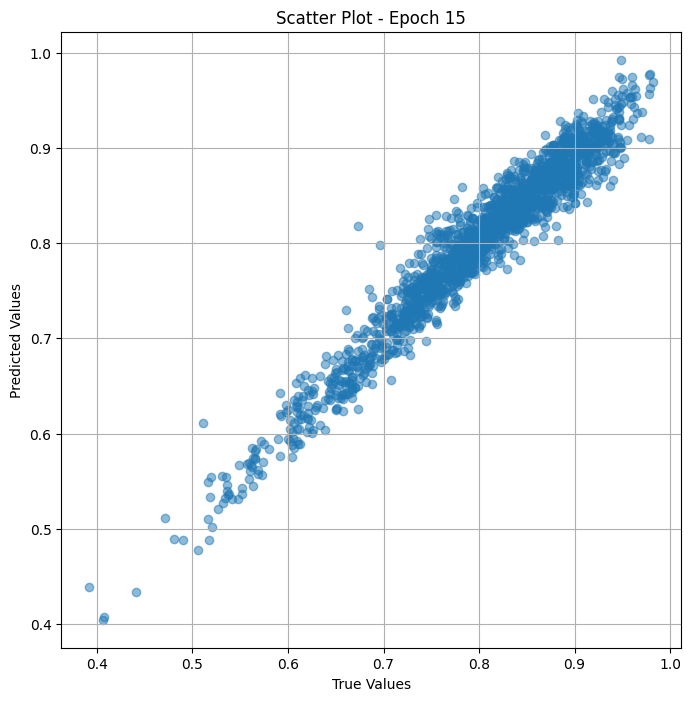

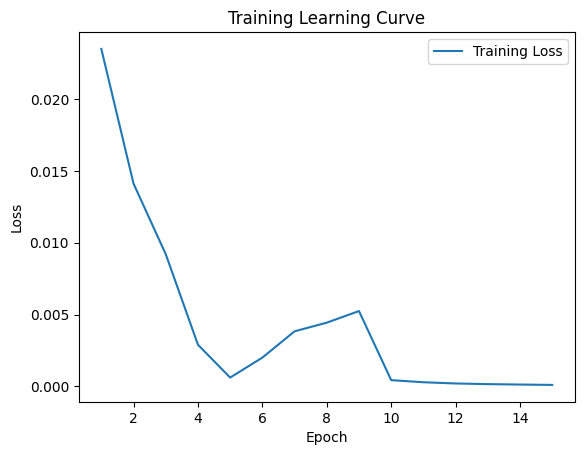


 Epoch: (16/30) Loss = 7.533255848102272e-05

 Epoch: (16/30) Loss_rmse = 0.008679432794451714

 Epoch: (16/30) R^2 = 0.996843695640564

 Epoch: (16/30) MAE = 0.005963049829006195
Spearman correlation coefficient: SignificanceResult(statistic=0.9669009703569988, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.

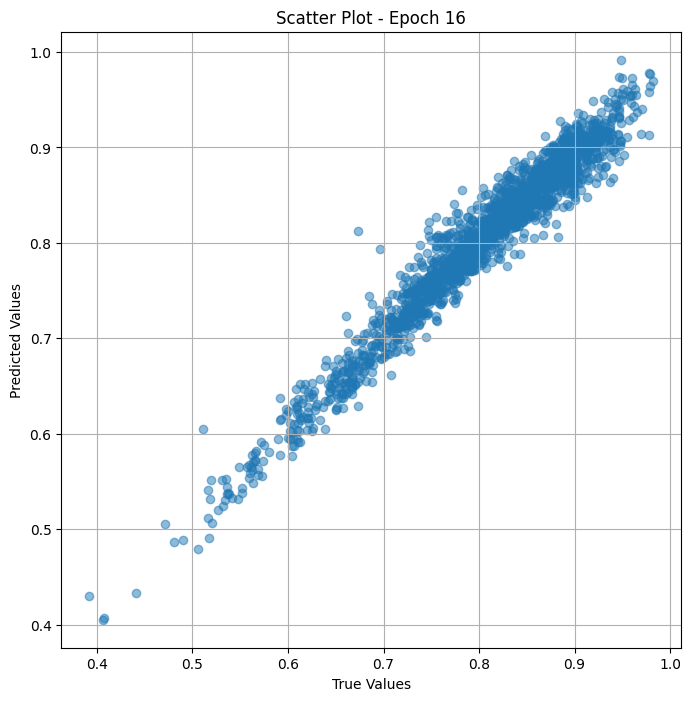

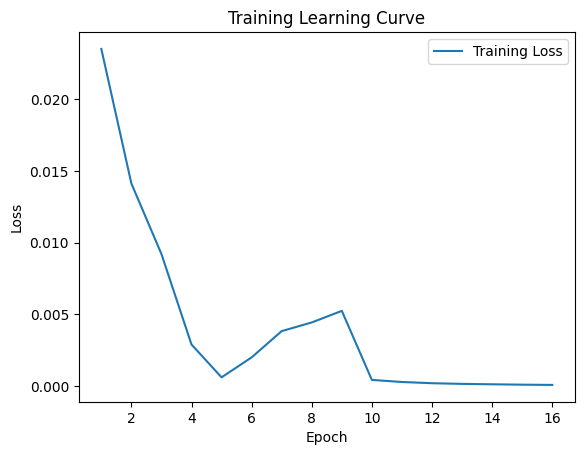


 Epoch: (17/30) Loss = 5.972105645923875e-05

 Epoch: (17/30) Loss_rmse = 0.0077279401011765

 Epoch: (17/30) R^2 = 0.9974977970123291

 Epoch: (17/30) MAE = 0.00518186017870903
Spearman correlation coefficient: SignificanceResult(statistic=0.9715012220045603, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0.90

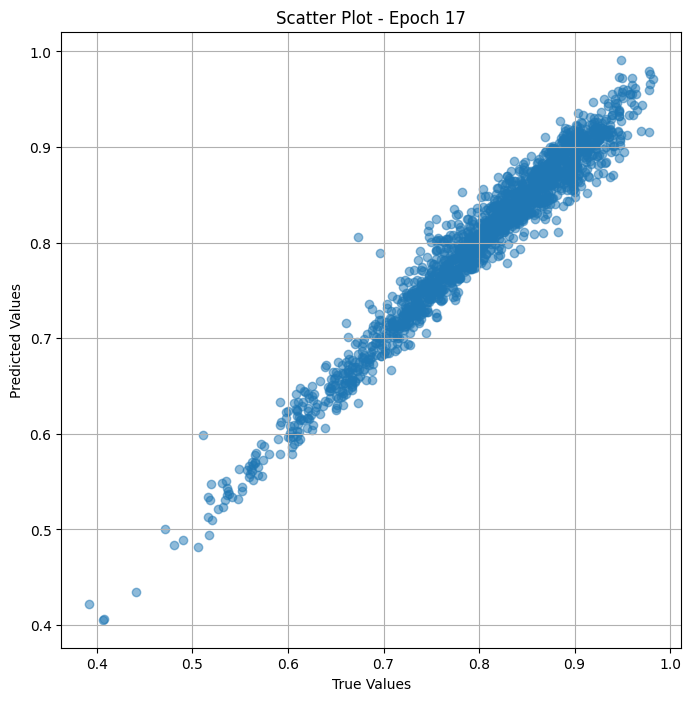

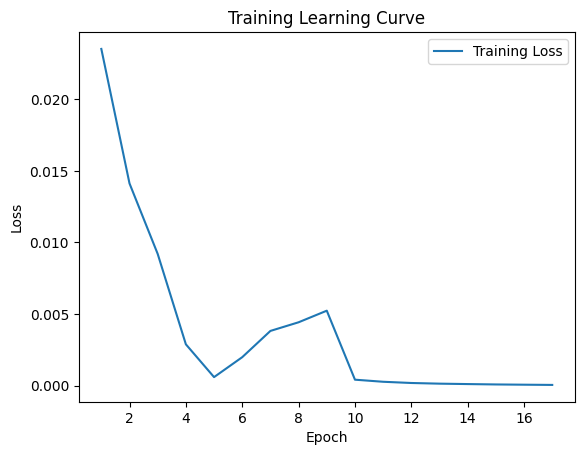


 Epoch: (18/30) Loss = 4.564020491670817e-05

 Epoch: (18/30) Loss_rmse = 0.006755753420293331

 Epoch: (18/30) R^2 = 0.9980877637863159

 Epoch: (18/30) MAE = 0.004434097558259964
Spearman correlation coefficient: SignificanceResult(statistic=0.9755890909303975, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

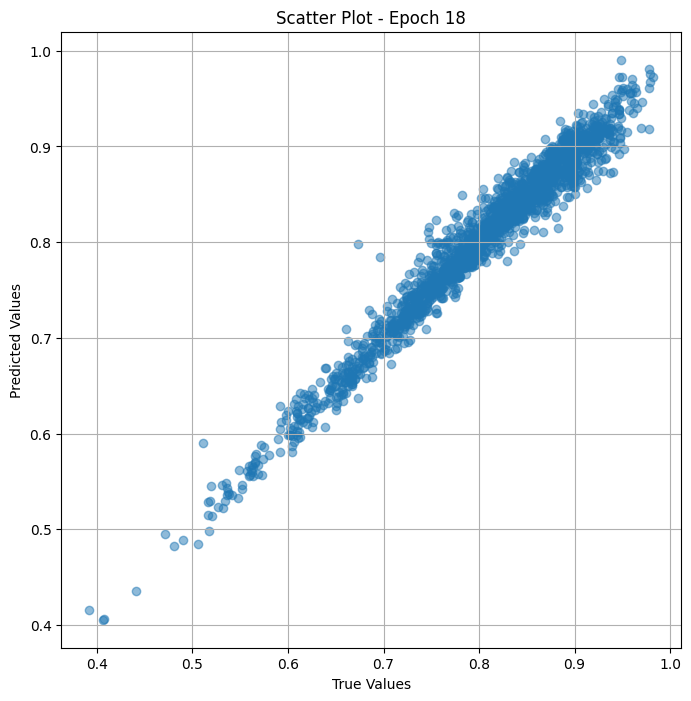

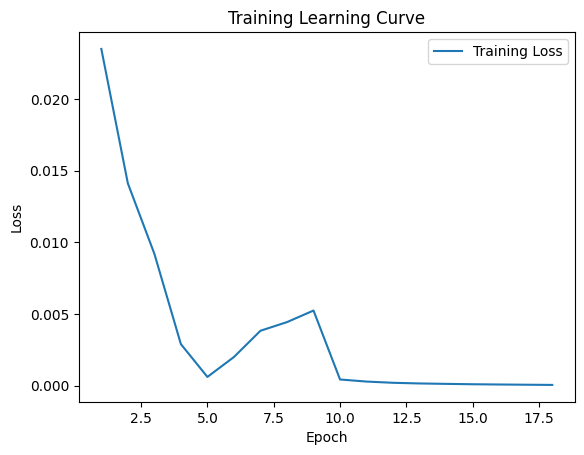


 Epoch: (19/30) Loss = 3.4997799957636744e-05

 Epoch: (19/30) Loss_rmse = 0.005915893707424402

 Epoch: (19/30) R^2 = 0.9985336661338806

 Epoch: (19/30) MAE = 0.0037967637181282043
Spearman correlation coefficient: SignificanceResult(statistic=0.9793171366426738, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

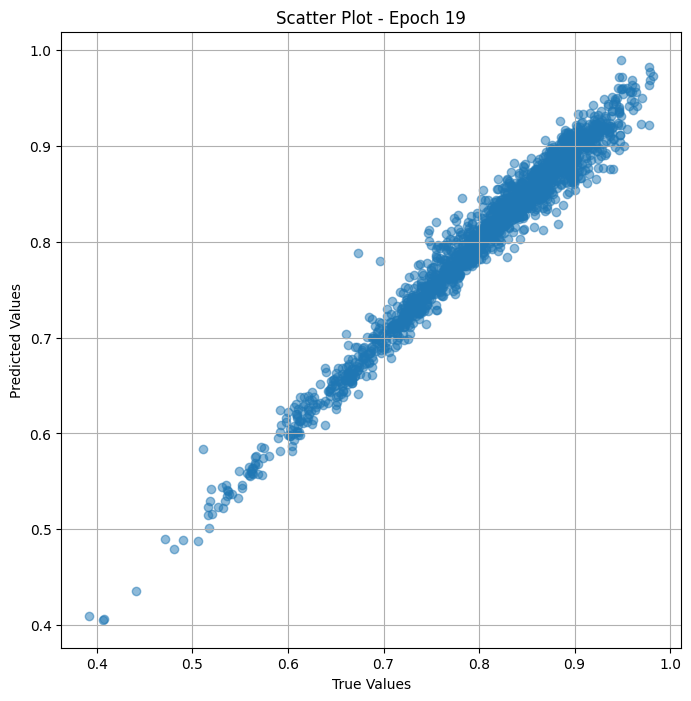

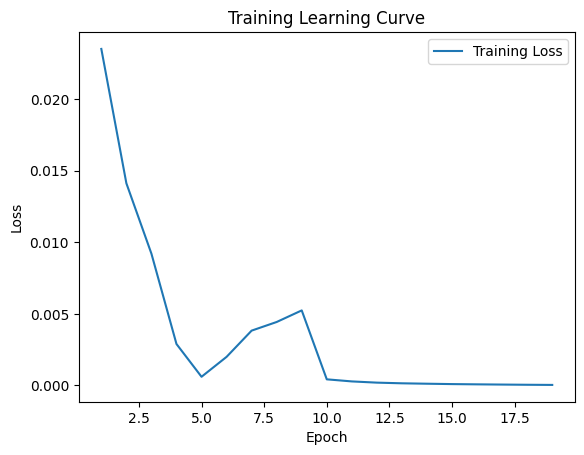


 Epoch: (20/30) Loss = 2.6781330234371126e-05

 Epoch: (20/30) Loss_rmse = 0.0051750680431723595

 Epoch: (20/30) R^2 = 0.9988778829574585

 Epoch: (20/30) MAE = 0.003466591238975525
Spearman correlation coefficient: SignificanceResult(statistic=0.9825818292168123, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

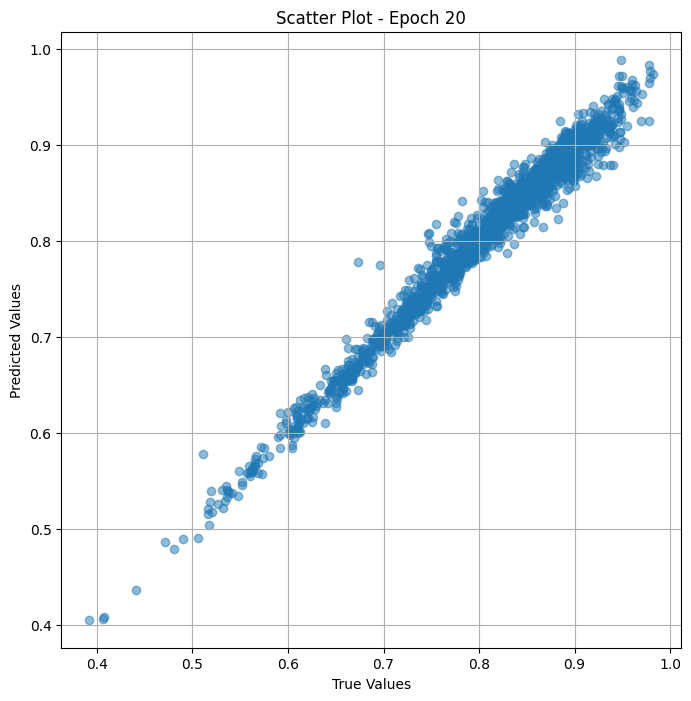

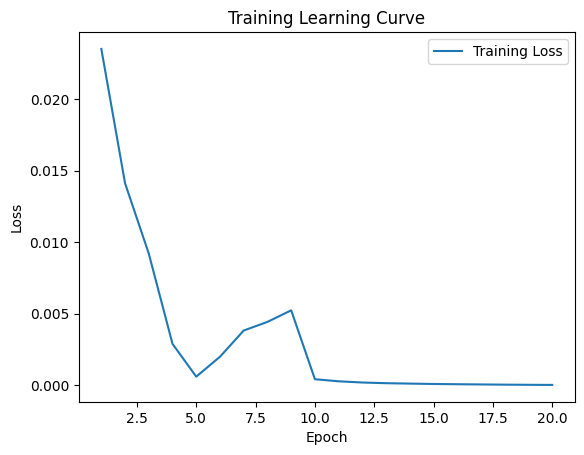


 Epoch: (21/30) Loss = 1.8965030903927982e-05

 Epoch: (21/30) Loss_rmse = 0.004354885779321194

 Epoch: (21/30) R^2 = 0.9992054104804993

 Epoch: (21/30) MAE = 0.0028198808431625366
Spearman correlation coefficient: SignificanceResult(statistic=0.9854554852669253, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391,

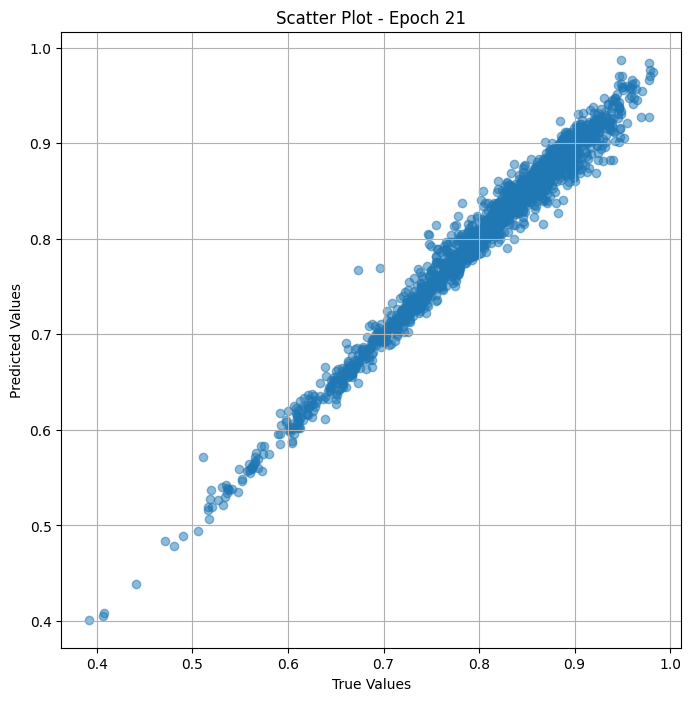

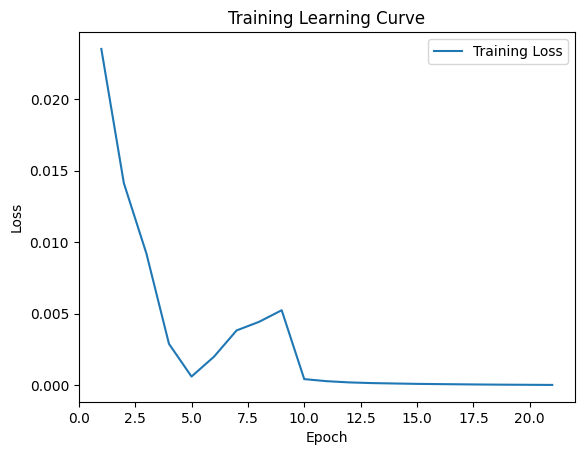


 Epoch: (22/30) Loss = 1.3525489521271084e-05

 Epoch: (22/30) Loss_rmse = 0.0036777015775442123

 Epoch: (22/30) R^2 = 0.9994332790374756

 Epoch: (22/30) MAE = 0.0024922825396060944
Spearman correlation coefficient: SignificanceResult(statistic=0.9879459392987888, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391

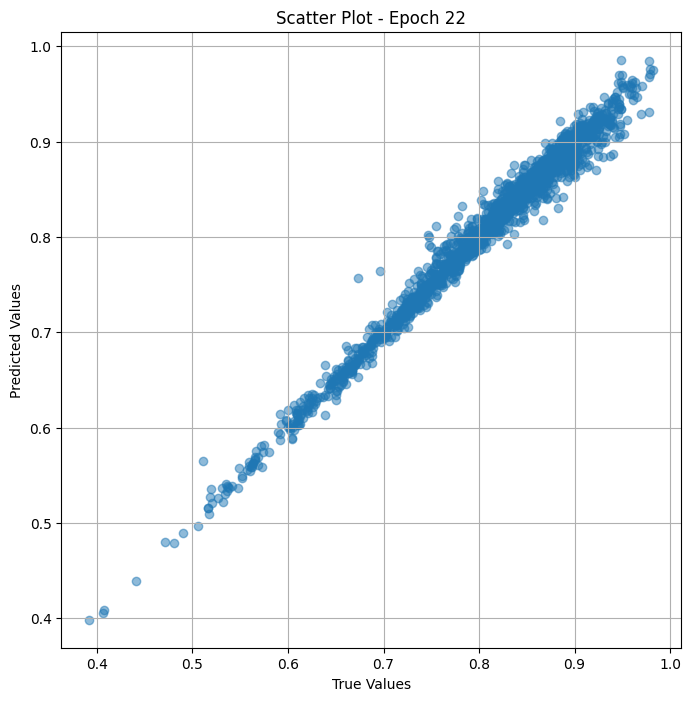

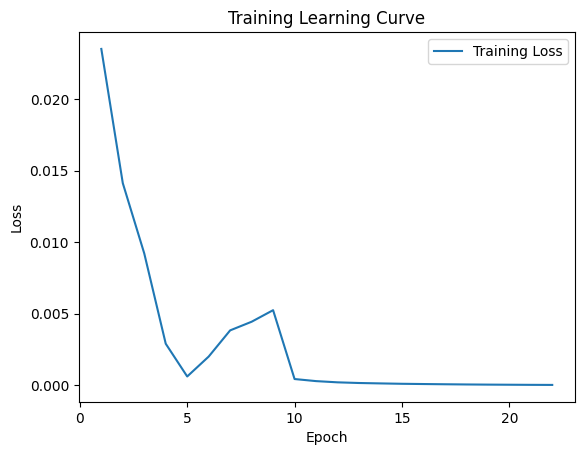


 Epoch: (23/30) Loss = 1.0185271094087511e-05

 Epoch: (23/30) Loss_rmse = 0.003191437106579542

 Epoch: (23/30) R^2 = 0.9995732307434082

 Epoch: (23/30) MAE = 0.002255316823720932
Spearman correlation coefficient: SignificanceResult(statistic=0.9900966202643905, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 

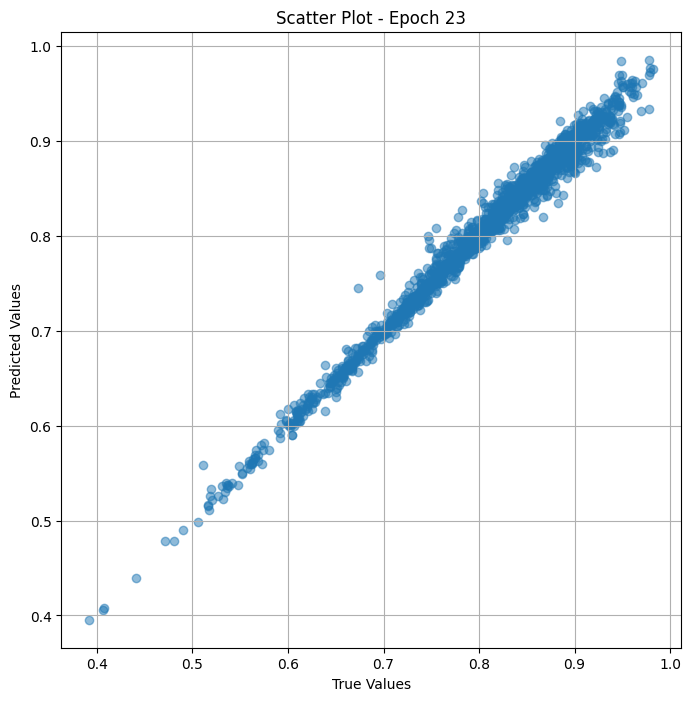

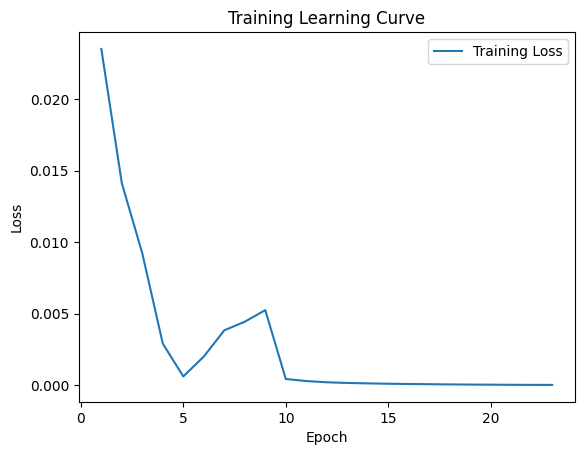


 Epoch: (24/30) Loss = 9.68212953011971e-06

 Epoch: (24/30) Loss_rmse = 0.0031116120517253876

 Epoch: (24/30) R^2 = 0.9995943307876587

 Epoch: (24/30) MAE = 0.002288609743118286
Spearman correlation coefficient: SignificanceResult(statistic=0.9919401808532389, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

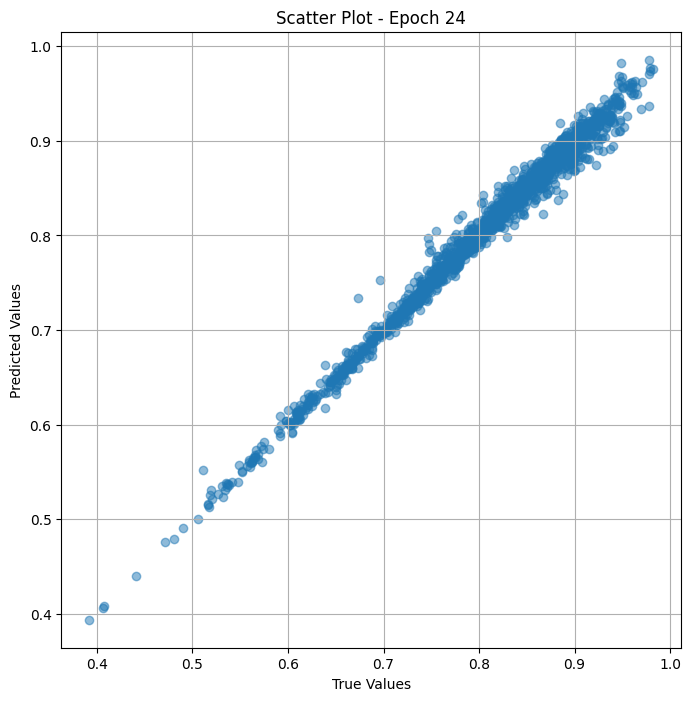

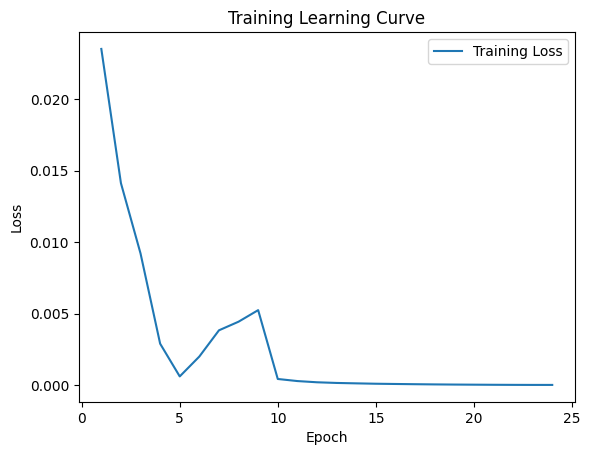


 Epoch: (25/30) Loss = 1.803641498554498e-05

 Epoch: (25/30) Loss_rmse = 0.004246930126100779

 Epoch: (25/30) R^2 = 0.9992443323135376

 Epoch: (25/30) MAE = 0.002734266221523285
Spearman correlation coefficient: SignificanceResult(statistic=0.9934381983666121, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

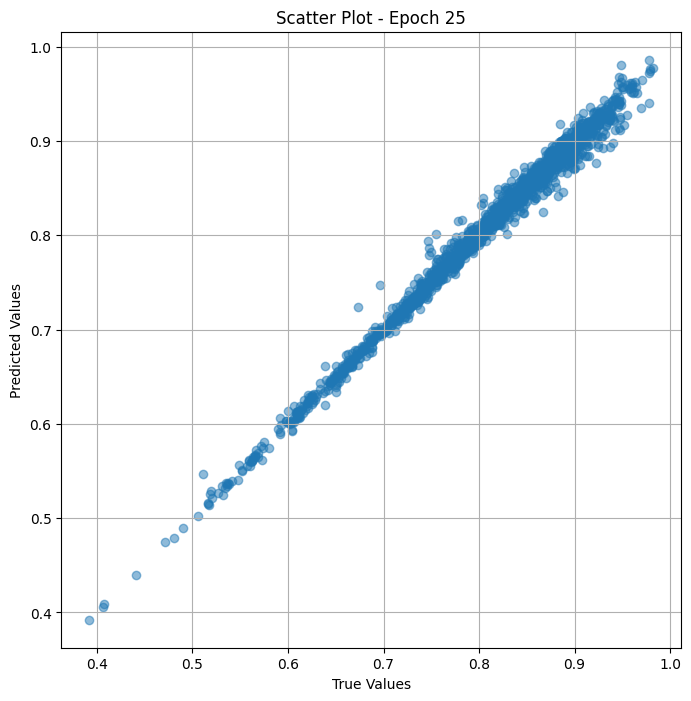

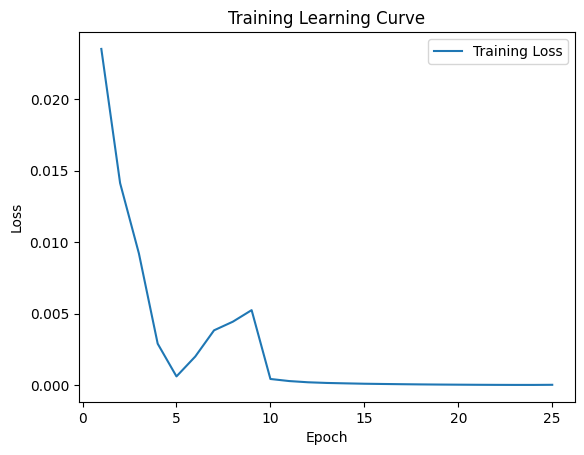


 Epoch: (26/30) Loss = 6.088586087571457e-05

 Epoch: (26/30) Loss_rmse = 0.0078029390424489975

 Epoch: (26/30) R^2 = 0.9974489808082581

 Epoch: (26/30) MAE = 0.003786396235227585
Spearman correlation coefficient: SignificanceResult(statistic=0.9947328047623117, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 

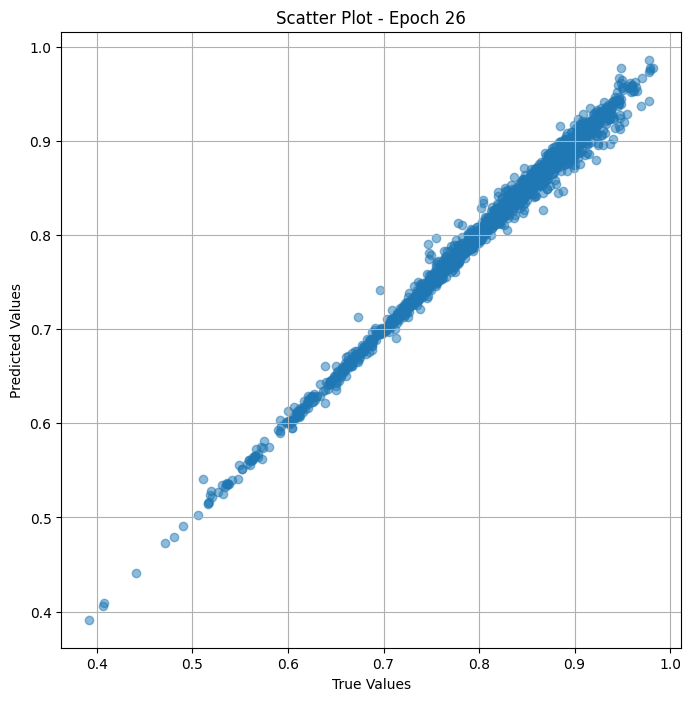

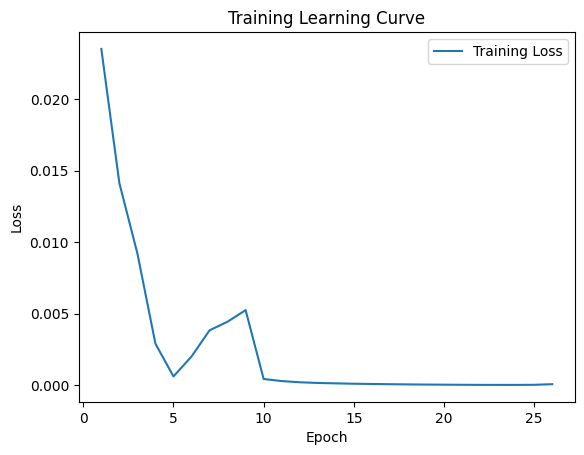

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (27/30) Loss = 0.00019785913173109293

 Epoch: (27/30) Loss_rmse = 0.0140662407502532

 Epoch: (27/30) R^2 = 0.9917100071907043

 Epoch: (27/30) MAE = 0.005851231515407562
Spearman correlation coefficient: SignificanceResult(statistic=0.9957155837316235, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.841121

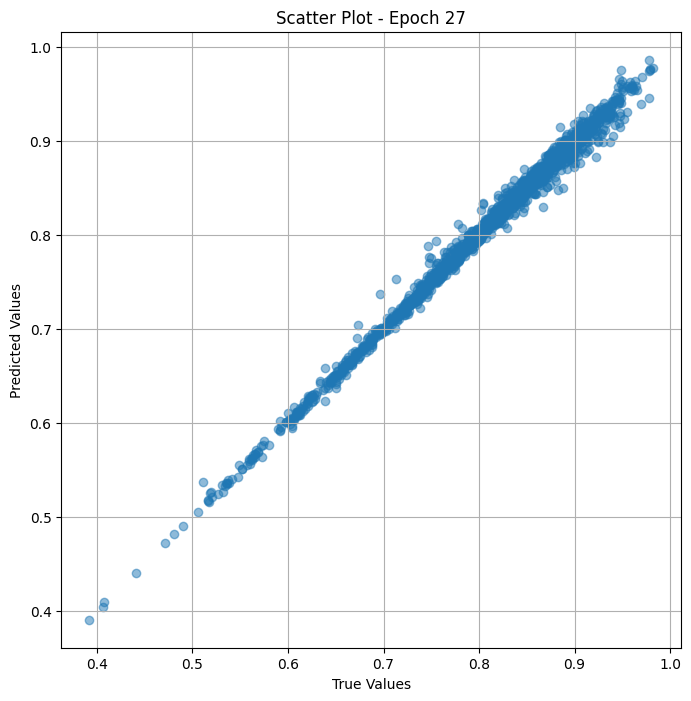

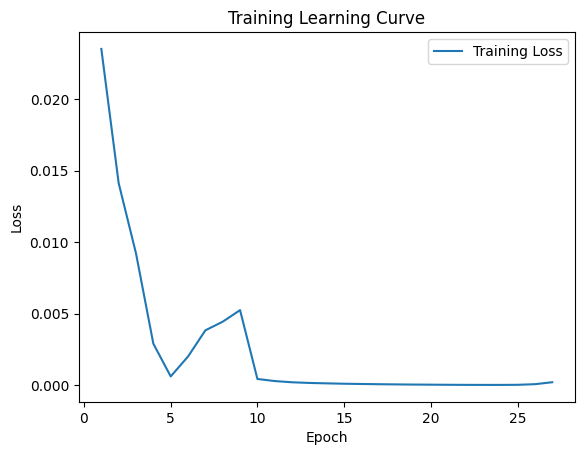


 Epoch: (28/30) Loss = 7.186590664787218e-05

 Epoch: (28/30) Loss_rmse = 0.008477375842630863

 Epoch: (28/30) R^2 = 0.9969889521598816

 Epoch: (28/30) MAE = 0.004346214234828949
Spearman correlation coefficient: SignificanceResult(statistic=0.9954220683675138, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

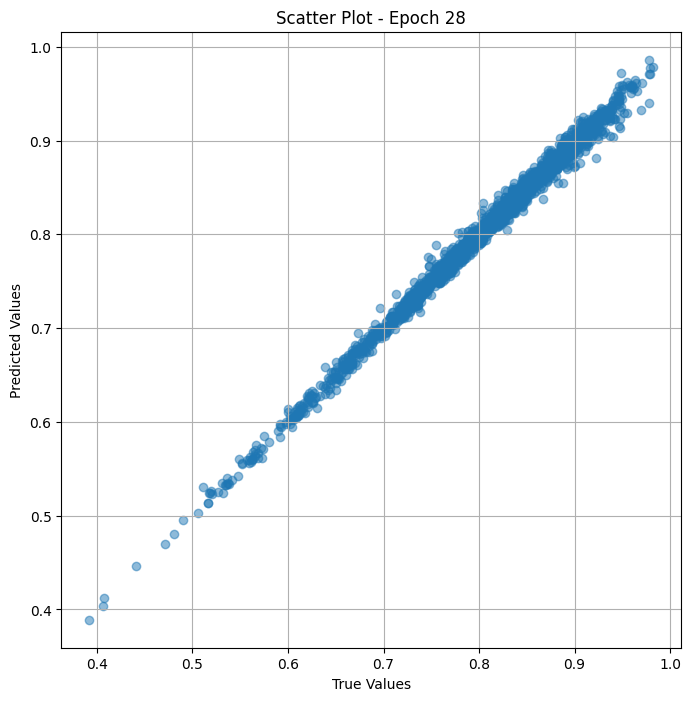

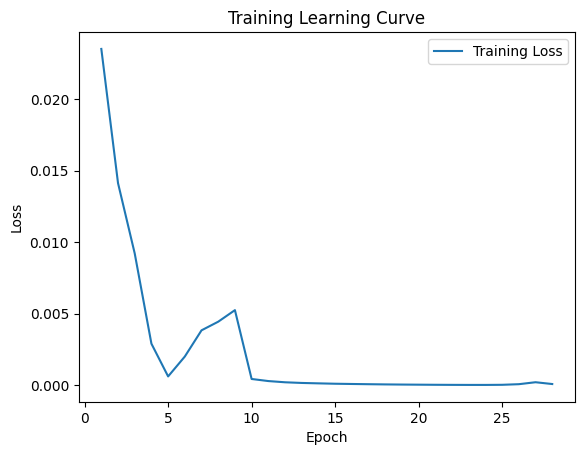


 Epoch: (29/30) Loss = 4.278182314010337e-05

 Epoch: (29/30) Loss_rmse = 0.006540781352669001

 Epoch: (29/30) R^2 = 0.9982075095176697

 Epoch: (29/30) MAE = 0.003758888691663742
Spearman correlation coefficient: SignificanceResult(statistic=0.9952634458495712, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.8411215, 0.9082569, 0.75555557, 0.5686275, 0.7613636, 0.7217391, 0

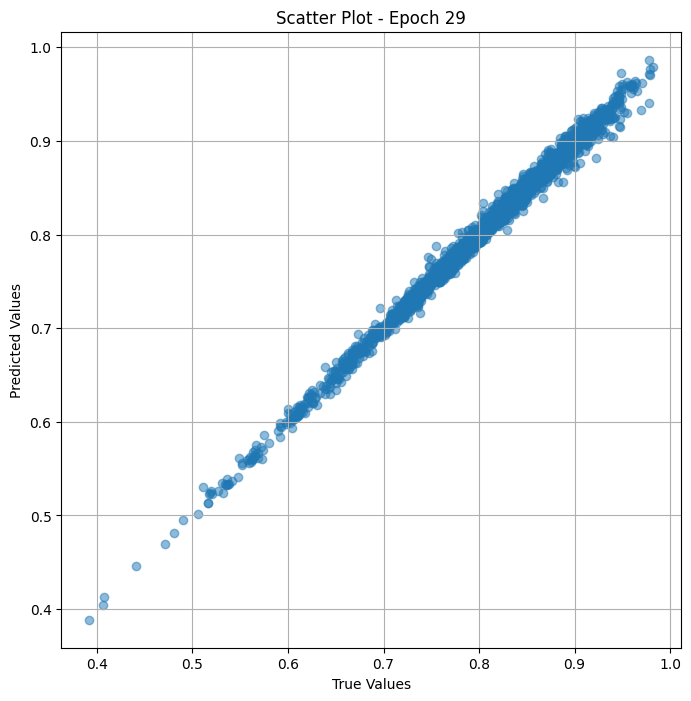

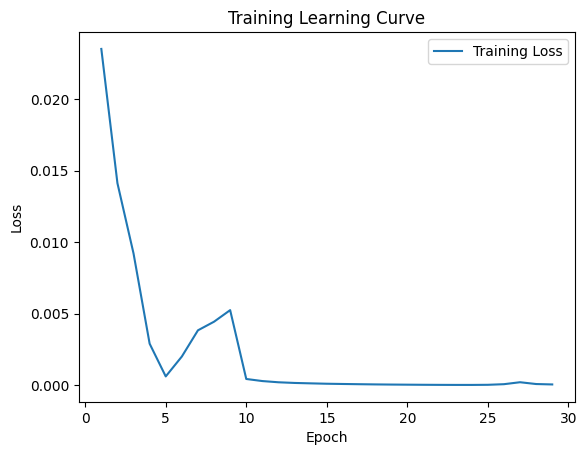

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (30/30) Loss = 2.5545972675899975e-05

 Epoch: (30/30) Loss_rmse = 0.005054302513599396

 Epoch: (30/30) R^2 = 0.9989296793937683

 Epoch: (30/30) MAE = 0.0030667930841445923
Spearman correlation coefficient: SignificanceResult(statistic=0.9954830420169252, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9369369, 0.6105263, 0.8736842, 0.7297297, 0.7592593, 0.9139785, 0.77011496, 0.8202247, 0.875, 0.8333333, 0.8214286, 0.8333333, 0.9285714, 0.6388889, 0.81609195, 0.6979167, 0.9047619, 0.7777778, 0.7606838, 0.8811881, 0.7181818, 0.8557692, 0.8113208, 0.8235294, 0.7446808, 0.75268817, 0.65625, 0.89, 0.86, 0.98214287, 0.91071427, 0.872549, 0.712963, 0.7529412, 0.8765432, 0.53535354, 0.75213677, 0.61702126, 0.8902439, 0.89320385, 0.6952381, 0.90625, 0.7291667, 0.9174312, 0.8272727, 0.8192771, 0.88073397, 0.8877551, 0.8137255, 0.67346936, 0.8737864, 0.72043014, 0.841

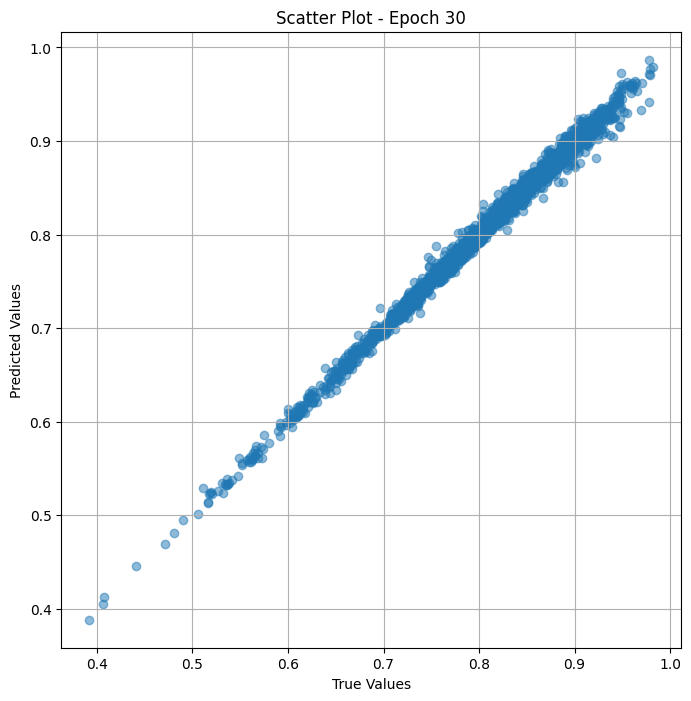

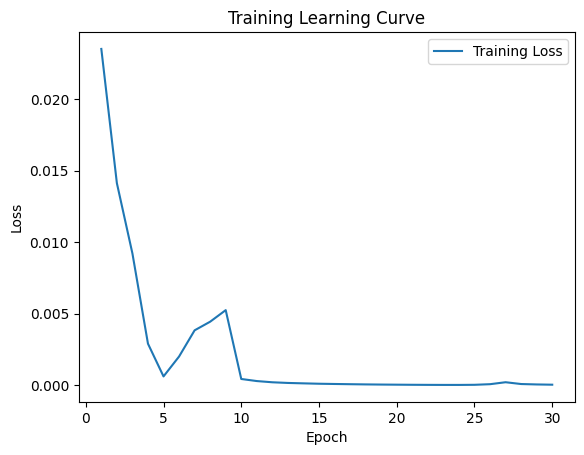

In [ ]:
# Training the model and save weights
fit(30,model_vit_fine , train_dl)
torch.save(model_vit_fine.state_dict(), "model_weights_fine")

## valid

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-4,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 6.562616908922791e-05

 Epoch: (1/30) Loss_rmse = 0.008100997656583786

 Epoch: (1/30) R^2 = 0.9864370822906494

 Epoch: (1/30) MAE = 0.007745295763015747
Spearman correlation coefficient: SignificanceResult(statistic=0.9949096389154886, pvalue=1.698112918181158e-95)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 

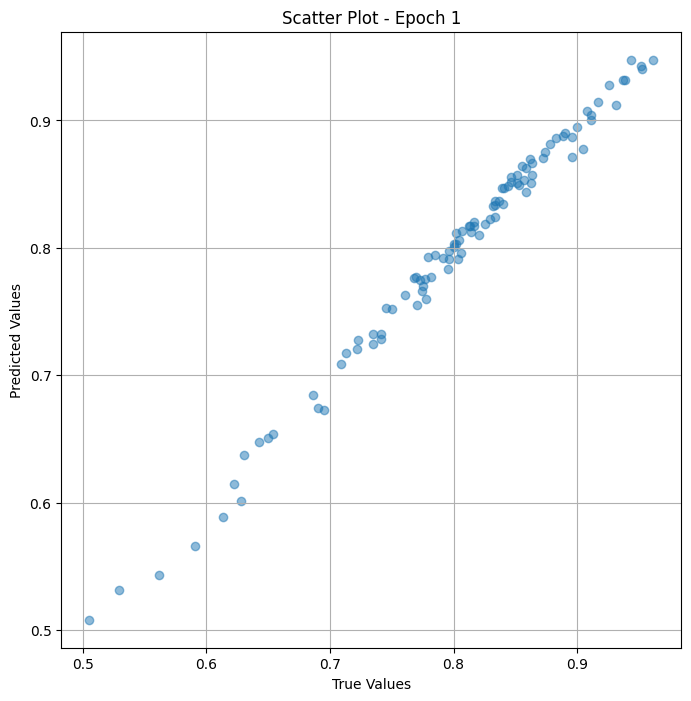

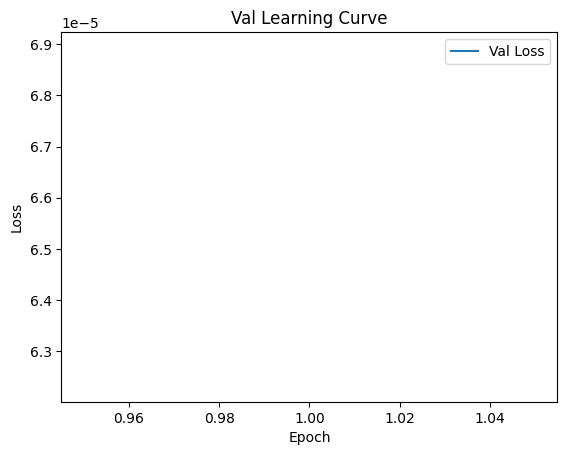


 Epoch: (2/30) Loss = 0.0002687838568817824

 Epoch: (2/30) Loss_rmse = 0.01639462821185589

 Epoch: (2/30) R^2 = 0.9444507360458374

 Epoch: (2/30) MAE = 0.016099929809570312
Spearman correlation coefficient: SignificanceResult(statistic=0.9868586606873626, pvalue=3.234113740695227e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 0

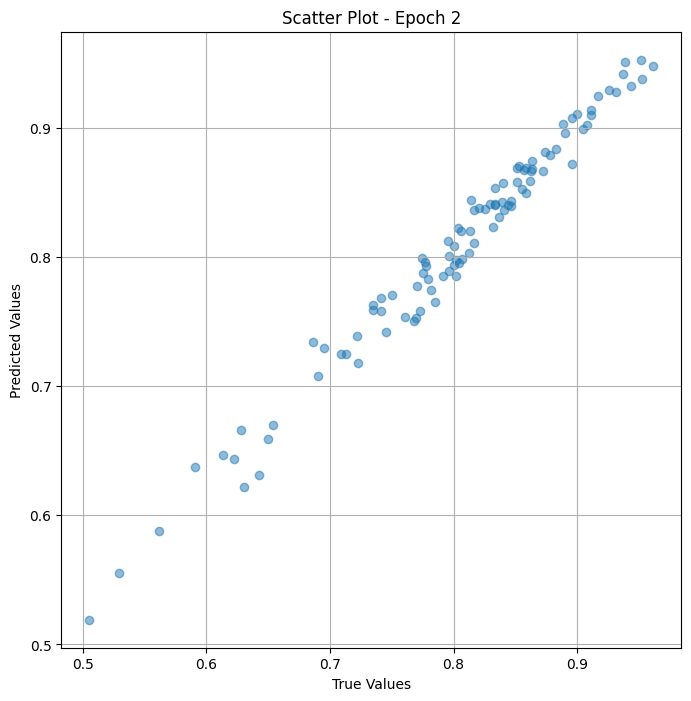

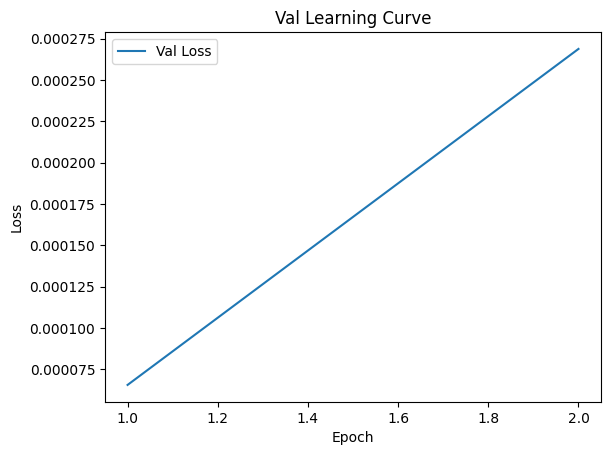


 Epoch: (3/30) Loss = 6.409504294424551e-06

 Epoch: (3/30) Loss_rmse = 0.00253169983625412

 Epoch: (3/30) R^2 = 0.9986753463745117

 Epoch: (3/30) MAE = 0.002050936222076416
Spearman correlation coefficient: SignificanceResult(statistic=0.9928477203128346, pvalue=1.4172531693553752e-88)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725, 

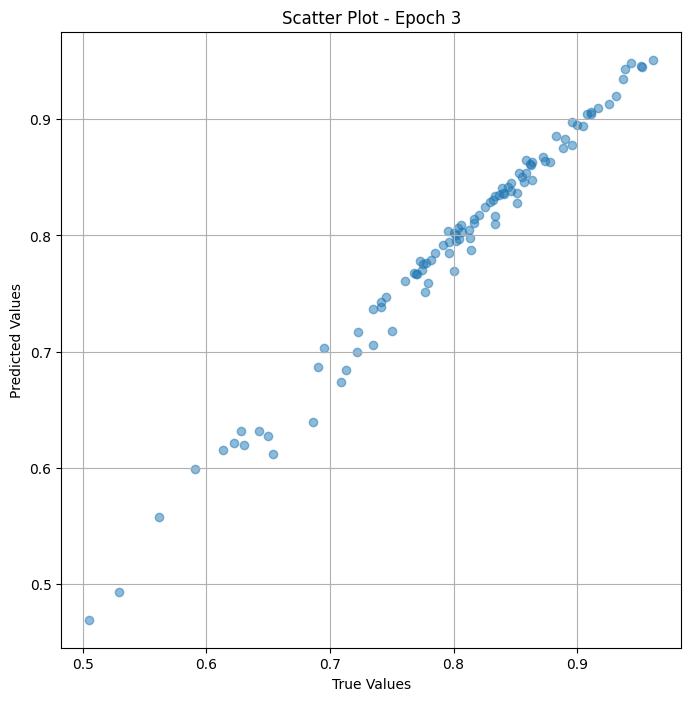

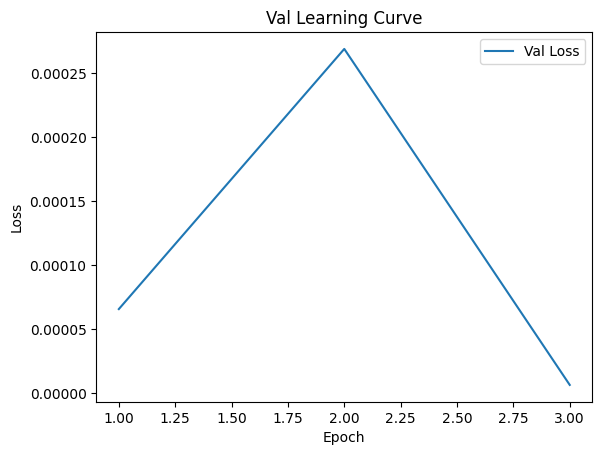


 Epoch: (4/30) Loss = 6.0049991589039564e-05

 Epoch: (4/30) Loss_rmse = 0.0077491928823292255

 Epoch: (4/30) R^2 = 0.9875895380973816

 Epoch: (4/30) MAE = 0.0076415687799453735
Spearman correlation coefficient: SignificanceResult(statistic=0.9963136427008485, pvalue=4.535477111710653e-102)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829787

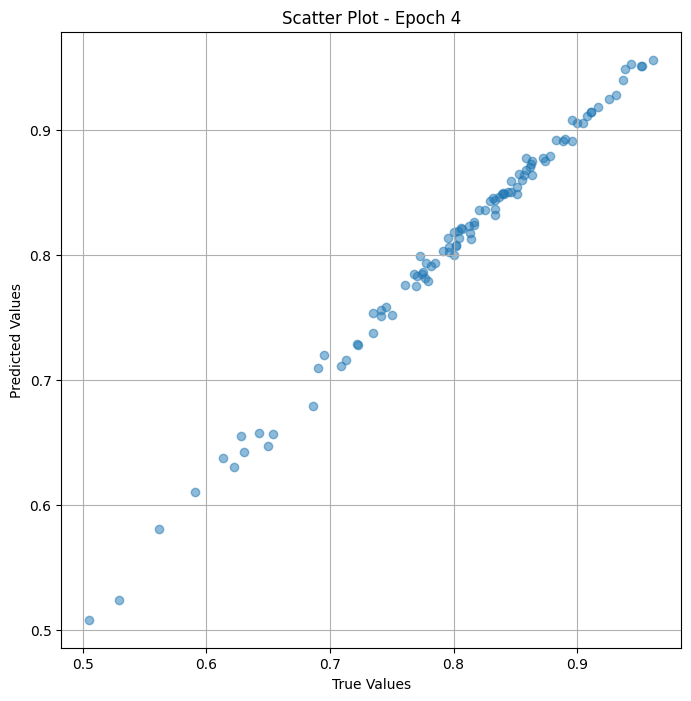

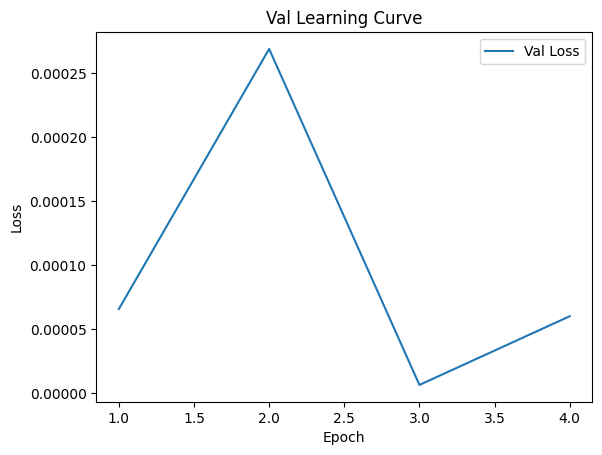


 Epoch: (5/30) Loss = 3.027736511285184e-06

 Epoch: (5/30) Loss_rmse = 0.0017400392098352313

 Epoch: (5/30) R^2 = 0.999374270439148

 Epoch: (5/30) MAE = 0.0016095787286758423
Spearman correlation coefficient: SignificanceResult(statistic=0.9982331261368719, pvalue=4.6132080972357814e-117)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297872

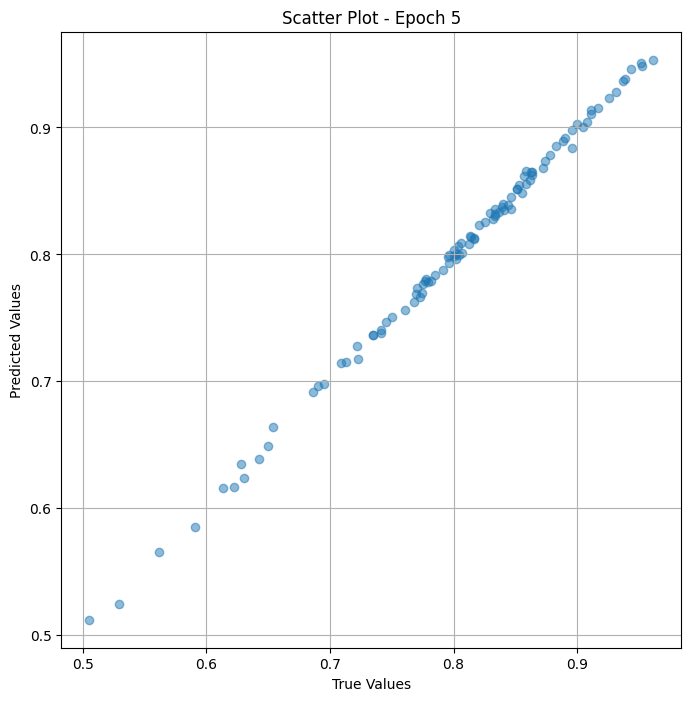

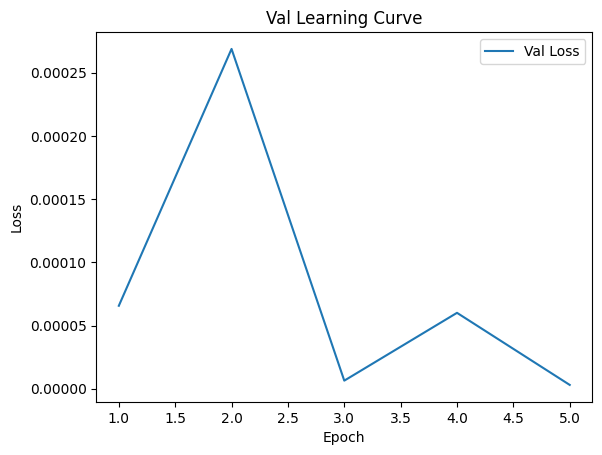


 Epoch: (6/30) Loss = 1.556480356157408e-06

 Epoch: (6/30) Loss_rmse = 0.0012475898256525397

 Epoch: (6/30) R^2 = 0.9996783137321472

 Epoch: (6/30) MAE = 0.0010796934366226196
Spearman correlation coefficient: SignificanceResult(statistic=0.9992166070493219, pvalue=1.1803514754956256e-133)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829787

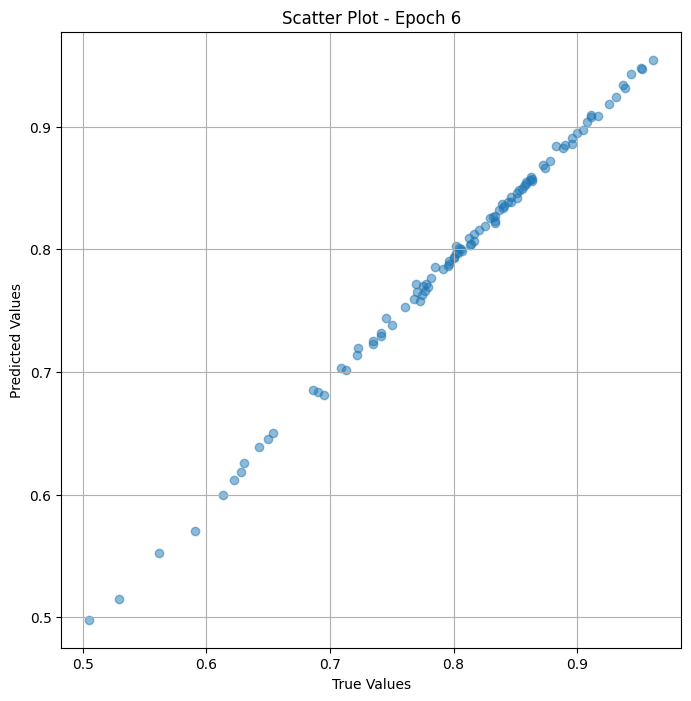

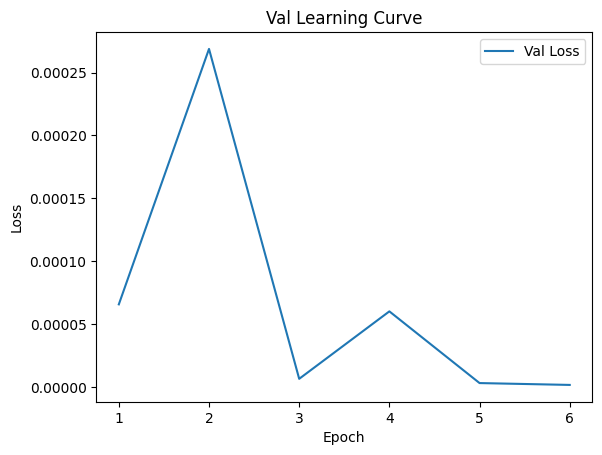


 Epoch: (7/30) Loss = 1.0645353540894575e-05

 Epoch: (7/30) Loss_rmse = 0.003262721700593829

 Epoch: (7/30) R^2 = 0.9977999329566956

 Epoch: (7/30) MAE = 0.003077104687690735
Spearman correlation coefficient: SignificanceResult(statistic=0.9992166070493219, pvalue=1.1803514754956256e-133)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297872

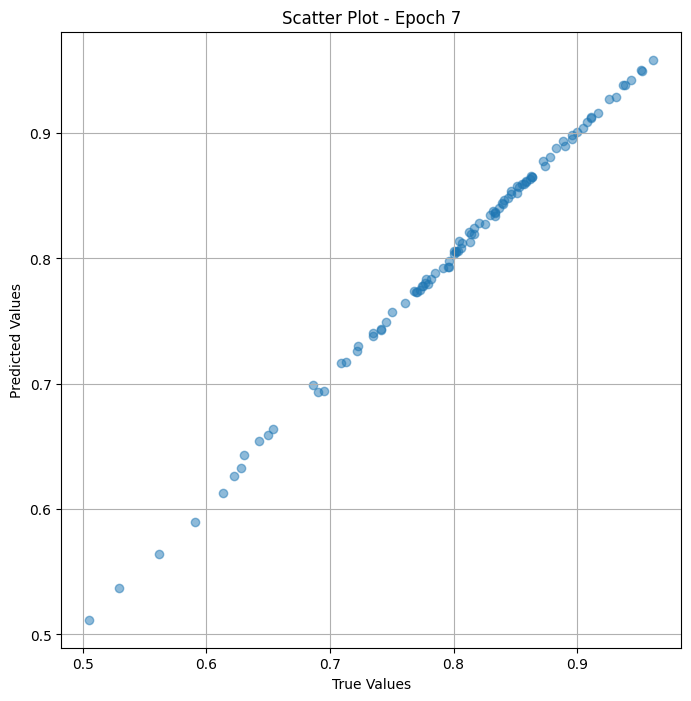

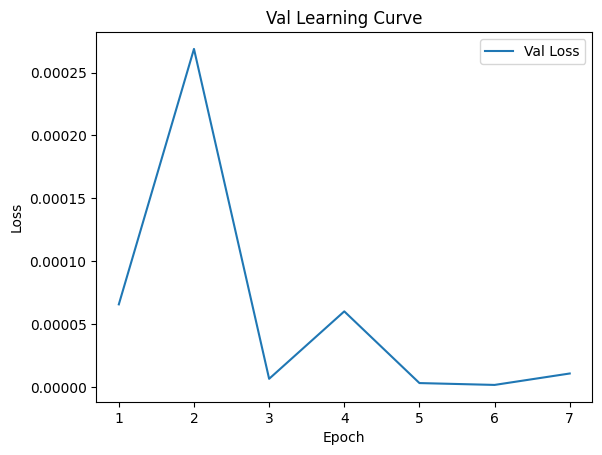


 Epoch: (8/30) Loss = 8.354232704732567e-06

 Epoch: (8/30) Loss_rmse = 0.0028903689235448837

 Epoch: (8/30) R^2 = 0.9982734322547913

 Epoch: (8/30) MAE = 0.00288604199886322
Spearman correlation coefficient: SignificanceResult(statistic=0.9988164320573595, pvalue=3.0983582594285986e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82978725

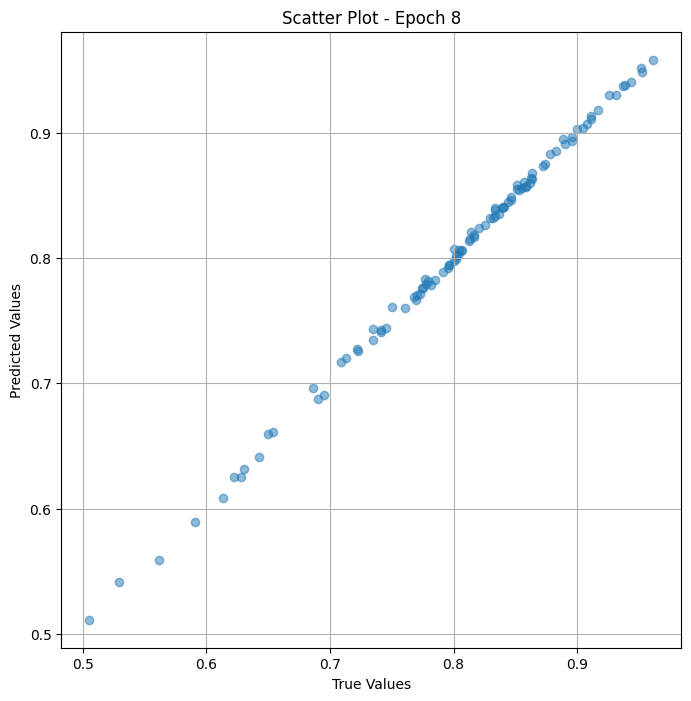

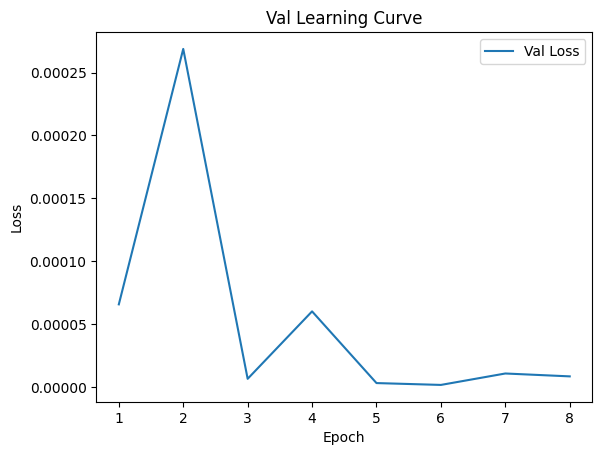

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (9/30) Loss = 1.8995186792380991e-06

 Epoch: (9/30) Loss_rmse = 0.0013782302848994732

 Epoch: (9/30) R^2 = 0.9996074438095093

 Epoch: (9/30) MAE = 0.0012265145778656006
Spearman correlation coefficient: SignificanceResult(statistic=0.9996778256841262, pvalue=8.704675640480572e-152)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.741

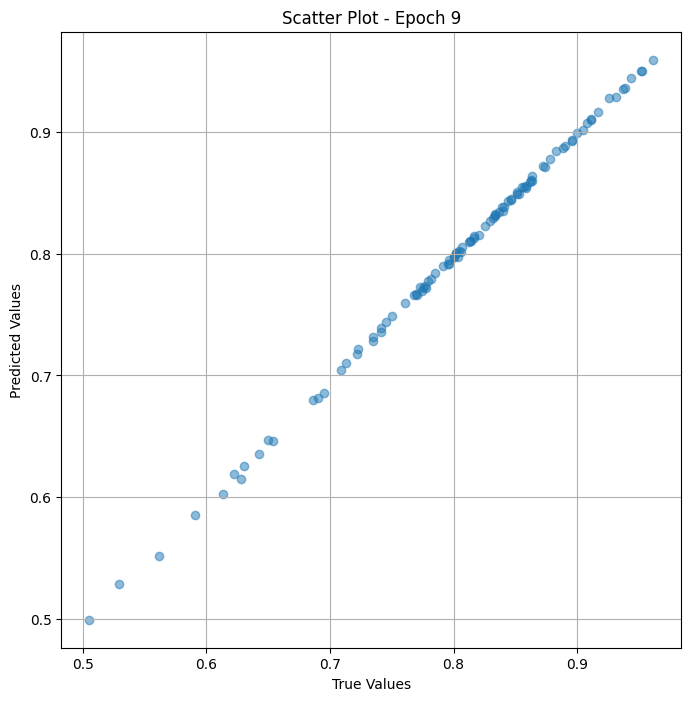

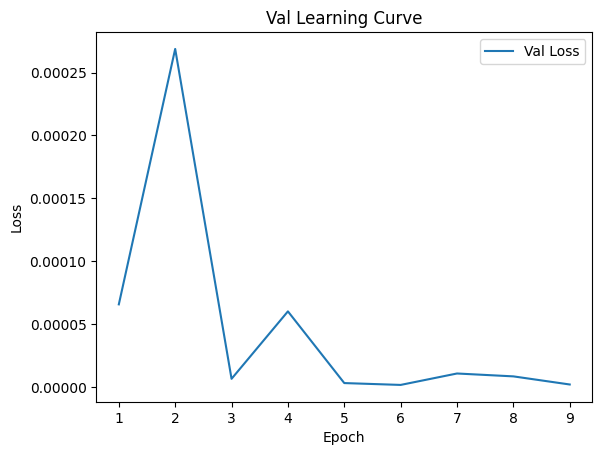


 Epoch: (10/30) Loss = 6.15931469383213e-07

 Epoch: (10/30) Loss_rmse = 0.0007848130189813673

 Epoch: (10/30) R^2 = 0.9998726844787598

 Epoch: (10/30) MAE = 0.0006432682275772095
Spearman correlation coefficient: SignificanceResult(statistic=0.9997253040730031, pvalue=4.852866765552048e-155)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297

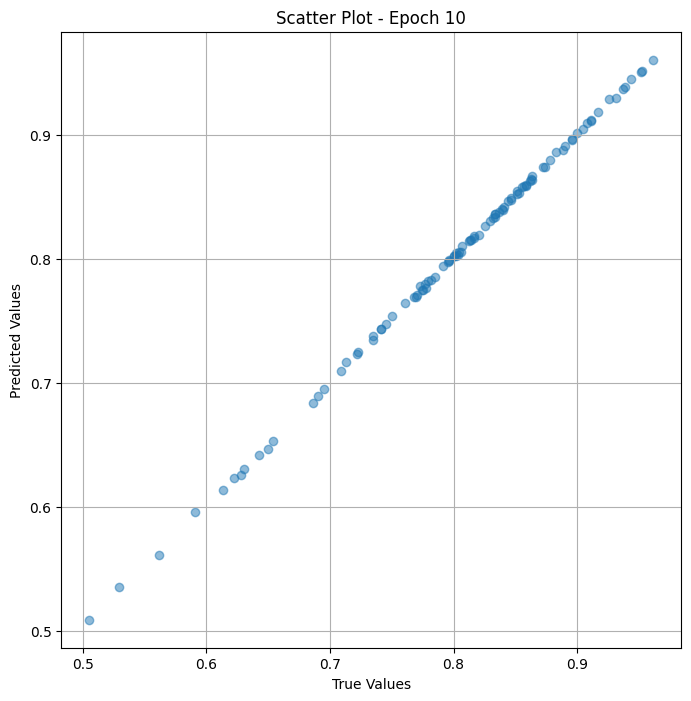

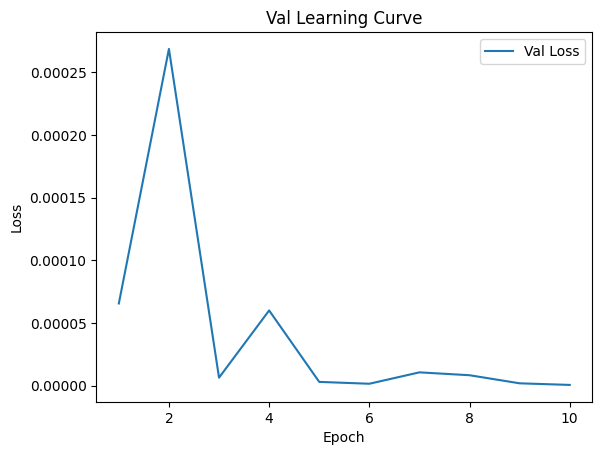


 Epoch: (11/30) Loss = 5.654454184877977e-07

 Epoch: (11/30) Loss_rmse = 0.0007519610226154327

 Epoch: (11/30) R^2 = 0.9998831152915955

 Epoch: (11/30) MAE = 0.0006062090396881104
Spearman correlation coefficient: SignificanceResult(statistic=0.9997388693269679, pvalue=4.491562633976503e-156)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

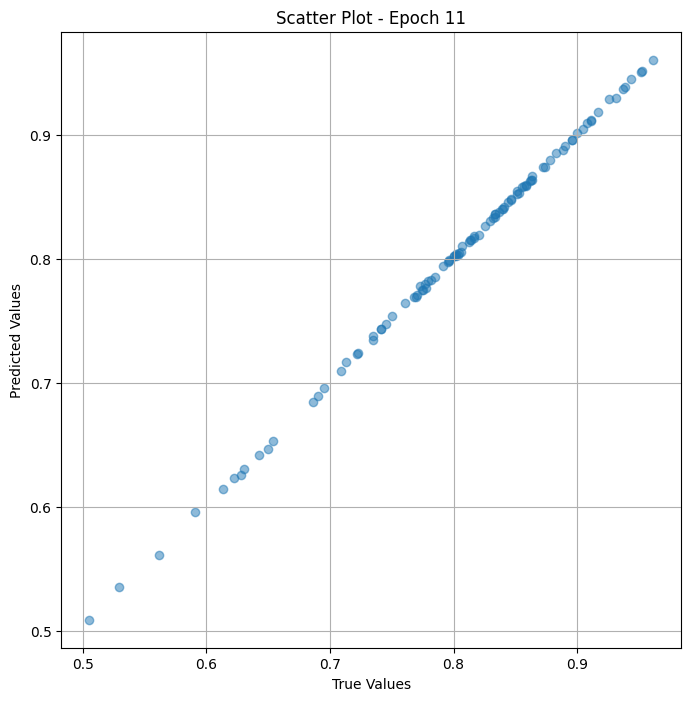

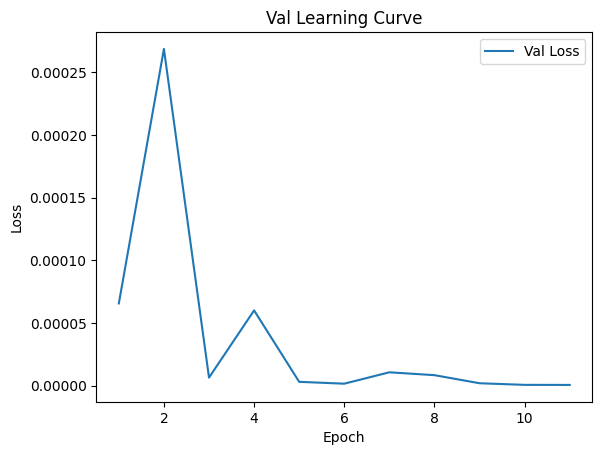


 Epoch: (12/30) Loss = 3.4291298334210296e-07

 Epoch: (12/30) Loss_rmse = 0.0005855877534486353

 Epoch: (12/30) R^2 = 0.9999291300773621

 Epoch: (12/30) MAE = 0.00043626129627227783
Spearman correlation coefficient: SignificanceResult(statistic=0.9997524345809327, pvalue=3.661326856503658e-157)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8

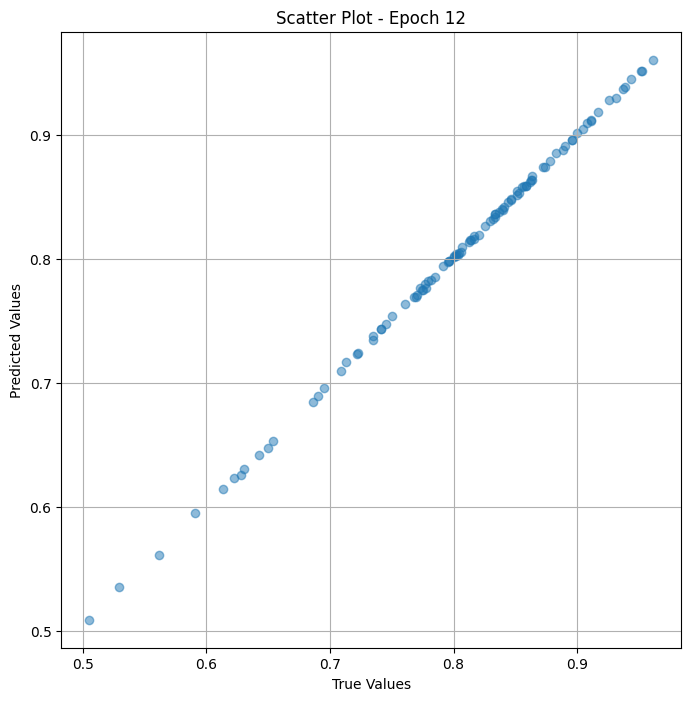

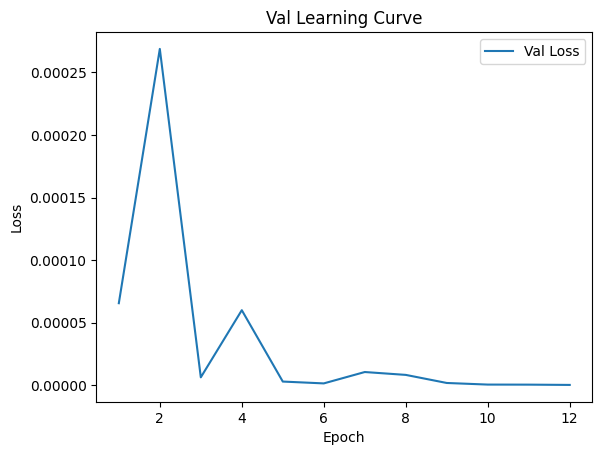


 Epoch: (13/30) Loss = 2.301462416198774e-07

 Epoch: (13/30) Loss_rmse = 0.0004797356086783111

 Epoch: (13/30) R^2 = 0.9999524354934692

 Epoch: (13/30) MAE = 0.00041396915912628174
Spearman correlation coefficient: SignificanceResult(statistic=0.9997931303428272, pvalue=7.913285622687827e-161)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82

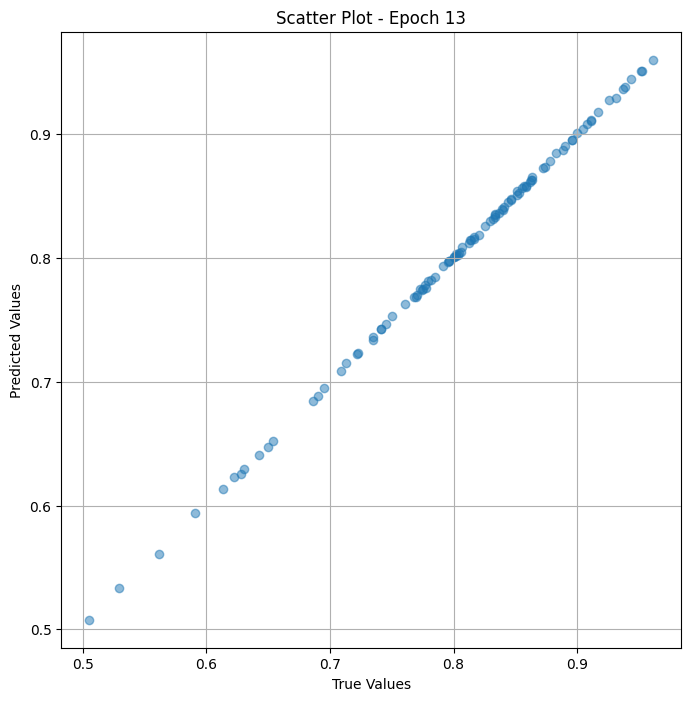

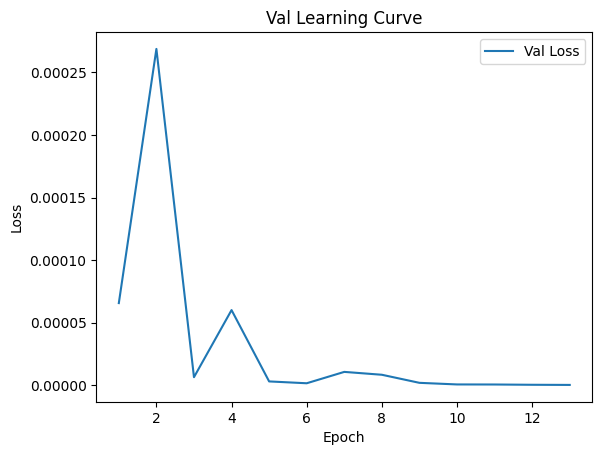


 Epoch: (14/30) Loss = 2.4389879627051414e-07

 Epoch: (14/30) Loss_rmse = 0.0004938610945828259

 Epoch: (14/30) R^2 = 0.99994957447052

 Epoch: (14/30) MAE = 0.00047454237937927246
Spearman correlation coefficient: SignificanceResult(statistic=0.9998473913586866, pvalue=4.890543850056177e-167)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

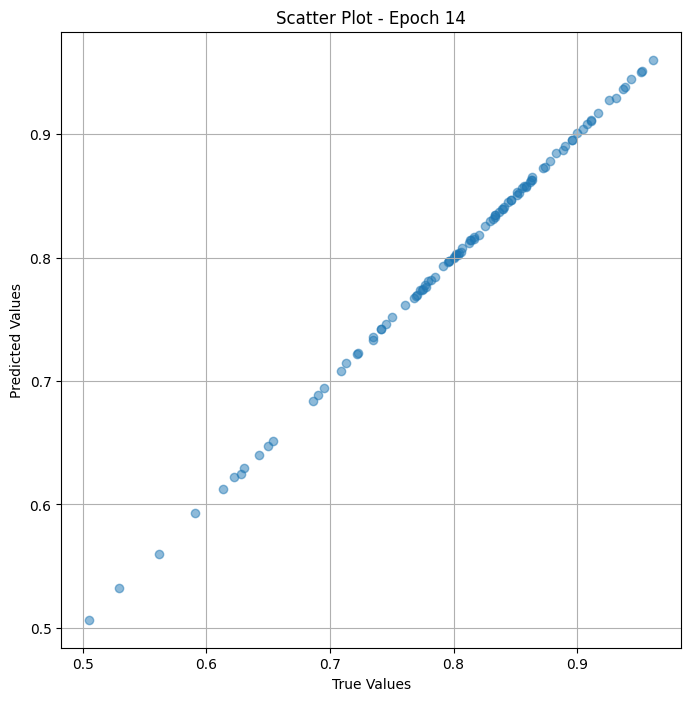

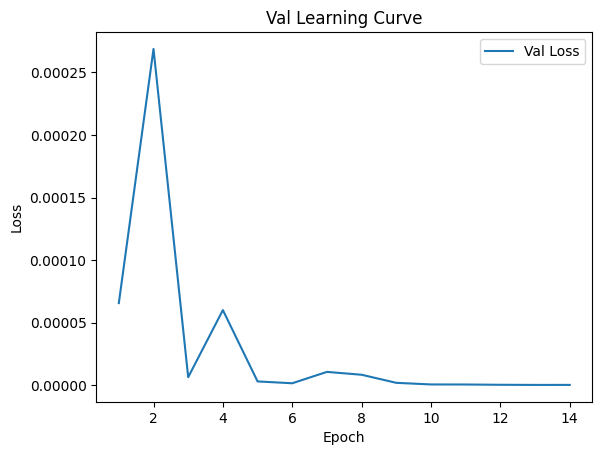


 Epoch: (15/30) Loss = 2.2340242367135943e-07

 Epoch: (15/30) Loss_rmse = 0.0004726546467281878

 Epoch: (15/30) R^2 = 0.9999538064002991

 Epoch: (15/30) MAE = 0.00042897462844848633
Spearman correlation coefficient: SignificanceResult(statistic=0.9998813044935986, pvalue=3.6297858973282474e-172)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.

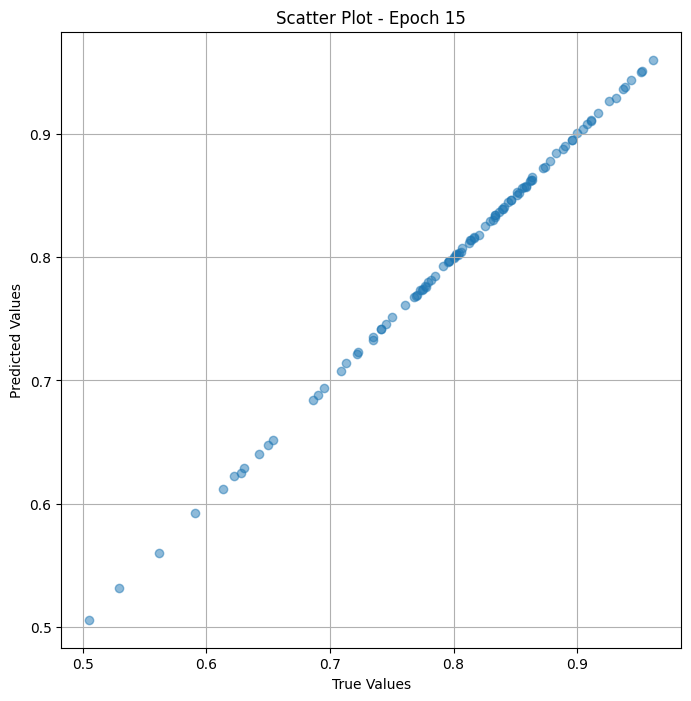

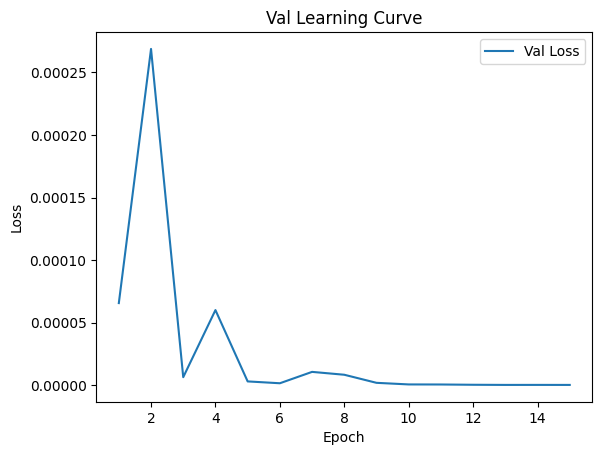


 Epoch: (16/30) Loss = 1.2152463568781968e-07

 Epoch: (16/30) Loss_rmse = 0.00034860384766943753

 Epoch: (16/30) R^2 = 0.9999749064445496

 Epoch: (16/30) MAE = 0.0002980232238769531
Spearman correlation coefficient: SignificanceResult(statistic=0.9999016523745458, pvalue=5.267096550773667e-176)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8

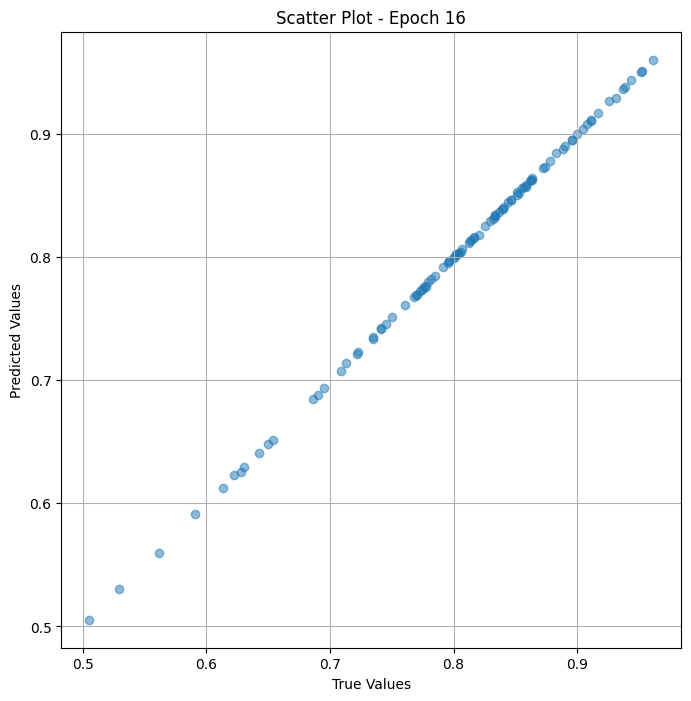

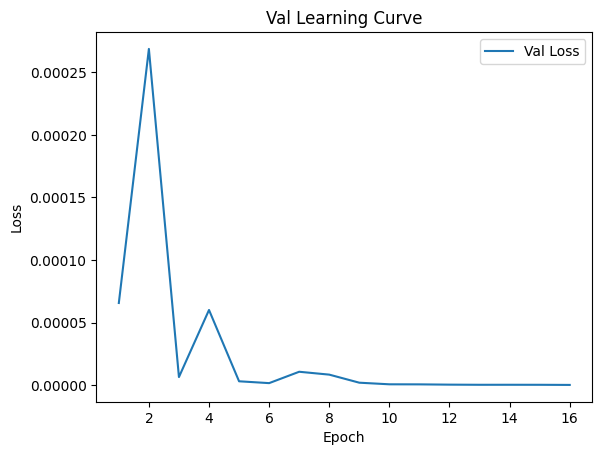


 Epoch: (17/30) Loss = 2.866382686761426e-08

 Epoch: (17/30) Loss_rmse = 0.00016930395213421434

 Epoch: (17/30) R^2 = 0.9999940991401672

 Epoch: (17/30) MAE = 0.0001500844955444336
Spearman correlation coefficient: SignificanceResult(statistic=0.9999016523745458, pvalue=5.267096550773667e-176)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82

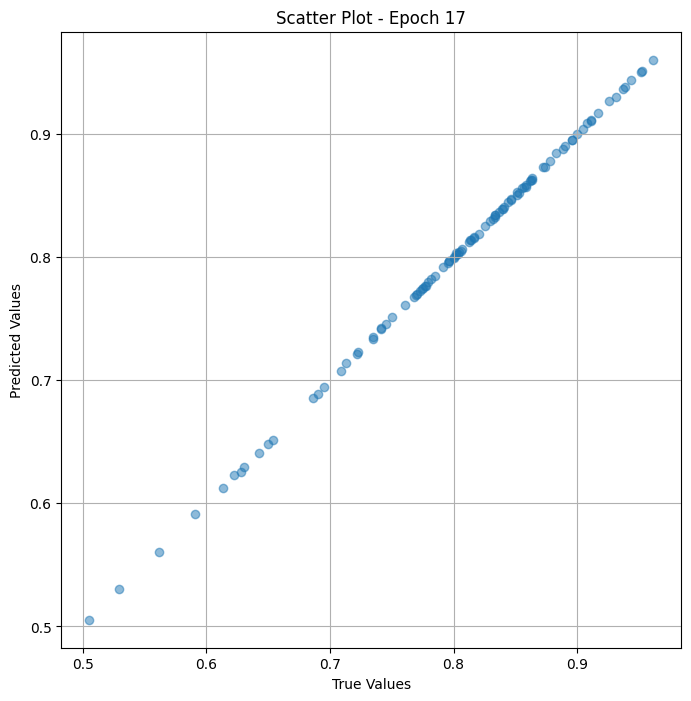

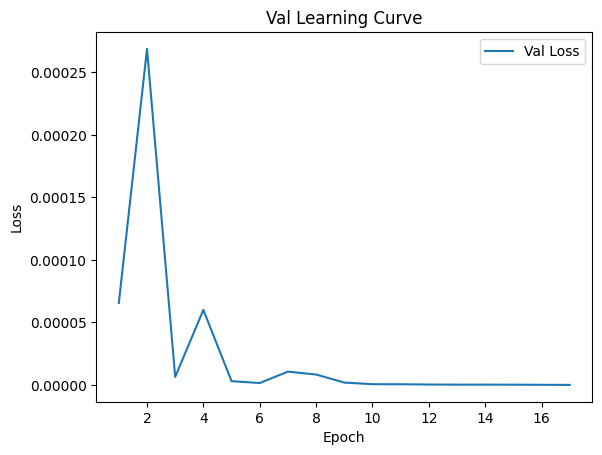


 Epoch: (18/30) Loss = 4.354723692756579e-09

 Epoch: (18/30) Loss_rmse = 6.59903307678178e-05

 Epoch: (18/30) R^2 = 0.9999991059303284

 Epoch: (18/30) MAE = 5.619227886199951e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9999016523745458, pvalue=5.267096550773667e-176)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297

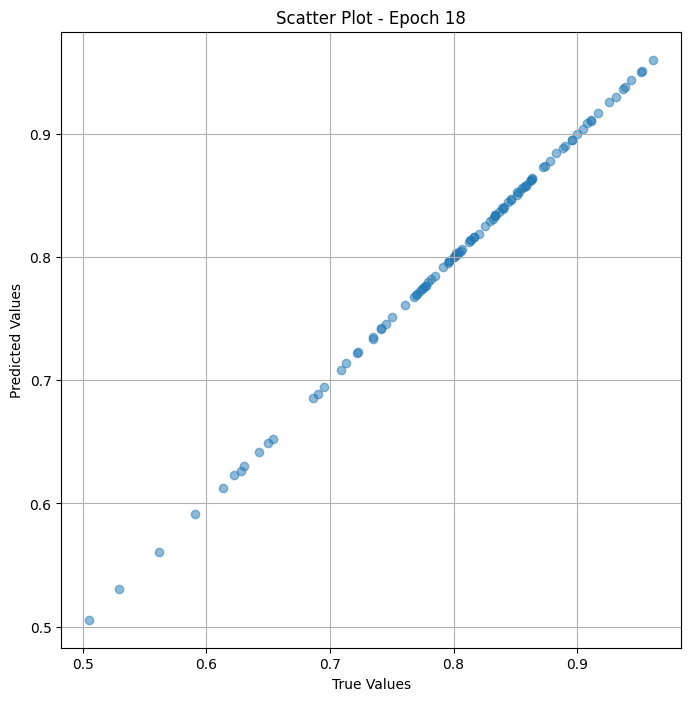

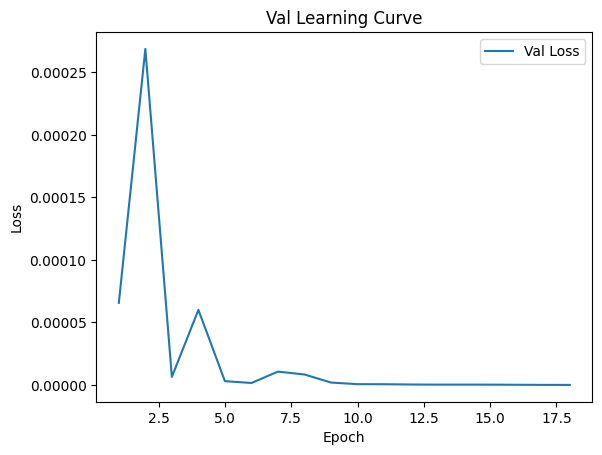


 Epoch: (19/30) Loss = 1.6621278575712495e-08

 Epoch: (19/30) Loss_rmse = 0.00012892353697679937

 Epoch: (19/30) R^2 = 0.999996542930603

 Epoch: (19/30) MAE = 0.00011758506298065186
Spearman correlation coefficient: SignificanceResult(statistic=0.9999287828824756, pvalue=1.3595674797980249e-182)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.

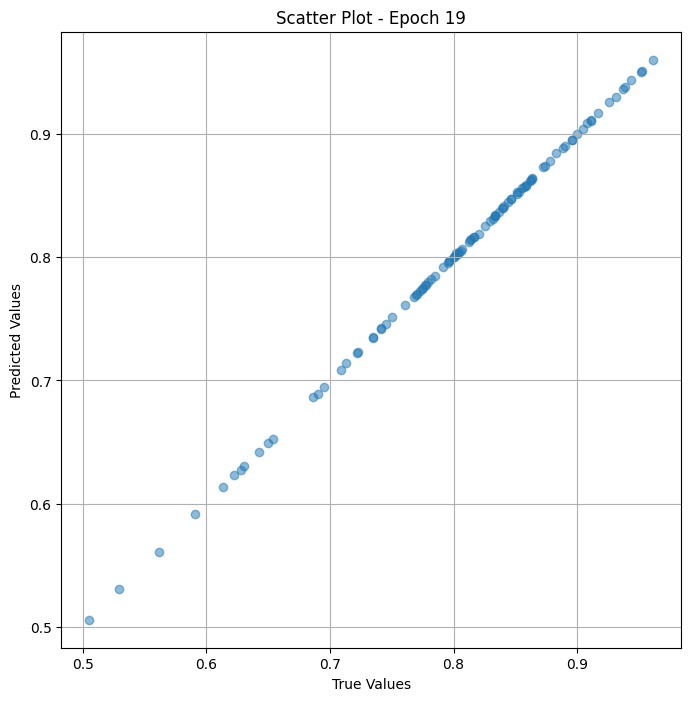

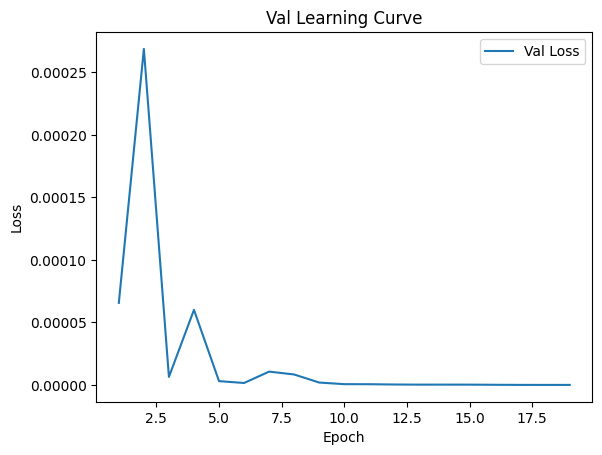


 Epoch: (20/30) Loss = 2.0037770553926748e-08

 Epoch: (20/30) Loss_rmse = 0.00014155483222566545

 Epoch: (20/30) R^2 = 0.9999958872795105

 Epoch: (20/30) MAE = 0.0001316368579864502
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8

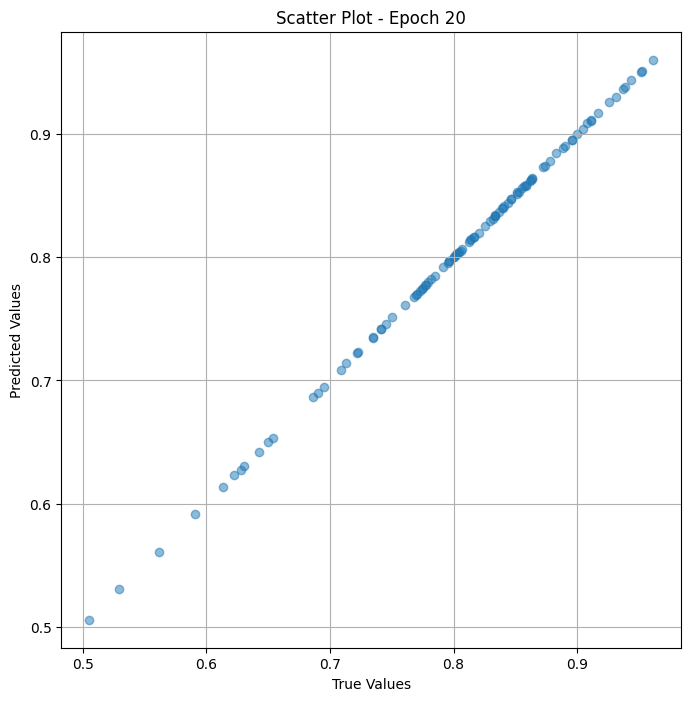

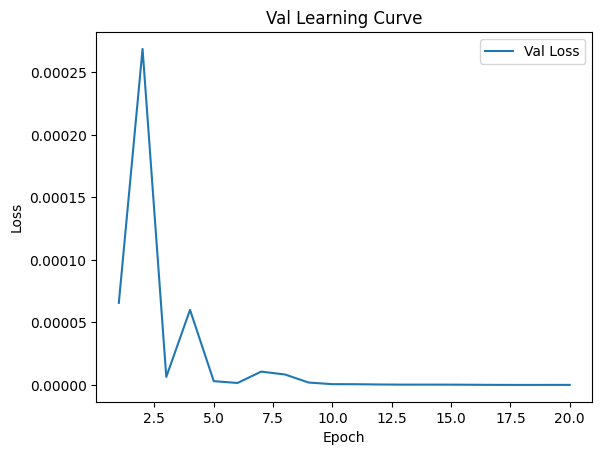

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (21/30) Loss = 1.1145139033885698e-08

 Epoch: (21/30) Loss_rmse = 0.00010557054338278249

 Epoch: (21/30) R^2 = 0.9999976754188538

 Epoch: (21/30) MAE = 9.627640247344971e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 

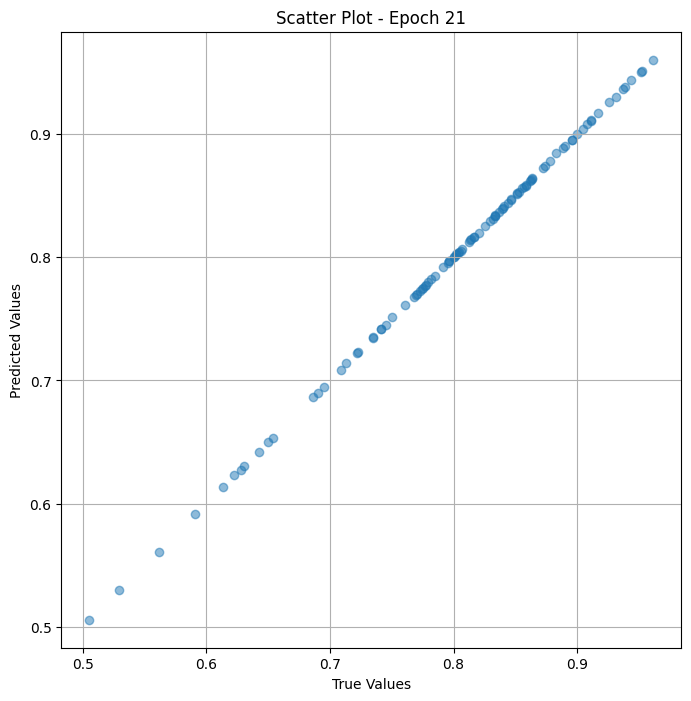

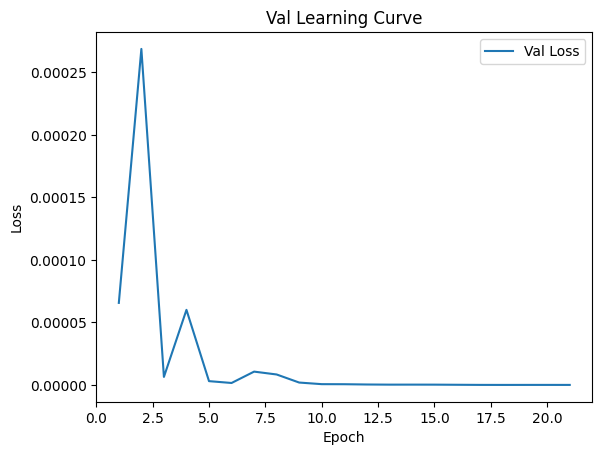


 Epoch: (22/30) Loss = 8.35633162665772e-09

 Epoch: (22/30) Loss_rmse = 9.141297050518915e-05

 Epoch: (22/30) R^2 = 0.9999982714653015

 Epoch: (22/30) MAE = 8.068978786468506e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297

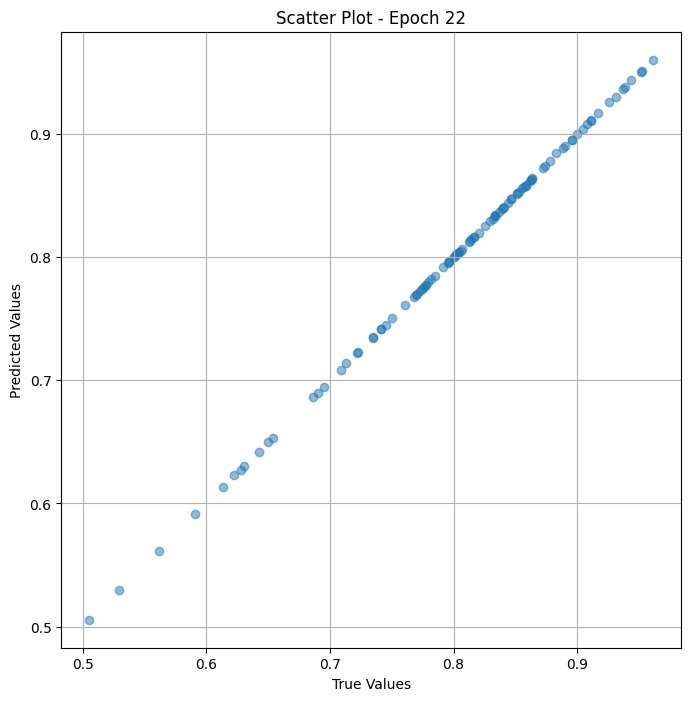

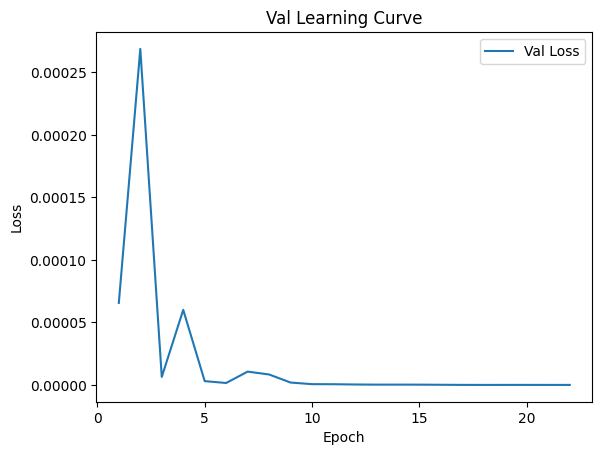


 Epoch: (23/30) Loss = 7.707791738198466e-09

 Epoch: (23/30) Loss_rmse = 8.779403287917376e-05

 Epoch: (23/30) R^2 = 0.9999983906745911

 Epoch: (23/30) MAE = 7.650256156921387e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

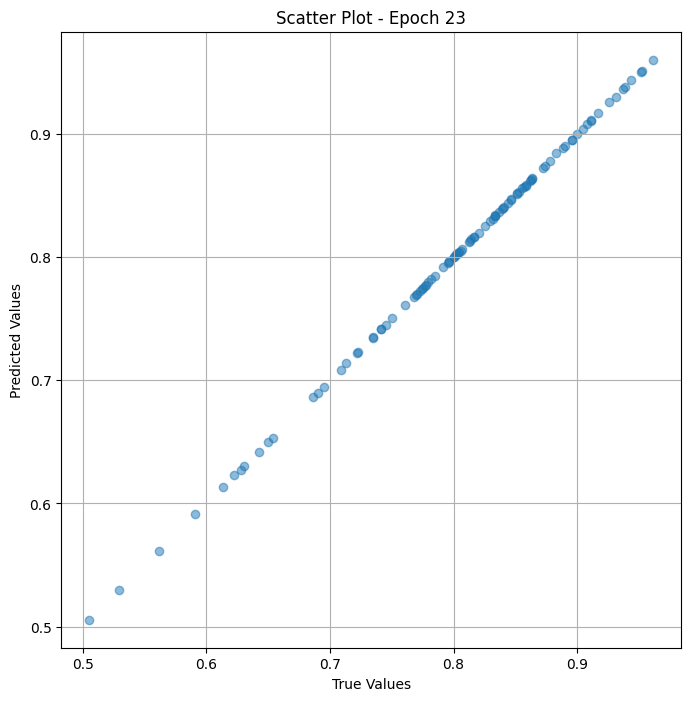

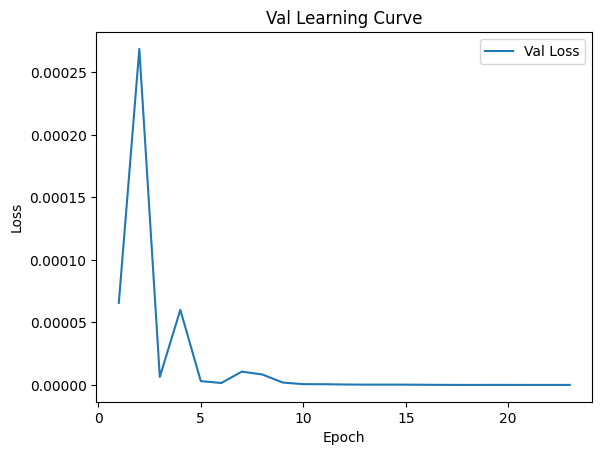

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (24/30) Loss = 7.052896933146258e-09

 Epoch: (24/30) Loss_rmse = 8.398152567679062e-05

 Epoch: (24/30) R^2 = 0.9999985694885254

 Epoch: (24/30) MAE = 7.212162017822266e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.

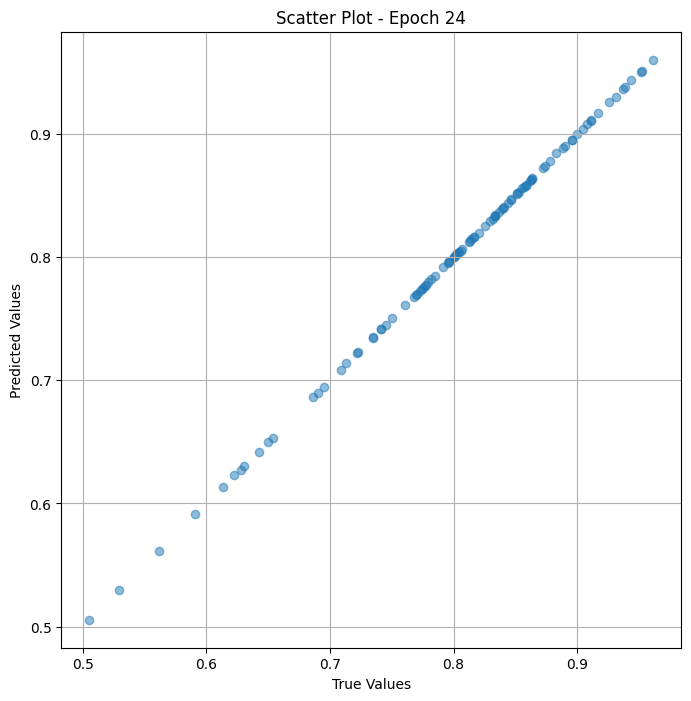

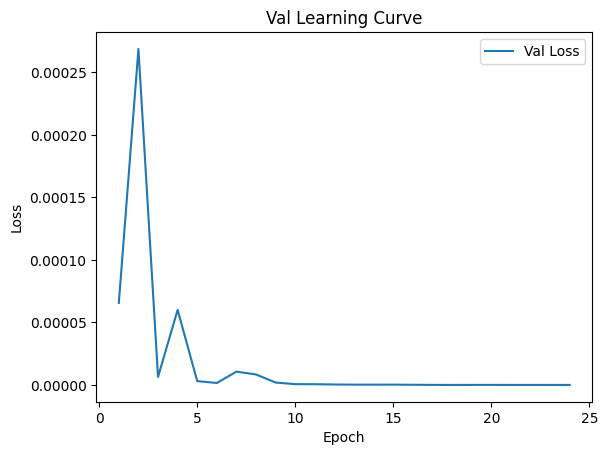


 Epoch: (25/30) Loss = 6.885056968997105e-09

 Epoch: (25/30) Loss_rmse = 8.297624299302697e-05

 Epoch: (25/30) R^2 = 0.9999985694885254

 Epoch: (25/30) MAE = 7.100403308868408e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

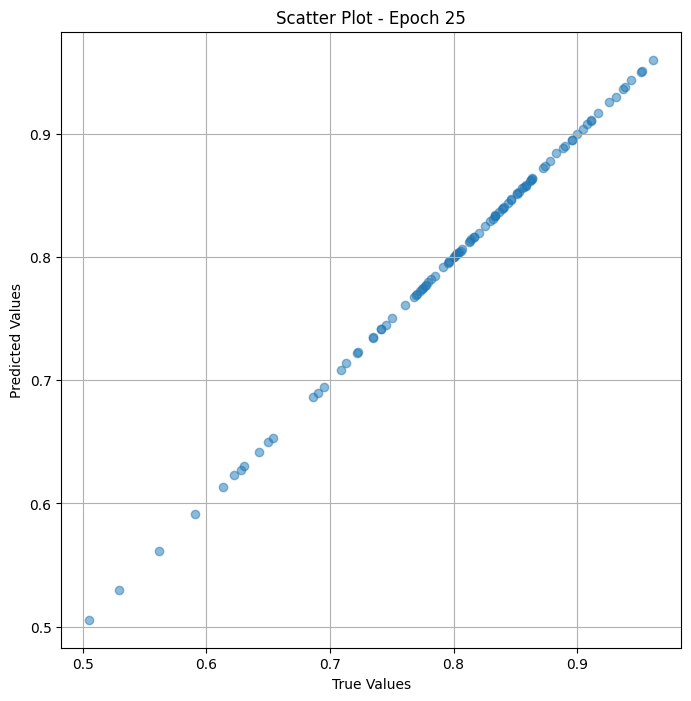

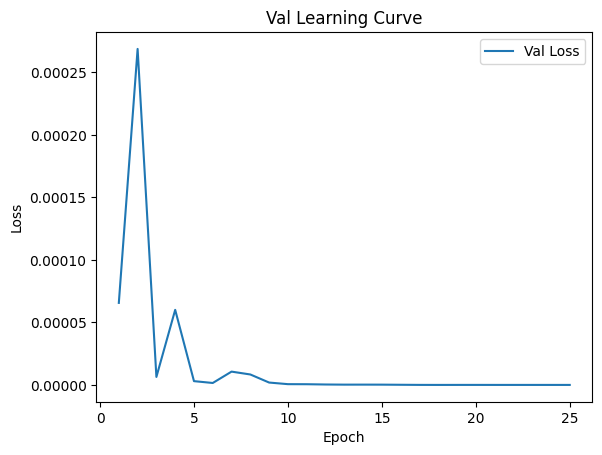


 Epoch: (26/30) Loss = 6.8688255083770855e-09

 Epoch: (26/30) Loss_rmse = 8.28783813631162e-05

 Epoch: (26/30) R^2 = 0.9999985694885254

 Epoch: (26/30) MAE = 7.089972496032715e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

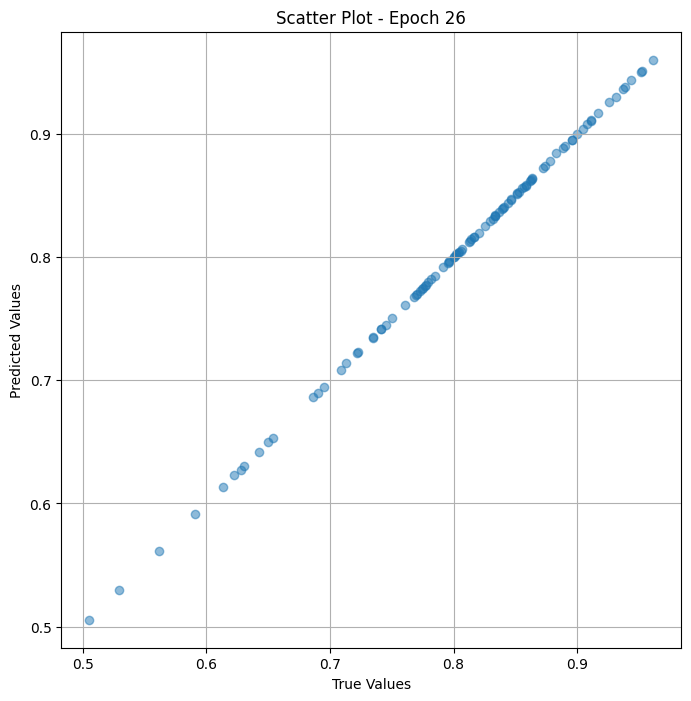

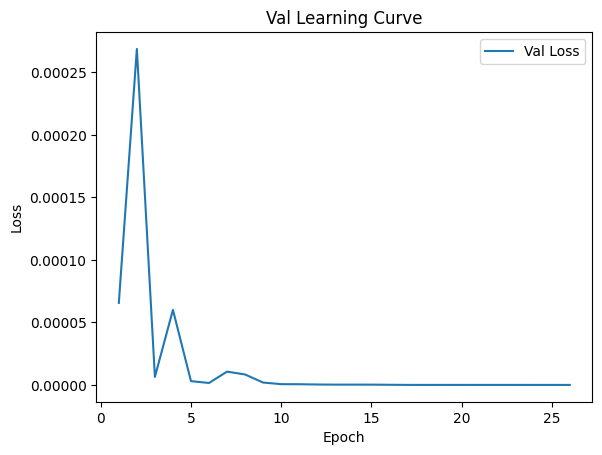


 Epoch: (27/30) Loss = 6.861060164453647e-09

 Epoch: (27/30) Loss_rmse = 8.283151692012325e-05

 Epoch: (27/30) R^2 = 0.9999985694885254

 Epoch: (27/30) MAE = 7.08550214767456e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.8297

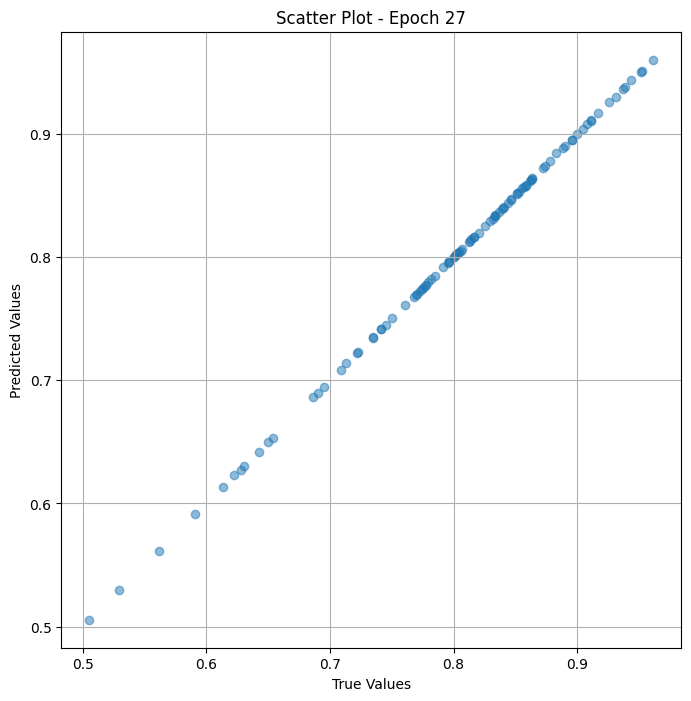

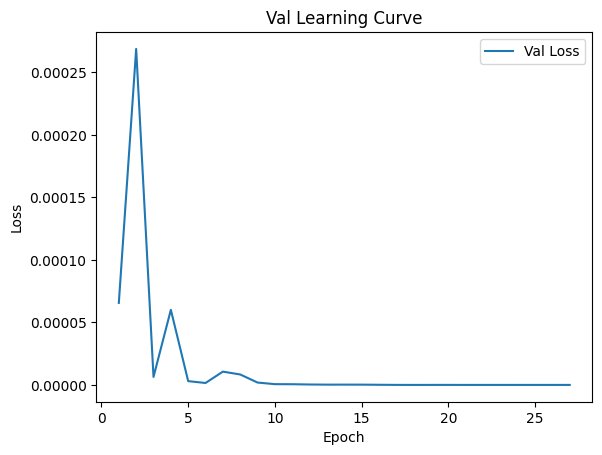


 Epoch: (28/30) Loss = 6.8557817201053695e-09

 Epoch: (28/30) Loss_rmse = 8.279964822577313e-05

 Epoch: (28/30) R^2 = 0.9999985694885254

 Epoch: (28/30) MAE = 7.081031799316406e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82

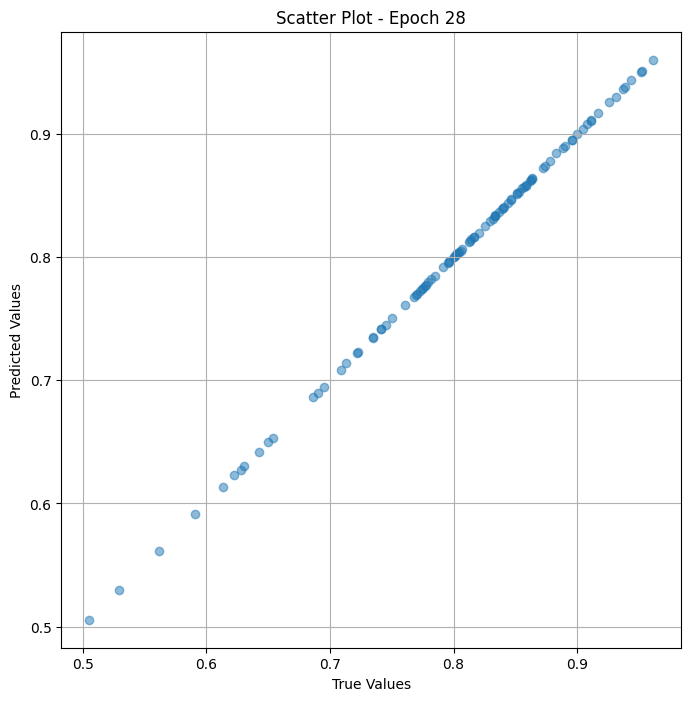

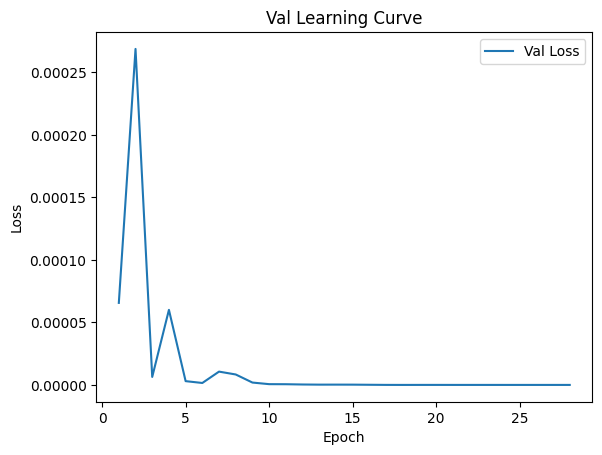


 Epoch: (29/30) Loss = 6.8464904856568864e-09

 Epoch: (29/30) Loss_rmse = 8.274352148873731e-05

 Epoch: (29/30) R^2 = 0.9999985694885254

 Epoch: (29/30) MAE = 7.076561450958252e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.82

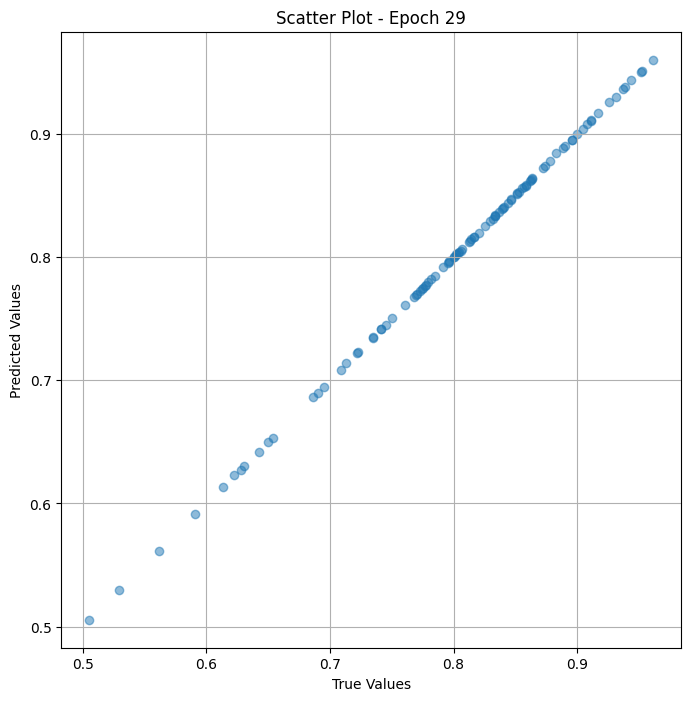

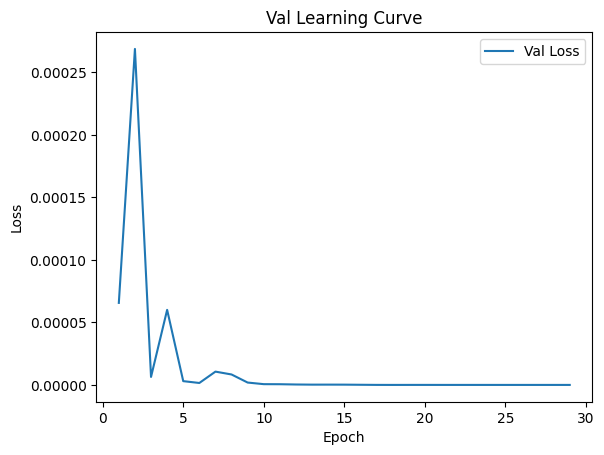


 Epoch: (30/30) Loss = 6.844181221765666e-09

 Epoch: (30/30) Loss_rmse = 8.272956620203331e-05

 Epoch: (30/30) R^2 = 0.9999985694885254

 Epoch: (30/30) MAE = 7.073581218719482e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999955913390405, pvalue=2.2111320542621302e-192)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.65346533, 0.7790698, 0.79591835, 0.75, 0.8131868, 0.71304345, 0.6495727, 0.8, 0.72164947, 0.8736842, 0.89, 0.9514563, 0.8333333, 0.9166667, 0.9255319, 0.9108911, 0.6862745, 0.70866144, 0.7346939, 0.8333333, 0.8888889, 0.85148513, 0.85106385, 0.87777776, 0.85714287, 0.7765958, 0.81395346, 0.9313725, 0.8636364, 0.9, 0.50526315, 0.5294118, 0.7741935, 0.8333333, 0.85858583, 0.9108911, 0.9368421, 0.81632656, 0.7345133, 0.6132075, 0.8636364, 0.853211, 0.7777778, 0.7755102, 0.56122446, 0.59090906, 0.69473684, 0.69, 0.8202247, 0.82568806, 0.6226415, 0.74157304, 0.93846154, 0.9047619, 0.86238533, 0.8035714, 0.829

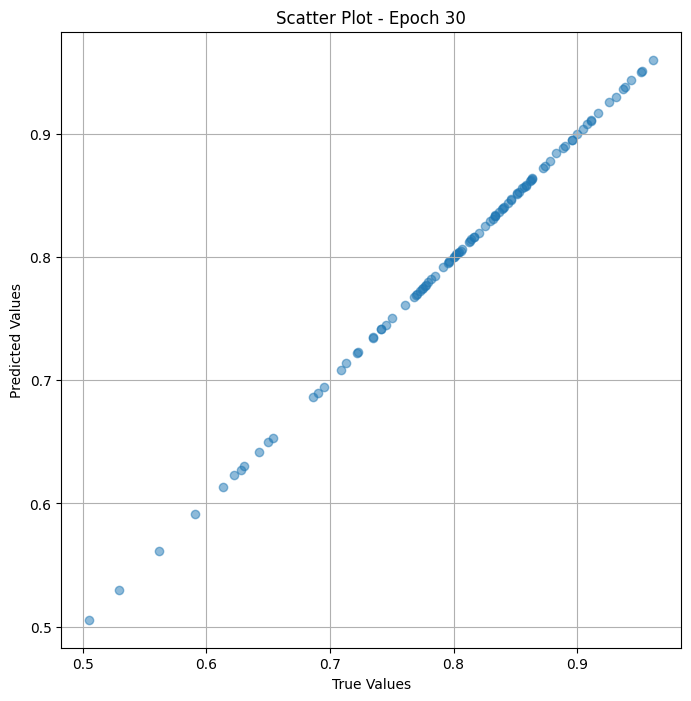

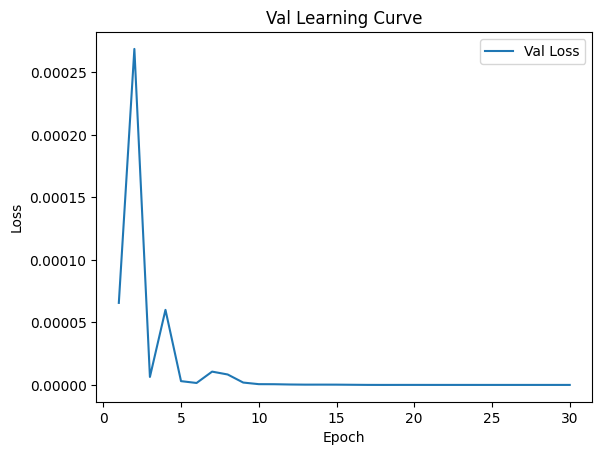

In [ ]:
# val the model and save weights
fit(30, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

## Test

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-8)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.0015882860170677304

 Epoch: (1/50) Loss_rmse = 0.039853304624557495

 Epoch: (1/50) R^2 = 0.4452165365219116

 Epoch: (1/50) MAE = 0.033596113324165344
Spearman correlation coefficient: SignificanceResult(statistic=0.9350457328232158, pvalue=4.0718292660633364e-44)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.

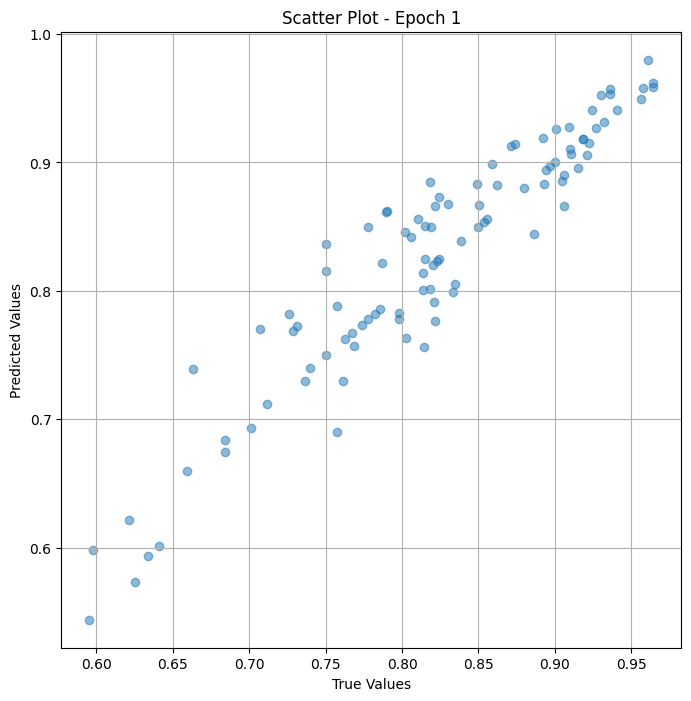

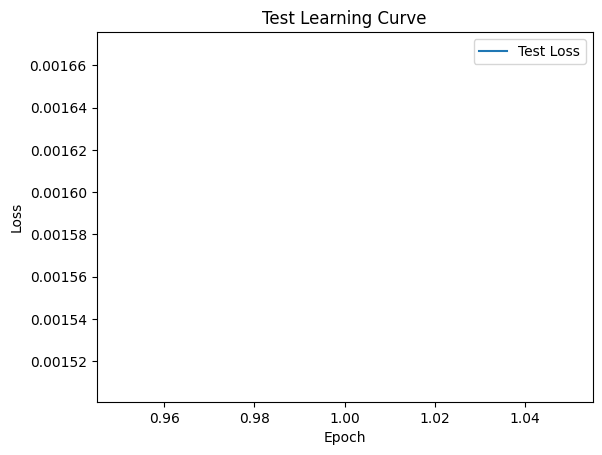


 Epoch: (2/50) Loss = 0.009689205326139927

 Epoch: (2/50) Loss_rmse = 0.09843376278877258

 Epoch: (2/50) R^2 = -2.3844099044799805

 Epoch: (2/50) MAE = 0.08694826066493988
Spearman correlation coefficient: SignificanceResult(statistic=0.7816081044815397, pvalue=5.6322872172911325e-21)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.79

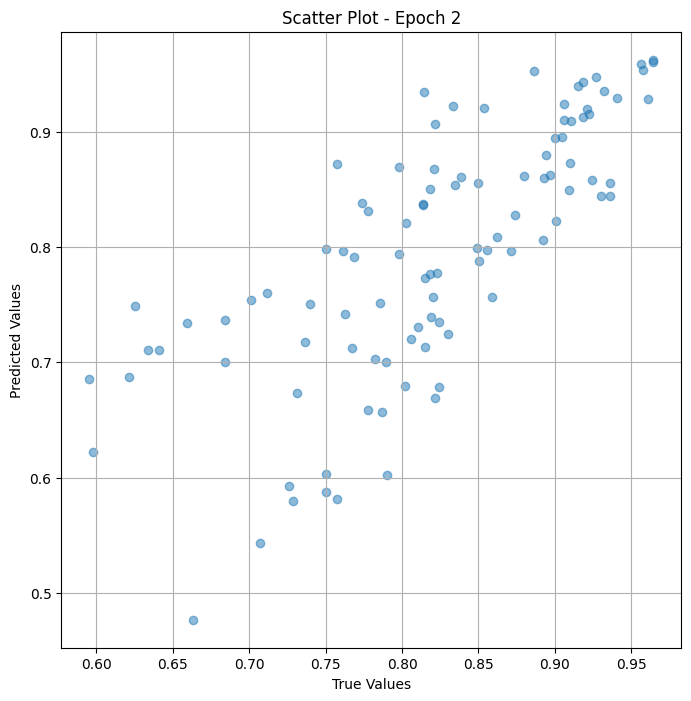

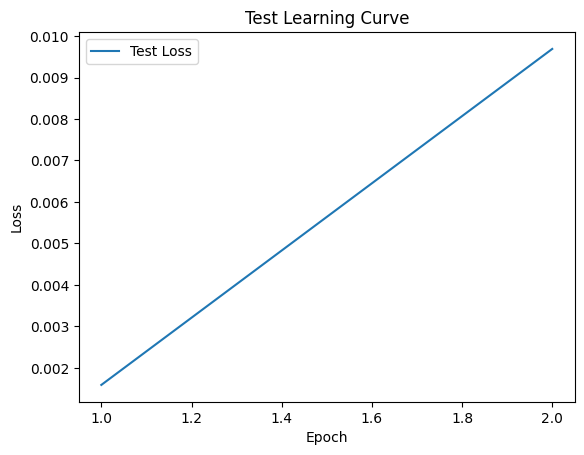


 Epoch: (3/50) Loss = 0.007327883969992399

 Epoch: (3/50) Loss_rmse = 0.08560305833816528

 Epoch: (3/50) R^2 = -1.5596075057983398

 Epoch: (3/50) MAE = 0.06566177308559418
Spearman correlation coefficient: SignificanceResult(statistic=0.4341928113470249, pvalue=9.881355660539876e-06)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.798

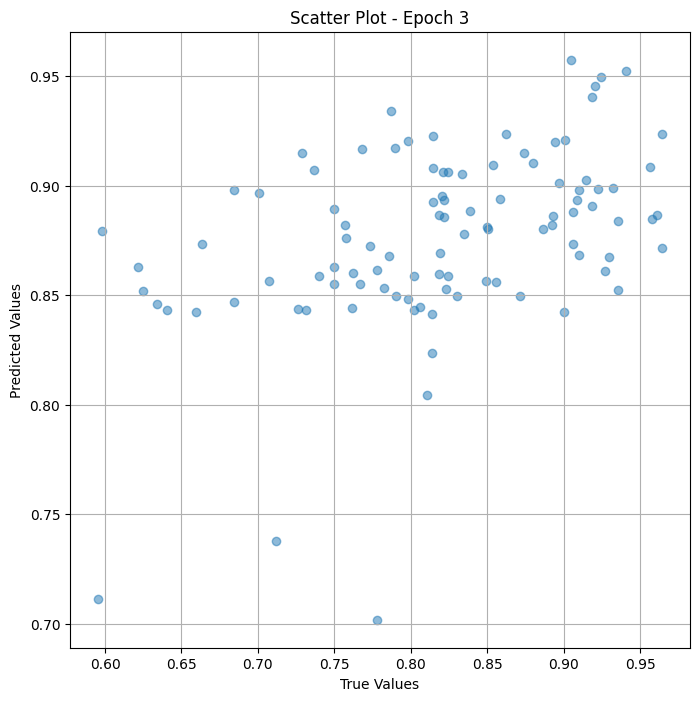

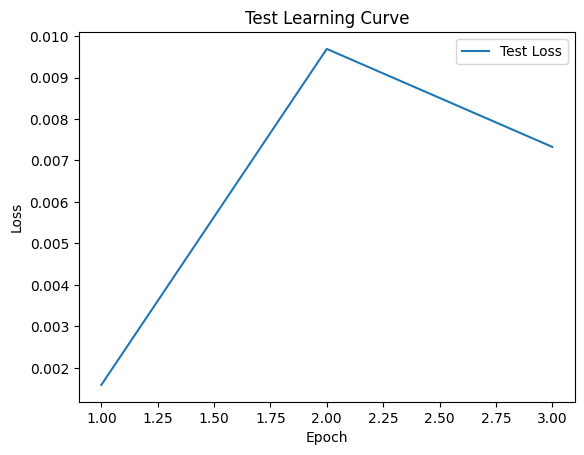


 Epoch: (4/50) Loss = 3.293177724117413e-05

 Epoch: (4/50) Loss_rmse = 0.005738621577620506

 Epoch: (4/50) R^2 = 0.9884970188140869

 Epoch: (4/50) MAE = 0.005667969584465027
Spearman correlation coefficient: SignificanceResult(statistic=0.6884480909870246, pvalue=9.10574417694892e-15)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.79

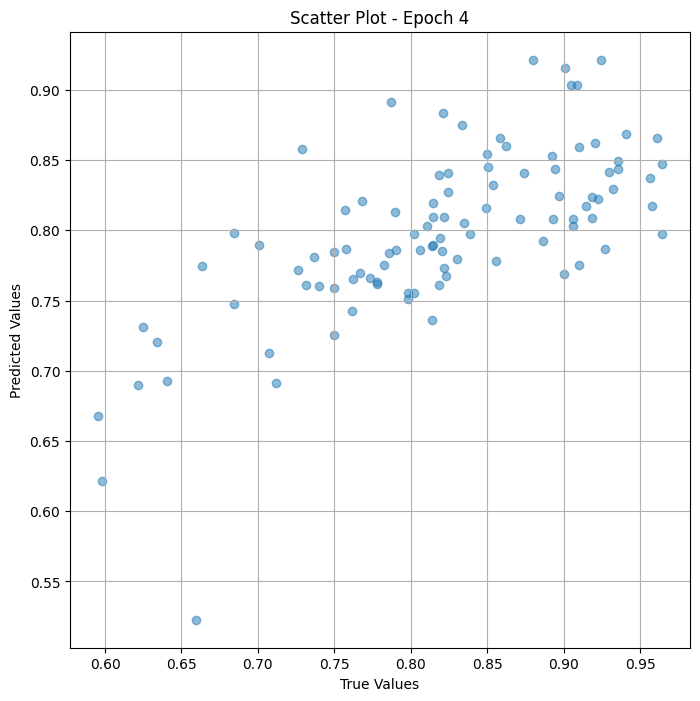

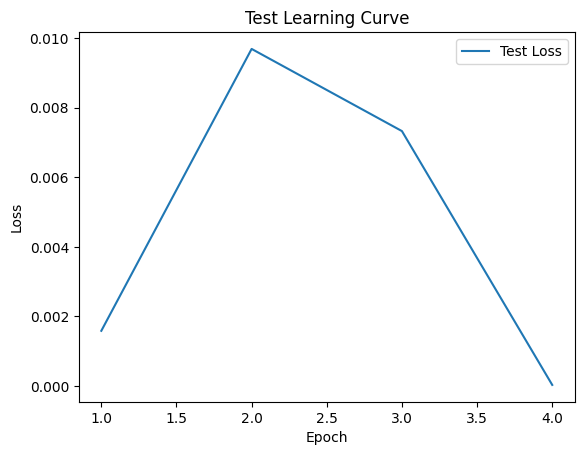


 Epoch: (5/50) Loss = 0.0007918761693872511

 Epoch: (5/50) Loss_rmse = 0.028140295296907425

 Epoch: (5/50) R^2 = 0.7234000563621521

 Epoch: (5/50) MAE = 0.024942472577095032
Spearman correlation coefficient: SignificanceResult(statistic=0.830267000499716, pvalue=1.3495284039724631e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.7

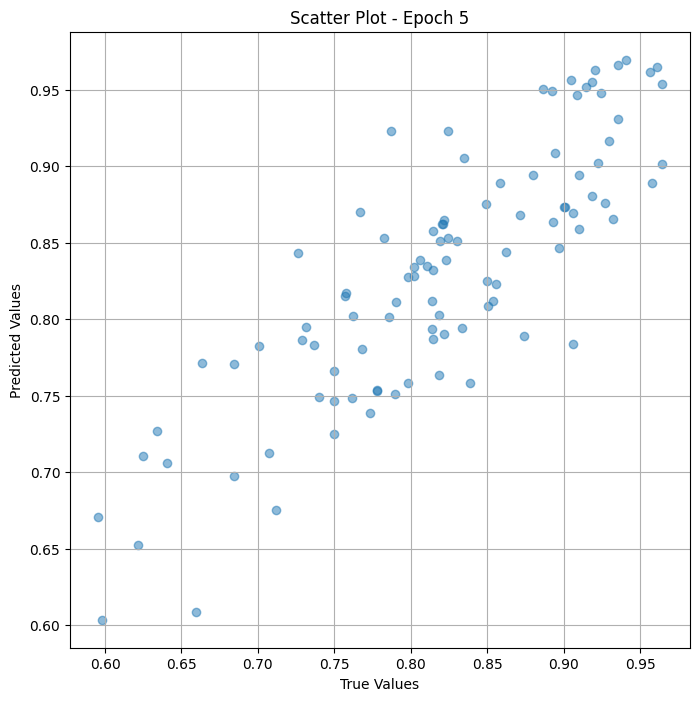

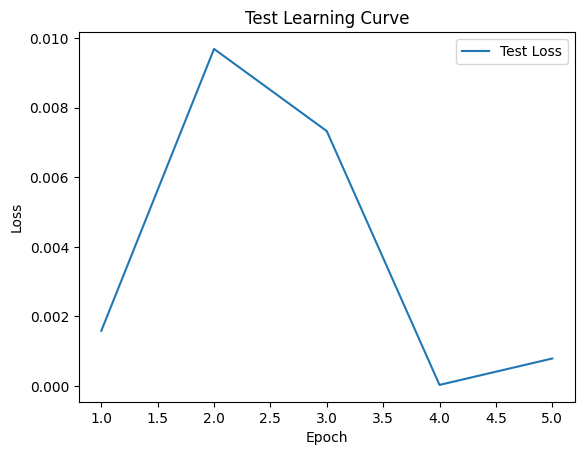


 Epoch: (6/50) Loss = 0.00030943716410547495

 Epoch: (6/50) Loss_rmse = 0.017590826377272606

 Epoch: (6/50) R^2 = 0.8919145464897156

 Epoch: (6/50) MAE = 0.0164661705493927
Spearman correlation coefficient: SignificanceResult(statistic=0.8950618755570952, pvalue=9.849555740923815e-35)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.79

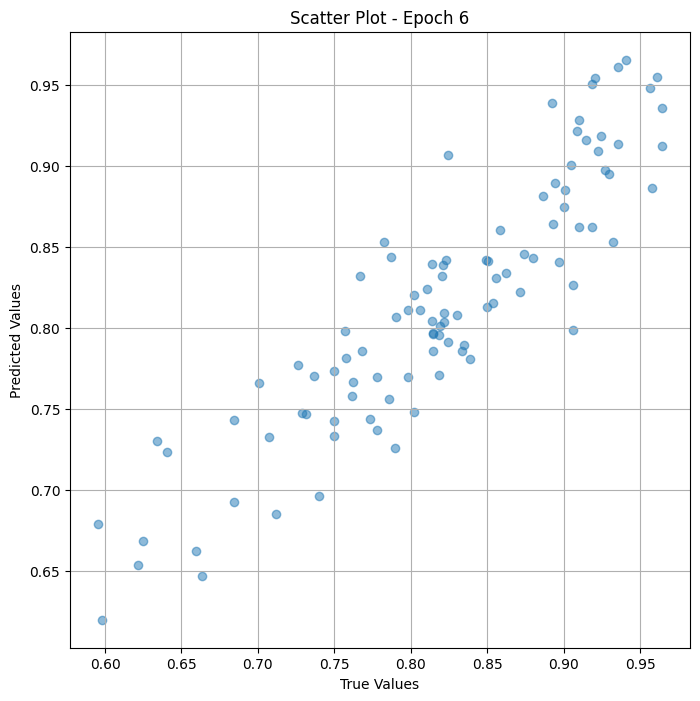

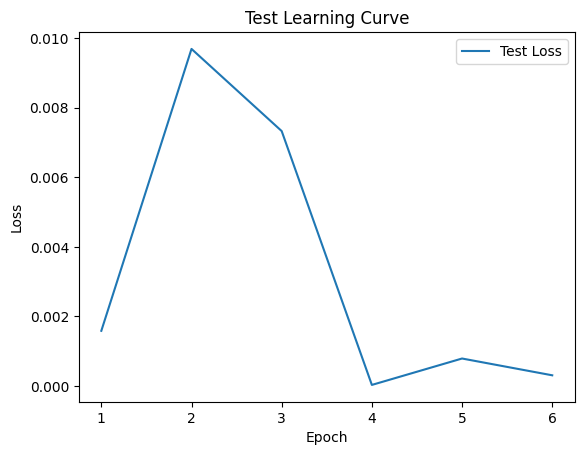

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/50) Loss = 8.489834726788104e-05

 Epoch: (7/50) Loss_rmse = 0.009214029647409916

 Epoch: (7/50) R^2 = 0.9703452587127686

 Epoch: (7/50) MAE = 0.007999658584594727
Spearman correlation coefficient: SignificanceResult(statistic=0.9478107233872257, pvalue=1.8707098909020546e-48)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.81443

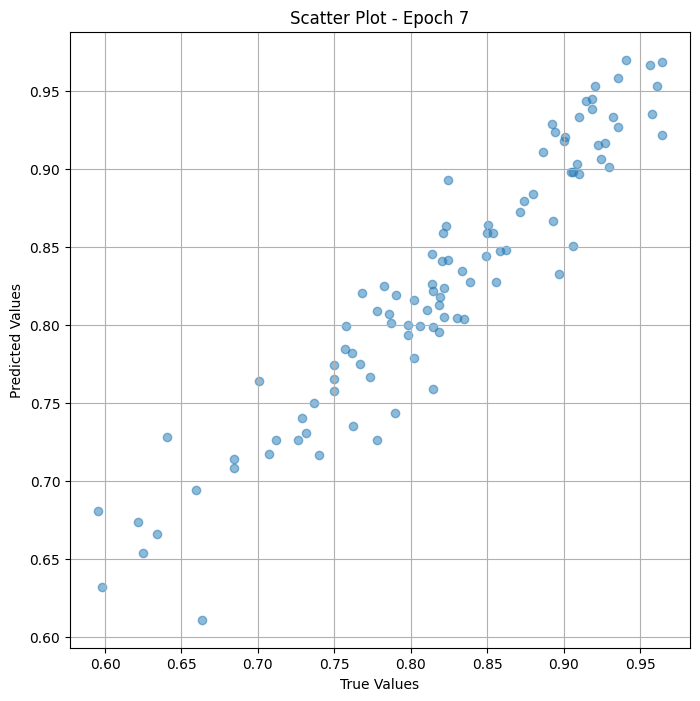

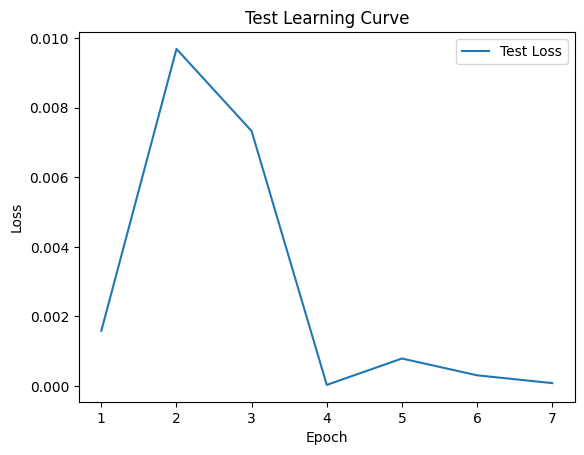


 Epoch: (8/50) Loss = 5.362589945434593e-05

 Epoch: (8/50) Loss_rmse = 0.007322970777750015

 Epoch: (8/50) R^2 = 0.9812686443328857

 Epoch: (8/50) MAE = 0.0061117857694625854
Spearman correlation coefficient: SignificanceResult(statistic=0.9696305823906372, pvalue=2.741106149739331e-59)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.

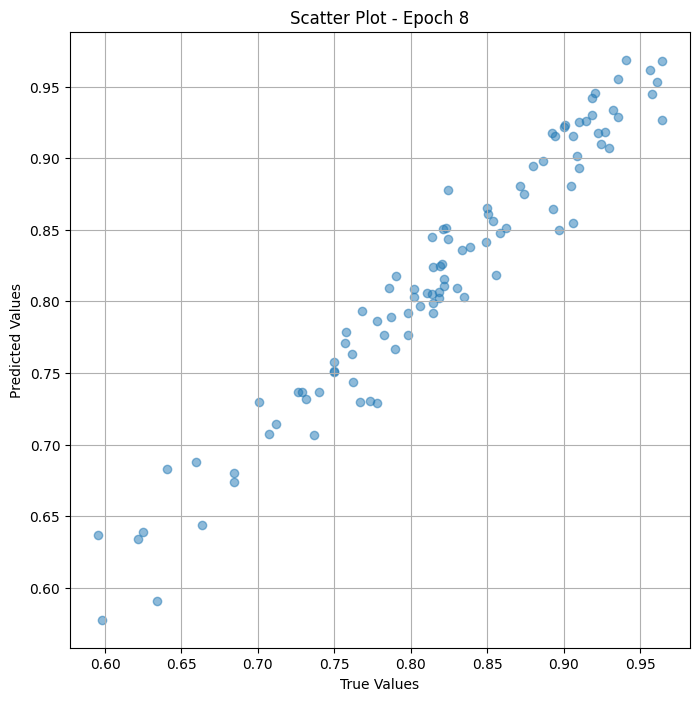

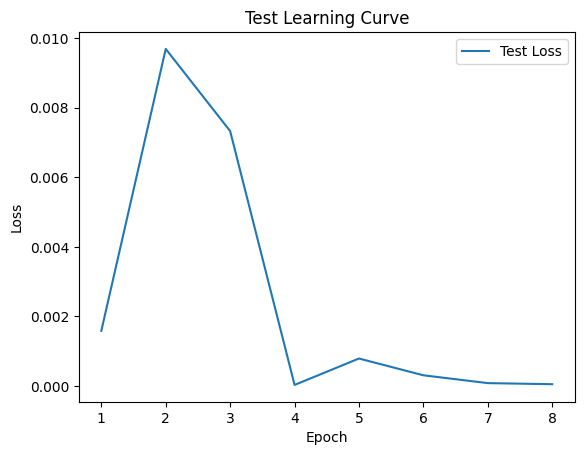


 Epoch: (9/50) Loss = 4.484190867515281e-05

 Epoch: (9/50) Loss_rmse = 0.00669641001150012

 Epoch: (9/50) R^2 = 0.9843368530273438

 Epoch: (9/50) MAE = 0.005932226777076721
Spearman correlation coefficient: SignificanceResult(statistic=0.9726013931595194, pvalue=2.3233545237201842e-61)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 0.7

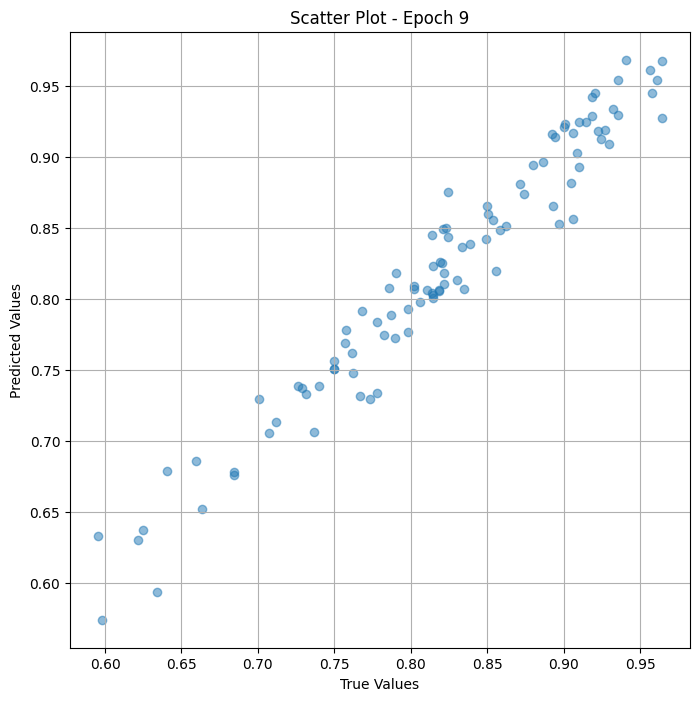

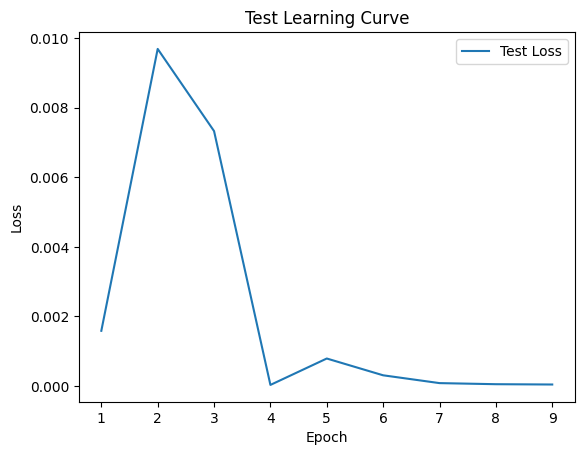


 Epoch: (10/50) Loss = 2.906304143834859e-05

 Epoch: (10/50) Loss_rmse = 0.005391014739871025

 Epoch: (10/50) R^2 = 0.9898483753204346

 Epoch: (10/50) MAE = 0.004990532994270325
Spearman correlation coefficient: SignificanceResult(statistic=0.9773085682134104, pvalue=3.67270051990648e-65)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 

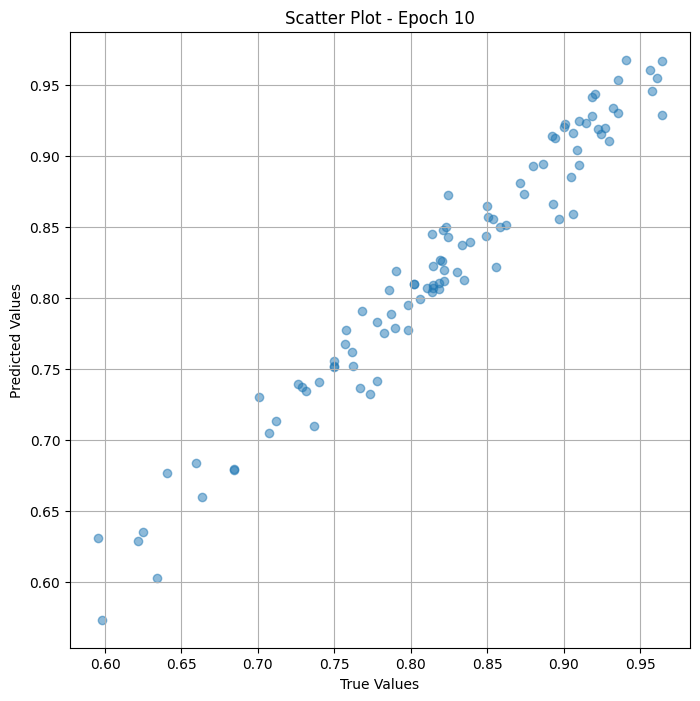

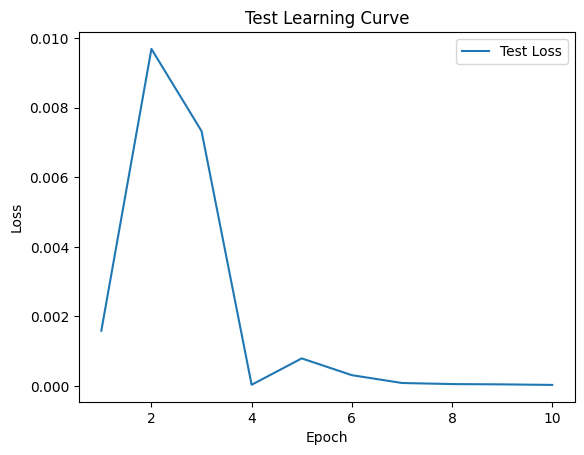


 Epoch: (11/50) Loss = 1.365956813970115e-05

 Epoch: (11/50) Loss_rmse = 0.0036958851851522923

 Epoch: (11/50) R^2 = 0.9952287673950195

 Epoch: (11/50) MAE = 0.00356215238571167
Spearman correlation coefficient: SignificanceResult(statistic=0.9805574685748136, pvalue=2.77305960438038e-68)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921, 

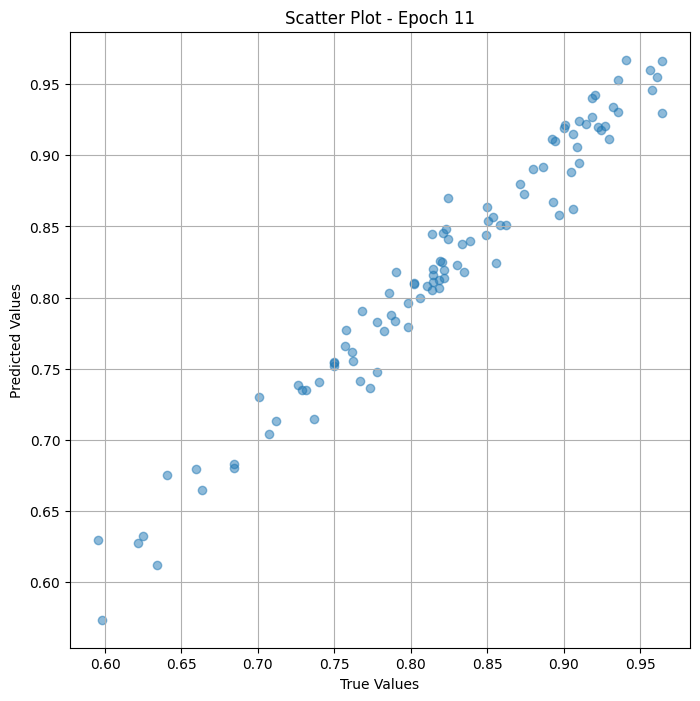

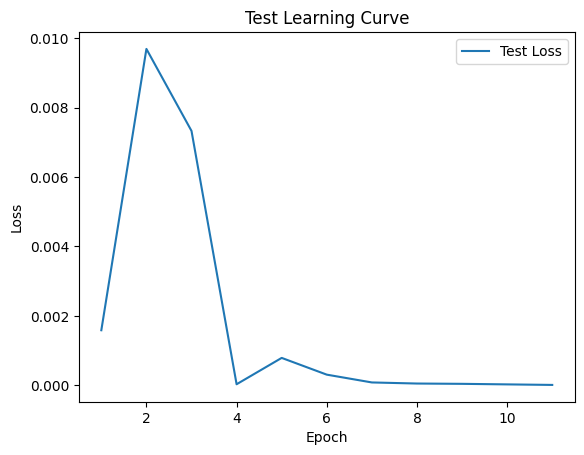


 Epoch: (12/50) Loss = 6.246753400773741e-06

 Epoch: (12/50) Loss_rmse = 0.002499350579455495

 Epoch: (12/50) R^2 = 0.9978180527687073

 Epoch: (12/50) MAE = 0.0022524744272232056
Spearman correlation coefficient: SignificanceResult(statistic=0.9831281016373852, pvalue=3.746677760434148e-71)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921

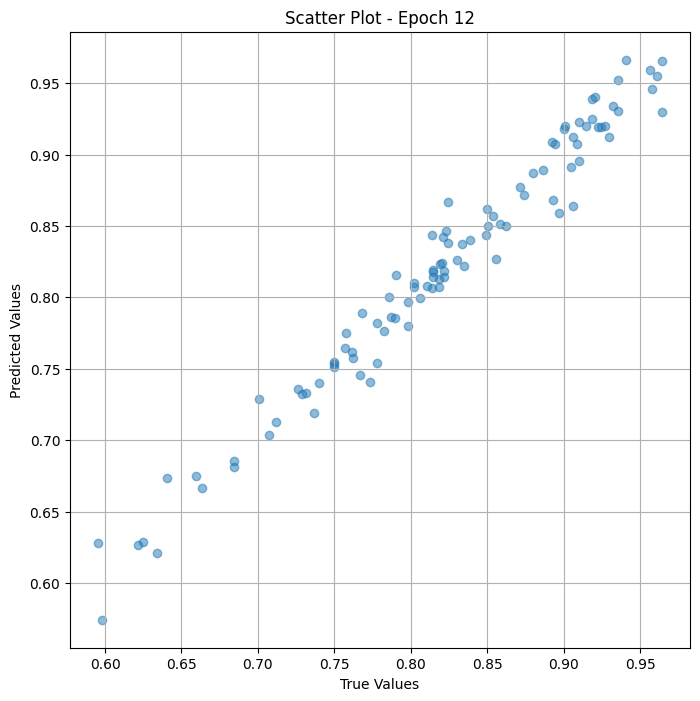

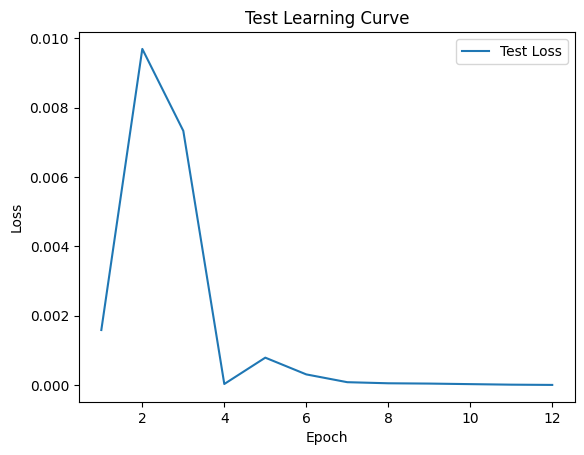


 Epoch: (13/50) Loss = 5.796672667202074e-06

 Epoch: (13/50) Loss_rmse = 0.002407628111541271

 Epoch: (13/50) R^2 = 0.99797523021698

 Epoch: (13/50) MAE = 0.0022002309560775757
Spearman correlation coefficient: SignificanceResult(statistic=0.9858547361786881, pvalue=1.0058388140039163e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921,

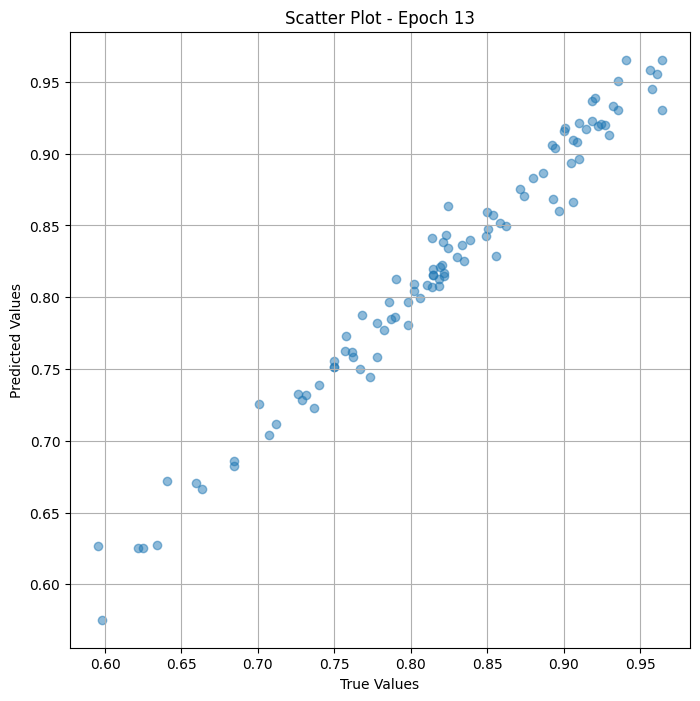

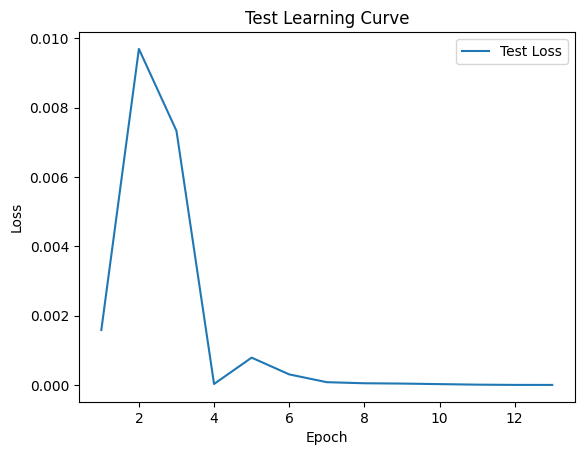


 Epoch: (14/50) Loss = 5.583873189607402e-06

 Epoch: (14/50) Loss_rmse = 0.0023630219511687756

 Epoch: (14/50) R^2 = 0.9980495572090149

 Epoch: (14/50) MAE = 0.0019054263830184937
Spearman correlation coefficient: SignificanceResult(statistic=0.9875978831366853, pvalue=2.164068057599029e-77)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

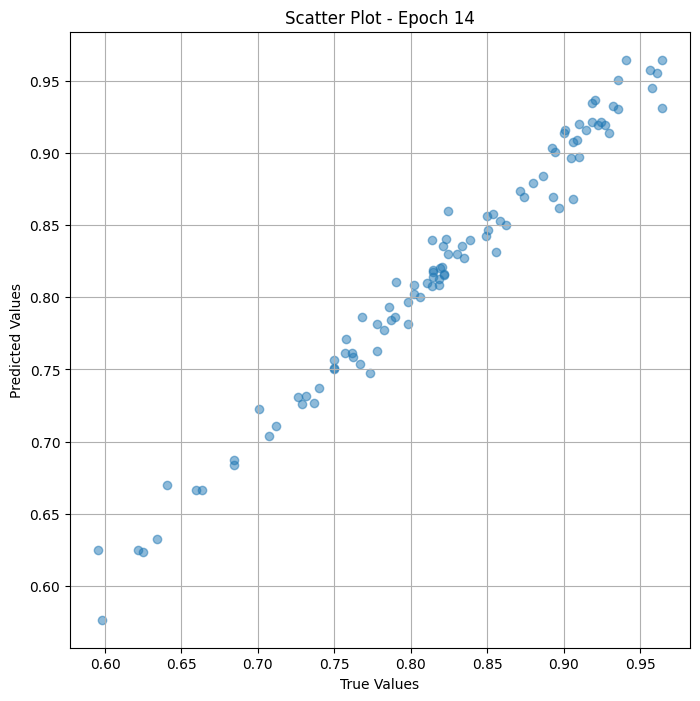

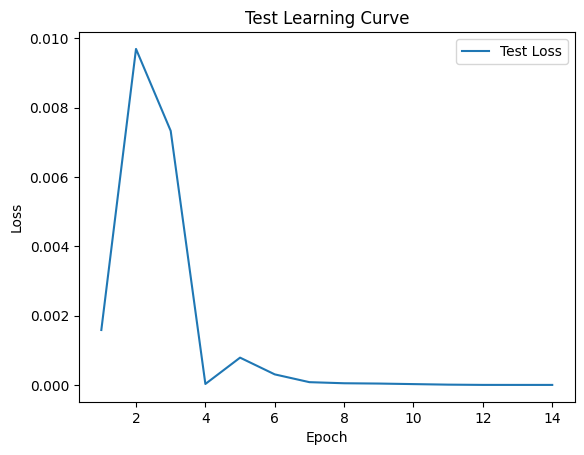


 Epoch: (15/50) Loss = 3.7286306451278506e-06

 Epoch: (15/50) Loss_rmse = 0.0019309662748128176

 Epoch: (15/50) R^2 = 0.9986975789070129

 Epoch: (15/50) MAE = 0.0016938000917434692
Spearman correlation coefficient: SignificanceResult(statistic=0.9895445102843319, pvalue=7.401121909876206e-81)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

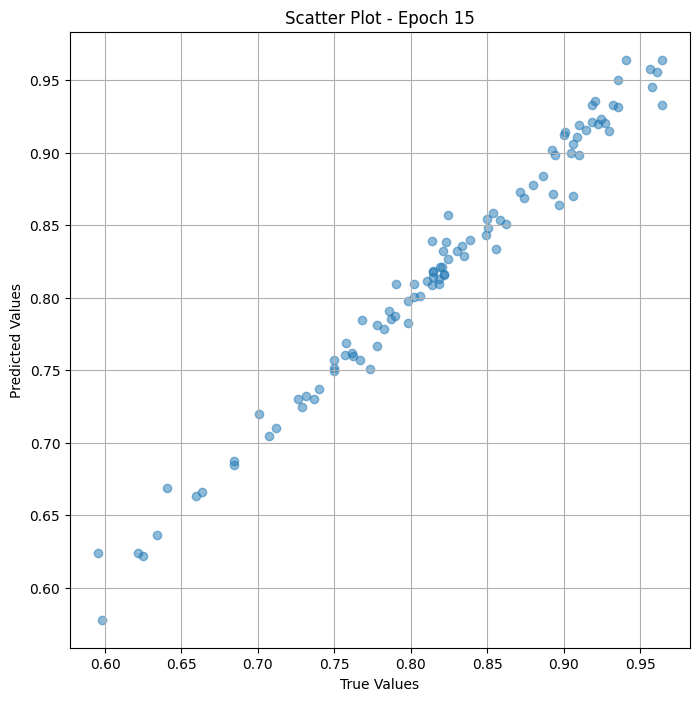

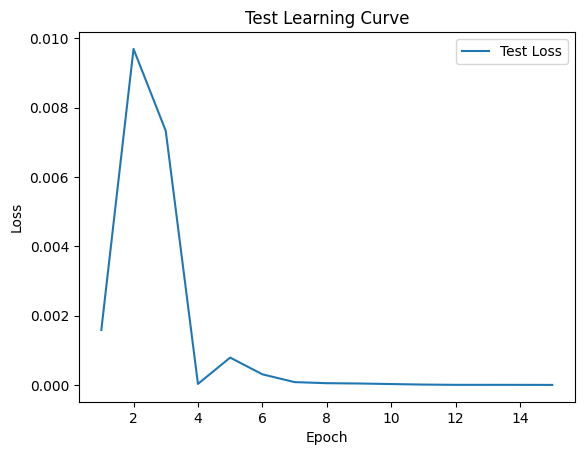


 Epoch: (16/50) Loss = 2.3523241452494403e-06

 Epoch: (16/50) Loss_rmse = 0.0015337287914007902

 Epoch: (16/50) R^2 = 0.9991783499717712

 Epoch: (16/50) MAE = 0.0014508366584777832
Spearman correlation coefficient: SignificanceResult(statistic=0.9915250507969199, pvalue=3.999585965370088e-85)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

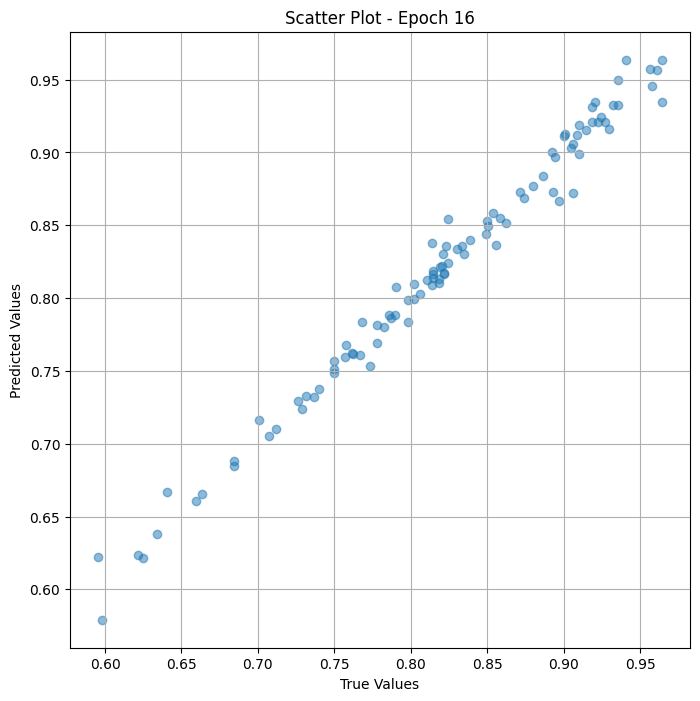

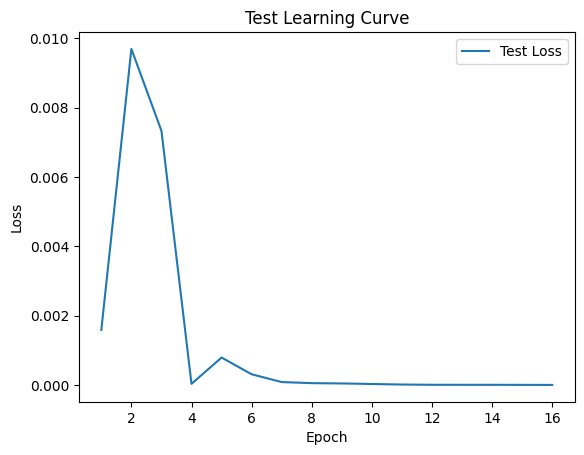


 Epoch: (17/50) Loss = 1.742230210766138e-06

 Epoch: (17/50) Loss_rmse = 0.001319935661740601

 Epoch: (17/50) R^2 = 0.9993914365768433

 Epoch: (17/50) MAE = 0.0010884255170822144
Spearman correlation coefficient: SignificanceResult(statistic=0.9930240215273377, pvalue=4.4027888099710244e-89)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

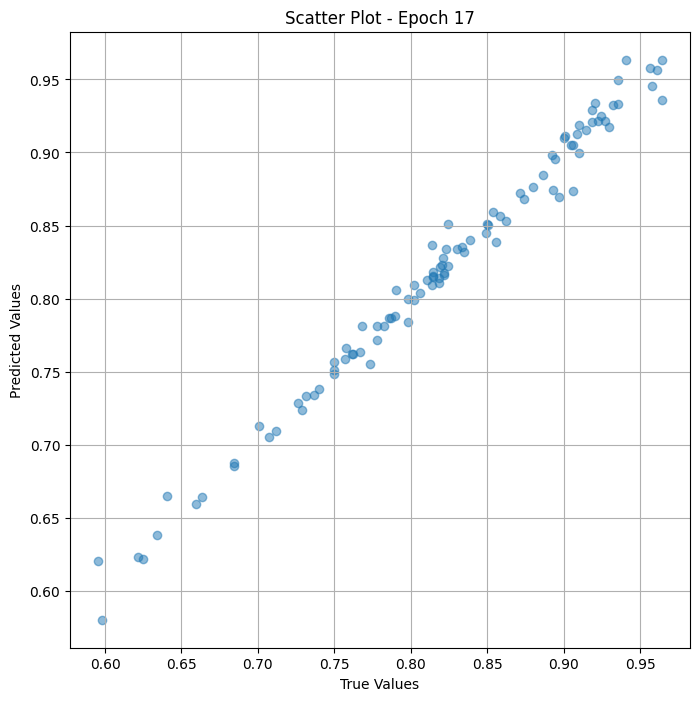

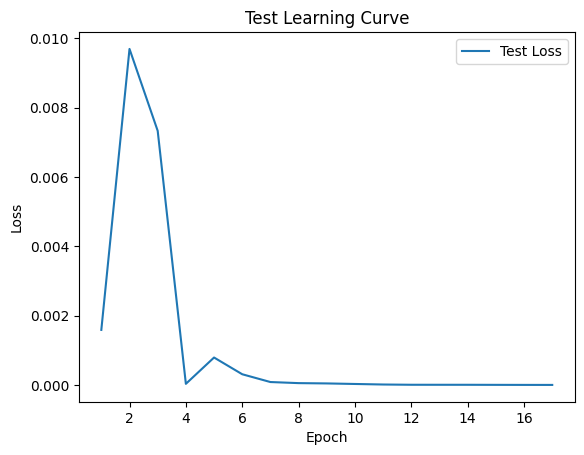


 Epoch: (18/50) Loss = 1.1362928944436135e-06

 Epoch: (18/50) Loss_rmse = 0.0010659703984856606

 Epoch: (18/50) R^2 = 0.9996030926704407

 Epoch: (18/50) MAE = 0.0007634162902832031
Spearman correlation coefficient: SignificanceResult(statistic=0.9939803784186902, pvalue=4.3996861352763324e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

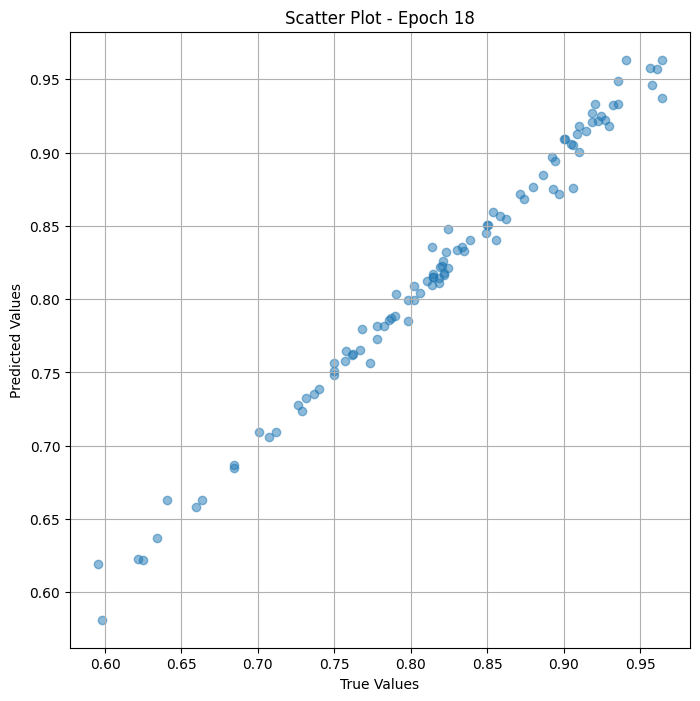

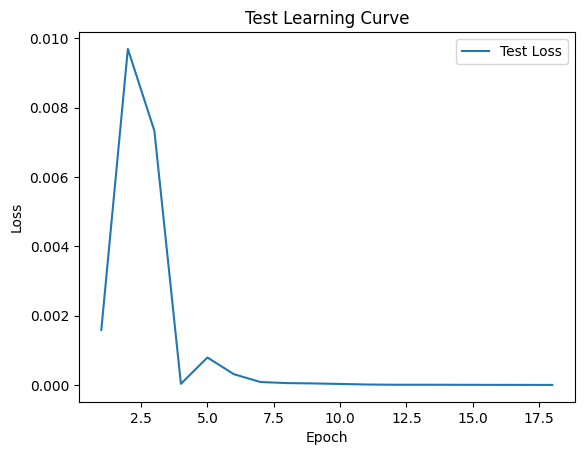


 Epoch: (19/50) Loss = 5.961946953902952e-07

 Epoch: (19/50) Loss_rmse = 0.0007721364381723106

 Epoch: (19/50) R^2 = 0.9997917413711548

 Epoch: (19/50) MAE = 0.0006572306156158447
Spearman correlation coefficient: SignificanceResult(statistic=0.99470612442844, pvalue=1.066971032038608e-94)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207921,

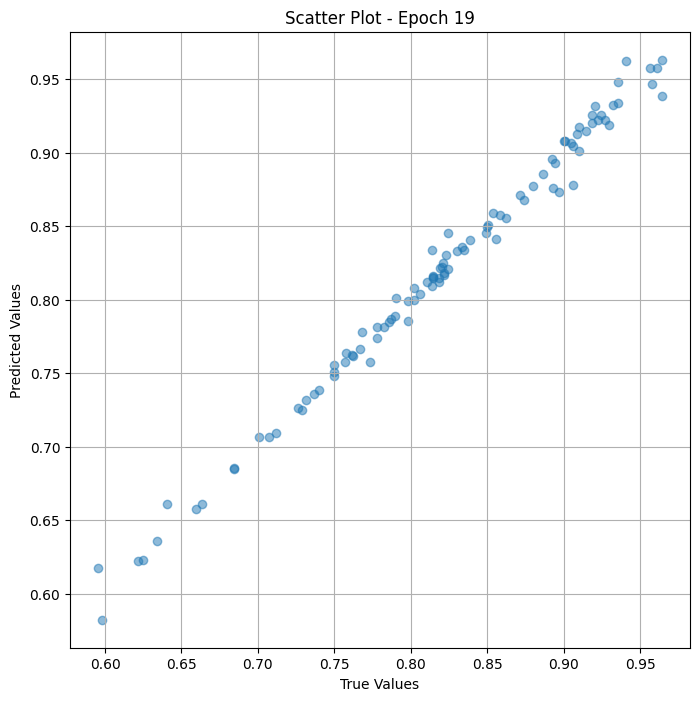

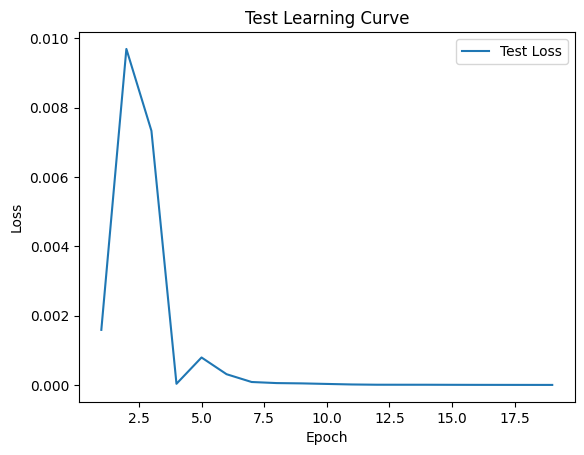


 Epoch: (20/50) Loss = 3.6189970842315233e-07

 Epoch: (20/50) Loss_rmse = 0.0006015810067765415

 Epoch: (20/50) R^2 = 0.9998735785484314

 Epoch: (20/50) MAE = 0.0005477368831634521
Spearman correlation coefficient: SignificanceResult(statistic=0.9953165649973884, pvalue=3.414314940337617e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

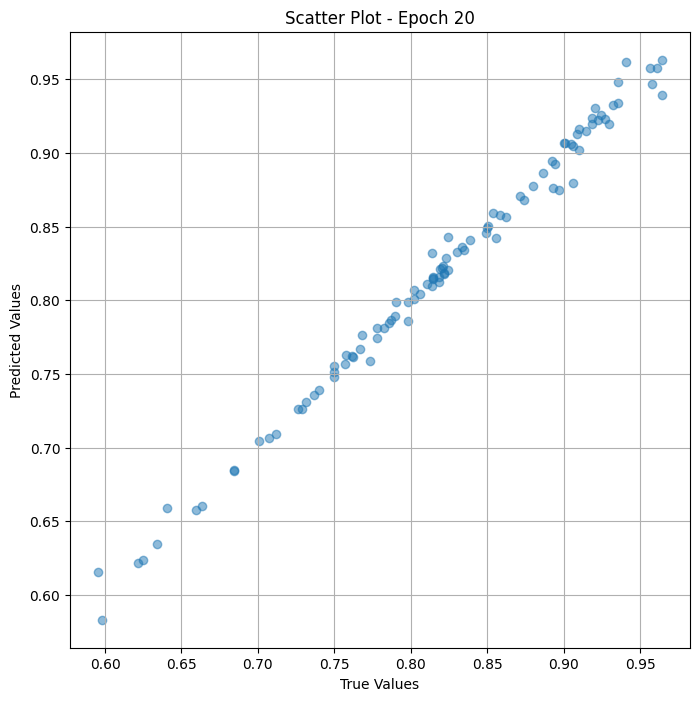

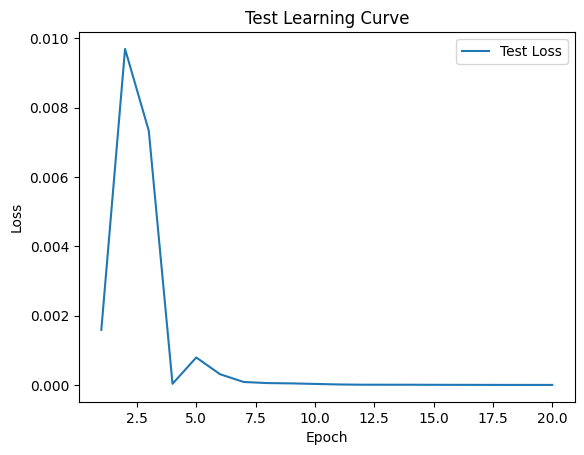


 Epoch: (21/50) Loss = 3.324319379771623e-07

 Epoch: (21/50) Loss_rmse = 0.0005765691166743636

 Epoch: (21/50) R^2 = 0.9998838901519775

 Epoch: (21/50) MAE = 0.0004649609327316284
Spearman correlation coefficient: SignificanceResult(statistic=0.9959202228933485, pvalue=5.279603955111216e-100)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

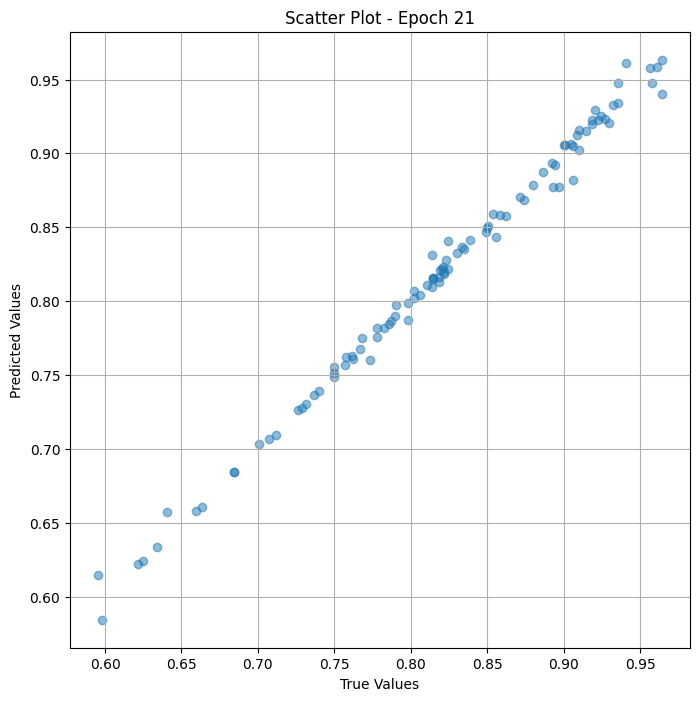

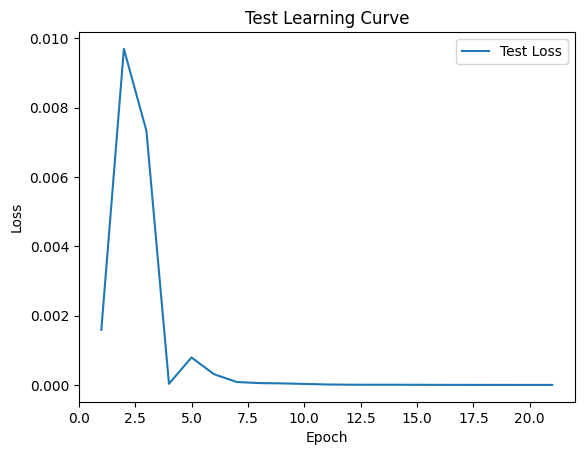


 Epoch: (22/50) Loss = 2.8915215466440713e-07

 Epoch: (22/50) Loss_rmse = 0.0005377287161536515

 Epoch: (22/50) R^2 = 0.9998990297317505

 Epoch: (22/50) MAE = 0.0003707706928253174
Spearman correlation coefficient: SignificanceResult(statistic=0.9962050951588578, pvalue=1.769791823378856e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

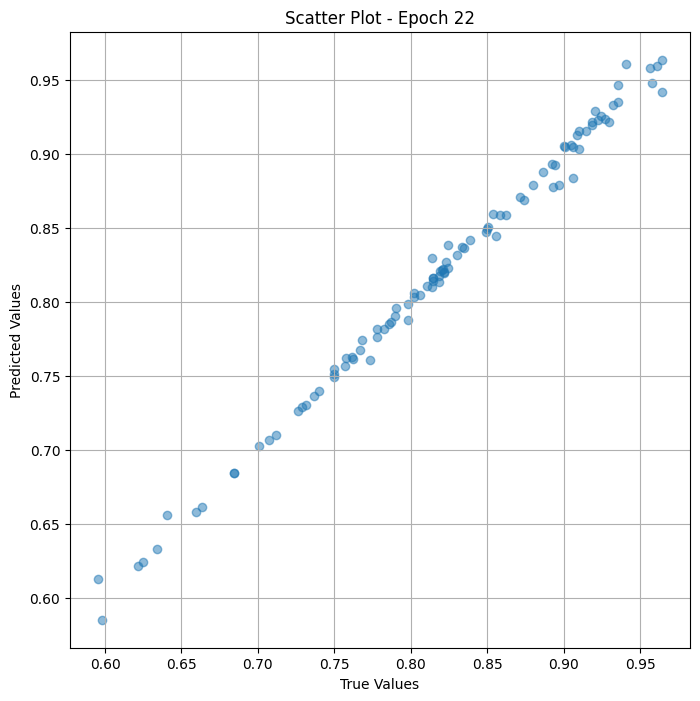

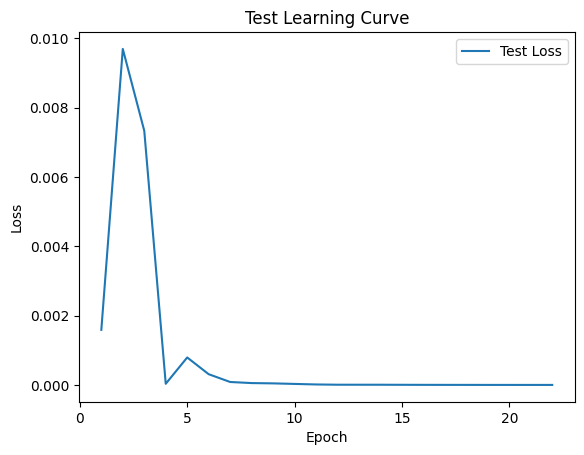


 Epoch: (23/50) Loss = 1.7838951293924765e-07

 Epoch: (23/50) Loss_rmse = 0.00042236183071509004

 Epoch: (23/50) R^2 = 0.9999377131462097

 Epoch: (23/50) MAE = 0.00029428303241729736
Spearman correlation coefficient: SignificanceResult(statistic=0.9966527515760866, pvalue=4.9000407465657396e-104)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9

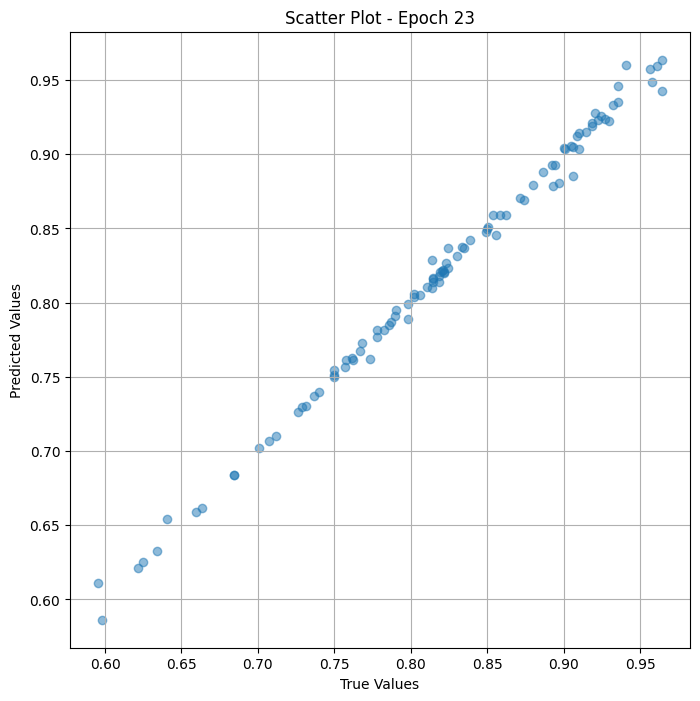

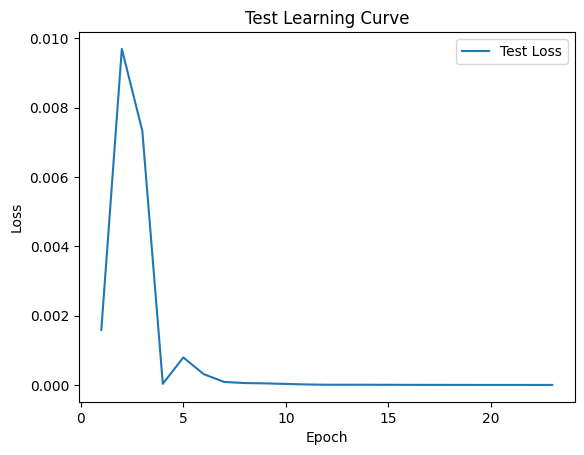


 Epoch: (24/50) Loss = 8.630454573221868e-08

 Epoch: (24/50) Loss_rmse = 0.0002937763638328761

 Epoch: (24/50) R^2 = 0.9999698400497437

 Epoch: (24/50) MAE = 0.00023974478244781494
Spearman correlation coefficient: SignificanceResult(statistic=0.9971004079933155, pvalue=5.808783744527835e-107)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

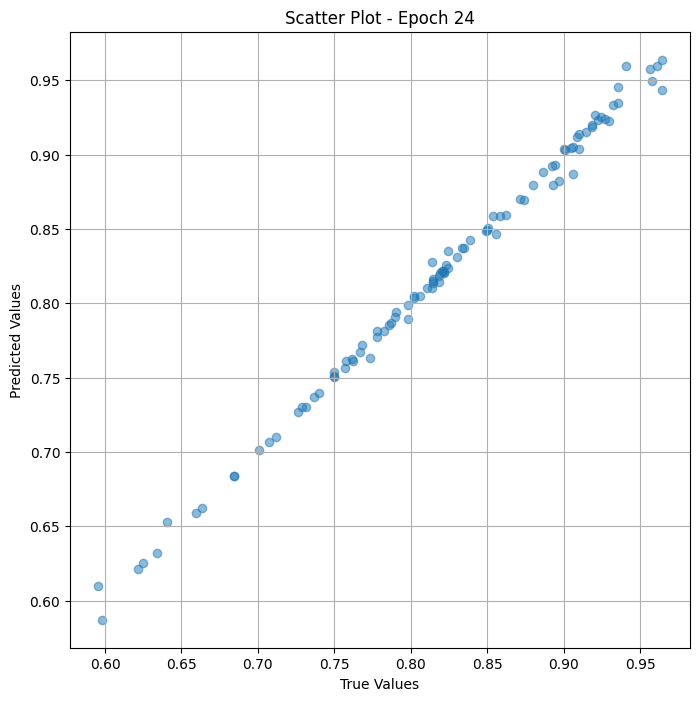

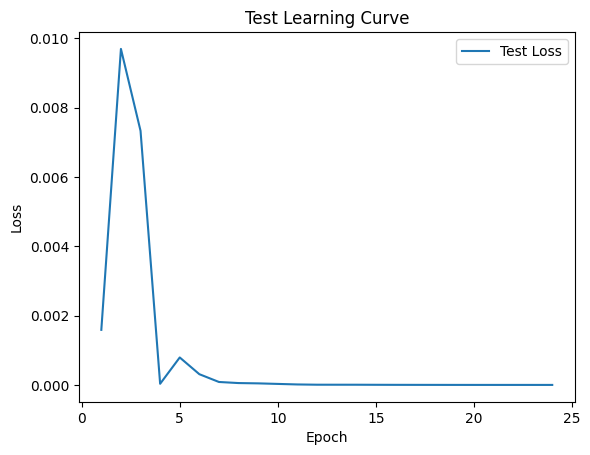


 Epoch: (25/50) Loss = 4.635230510530164e-08

 Epoch: (25/50) Loss_rmse = 0.00021529584773816168

 Epoch: (25/50) R^2 = 0.9999837875366211

 Epoch: (25/50) MAE = 0.00018361210823059082
Spearman correlation coefficient: SignificanceResult(statistic=0.9973445842208948, pvalue=9.351291145710181e-109)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

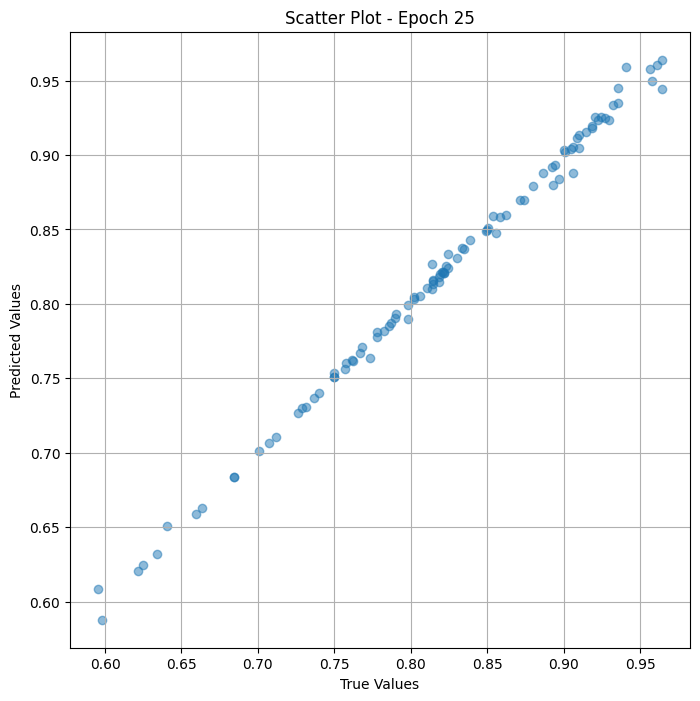

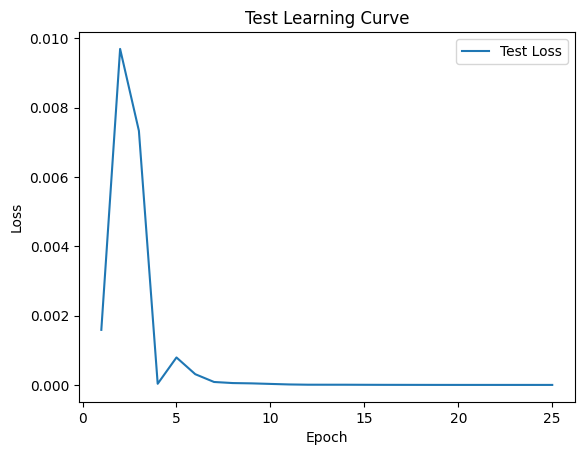


 Epoch: (26/50) Loss = 4.072940740229569e-08

 Epoch: (26/50) Loss_rmse = 0.00020181527361273766

 Epoch: (26/50) R^2 = 0.9999857544898987

 Epoch: (26/50) MAE = 0.00015357136726379395
Spearman correlation coefficient: SignificanceResult(statistic=0.9976565871783573, pvalue=2.6460103640182887e-111)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92

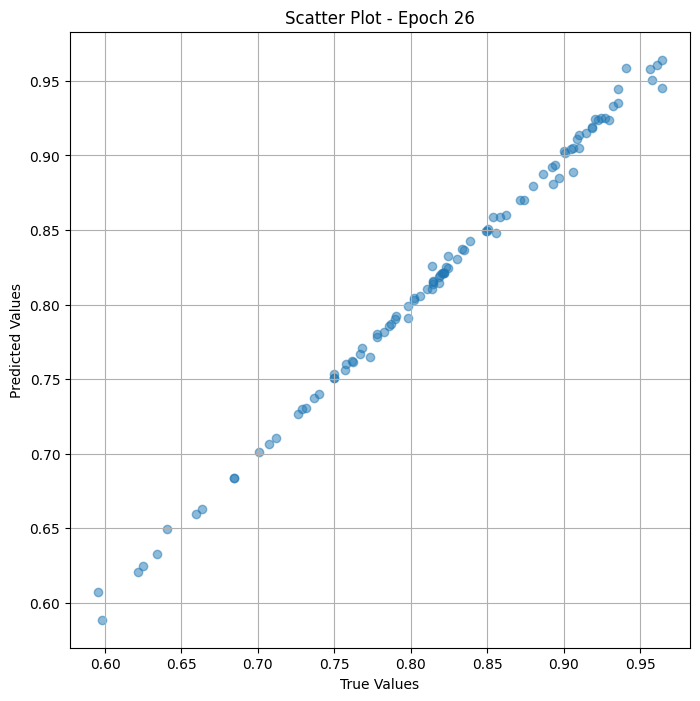

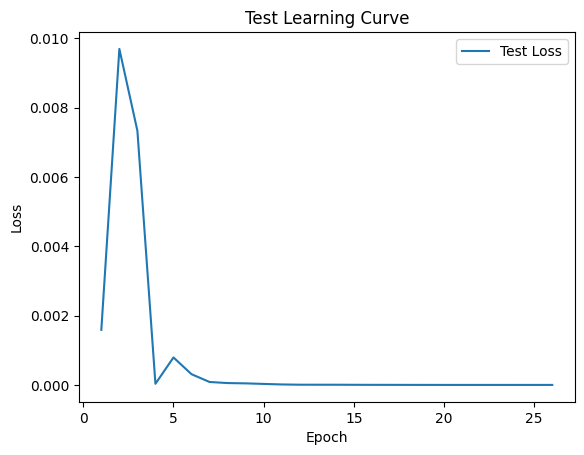


 Epoch: (27/50) Loss = 4.3748158873313514e-08

 Epoch: (27/50) Loss_rmse = 0.0002091606002068147

 Epoch: (27/50) R^2 = 0.9999847412109375

 Epoch: (27/50) MAE = 0.00016966462135314941
Spearman correlation coefficient: SignificanceResult(statistic=0.997778675292147, pvalue=2.1461471426181774e-112)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

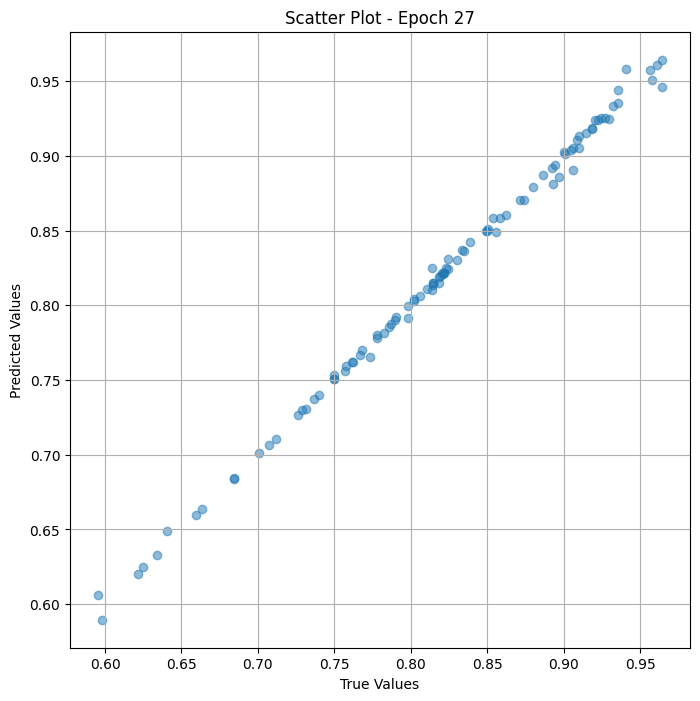

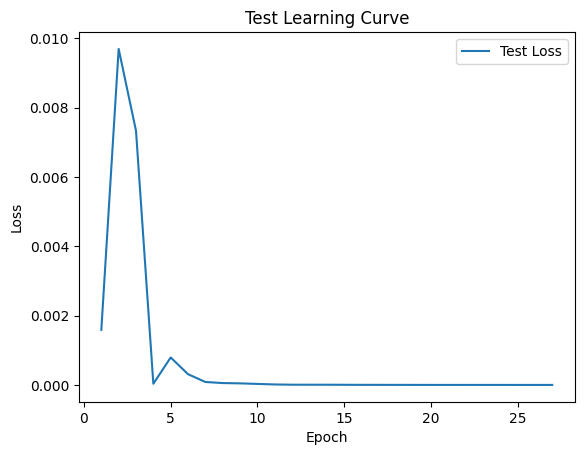


 Epoch: (28/50) Loss = 3.627990707855133e-08

 Epoch: (28/50) Loss_rmse = 0.00019047285604756325

 Epoch: (28/50) R^2 = 0.9999873042106628

 Epoch: (28/50) MAE = 0.00016307830810546875
Spearman correlation coefficient: SignificanceResult(statistic=0.998382333188107, pvalue=7.321321013514892e-119)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

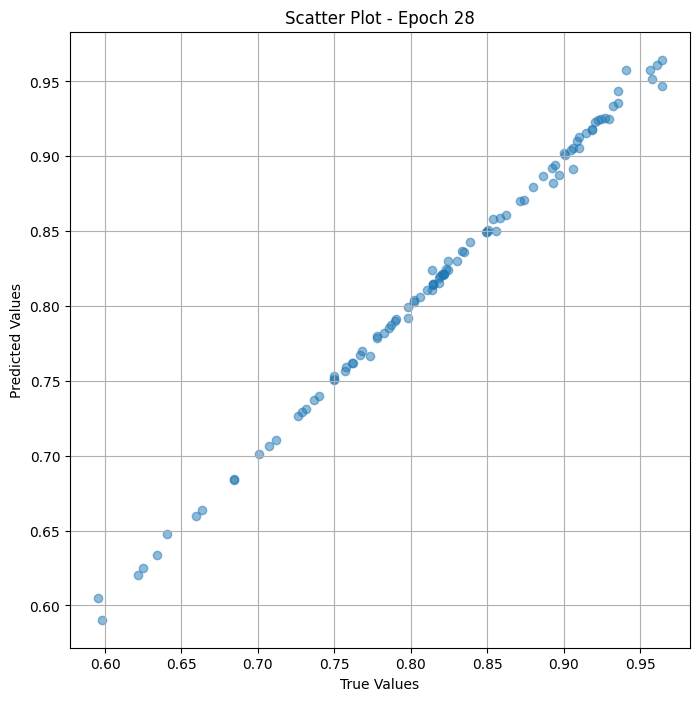

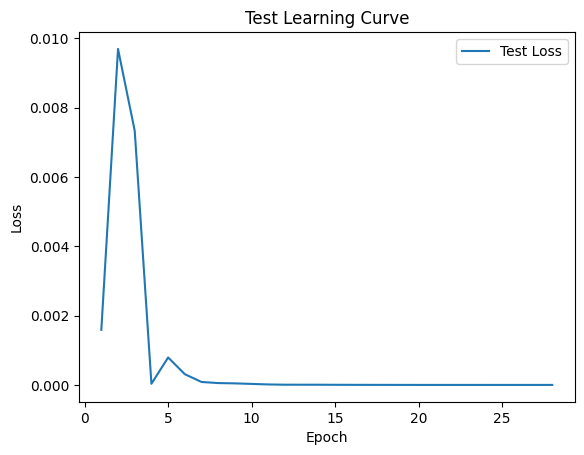


 Epoch: (29/50) Loss = 2.4868874959338427e-08

 Epoch: (29/50) Loss_rmse = 0.00015769868332426995

 Epoch: (29/50) R^2 = 0.9999912977218628

 Epoch: (29/50) MAE = 0.0001262277364730835
Spearman correlation coefficient: SignificanceResult(statistic=0.9985586826858033, pvalue=3.237653417968189e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

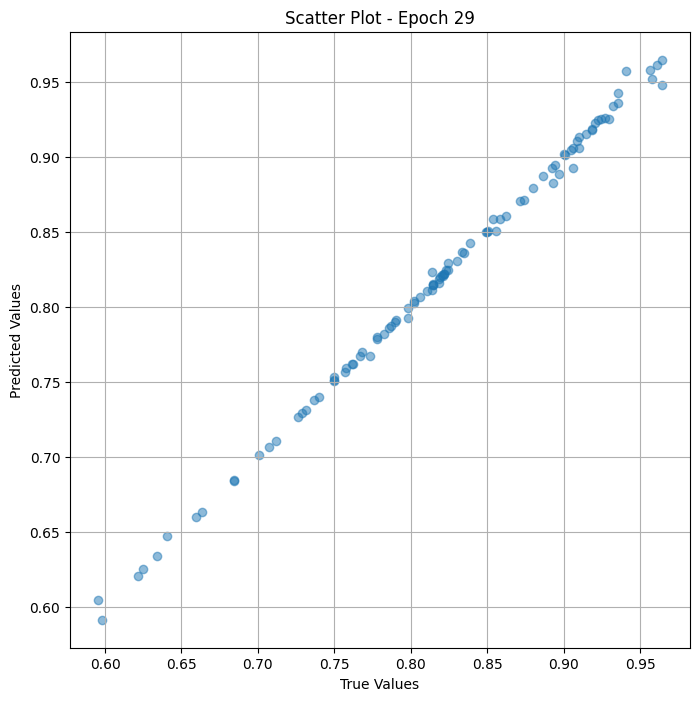

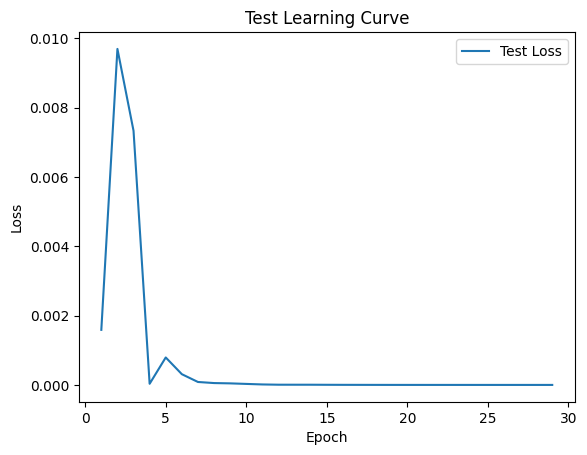


 Epoch: (30/50) Loss = 1.826759898904129e-08

 Epoch: (30/50) Loss_rmse = 0.00013515767932403833

 Epoch: (30/50) R^2 = 0.999993622303009

 Epoch: (30/50) MAE = 0.00010170042514801025
Spearman correlation coefficient: SignificanceResult(statistic=0.9985722480317798, pvalue=2.0765472846322756e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

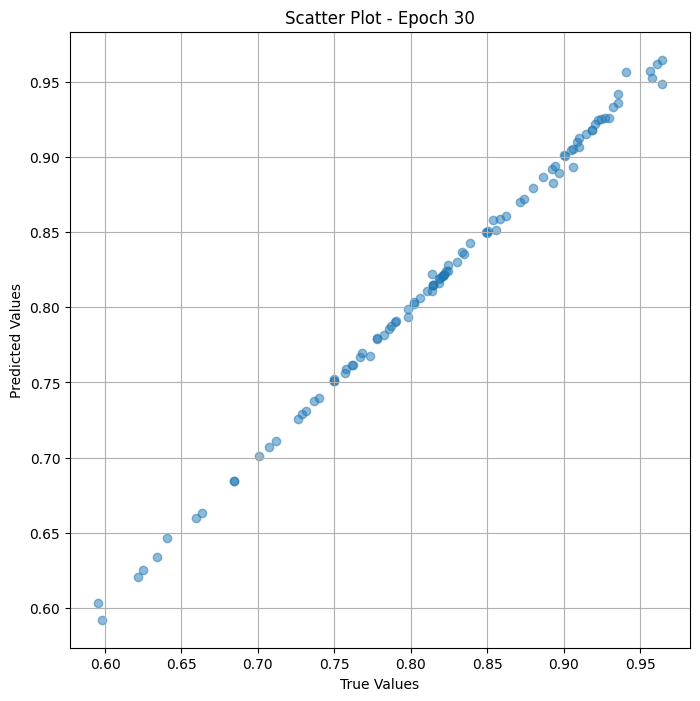

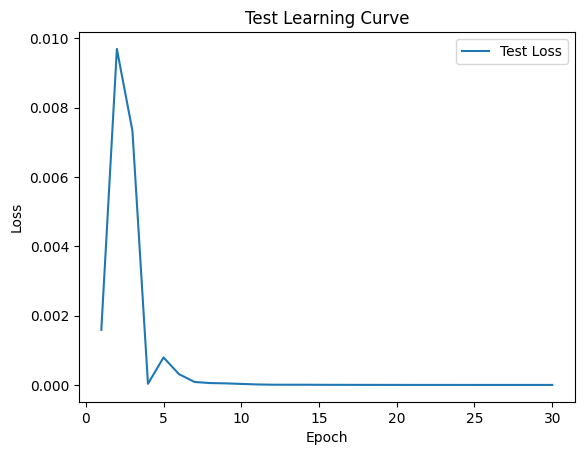


 Epoch: (31/50) Loss = 1.750341382944498e-08

 Epoch: (31/50) Loss_rmse = 0.0001323004689766094

 Epoch: (31/50) R^2 = 0.9999938607215881

 Epoch: (31/50) MAE = 0.00011737644672393799
Spearman correlation coefficient: SignificanceResult(statistic=0.9987011188185578, pvalue=2.441664441562291e-123)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

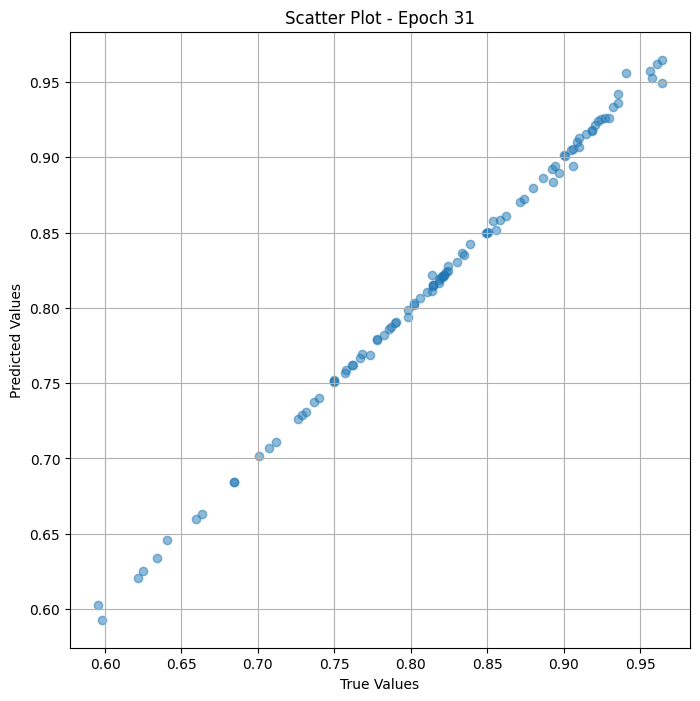

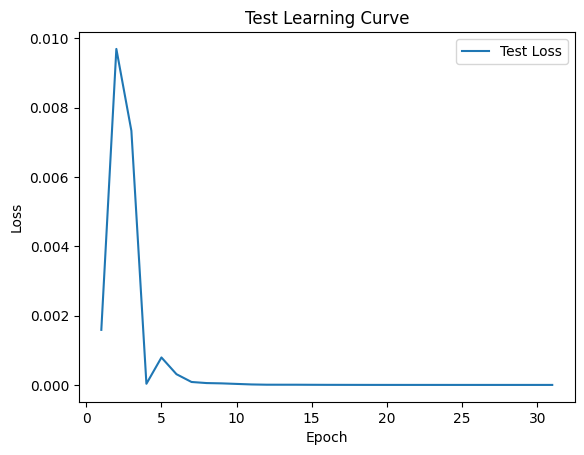


 Epoch: (32/50) Loss = 1.9192743394569334e-08

 Epoch: (32/50) Loss_rmse = 0.00013853787095285952

 Epoch: (32/50) R^2 = 0.9999933242797852

 Epoch: (32/50) MAE = 0.000131264328956604
Spearman correlation coefficient: SignificanceResult(statistic=0.9990131217760205, pvalue=6.072449354739317e-129)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

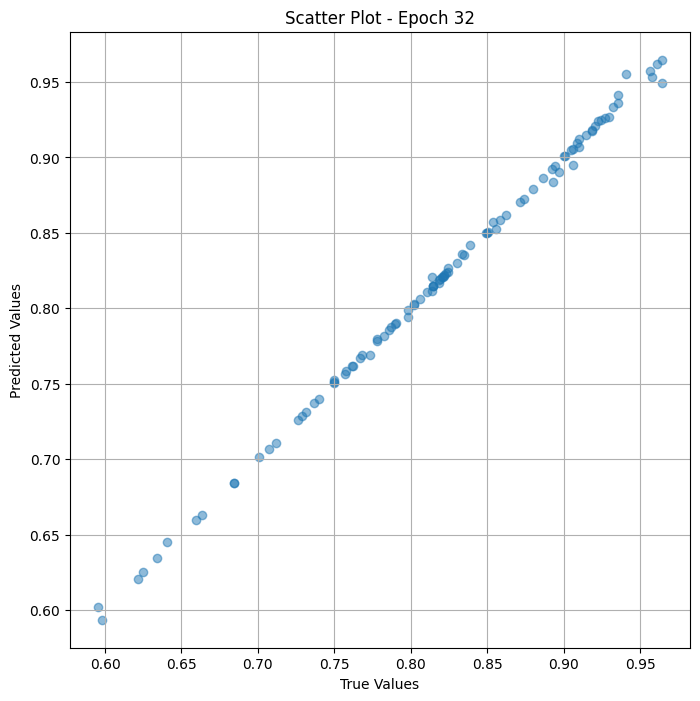

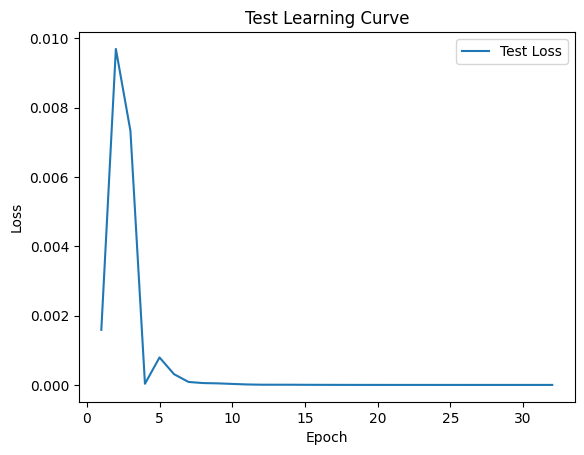


 Epoch: (33/50) Loss = 1.7901950144505463e-08

 Epoch: (33/50) Loss_rmse = 0.00013379816664382815

 Epoch: (33/50) R^2 = 0.9999937415122986

 Epoch: (33/50) MAE = 0.00012694299221038818
Spearman correlation coefficient: SignificanceResult(statistic=0.9991284272168218, pvalue=1.7716444978700796e-131)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9

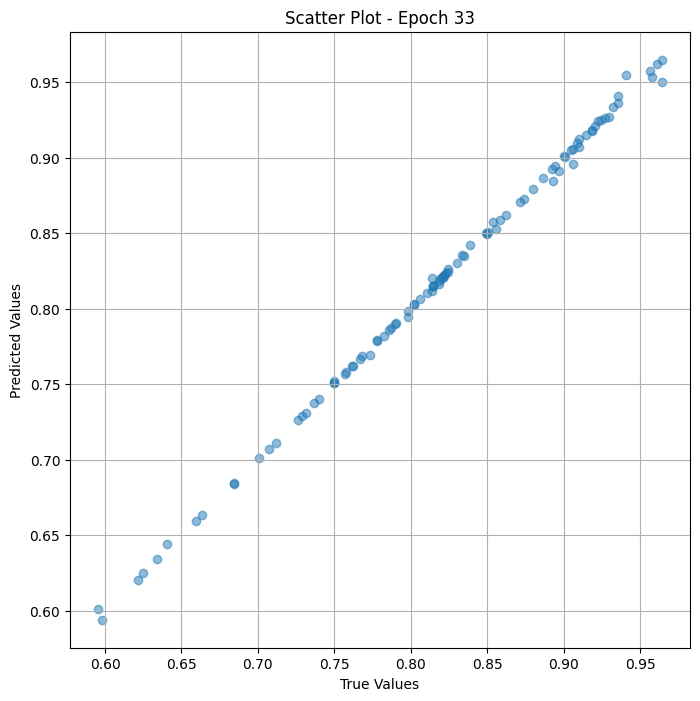

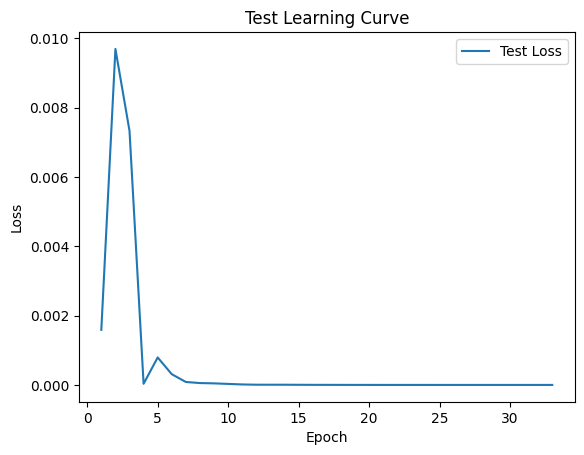


 Epoch: (34/50) Loss = 1.3934220888245363e-08

 Epoch: (34/50) Loss_rmse = 0.00011804330279119313

 Epoch: (34/50) R^2 = 0.9999951124191284

 Epoch: (34/50) MAE = 0.00010916590690612793
Spearman correlation coefficient: SignificanceResult(statistic=0.9991284272168218, pvalue=1.7716444978700796e-131)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9

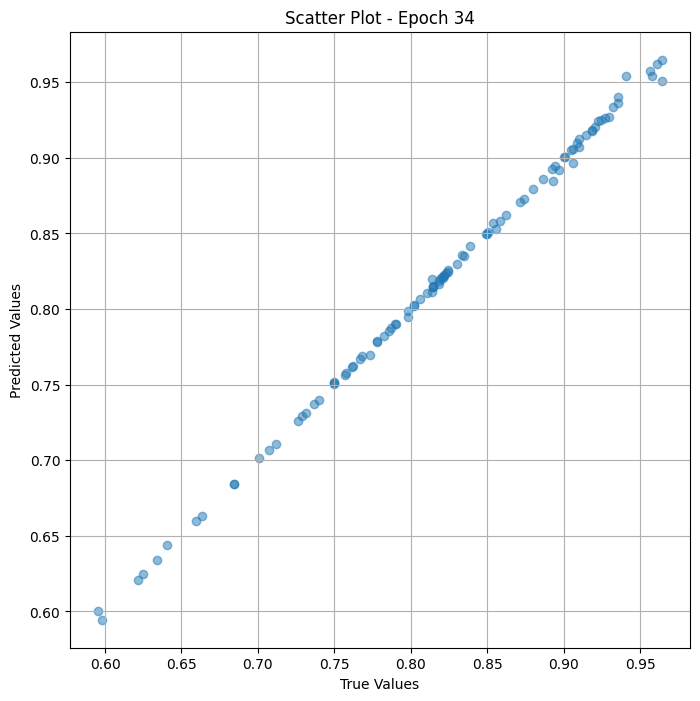

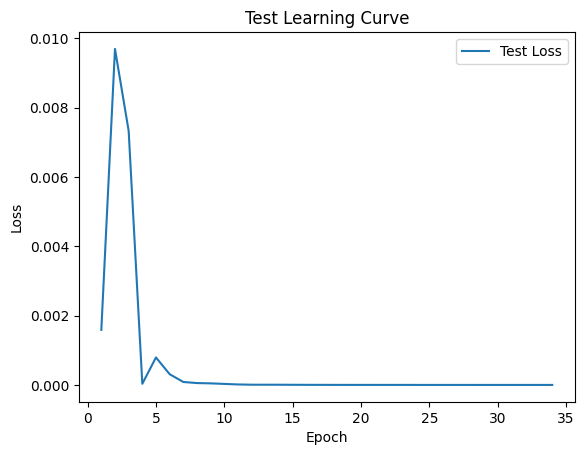


 Epoch: (35/50) Loss = 9.982511706141395e-09

 Epoch: (35/50) Loss_rmse = 9.991251863539219e-05

 Epoch: (35/50) R^2 = 0.999996542930603

 Epoch: (35/50) MAE = 9.019672870635986e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9992844286955531, pvalue=1.6761697960304057e-135)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

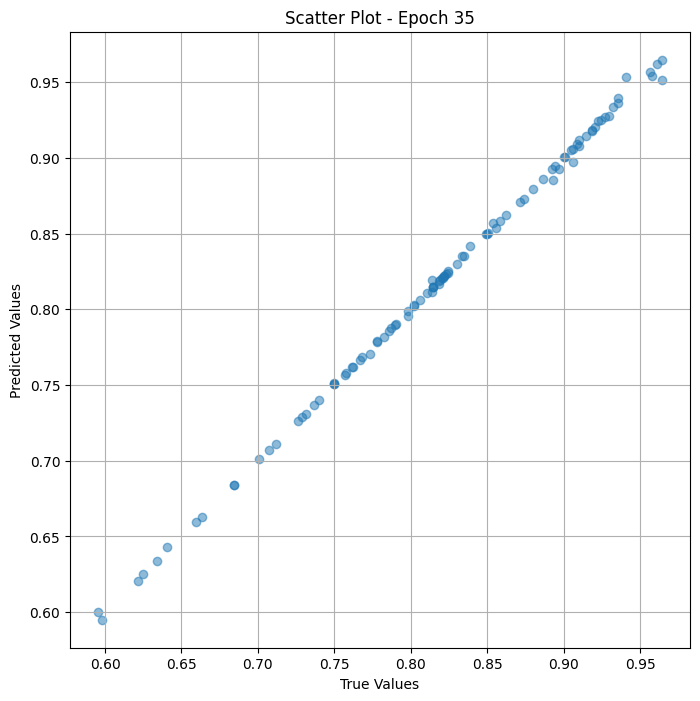

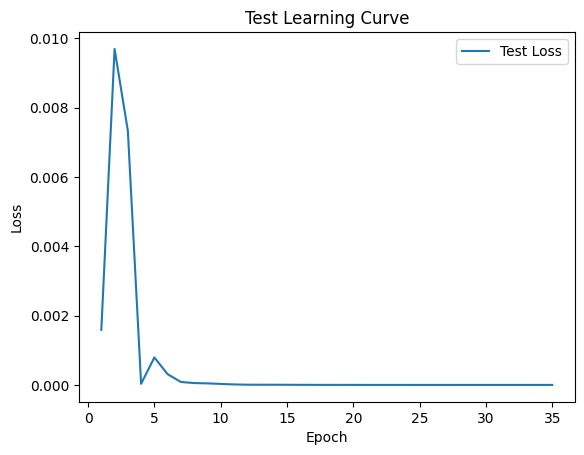


 Epoch: (36/50) Loss = 6.9772108091115115e-09

 Epoch: (36/50) Loss_rmse = 8.352970326086506e-05

 Epoch: (36/50) R^2 = 0.9999975562095642

 Epoch: (36/50) MAE = 7.46995210647583e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9992979940415296, pvalue=6.819949956245997e-136)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

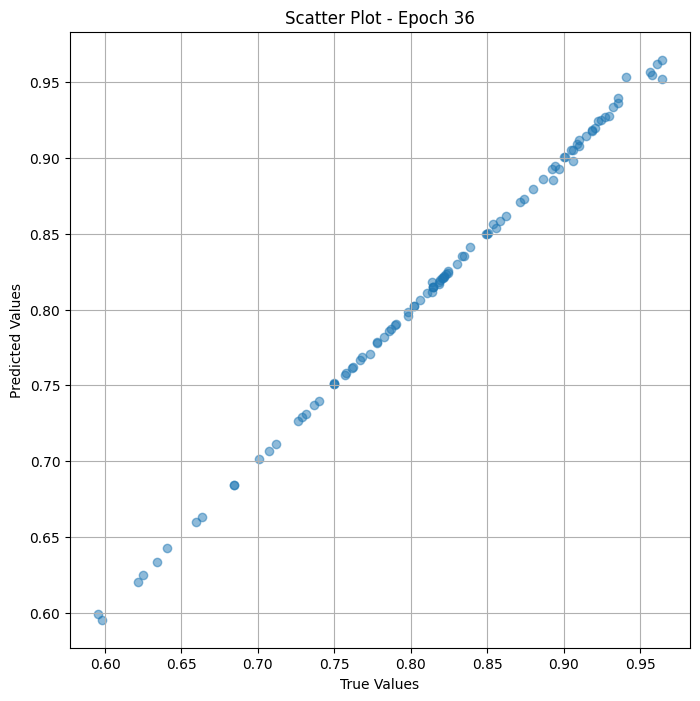

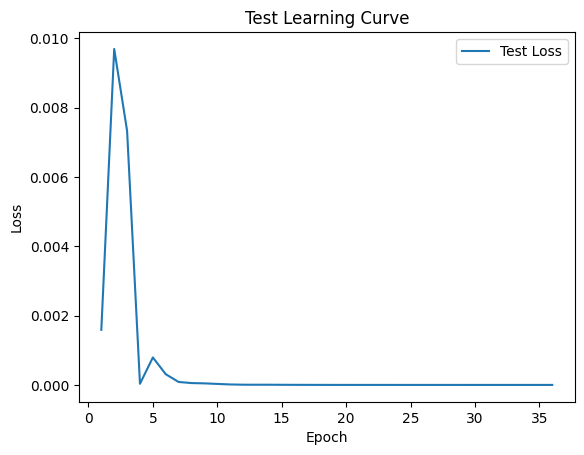


 Epoch: (37/50) Loss = 4.925749585993344e-09

 Epoch: (37/50) Loss_rmse = 7.018368341960013e-05

 Epoch: (37/50) R^2 = 0.9999982714653015

 Epoch: (37/50) MAE = 6.182491779327393e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9994268648283077, pvalue=4.955715292041346e-140)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

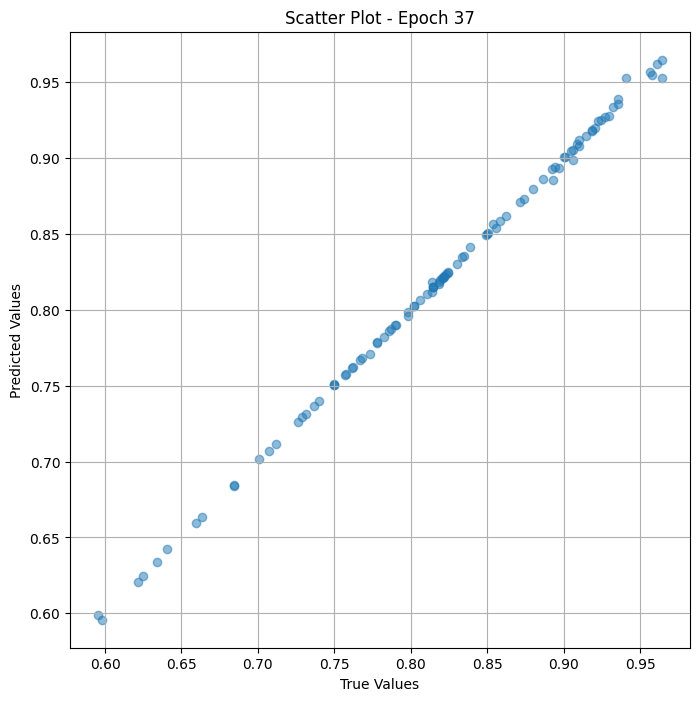

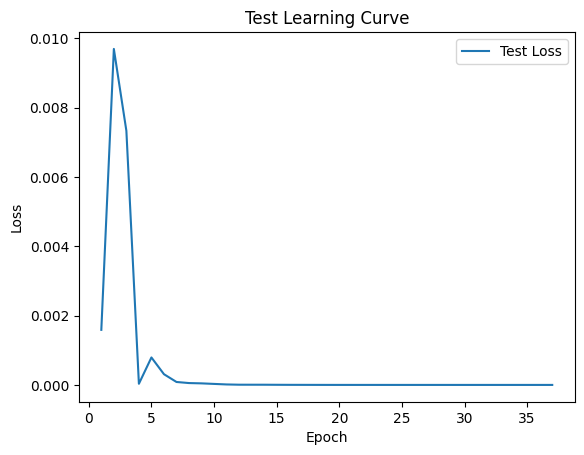


 Epoch: (38/50) Loss = 3.765658007637285e-09

 Epoch: (38/50) Loss_rmse = 6.13649608567357e-05

 Epoch: (38/50) R^2 = 0.9999986886978149

 Epoch: (38/50) MAE = 5.27501106262207e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9994404301742843, pvalue=1.6080839701118713e-140)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

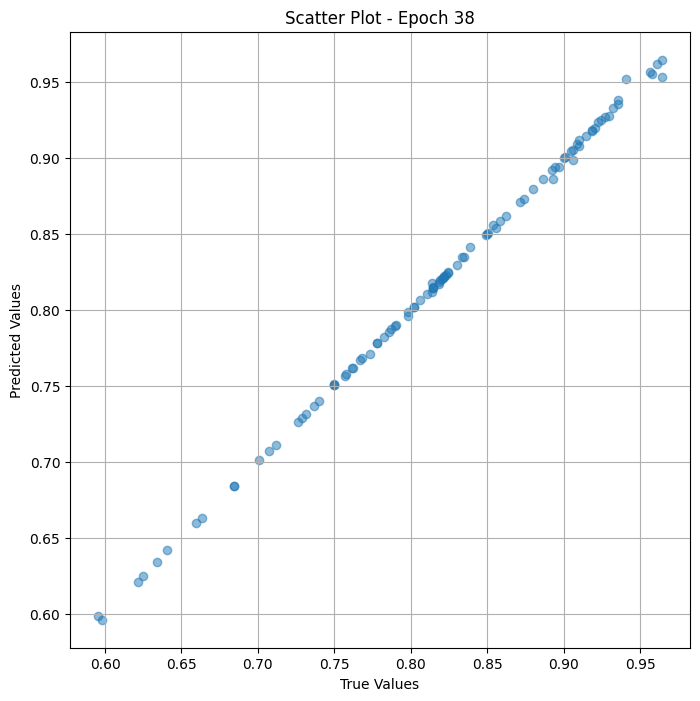

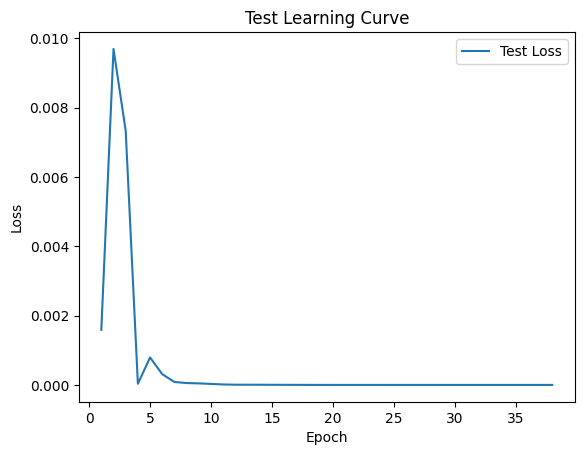


 Epoch: (39/50) Loss = 3.3884672845374553e-09

 Epoch: (39/50) Loss_rmse = 5.8210542192682624e-05

 Epoch: (39/50) R^2 = 0.9999988079071045

 Epoch: (39/50) MAE = 5.023181438446045e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9995218222501441, pvalue=9.969045698930967e-144)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

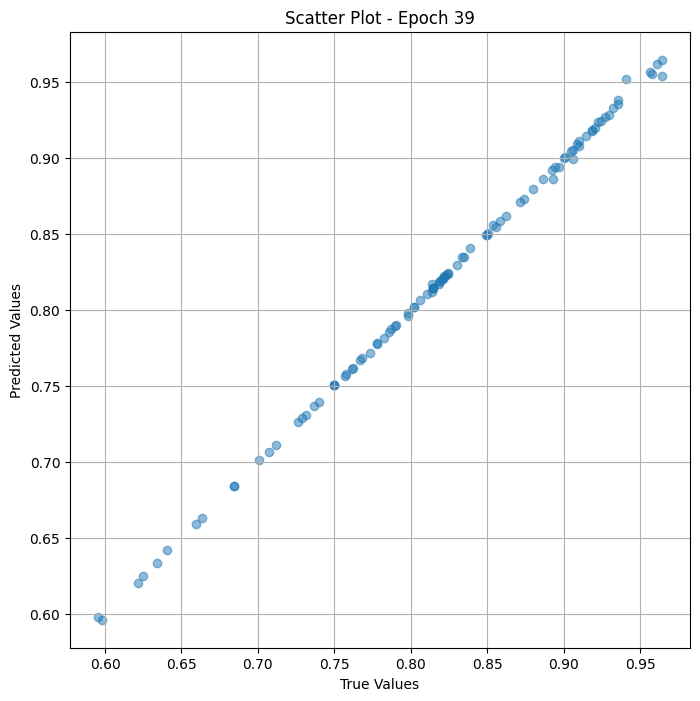

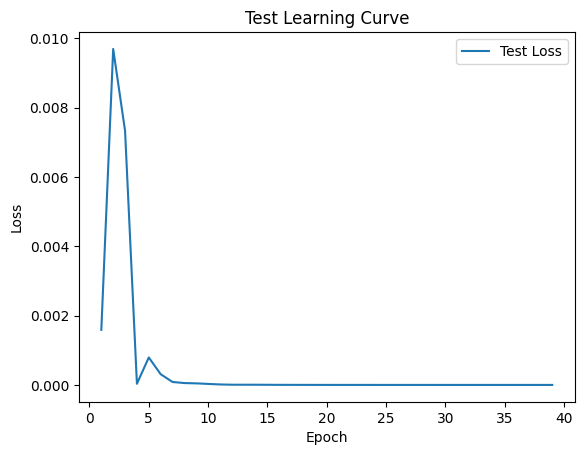


 Epoch: (40/50) Loss = 3.4475871046879547e-09

 Epoch: (40/50) Loss_rmse = 5.8716155763249844e-05

 Epoch: (40/50) R^2 = 0.9999988079071045

 Epoch: (40/50) MAE = 5.233287811279297e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9995353875961208, pvalue=2.578420761213307e-144)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

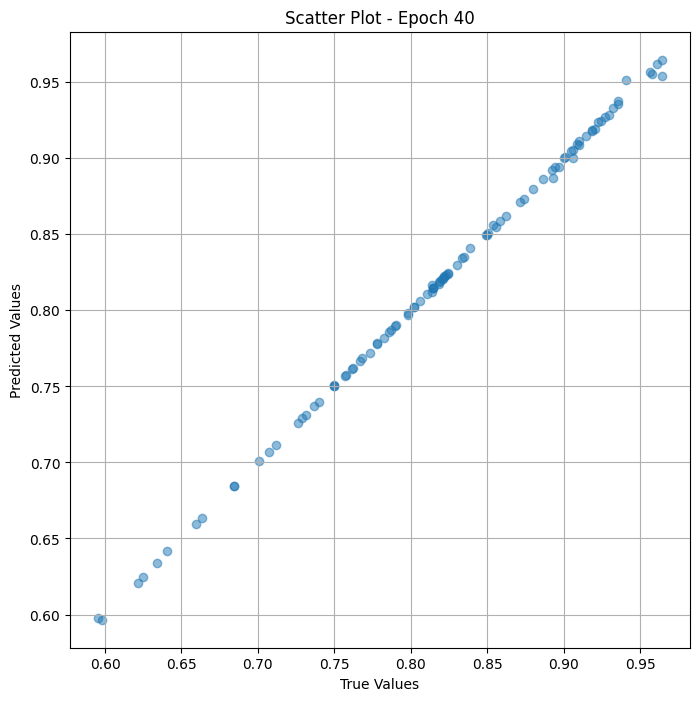

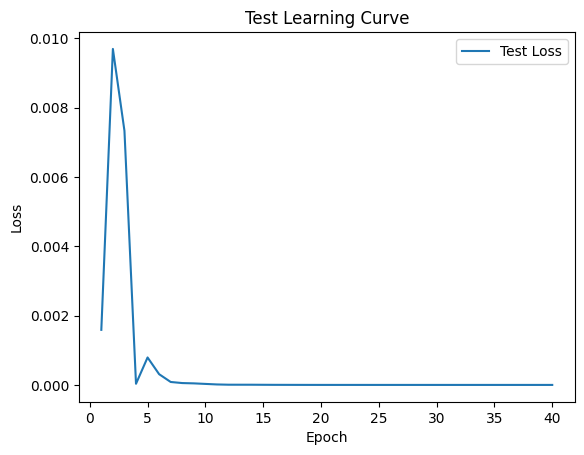


 Epoch: (41/50) Loss = 3.4582390284754183e-09

 Epoch: (41/50) Loss_rmse = 5.880679236724973e-05

 Epoch: (41/50) R^2 = 0.9999988079071045

 Epoch: (41/50) MAE = 5.3301453590393066e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9995896489800272, pvalue=7.532277645321742e-147)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

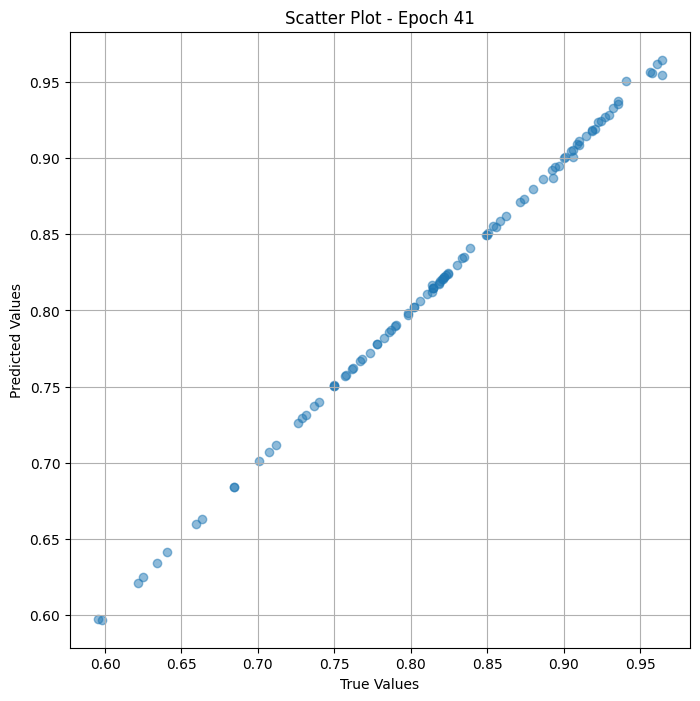

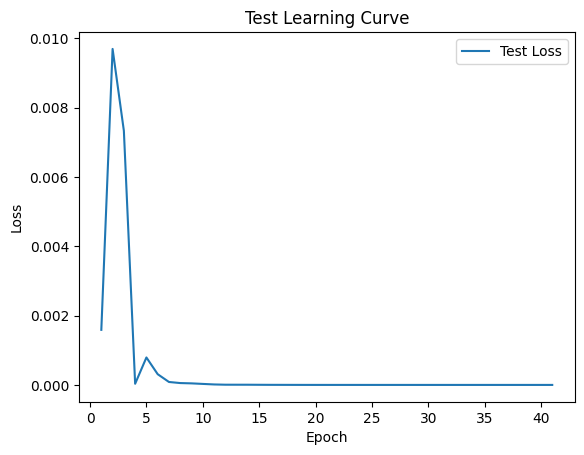


 Epoch: (42/50) Loss = 3.0796512007214005e-09

 Epoch: (42/50) Loss_rmse = 5.54946054762695e-05

 Epoch: (42/50) R^2 = 0.999998927116394

 Epoch: (42/50) MAE = 4.972517490386963e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996303450179571, pvalue=5.564851981664328e-149)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

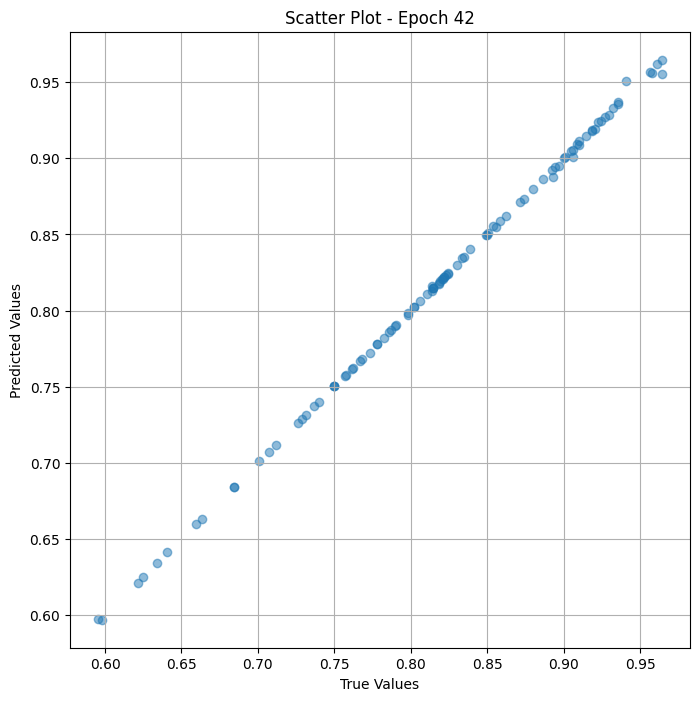

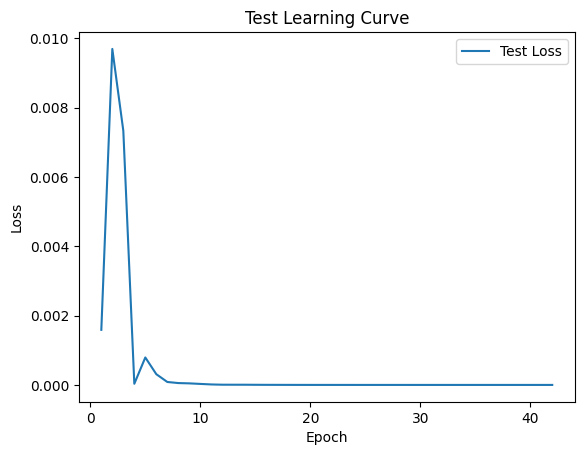


 Epoch: (43/50) Loss = 2.52217713381242e-09

 Epoch: (43/50) Loss_rmse = 5.022128243581392e-05

 Epoch: (43/50) R^2 = 0.9999991059303284

 Epoch: (43/50) MAE = 4.337728023529053e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996439103639339, pvalue=9.603654063994725e-150)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920792

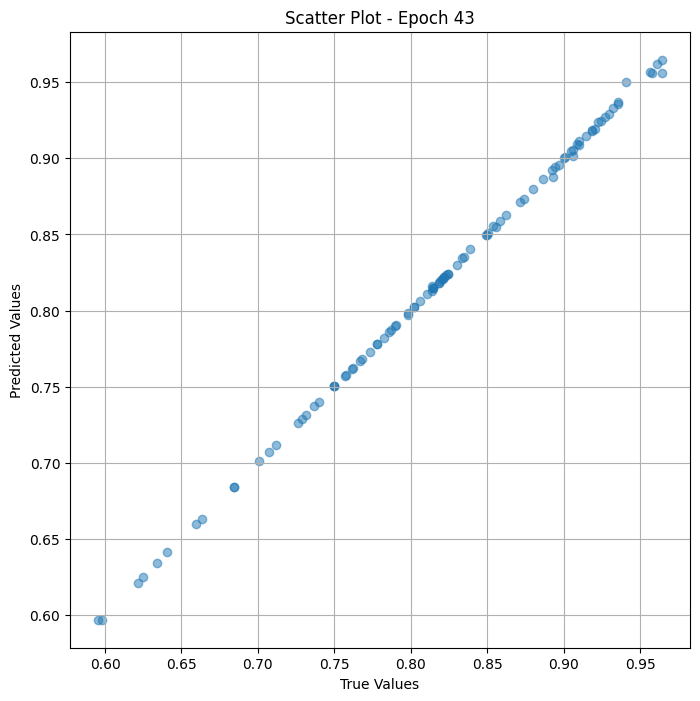

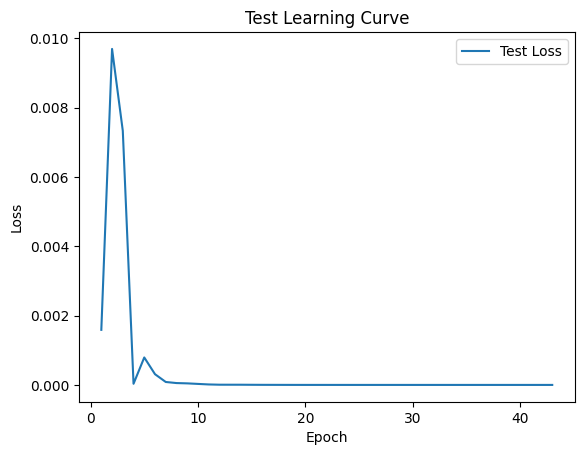


 Epoch: (44/50) Loss = 2.087131356631744e-09

 Epoch: (44/50) Loss_rmse = 4.5685133954975754e-05

 Epoch: (44/50) R^2 = 0.9999992847442627

 Epoch: (44/50) MAE = 3.771483898162842e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996574757099104, pvalue=1.5480149128390505e-150)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

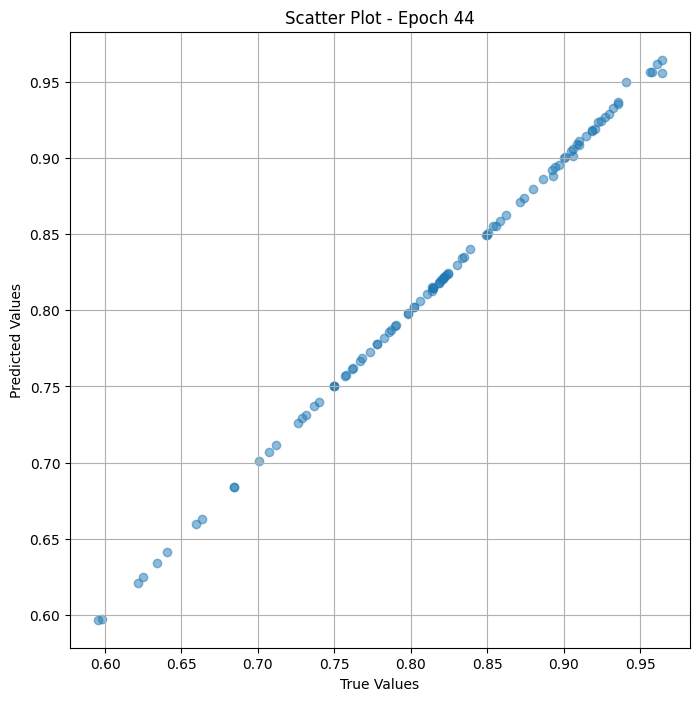

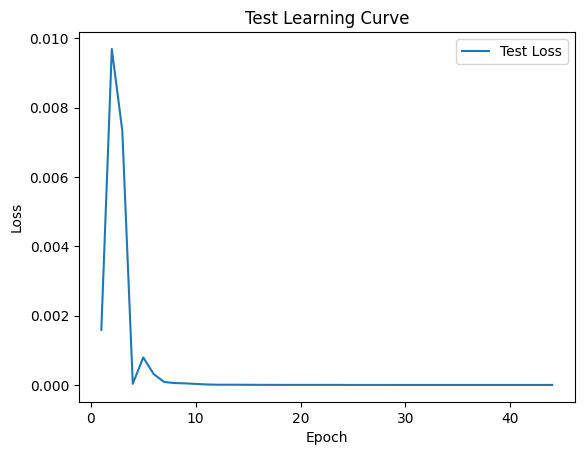


 Epoch: (45/50) Loss = 1.781298664127462e-09

 Epoch: (45/50) Loss_rmse = 4.220543269184418e-05

 Epoch: (45/50) R^2 = 0.9999994039535522

 Epoch: (45/50) MAE = 3.3527612686157227e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996913890748519, pvalue=1.1533024170410869e-152)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

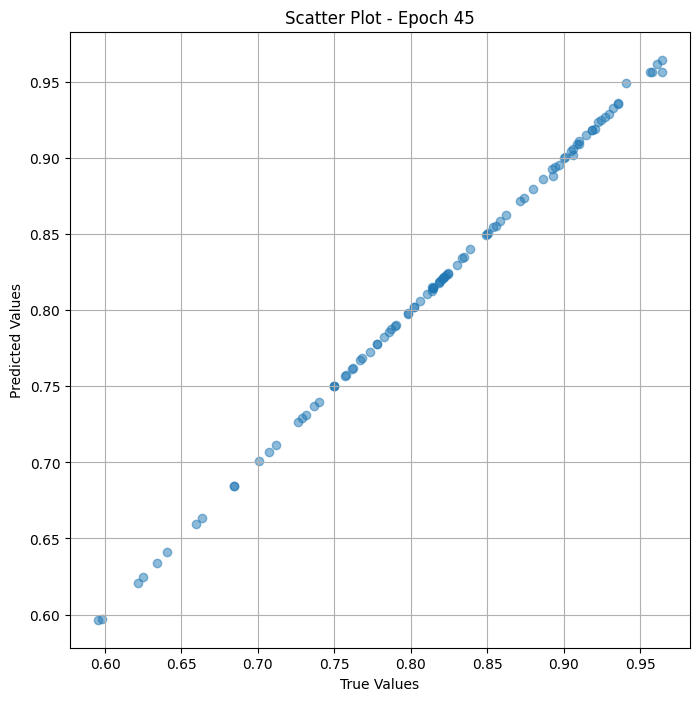

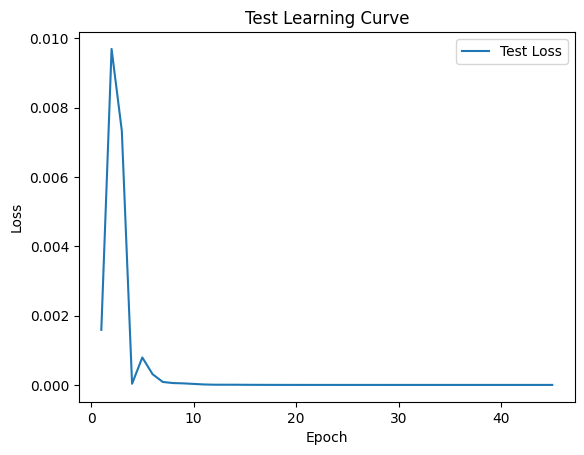


 Epoch: (46/50) Loss = 1.5179839607526446e-09

 Epoch: (46/50) Loss_rmse = 3.896131238434464e-05

 Epoch: (46/50) R^2 = 0.999999463558197

 Epoch: (46/50) MAE = 2.9921531677246094e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9997388677857701, pvalue=4.4928085833194736e-156)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.920

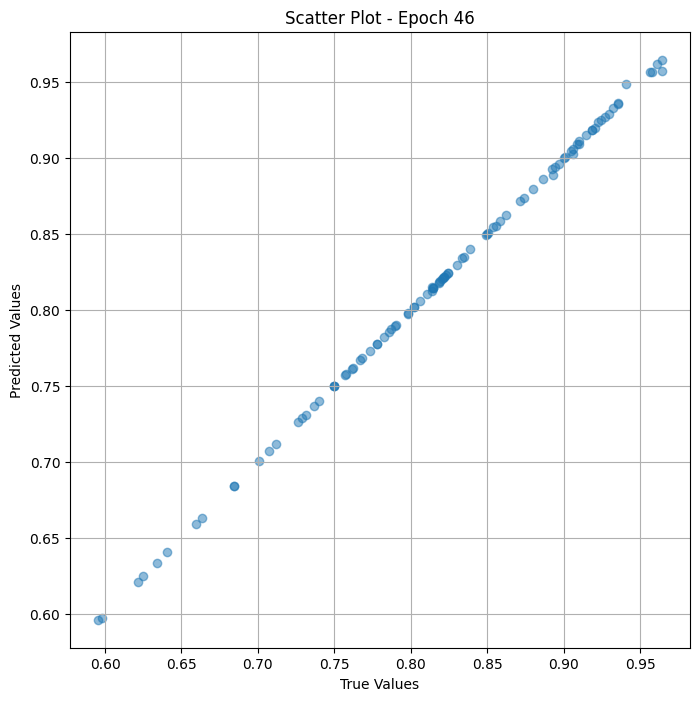

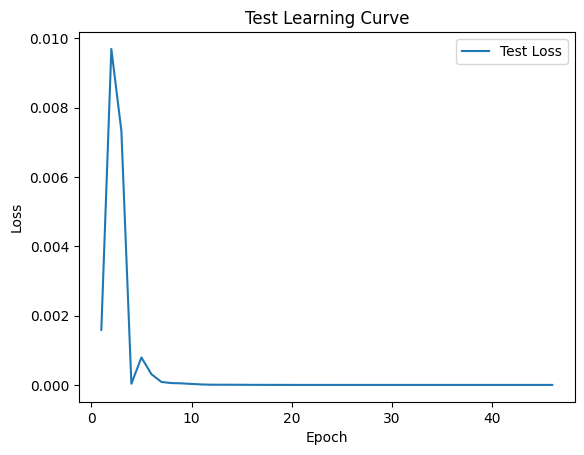


 Epoch: (47/50) Loss = 1.2613092792435054e-09

 Epoch: (47/50) Loss_rmse = 3.551491681719199e-05

 Epoch: (47/50) R^2 = 0.9999995827674866

 Epoch: (47/50) MAE = 2.6673078536987305e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9997795638237, pvalue=1.5659202285888623e-159)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

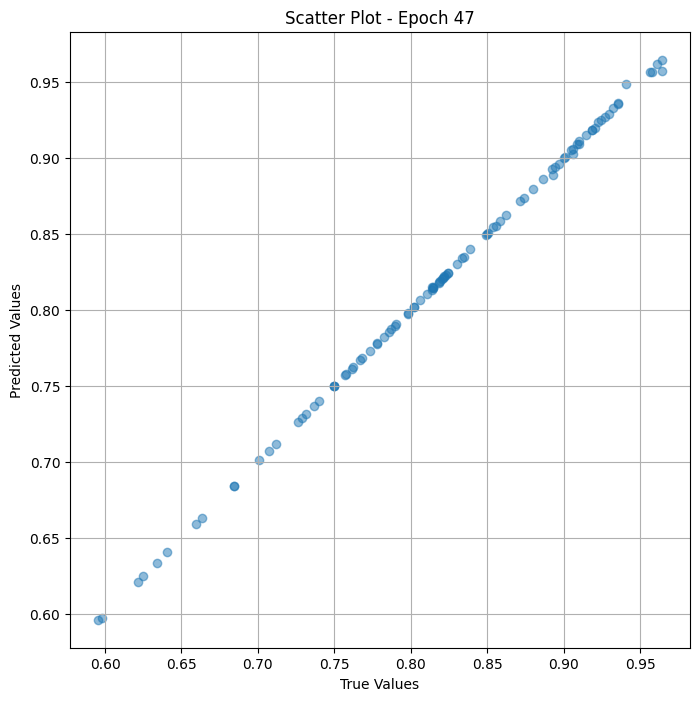

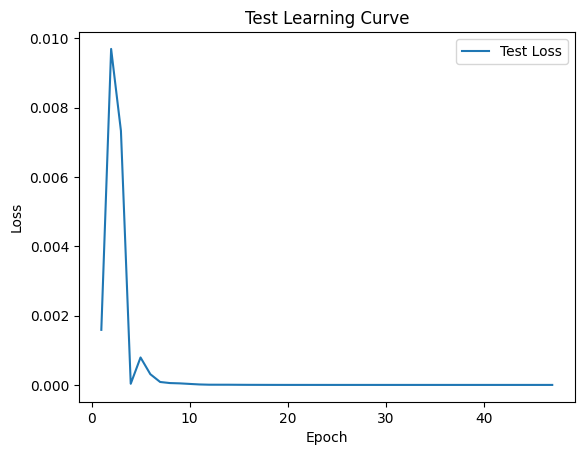


 Epoch: (48/50) Loss = 1.0412275486260114e-09

 Epoch: (48/50) Loss_rmse = 3.2268057111650705e-05

 Epoch: (48/50) R^2 = 0.9999996423721313

 Epoch: (48/50) MAE = 2.4080276489257812e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9997795638237, pvalue=1.5659202285888623e-159)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

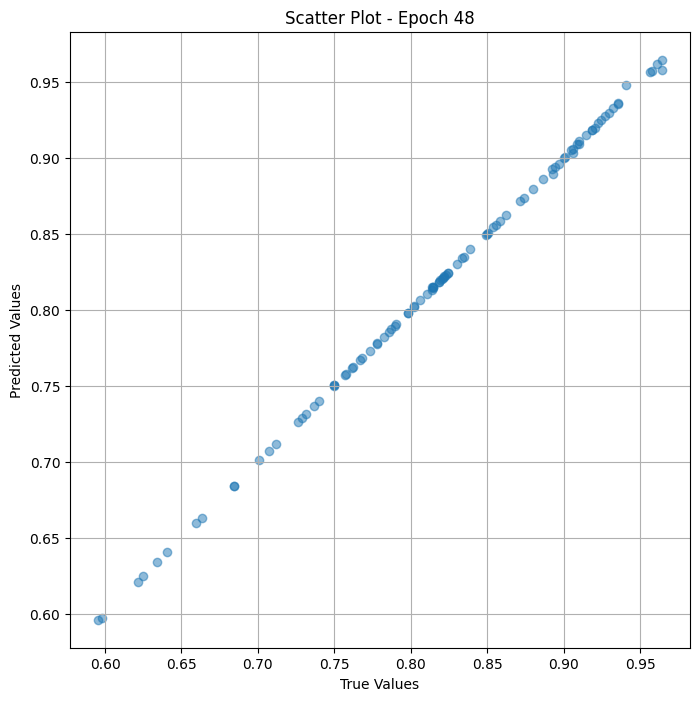

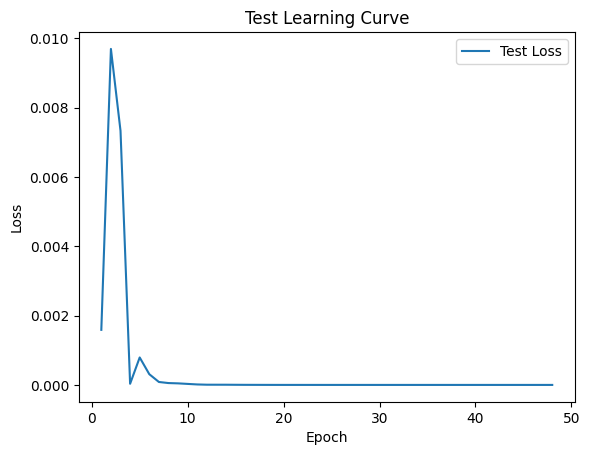


 Epoch: (49/50) Loss = 8.694049924429237e-10

 Epoch: (49/50) Loss_rmse = 2.9485674531315453e-05

 Epoch: (49/50) R^2 = 0.9999997019767761

 Epoch: (49/50) MAE = 2.212822437286377e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998134771886418, pvalue=6.09829306753389e-163)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.92079

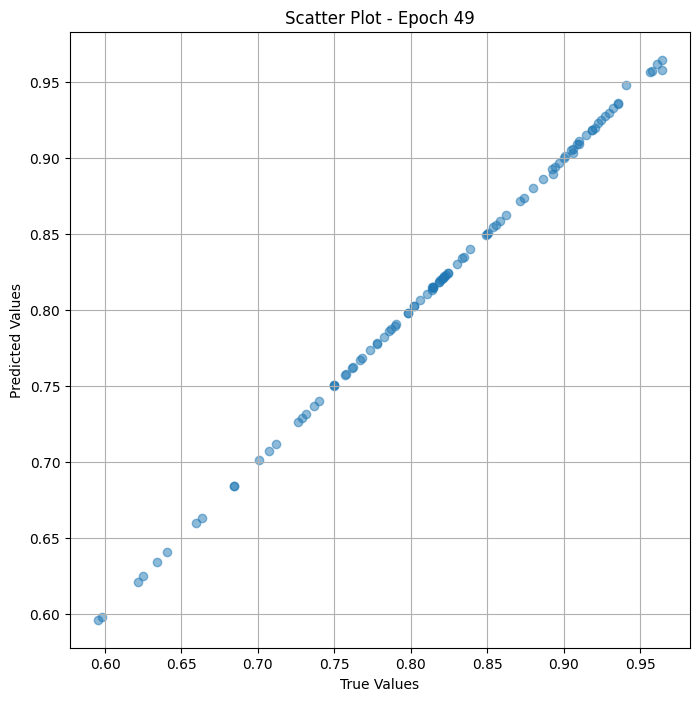

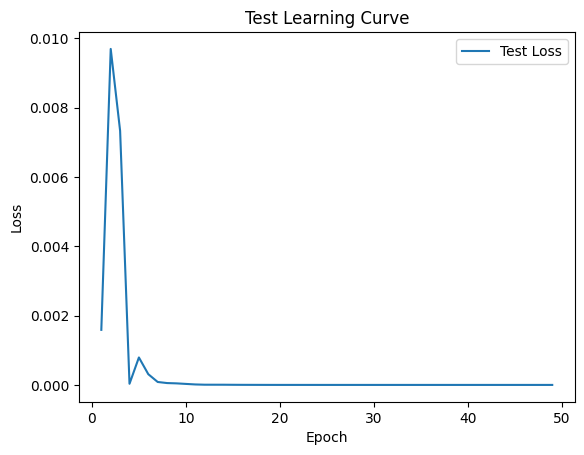


 Epoch: (50/50) Loss = 7.342340069271813e-10

 Epoch: (50/50) Loss_rmse = 2.7096752091892995e-05

 Epoch: (50/50) R^2 = 0.9999997615814209

 Epoch: (50/50) MAE = 2.0325183868408203e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998134771886418, pvalue=6.09829306753389e-163)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.94067794, 0.8942308, 0.5979381, 0.65957445, 0.9183673, 0.85365856, 0.8557692, 0.91, 0.82417583, 0.8969072, 0.75, 0.93203884, 0.7117117, 0.7777778, 0.88, 0.9183673, 0.9270833, 0.7821782, 0.76237625, 0.9, 0.68421054, 0.74, 0.8137255, 0.78571427, 0.85, 0.7735849, 0.6213592, 0.8202247, 0.8229167, 0.7669903, 0.83870965, 0.9576271, 0.8863636, 0.9047619, 0.75757575, 0.79787236, 0.6407767, 0.9222222, 0.8181818, 0.83495146, 0.89285713, 0.625, 0.8214286, 0.8137255, 0.68421054, 0.9059829, 0.90625, 0.95652175, 0.9102564, 0.8023256, 0.6339286, 0.96428573, 0.814433, 0.8210526, 0.5955056, 0.76842105, 0.8333333, 0.9207

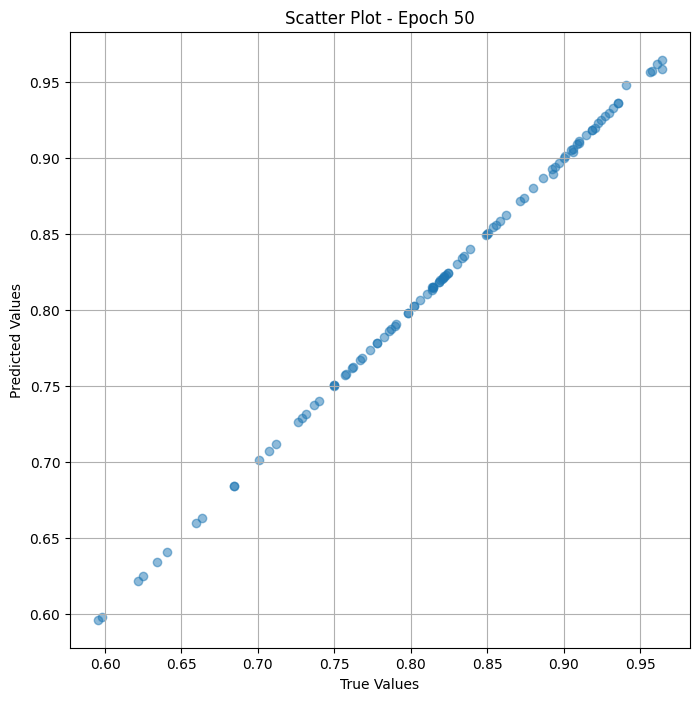

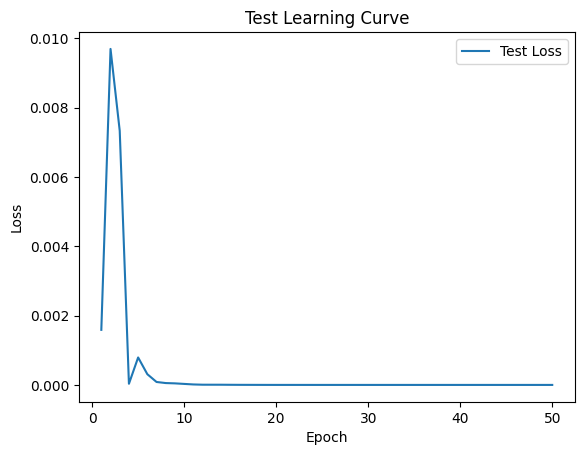

In [ ]:
# val the model and save weights
fit(50, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_animal' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result_fine = pd.DataFrame({
    'Image Path': df_test_animal['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result_fine)

                                          Image Path  True Value  \
0   /content/animal/n02342885_12762_preprocessed.jpg    0.940678   
1      /content/animal/000000474764_preprocessed.jpg    0.894231   
2      /content/animal/000000131059_preprocessed.jpg    0.597938   
3    /content/animal/n01846331_8530_preprocessed.jpg    0.659574   
4    /content/animal/n02342885_4519_preprocessed.jpg    0.918367   
..                                               ...         ...   
95  /content/animal/n02355227_13530_preprocessed.jpg    0.935780   
96  /content/animal/n01846331_11534_preprocessed.jpg    0.814815   
97     /content/animal/000000367468_preprocessed.jpg    0.850575   
98     /content/animal/000000576206_preprocessed.jpg    0.707071   
99   /content/animal/n02332755_2718_preprocessed.jpg    0.810526   

    Predicted Value  
0          0.940596  
1          0.894311  
2          0.597825  
3          0.659473  
4          0.918256  
..              ...  
95         0.935712  
96     

#map

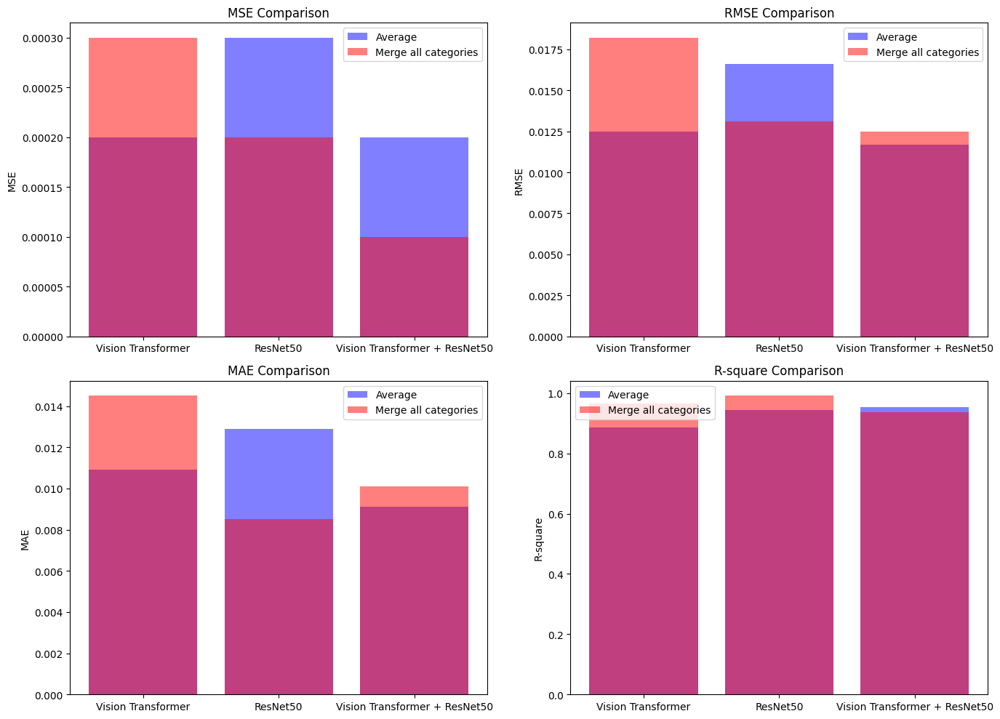

In [ ]:
import matplotlib.pyplot as plt

# กำหนดข้อมูล
categories = ['Vision Transformer', 'ResNet50', 'Vision Transformer + ResNet50']
average_mse = [0.0002, 0.0003, 0.0002]
merge_mse = [0.0003, 0.0002, 0.0001]
average_rmse = [0.0125, 0.0166, 0.0117]
merge_rmse = [0.0182, 0.0131, 0.0125]
average_mae = [0.0109, 0.0129, 0.0091]
merge_mae = [0.0145, 0.0085, 0.0101]
average_r_square = [0.8857, 0.9439, 0.9526]
merge_r_square = [0.9657, 0.9912, 0.9360]

# สร้าง subplot สำหรับกราฟแต่ละค่า
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# MSE
axs[0, 0].bar(categories, average_mse, color='b', alpha=0.5, label='Average')
axs[0, 0].bar(categories, merge_mse, color='r', alpha=0.5, label='Merge all categories')
axs[0, 0].set_title('MSE Comparison')
axs[0, 0].set_ylabel('MSE')
axs[0, 0].legend()

# RMSE
axs[0, 1].bar(categories, average_rmse, color='b', alpha=0.5, label='Average')
axs[0, 1].bar(categories, merge_rmse, color='r', alpha=0.5, label='Merge all categories')
axs[0, 1].set_title('RMSE Comparison')
axs[0, 1].set_ylabel('RMSE')
axs[0, 1].legend()

# MAE
axs[1, 0].bar(categories, average_mae, color='b', alpha=0.5, label='Average')
axs[1, 0].bar(categories, merge_mae, color='r', alpha=0.5, label='Merge all categories')
axs[1, 0].set_title('MAE Comparison')
axs[1, 0].set_ylabel('MAE')
axs[1, 0].legend()

# R-square
axs[1, 1].bar(categories, average_r_square, color='b', alpha=0.5, label='Average')
axs[1, 1].bar(categories, merge_r_square, color='r', alpha=0.5, label='Merge all categories')
axs[1, 1].set_title('R-square Comparison')
axs[1, 1].set_ylabel('R-square')
axs[1, 1].legend()

plt.tight_layout()
plt.show()


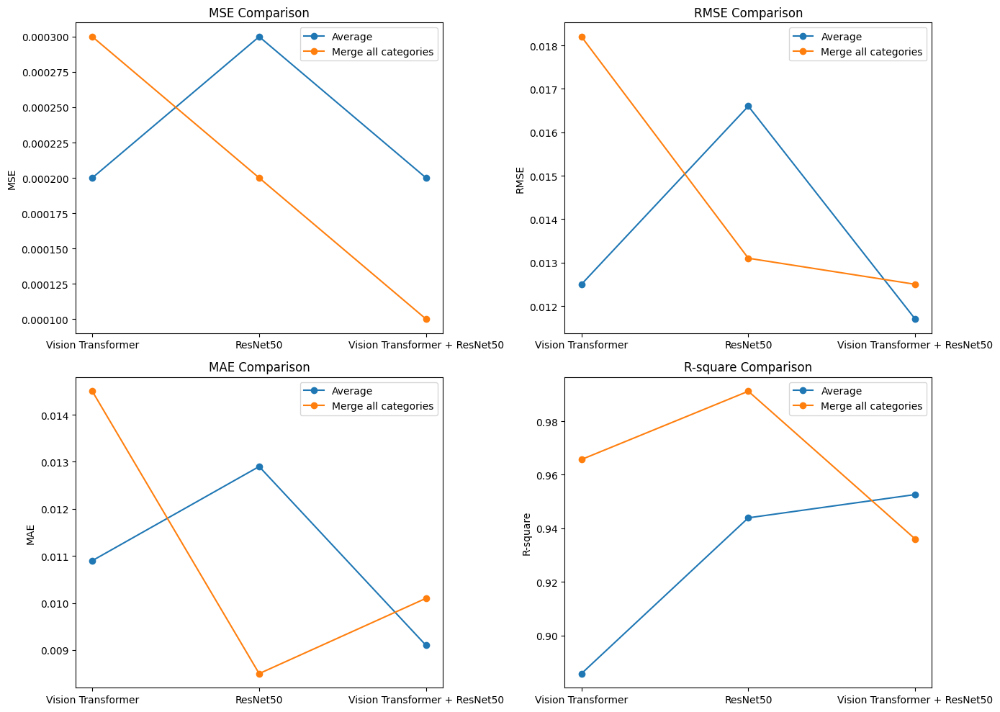

In [ ]:
#Pretrain

import matplotlib.pyplot as plt

# กำหนดข้อมูล
categories = ['Vision Transformer', 'ResNet50', 'Vision Transformer + ResNet50']
average_mse = [0.0002, 0.0003, 0.0002]
merge_mse = [0.0003, 0.0002, 0.0001]
average_rmse = [0.0125, 0.0166, 0.0117]
merge_rmse = [0.0182, 0.0131, 0.0125]
average_mae = [0.0109, 0.0129, 0.0091]
merge_mae = [0.0145, 0.0085, 0.0101]
average_r_square = [0.8857, 0.9439, 0.9526]
merge_r_square = [0.9657, 0.9912, 0.9360]

# สร้าง subplot สำหรับกราฟแต่ละค่า
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# MSE
axs[0, 0].plot(categories, average_mse, marker='o', label='Average')
axs[0, 0].plot(categories, merge_mse, marker='o', label='Merge all categories')
axs[0, 0].set_title('MSE Comparison')
axs[0, 0].set_ylabel('MSE')
axs[0, 0].legend()

# RMSE
axs[0, 1].plot(categories, average_rmse, marker='o', label='Average')
axs[0, 1].plot(categories, merge_rmse, marker='o', label='Merge all categories')
axs[0, 1].set_title('RMSE Comparison')
axs[0, 1].set_ylabel('RMSE')
axs[0, 1].legend()

# MAE
axs[1, 0].plot(categories, average_mae, marker='o', label='Average')
axs[1, 0].plot(categories, merge_mae, marker='o', label='Merge all categories')
axs[1, 0].set_title('MAE Comparison')
axs[1, 0].set_ylabel('MAE')
axs[1, 0].legend()

# R-square
axs[1, 1].plot(categories, average_r_square, marker='o', label='Average')
axs[1, 1].plot(categories, merge_r_square, marker='o', label='Merge all categories')
axs[1, 1].set_title('R-square Comparison')
axs[1, 1].set_ylabel('R-square')
axs[1, 1].legend()

plt.tight_layout()
plt.show()


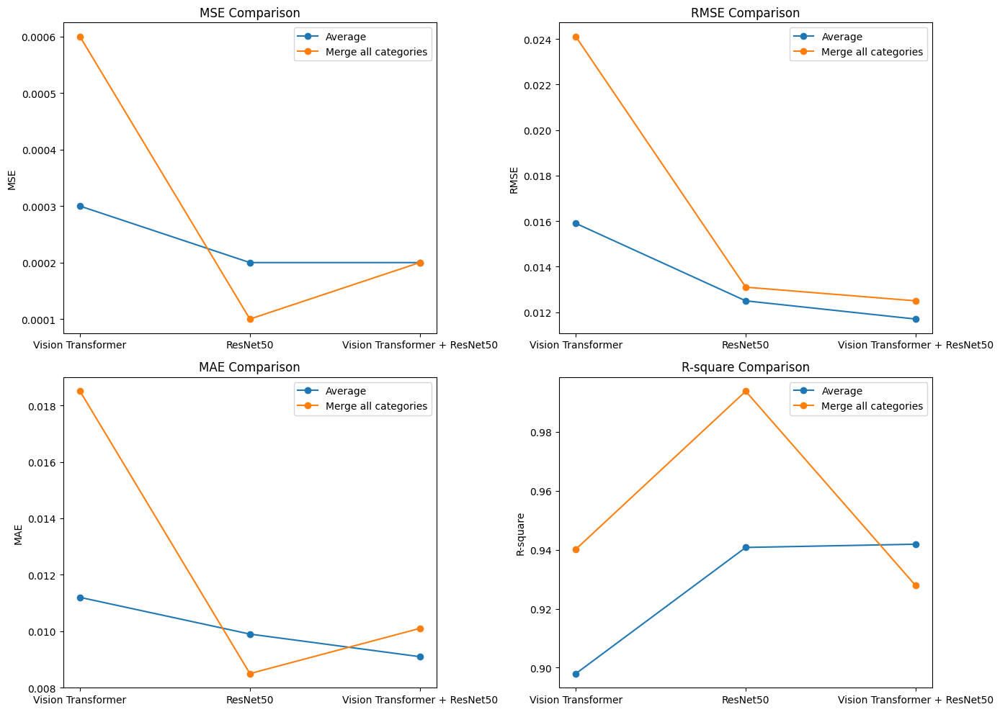

In [ ]:
#finetune

import matplotlib.pyplot as plt

# กำหนดข้อมูล
categories = ['Vision Transformer', 'ResNet50', 'Vision Transformer + ResNet50']
average_mse = [0.0003, 0.0002, 0.0002]
merge_mse = [0.0006, 0.0001, 0.0002]
average_rmse = [0.0159, 0.0125, 0.0117]
merge_rmse = [0.0241, 0.0131, 0.0125]
average_mae = [0.0112, 0.0099, 0.0091]
merge_mae = [0.0185, 0.0085, 0.0101]
average_r_square = [0.8980, 0.9408, 0.9419]
merge_r_square = [0.9402, 0.9938, 0.9279]

# สร้าง subplot สำหรับกราฟแต่ละค่า
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# MSE
axs[0, 0].plot(categories, average_mse, marker='o', label='Average')
axs[0, 0].plot(categories, merge_mse, marker='o', label='Merge all categories')
axs[0, 0].set_title('MSE Comparison')
axs[0, 0].set_ylabel('MSE')
axs[0, 0].legend()

# RMSE
axs[0, 1].plot(categories, average_rmse, marker='o', label='Average')
axs[0, 1].plot(categories, merge_rmse, marker='o', label='Merge all categories')
axs[0, 1].set_title('RMSE Comparison')
axs[0, 1].set_ylabel('RMSE')
axs[0, 1].legend()

# MAE
axs[1, 0].plot(categories, average_mae, marker='o', label='Average')
axs[1, 0].plot(categories, merge_mae, marker='o', label='Merge all categories')
axs[1, 0].set_title('MAE Comparison')
axs[1, 0].set_ylabel('MAE')
axs[1, 0].legend()

# R-square
axs[1, 1].plot(categories, average_r_square, marker='o', label='Average')
axs[1, 1].plot(categories, merge_r_square, marker='o', label='Merge all categories')
axs[1, 1].set_title('R-square Comparison')
axs[1, 1].set_ylabel('R-square')
axs[1, 1].legend()

plt.tight_layout()
plt.show()
